# 0. Introduction

This is an entire pipeline using a synthetic dataset (from simulation_data_generation.ipynb) to predict autism diagnosis. 
There are 5 related labels: Autism, ADHD, MD, DD, LD. 
Part 1 and 2 are required setup and functions.
Part 3 is mainly for finding hyperparameters for each model using a 2:1 train:test split, since it will take too long in side the 10-fold cv loop. Don't need to run if you already found the optimal hyperparameters.
Part 4 is the main result using the found hyperparameters to run through 10-fold cross-validation and generate the plots.

Model comparisons:
Model 0 is a single-label model, just predicting 1 label.
Model 1 is a multi-label model, predicting all 5 labels together.
Model 3 is a conditional multi-label model. First step: predicting "any condition" probability, then use this probability to weight the sample in the second step that predicts 5 labels together.
Model 9 is a 1-step conditional multi-label model, equivalent to model 3 but simpler. Combined the two steps in one.
Model 10 is a conditional single-label model. First step: predicting "any condition" probability, then use this probability to weight the sample in the second step that predicts only 1 label.
Model 11 is a 1-step conditional single-label model, equivalent to model 10 but simpler. Combined the two steps in one.

Model 1, 10, and 11 apply multi-label approach and 2-stage learning individually (to show intermediate results). Model 3 and 9 are the final models that combines multi-label and 2-stage learning (which yield the best performance).

Author: Angel Huang 6/27/2024

# 1. Load library and data

In [1396]:
useGPU = 1
%matplotlib inline

import sys, os
import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt

import math as m
import shap
import torch
import torch.optim as optim
import pickle
torch.manual_seed(42) 

from pandas import DataFrame
from torch.utils.data import DataLoader
from tqdm import notebook
from Function import TransData, MTLnet, valid_loop, train_loop, plot_roc_all_classes, calib_plot
from sklearn.metrics import roc_auc_score, average_precision_score, accuracy_score, roc_curve, precision_recall_curve
from sklearn.model_selection import train_test_split
from scipy.special import expit # numerically stable sigmoid function
from numpy import genfromtxt # read y_target
from datetime import datetime
from tabulate import tabulate
import imp
imp.reload(plt); imp.reload(sns)
from sklearn.calibration import calibration_curve
from sklearn.metrics import (brier_score_loss, precision_score, recall_score,
                             f1_score, auc)
from scipy import stats
today = datetime.today().strftime('%Y%m%d') # for filename

if useGPU == 1:
    BASE_DIR = 'xxx'
else: 
    BASE_DIR = 'yyy'

MAIN_DIR = os.path.join(BASE_DIR, 'Projects/Multistep_Model')
DATAMAIN_DIR = os.path.join(BASE_DIR, 'Study Data/EHR Data')

# choose settings for simulation data
similarity = 0 # similarity between 1st label and other labels
signal_strength = 2 # how easy to classify an event
linear_flag = 'linear_' # linear or nonlinear
suffix = linear_flag + 'similarity='+str(similarity)+'_signal='+str(signal_strength)

DATAOUT_DIR = os.path.join(MAIN_DIR, 'Data Output/5label_simulation',suffix)
RESULT_DIR = os.path.join(MAIN_DIR, 'Output/5label_simulation_' + suffix)
DATA_SCRIPT_DIR = os.path.join(DATAMAIN_DIR, 'Scripts/2_prepare_features/')
sys.path.insert(0,DATA_SCRIPT_DIR) # insert to 1st

In [1398]:
# For easy update of customly written modules (only if changes were made)
from importlib import reload
import load_dataset; reload(load_dataset); 
import Function; reload(Function); 
from Function import MTLnet, valid_loop, train_loop, plot_roc_all_classes, calib_plot

In [1399]:
# Load data
x = pickle.load(open(DATAOUT_DIR + '/x.pickle','rb'))
prob = pickle.load(open(DATAOUT_DIR + '/prob.pickle','rb'))
event = pickle.load(open(DATAOUT_DIR + '/event.pickle','rb'))

In [1400]:
X_df = pd.DataFrame(x)
y_df = pd.DataFrame(event)
# add column names and NDD column at the end
NDD_labels = ['ASD', 'ADHD', 'MD', 'DD', 'LD']
y_df.columns = [f'{label}_flag' for label in NDD_labels]
y_df['NDD_flag'] = y_df.any(axis=1).astype(int)

print(y_df)

       ASD_flag  ADHD_flag  MD_flag  DD_flag  LD_flag  NDD_flag
0             1          0        0        0        1         1
1             1          1        0        0        0         1
2             0          0        1        0        0         1
3             0          0        0        1        0         1
4             0          0        0        0        1         1
...         ...        ...      ...      ...      ...       ...
17995         0          0        0        0        1         1
17996         0          0        1        0        0         1
17997         1          0        0        0        0         1
17998         0          0        0        0        0         0
17999         0          0        0        0        1         1

[18000 rows x 6 columns]


In [1401]:
# Adding anxiety_flag will break stratification, will have class less than 2 cases
X_train, X_test, y_train, y_test = train_test_split(
    X_df, y_df, test_size=0.33, 
    stratify=y_df[['NDD_flag','ASD_flag','DD_flag','LD_flag']], 
    random_state=42) # stratify for y labels

In [1402]:
from sklearn.preprocessing import StandardScaler
# initiate the standard scaler
ss = StandardScaler() # it has a mean of 0 and a standard deviation of 1

# Transform the test data using the same scaler
all_pred = list(X_df.columns)
num_pred = [x for x in all_pred]
X_train.loc[:, num_pred] = ss.fit_transform(X_train[num_pred])
X_test.loc[:, num_pred] = ss.transform(X_test[num_pred]) # StandardScaler is first fit on the training data using fit_transform(), and then only the transformation is applied to the test data using transform(). This ensures that the test data is scaled 
# based on the mean and standard deviation learned from the training data.

In [1403]:
X_train

,0,1,2,3,4,5,6,7,8,9,...,550,551,552,553,554,555,556,557,558,559
6331,0.634207,-0.056643,-0.832277,0.037499,-0.163235,-0.394532,-0.755369,-0.221057,0.338204,-0.425996,...,-0.330757,-0.099223,0.218710,0.464239,-0.055077,1.331530,0.941192,-1.136581,0.513152,-2.225471
12859,0.169486,2.696439,-0.025120,-0.412083,-0.104669,1.213645,-0.321688,-0.062767,2.509732,1.579053,...,0.819473,-0.549139,0.750585,0.019747,0.573779,-0.101652,-1.028719,-1.099247,-2.420061,-1.623791
10902,0.031391,0.888373,0.475137,-0.211869,0.171754,0.398485,0.743944,-1.468675,0.452299,-1.274104,...,-0.502667,0.477392,-3.283822,0.930211,-0.224580,2.049307,0.719277,0.272642,0.651547,-1.027146
17869,0.793014,-0.724006,-0.920695,0.502617,0.667776,1.699012,0.171695,0.410589,-0.066587,1.015903,...,-1.472681,0.412514,-0.617620,-0.302772,-0.365128,-0.514304,-0.432250,-1.023115,-0.421834,-1.745214
1866,0.962292,-0.298990,-1.131066,-0.784427,0.319435,-1.021244,1.449495,0.004919,0.666693,2.016914,...,1.124465,-0.625804,0.192259,0.125489,1.017039,0.607620,-0.629098,-1.855847,0.943891,-2.425129
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
9098,1.260556,0.556176,-0.178837,0.373611,1.630631,0.985237,2.160818,-0.491993,-0.962113,0.317103,...,0.708749,0.261048,1.536485,3.299860,0.740191,-2.204687,1.648394,-0.595281,-0.748407,-1.903445
16710,0.336990,-0.189956,-0.450300,0.465017,0.465738,1.665941,1.493711,1.507326,0.481761,-0.059532,...,1.475397,1.292462,0.405144,1.127311,0.675918,-0.314653,1.362278,-1.743076,-0.703454,2.723259
7947,-0.227195,0.444294,0.143583,-0.463523,-1.628332,0.340542,1.380141,0.462637,0.571078,-0.150466,...,-0.039639,0.725905,1.153947,-0.713008,-0.496811,-1.252268,-1.615578,-0.181387,-0.684386,-0.798998
9462,-0.316689,-0.510902,0.462229,-0.685040,-0.358257,0.581217,-0.294299,0.254731,-1.026265,1.229928,...,-2.328341,-0.578652,-1.411269,1.631906,-0.569133,-0.162902,0.058774,-1.904677,1.270184,0.201948


In [1404]:
# seperate each flag vs. any flag (the last column) for y
y_train_each = y_train.drop(columns=['NDD_flag'])
y_train_any = y_train[['NDD_flag']] # needs double bracket to keep dataframe format
y_train_asd = y_train[['ASD_flag']]
y_test_each = y_test.drop(columns=['NDD_flag'])
y_test_any = y_test[['NDD_flag']]
y_test_asd = y_test[['ASD_flag']]
# For testing model11n
y_train_asd_any = pd.concat([y_train_asd, y_train_any], axis=1)
y_test_asd_any = pd.concat([y_test_asd, y_test_any], axis=1)

print(y_train_each.shape)
print(y_train_any.shape)
print(y_test_each.shape)
print(y_test_any.shape)
print(X_train.shape)
print(y_test_asd_any.shape)

(12060, 5)
(12060, 1)
(5940, 5)
(5940, 1)
(12060, 560)
(5940, 2)


# 2. Modeling functions

## 2.1 Set up device and parameters

In [787]:
# Model Definition
device = "cuda" if torch.cuda.is_available() else "cpu"
batch_size = 2000 # number samples in a batch

## 2.2 Hyperparameter tuning (cross validation) function

In [788]:
# list of hyperparameters to check:
# - regularization term lambda
# - learning rate
def hyperparameter_tuning(model, model_name, X_train, y_train, model_flag, lams=np.logspace(1, 3, 10), lr=np.logspace(-2, 0, 10)):
    N_val_folds = 5
    val_loss = []
    for learning_rate in notebook.tqdm(learning_rates, desc='learning rate loop'):
        optimizer = torch.optim.Adam(model.parameters(), lr=learning_rate)
        for lam in notebook.tqdm(lams, desc='regularization lambda loop'):
            for fold_idx in range(N_val_folds):
                loss_list = []
                fold_ref = (N_val_folds * np.arange(len(X_train))) // len(X_train)
                Xtr = X_train[fold_ref != fold_idx]
                ytr = y_train[fold_ref != fold_idx]

                Xval = X_train[fold_ref == fold_idx]
                yval = y_train[fold_ref == fold_idx]

                # load into DataLoader
                # convert pandas.dataframe to numpy.array (needed for TransData to find index)
                Xtr = Xtr.to_numpy().astype(np.float32)
                ytr = ytr.to_numpy().astype(np.float32)
                Xval = Xval.to_numpy().astype(np.float32)
                yval = yval.to_numpy().astype(np.float32)

                # dataloader is the required form of data in pytorch
                # Create datasets
                set_train = TransData(xx=Xtr, yy=ytr)
                set_valid = TransData(xx=Xval, yy=yval)

                # Create dataloader
                #batch_size = 2000 # number samples in a batch
                train_dlr = DataLoader(set_train, batch_size=batch_size, shuffle=False) # True for later
                valid_dlr = DataLoader(set_valid, batch_size=batch_size, shuffle=False)

                #print('Training on fold %i (Validation N = %i) with lr = %.3e, reg lambda = %i' % (
                #            fold_idx, sum(fold_ref == fold_idx), learning_rate, lam))

                loss = np.nan
                #try:
                if 1:
                    train_loop(train_dlr, model, optimizer, [], lam = lam, model_flag = model_flag)
                    valid_loop(valid_dlr, model, [], loss_list, model_flag = model_flag)

                    loss = loss_list[0] # should be 1 number anyway (not including l1-loss)
                    #print(loss)
                    current_result = {
                        'learning_rate': learning_rate,
                        'lambda': lam,
                        'fold_idx': fold_idx,
                        'loss': loss
                    }

                    val_loss.append(current_result)

                #except:
                #    print('Failed with alpha = %.3e' % alpha)

    val_loss = pd.DataFrame(val_loss)
    val_loss_ordered = val_loss.groupby(['lambda', 'learning_rate'])['loss'].median().reset_index().sort_values(
                by=['loss', 'lambda', 'learning_rate'], ascending=[True, True, True])

    # Save valication loss
    savename = 'tuning_bs=' + str(batch_size) + '_' + today
    savename_ordered = 'tuning_ordered_' + today
    # create folder if not exist
    if not os.path.exists(RESULT_DIR +'/' + model_name + '/hyperparameter_tuning/'):
        os.makedirs(RESULT_DIR +'/' + model_name + '/hyperparameter_tuning/')
        print("The new directory is created!")
        
    val_loss.to_csv(RESULT_DIR + '/' + model_name + '/hyperparameter_tuning/' + savename + '.csv')
    val_loss_ordered.to_csv(RESULT_DIR + '/' + model_name + '/hyperparameter_tuning/' + savename_ordered + '.csv')

    # Plot 2d heatmap
    fig, axes = plt.subplots(3,1, figsize=(5, 10), sharex=False)
    sns.lineplot(ax=axes[0], data=val_loss, x='lambda', y='loss')
    sns.lineplot(ax=axes[1], data=val_loss, x='learning_rate', y='loss')
    sns.kdeplot(ax=axes[2], data=val_loss, x='lambda', y='learning_rate', cmap="Reds", shade=True, cbar=True,
                cbar_kws={'label': 'Validation loss density'})
    
    plt.savefig(RESULT_DIR +'/' + model_name + '/hyperparameter_tuning/'  + savename + '.png')
    # plt.clf()
    best_param = val_loss_ordered.values[0] # pick the first with lowest loss
    print('Best lambda, learning_rate, loss is ' + np.array2string(best_param))
    return plt

## 2.3 Split training, validation, test set

In [790]:
# After hyperparameter tuning, use a single validation set
# For model1 and 2: use y_train_each which has 6 condition flags
# 2023/11/10 set default value for X_test and y_test as sometimes no test set was used.
def split_trainvaltest(X_train, y_train, stratify, X_test=pd.DataFrame(), y_test=pd.DataFrame()):
    
    Xtr, Xval, ytr, yval = train_test_split(
         X_train, y_train, test_size=0.2, stratify=stratify, random_state=42) # stratify for y labels
        
    # convert pandas.dataframe to numpy.array (needed for TransData to find index)
    Xtr = Xtr.to_numpy().astype(np.float32)
    ytr = ytr.to_numpy().astype(np.float32)
    Xval = Xval.to_numpy().astype(np.float32)
    yval = yval.to_numpy().astype(np.float32)
    X_test = X_test.to_numpy().astype(np.float32)
    y_test = y_test.to_numpy().astype(np.float32)

    # dataloader is the required form of data in pytorch
    # Create datasets
    set_train = TransData(xx=Xtr, yy=ytr)
    set_valid = TransData(xx=Xval, yy=yval)
    set_test  = TransData(xx=X_test, yy=y_test)
    
    # Create dataloader
    batch_size = 2000
    train_dlr = DataLoader(set_train, batch_size=batch_size, shuffle=False) # True for later
    valid_dlr = DataLoader(set_valid, batch_size=batch_size, shuffle=False) # True for later
    test_dlr  = DataLoader(set_test, batch_size=batch_size, shuffle=False) # True for later
    print('Dataset dimensions are', Xtr.shape, ytr.shape, Xval.shape, yval.shape, X_test.shape, y_test.shape)
   
    return train_dlr, valid_dlr, test_dlr


## 2.4 Training model and plot validation loss

In [791]:
# Train model
def train_model(model, model_name, model_flag, model_output_dir, train_dlr, valid_dlr, iter, epochs, loss_list, min_valid_loss, optimizer, scheduler, lam, NDD_labels):
    # create folder if not exist
    if not os.path.exists(model_output_dir):
        os.makedirs(model_output_dir)
        print("The new directory is created!")
        
    for epoch in notebook.tqdm(range(int(epochs)),desc='Training Epochs'):
        #print(f"Epoch {iter+1}\n-------------------------------")
        train_loop(train_dlr, model, optimizer = optimizer, scheduler = scheduler, lam = lam, model_flag=model_flag)
        valid_loss, loss_list = valid_loop(valid_dlr, model, [], loss_list, model_flag=model_flag)

        # Track the minimum valid loss and store state
        #print(valid_loss)
        if valid_loss < min_valid_loss:
            min_valid_loss = valid_loss

            # save model
            suffix = 'valloss=' + str(round(min_valid_loss,2)) + '_bs=' + str(batch_size) + '_lr=' + str(learning_rate) + '_lambda='  + str(round(lam,2))
            savename = 'params_' + suffix
            savepath = model_output_dir + '/' + savename + '.pt'
            if epoch==1 and not os.path.exists(model_output_dir):
                os.makedirs(model_output_dir)
                print("The new directory is created!")
            torch.save(model.state_dict(), savepath)

        iter+=1

    # load the last checkpoint with the best model    
    #print(min_valid_loss)
    model.load_state_dict(torch.load(savepath))
    
        
    # Plot validation loss
    number = list(range(1, len(loss_list)+1))

    for j in range(len(NDD_labels)): # 6 labels
        NDD_label = NDD_labels[j]
        savename = 'valLoss_' + NDD_label + '_' + suffix

        fig = plt.figure()
        plt.scatter(number, loss_list)
        plt.xlabel('Epochs')
        plt.ylabel('Average validation loss')
        plt.title(model_name + ': ' + NDD_label + ' - Validation Loss - Epochs Scatter Plot')        
        plt.savefig(model_output_dir + '/' + savename + '.png', bbox_inches='tight')
        plt.show()
    return model, loss_list, min_valid_loss, iter, suffix, plt

## 2.5 Get test results and plot roc

In [792]:
def get_y_pred(model, model_name, model_output_dir, test_dlr, prob_or_logit, suffix, NDD_labels):
    # output the prediction for test set performance
    y_target = []
    y_pred = []
    with torch.no_grad():
        for X, y in test_dlr:
            if prob_or_logit== 'prob': # if model output probability, use directly
                pred = model(X)
            elif prob_or_logit== 'logit': # if model output logit, then apply sigmoid to convert to probability
                l = model(X)
                pred = expit(l)
            y_pred += pred.tolist()
            y_target += y.tolist()
    len(y_pred) # 2588 x 6 list in list
    np.savetxt(model_output_dir + '/test_ytarget_' + suffix + '.csv', 
               y_target,
               delimiter =", ", 
               fmt ='% s')
    np.savetxt(model_output_dir + '/test_ypred_' + suffix + '.csv', 
               y_pred,
               delimiter =", ", 
               fmt ='% s')
    
    # Use function to plot roc
    print(NDD_labels)
    plt1=plot_roc_all_classes(y_target, y_pred, NDD_labels, model_name)
    plt1.savefig(model_output_dir + '/roc_pr_NDD_' + suffix + '.png', bbox_inches='tight')
    plt1.show()
    
    # Calibration Plot
    plt2 = calib_plot(y_target, y_pred, model_name, NDD_labels)
    plt2.savefig(model_output_dir + '/calib_NDD_' + suffix + '.png', bbox_inches='tight')
    return y_target, y_pred, plt1, plt2

## 2.6 Bootstrap for Confidence interval

In [793]:
def get_metrics(y_target, y_pred, flag=''):
    # compute AUC and average precision for each label and for "any label" metric
    metrics = {}
    if flag == 'single_label': # for ASD subpopulation, all any are true, just predict ASD
        if len(y_target.shape) == 1: # 1 dim, only 1 label
            i=0
            metrics['auc_label{}'.format(i)] = roc_auc_score(y_target, y_pred)
            metrics['precision_label{}'.format(i)] = average_precision_score(y_target, y_pred)
        else: # calculate for all labels
            for i in range(y_target.shape[1]): 
                metrics['auc_label{}'.format(i)] = roc_auc_score(y_target[:, i], y_pred[:, i])
                metrics['precision_label{}'.format(i)] = average_precision_score(y_target[:, i], y_pred[:, i])
        y_target_any = y_target
        y_pred_any = y_pred
        metrics['auc_any'] = roc_auc_score(y_target_any, y_pred_any)
        metrics['precision_any'] = average_precision_score(y_target_any, y_pred_any)
        
    else:
        y_target_any = y_target.max(axis=1)
        y_pred_any = 1 - np.prod(1 - y_pred, axis=1)

        metrics['auc_any'] = roc_auc_score(y_target_any, y_pred_any)
        metrics['precision_any'] = average_precision_score(y_target_any, y_pred_any)

        for i in range(y_target.shape[1]): # calculate for all labels
            metrics['auc_label{}'.format(i)] = roc_auc_score(y_target[:, i], y_pred[:, i])
            metrics['precision_label{}'.format(i)] = average_precision_score(y_target[:, i], y_pred[:, i])
        
    return metrics


def bootstrap_samples(y_target, y_pred, n_samples=1000, flag=''):
    # initialize array to store metric values
    metrics = {}
    #print(flag)
    for key in get_metrics(y_target, y_pred, flag).keys():
        metrics[key] = np.zeros(n_samples)
    
    # perform bootstrap sampling
    for i in range(n_samples):
        # generate random indices with replacement
        idx = np.random.choice(len(y_target), len(y_target), replace=True)
        
        # compute performance metrics on sample
        sample_metrics = get_metrics(y_target[idx], y_pred[idx], flag=flag)
        
        # store metric values in dictionary
        for key in sample_metrics.keys():
            metrics[key][i] = sample_metrics[key]
    
    # compute confidence intervals for all metrics
    ci = {}
    for key in metrics.keys():
        ci[key] = np.percentile(metrics[key], [2.5, 97.5])
    
    return ci, get_metrics(y_target, y_pred, flag)


# 3. Training model NN (find hyperparameter)

## 3.0 Model 0 baseline

In [917]:
model0n_name = 'NN_1label'
input_dim = len(X_train.columns) # number of input features 
output_dim = len(y_train_each.iloc[:,[0]].columns) # only use asd column
model0n = MTLnet(input_dim,output_dim)
model0n.to(device)
model0n_output_dir = RESULT_DIR + '/' + model0n_name
model_flag = 0
print(model0n)

MTLnet(
  (flatten): Flatten(start_dim=1, end_dim=-1)
  (linear_sigmoid_stack): Sequential(
    (0): Linear(in_features=560, out_features=100, bias=True)
    (1): ReLU()
    (2): Linear(in_features=100, out_features=1, bias=True)
  )
)


learning rate loop:   0%|          | 0/20 [00:00<?, ?it/s]

regularization lambda loop:   0%|          | 0/20 [00:00<?, ?it/s]

regularization lambda loop:   0%|          | 0/20 [00:00<?, ?it/s]

regularization lambda loop:   0%|          | 0/20 [00:00<?, ?it/s]

regularization lambda loop:   0%|          | 0/20 [00:00<?, ?it/s]

regularization lambda loop:   0%|          | 0/20 [00:00<?, ?it/s]

regularization lambda loop:   0%|          | 0/20 [00:00<?, ?it/s]

regularization lambda loop:   0%|          | 0/20 [00:00<?, ?it/s]

regularization lambda loop:   0%|          | 0/20 [00:00<?, ?it/s]

regularization lambda loop:   0%|          | 0/20 [00:00<?, ?it/s]

regularization lambda loop:   0%|          | 0/20 [00:00<?, ?it/s]

regularization lambda loop:   0%|          | 0/20 [00:00<?, ?it/s]

regularization lambda loop:   0%|          | 0/20 [00:00<?, ?it/s]

regularization lambda loop:   0%|          | 0/20 [00:00<?, ?it/s]

regularization lambda loop:   0%|          | 0/20 [00:00<?, ?it/s]

regularization lambda loop:   0%|          | 0/20 [00:00<?, ?it/s]

regularization lambda loop:   0%|          | 0/20 [00:00<?, ?it/s]

regularization lambda loop:   0%|          | 0/20 [00:00<?, ?it/s]

regularization lambda loop:   0%|          | 0/20 [00:00<?, ?it/s]

regularization lambda loop:   0%|          | 0/20 [00:00<?, ?it/s]

regularization lambda loop:   0%|          | 0/20 [00:00<?, ?it/s]

The new directory is created!
Best lambda, learning_rate, loss is [6.95192796e-05 3.35981829e-02 2.09257525e-03]


<module 'matplotlib.pyplot' from '/scratch/wh173/Anaconda/lib/python3.9/site-packages/matplotlib/pyplot.py'>

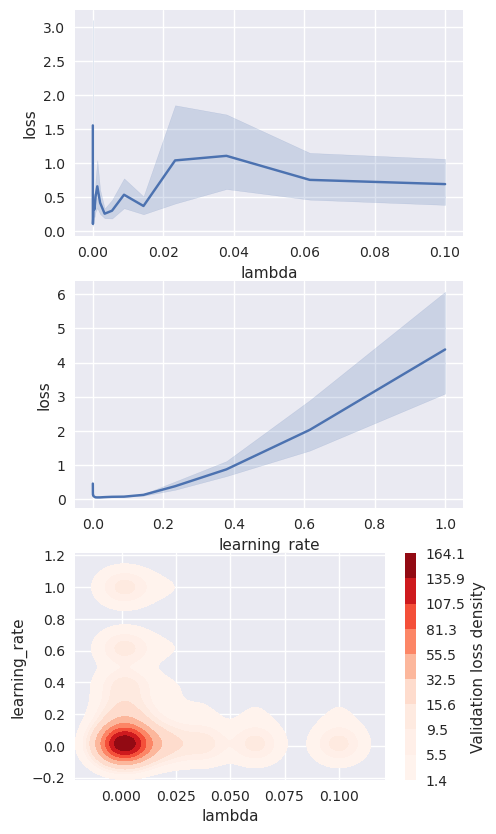

In [796]:
lams = np.logspace(-5, -1, 20) # 1,...,1000
learning_rates = np.logspace(-4, 0, 20) # 10^-5,...,10^-2
hyperparameter_tuning(model0n, model0n_name, X_train, y_train_each.iloc[:,[0]], model_flag=model_flag, lams=lams, lr=learning_rates)

# linear signal_strength=2, similarity=0.8, nlatent=5
# 0.0001, 0.001, 0.1, AUC = 0.718

In [918]:
# Use best hyperparameters for logistic regression
lam = 0.0001 # L1 regularization, get from cross-validation
learning_rate = 0.001
       
epochs = 200
optimizer = torch.optim.Adam(model0n.parameters(), lr=learning_rate)
stratify = y_train_each.iloc[:,[0]][['ASD_flag']]
train_dlr, valid_dlr, test_dlr = split_trainvaltest(X_train, y_train_each.iloc[:,[0]], stratify, X_test, y_test_each.iloc[:,[0]])
numbatches = len(train_dlr)
scheduler = []

# initialize validation loss during training
loss_list = []  # track the loss change when training
iter = 0
min_valid_loss = 10000 # initialize as a large number

Dataset dimensions are (9648, 560) (9648, 1) (2412, 560) (2412, 1) (5940, 560) (5940, 1)


The new directory is created!


Training Epochs:   0%|          | 0/200 [00:00<?, ?it/s]

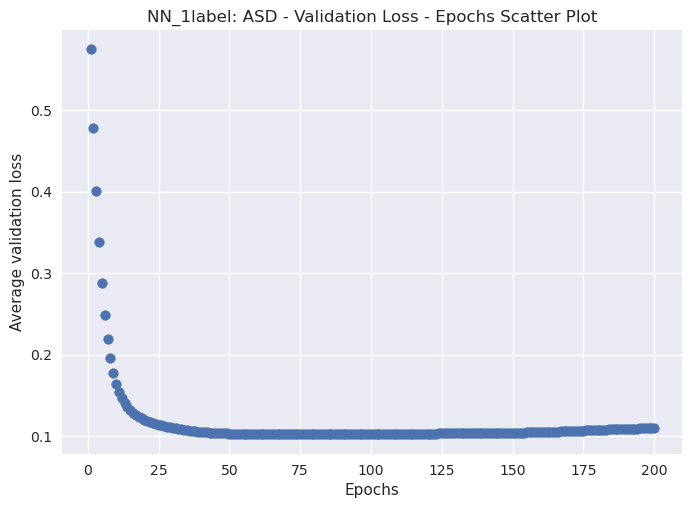

In [919]:
# Train model
model0n, loss_list, min_valid_loss, iter, suffix, plt \
= train_model(model0n, model0n_name, model_flag, model0n_output_dir,train_dlr, valid_dlr,  iter, epochs, loss_list, min_valid_loss, optimizer, scheduler, lam, [NDD_labels[0]])

0.10180941969156265
['ASD']


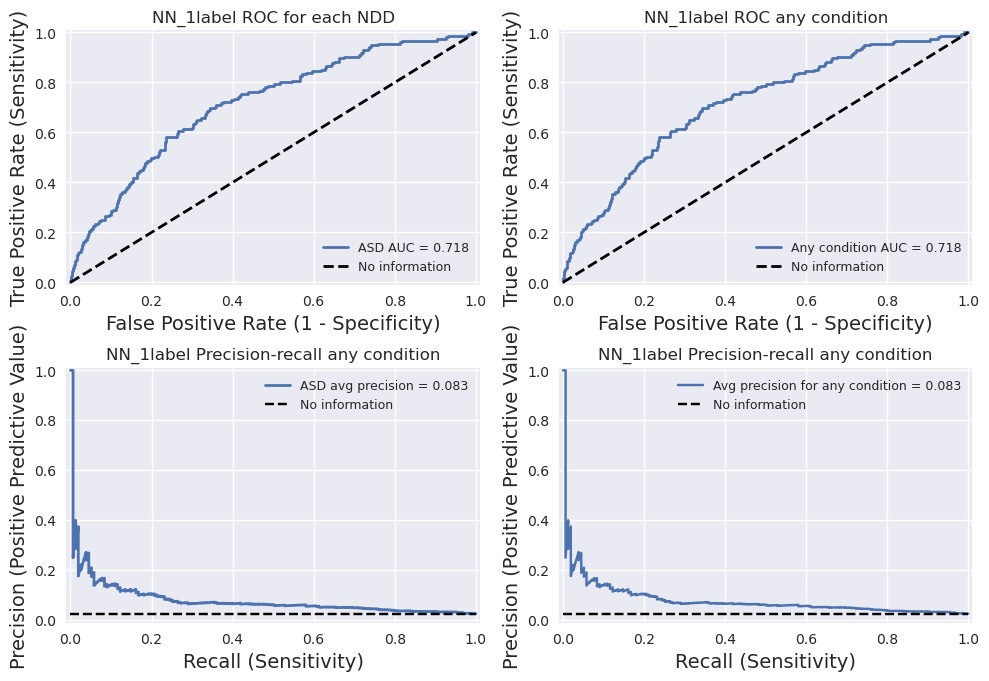

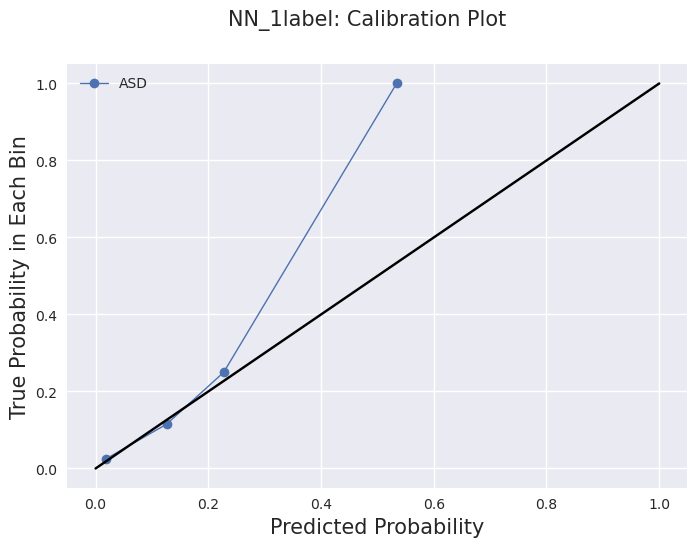

In [920]:
# Test results
print(min_valid_loss)
y_target, y_pred, plt1, plt2 \
= get_y_pred(model0n, model0n_name, model0n_output_dir, test_dlr, 'logit', suffix, [NDD_labels[0]])

## 3.1 Model 1

In [996]:
# model = MTLnet()
model1n_name = 'NN_1step'
input_dim = len(X_train.columns) # number of input features 
output_dim = len(y_train_each.columns) # number of output labels 
model1n = MTLnet(input_dim,output_dim)
model1n.to(device)
model1n_output_dir = RESULT_DIR + '/' + model1n_name
model_flag = 'L21'
print(model1n)

MTLnet(
  (flatten): Flatten(start_dim=1, end_dim=-1)
  (linear_sigmoid_stack): Sequential(
    (0): Linear(in_features=560, out_features=100, bias=True)
    (1): ReLU()
    (2): Linear(in_features=100, out_features=5, bias=True)
  )
)


learning rate loop:   0%|          | 0/20 [00:00<?, ?it/s]

regularization lambda loop:   0%|          | 0/20 [00:00<?, ?it/s]

regularization lambda loop:   0%|          | 0/20 [00:00<?, ?it/s]

regularization lambda loop:   0%|          | 0/20 [00:00<?, ?it/s]

regularization lambda loop:   0%|          | 0/20 [00:00<?, ?it/s]

regularization lambda loop:   0%|          | 0/20 [00:00<?, ?it/s]

regularization lambda loop:   0%|          | 0/20 [00:00<?, ?it/s]

regularization lambda loop:   0%|          | 0/20 [00:00<?, ?it/s]

regularization lambda loop:   0%|          | 0/20 [00:00<?, ?it/s]

regularization lambda loop:   0%|          | 0/20 [00:00<?, ?it/s]

regularization lambda loop:   0%|          | 0/20 [00:00<?, ?it/s]

regularization lambda loop:   0%|          | 0/20 [00:00<?, ?it/s]

regularization lambda loop:   0%|          | 0/20 [00:00<?, ?it/s]

regularization lambda loop:   0%|          | 0/20 [00:00<?, ?it/s]

regularization lambda loop:   0%|          | 0/20 [00:00<?, ?it/s]

regularization lambda loop:   0%|          | 0/20 [00:00<?, ?it/s]

regularization lambda loop:   0%|          | 0/20 [00:00<?, ?it/s]

regularization lambda loop:   0%|          | 0/20 [00:00<?, ?it/s]

regularization lambda loop:   0%|          | 0/20 [00:00<?, ?it/s]

regularization lambda loop:   0%|          | 0/20 [00:00<?, ?it/s]

regularization lambda loop:   0%|          | 0/20 [00:00<?, ?it/s]

The new directory is created!
Best lambda, learning_rate, loss is [1.00000000e-01 4.28133240e-02 5.20537151e-06]


<module 'matplotlib.pyplot' from '/scratch/wh173/Anaconda/lib/python3.9/site-packages/matplotlib/pyplot.py'>

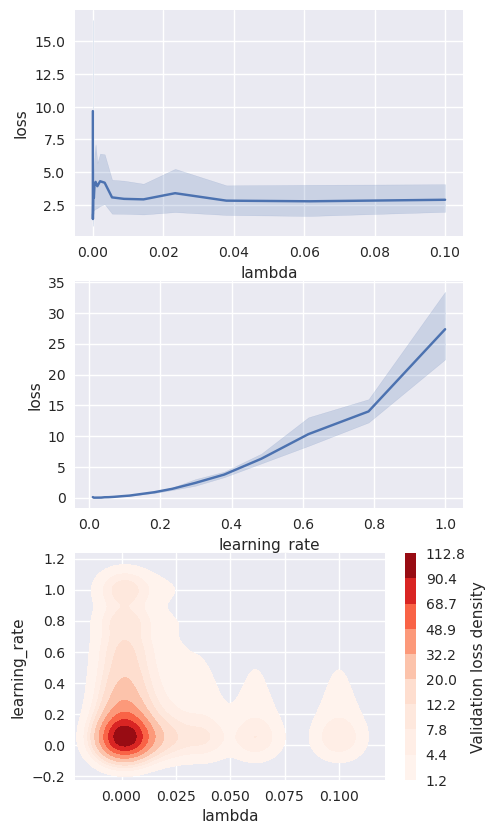

In [538]:
lams = np.logspace(-5, -1, 20) # 1,...,1000
learning_rates = np.logspace(-2, 0, 20) # 10^-5,...,10^-2
hyperparameter_tuning(model1n, model1n_name, X_train, y_train_each, model_flag=model_flag, lams=lams, lr=learning_rates)

# linear signal_strength=2, similarity=0.8, nlatent=5
# -- 0.01, 0.0001, minvalloss = 0.879, ASDAUC = 0.780

In [997]:
# Use best hyperparameters for logistic regression
lam = 0.01 # L21 regularization, get from cross-validation
learning_rate = 0.0001
epochs = 400
optimizer = torch.optim.Adam(model1n.parameters(), lr=learning_rate)
stratify = y_train_each[['ASD_flag','DD_flag','LD_flag']]
train_dlr, valid_dlr, test_dlr = split_trainvaltest(X_train, y_train_each, stratify, X_test, y_test_each)
numbatches = len(train_dlr)
scheduler = []

# initialize validation loss during training
loss_list = []  # track the loss change when training
iter = 0
min_valid_loss = 10000 # initialize as a large number

Dataset dimensions are (9648, 560) (9648, 5) (2412, 560) (2412, 5) (5940, 560) (5940, 5)


Training Epochs:   0%|          | 0/400 [00:00<?, ?it/s]

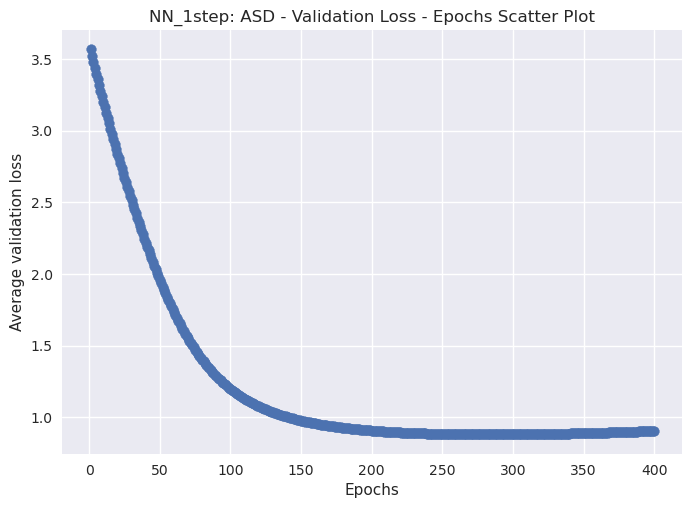

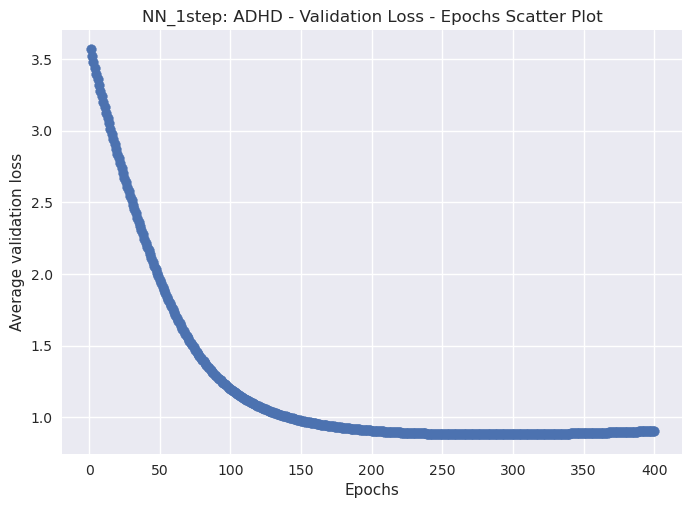

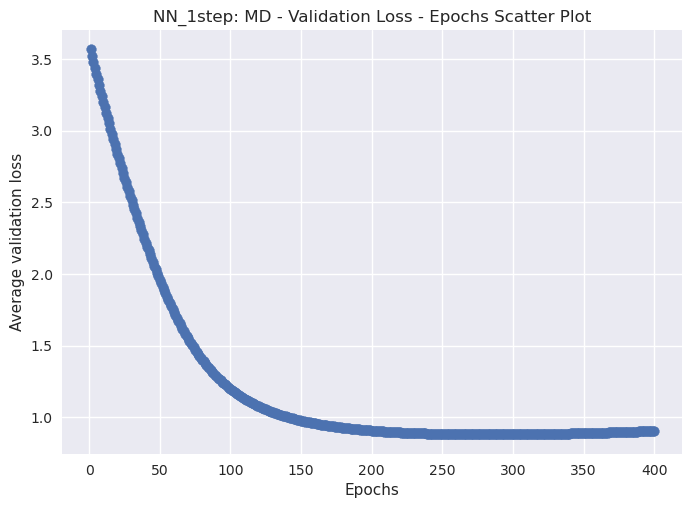

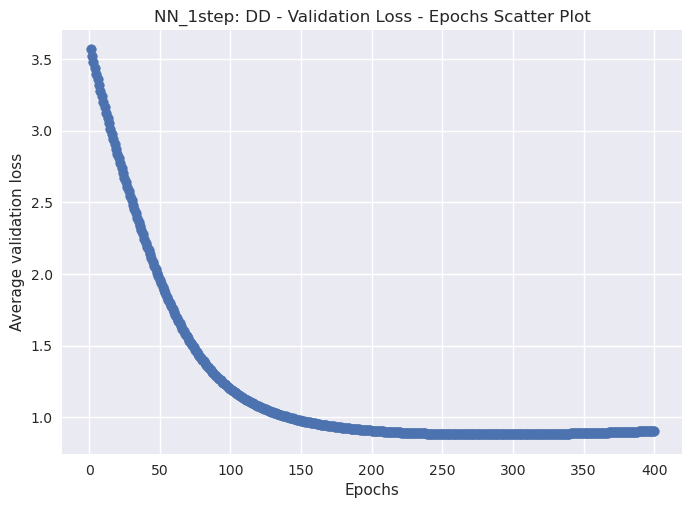

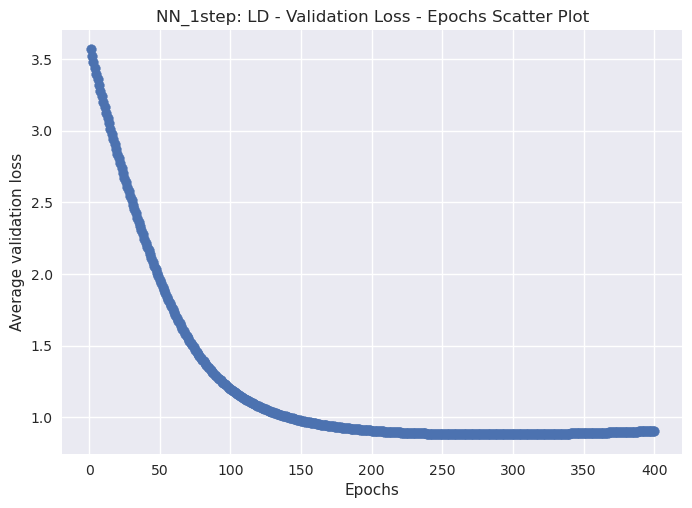

In [998]:
# Train model
model1n, loss_list, min_valid_loss, iter, suffix, plt \
= train_model(model1n, model1n_name, model_flag, model1n_output_dir,train_dlr, valid_dlr,  iter, epochs, loss_list, min_valid_loss, optimizer, scheduler, lam, NDD_labels)

0.879402220249176
['ASD', 'ADHD', 'MD', 'DD', 'LD']


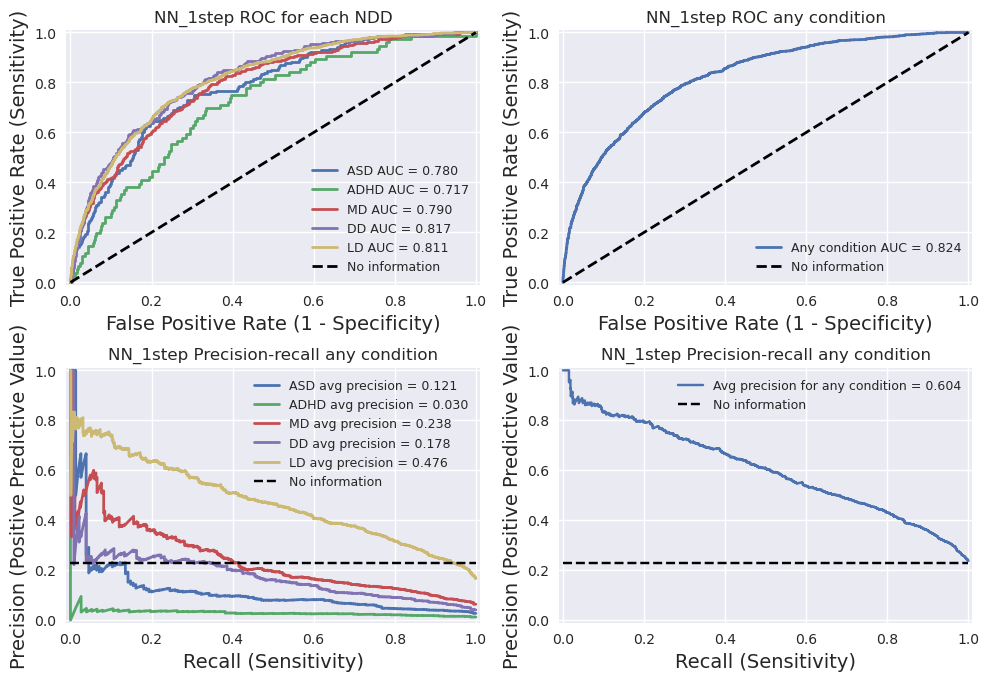

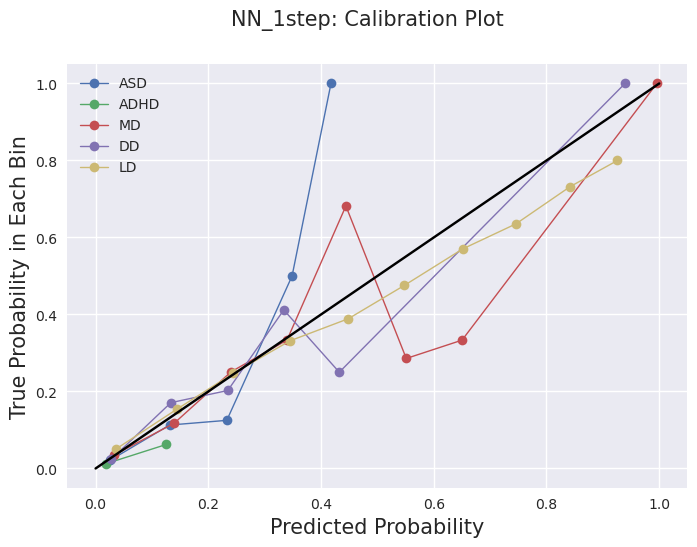

In [999]:
# Test results
print(min_valid_loss)
y_target, y_pred, plt1, plt2 \
= get_y_pred(model1n, model1n_name, model1n_output_dir, test_dlr, 'logit', suffix, NDD_labels)

## 3.3 Model 3

In [929]:
model3n_name = 'NN_2weighted'
input_dim = len(X_train.columns) # number of input features 
output_dim = len(y_train_any.columns) # 1/0
model3na = MTLnet(input_dim,output_dim)
model3na.to(device)
print(model3na)
model3na_output_dir = RESULT_DIR + '/' + model3n_name + '/a/'
model3n_output_dir = RESULT_DIR + '/' + model3n_name
model_flag = 0

MTLnet(
  (flatten): Flatten(start_dim=1, end_dim=-1)
  (linear_sigmoid_stack): Sequential(
    (0): Linear(in_features=560, out_features=100, bias=True)
    (1): ReLU()
    (2): Linear(in_features=100, out_features=1, bias=True)
  )
)


learning rate loop:   0%|          | 0/20 [00:00<?, ?it/s]

regularization lambda loop:   0%|          | 0/20 [00:00<?, ?it/s]

regularization lambda loop:   0%|          | 0/20 [00:00<?, ?it/s]

regularization lambda loop:   0%|          | 0/20 [00:00<?, ?it/s]

regularization lambda loop:   0%|          | 0/20 [00:00<?, ?it/s]

regularization lambda loop:   0%|          | 0/20 [00:00<?, ?it/s]

regularization lambda loop:   0%|          | 0/20 [00:00<?, ?it/s]

regularization lambda loop:   0%|          | 0/20 [00:00<?, ?it/s]

regularization lambda loop:   0%|          | 0/20 [00:00<?, ?it/s]

regularization lambda loop:   0%|          | 0/20 [00:00<?, ?it/s]

regularization lambda loop:   0%|          | 0/20 [00:00<?, ?it/s]

regularization lambda loop:   0%|          | 0/20 [00:00<?, ?it/s]

regularization lambda loop:   0%|          | 0/20 [00:00<?, ?it/s]

regularization lambda loop:   0%|          | 0/20 [00:00<?, ?it/s]

regularization lambda loop:   0%|          | 0/20 [00:00<?, ?it/s]

regularization lambda loop:   0%|          | 0/20 [00:00<?, ?it/s]

regularization lambda loop:   0%|          | 0/20 [00:00<?, ?it/s]

regularization lambda loop:   0%|          | 0/20 [00:00<?, ?it/s]

regularization lambda loop:   0%|          | 0/20 [00:00<?, ?it/s]

regularization lambda loop:   0%|          | 0/20 [00:00<?, ?it/s]

regularization lambda loop:   0%|          | 0/20 [00:00<?, ?it/s]

The new directory is created!
Best lambda, learning_rate, loss is [4.28133240e-05 1.27427499e-02 9.85594373e-03]


<module 'matplotlib.pyplot' from '/scratch/wh173/Anaconda/lib/python3.9/site-packages/matplotlib/pyplot.py'>

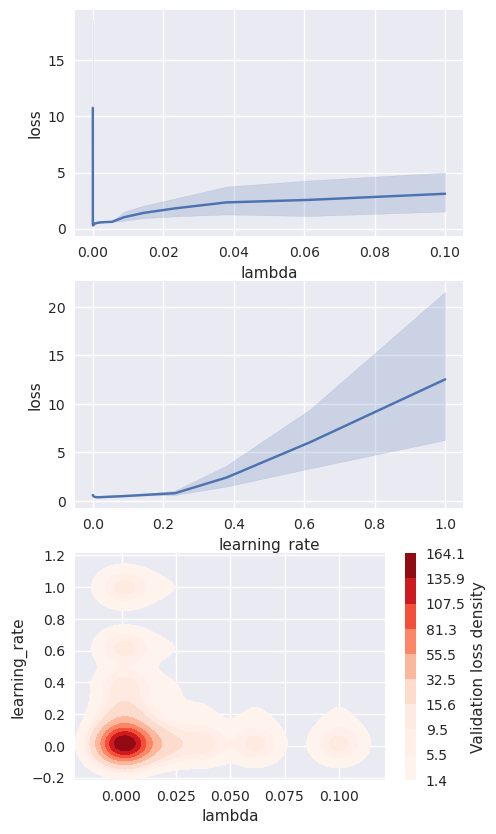

In [444]:
lams = np.logspace(-5, -1, 20) # 1,...,1000
learning_rates = np.logspace(-4, 0, 20) # 10^-5,...,10^-2
hyperparameter_tuning(model3na, model3n_name + '/a/', X_train, y_train_any, model_flag=model_flag, lams=lams, lr=learning_rates)

# linear signal_strength=2, similarity=0.8, nlatent=5
# -- 0.00004, 0.0001, epoch=400 minvalloss = 0.39, anyAUC = 0.946

In [930]:
# Use best hyperparameters for logistic regression
lam = 0.00004
learning_rate = 0.0001
epochs = 400
optimizer = torch.optim.Adam(model3na.parameters(), lr=learning_rate)

stratify=y_train_any
train_dlr, valid_dlr, test_dlr = split_trainvaltest(X_train, y_train_any, stratify, X_test, y_test_any)
numbatches = len(train_dlr)
scheduler = []

# initialize validation loss during training
loss_list = []  # track the loss change when training
iter = 0
min_valid_loss = 10000 # initialize as a large number

Dataset dimensions are (9648, 560) (9648, 1) (2412, 560) (2412, 1) (5940, 560) (5940, 1)


Training Epochs:   0%|          | 0/400 [00:00<?, ?it/s]

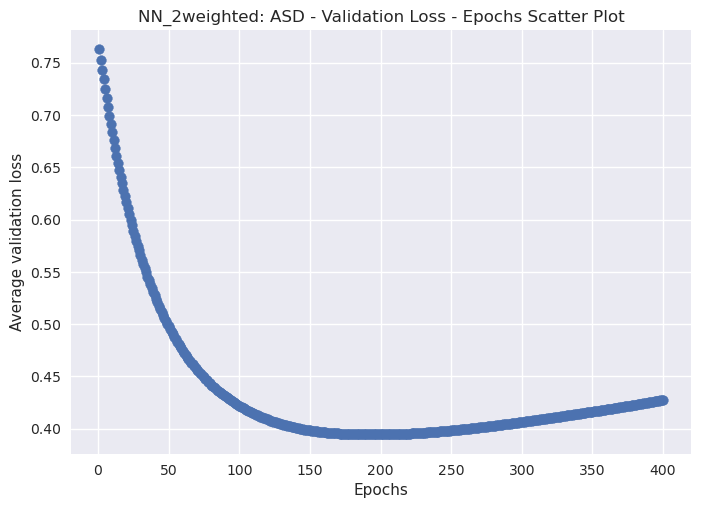

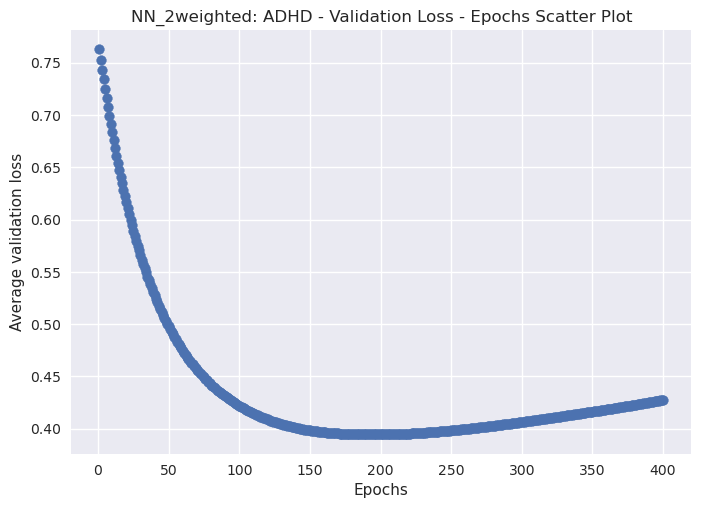

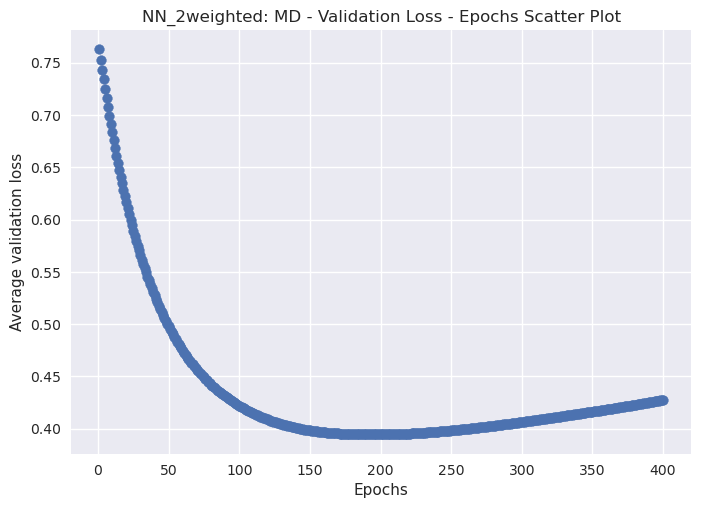

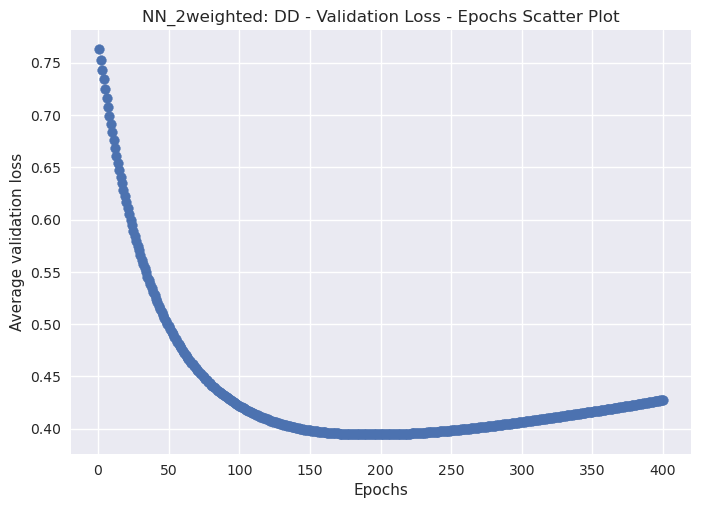

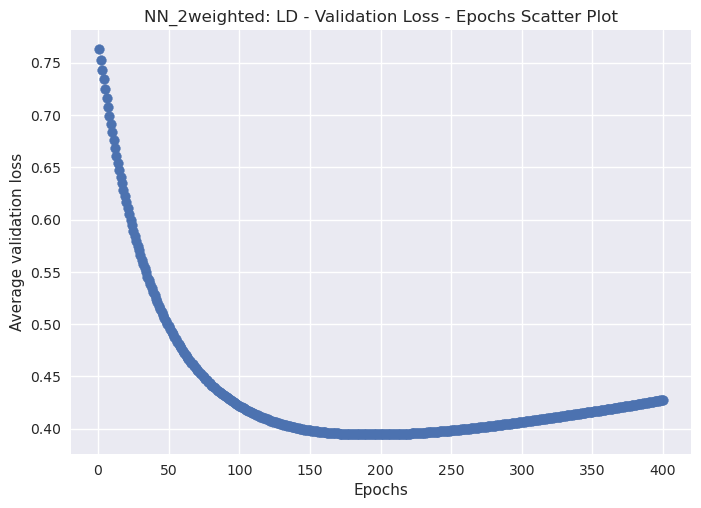

In [931]:
# Train model
model3na, loss_list, min_valid_loss, iter, suffix, plt \
= train_model(model3na, model3n_name, model_flag, model3na_output_dir,train_dlr, valid_dlr,  iter, epochs, loss_list, min_valid_loss, optimizer, scheduler, lam, NDD_labels)

0.3945659250020981
['anyNDD']


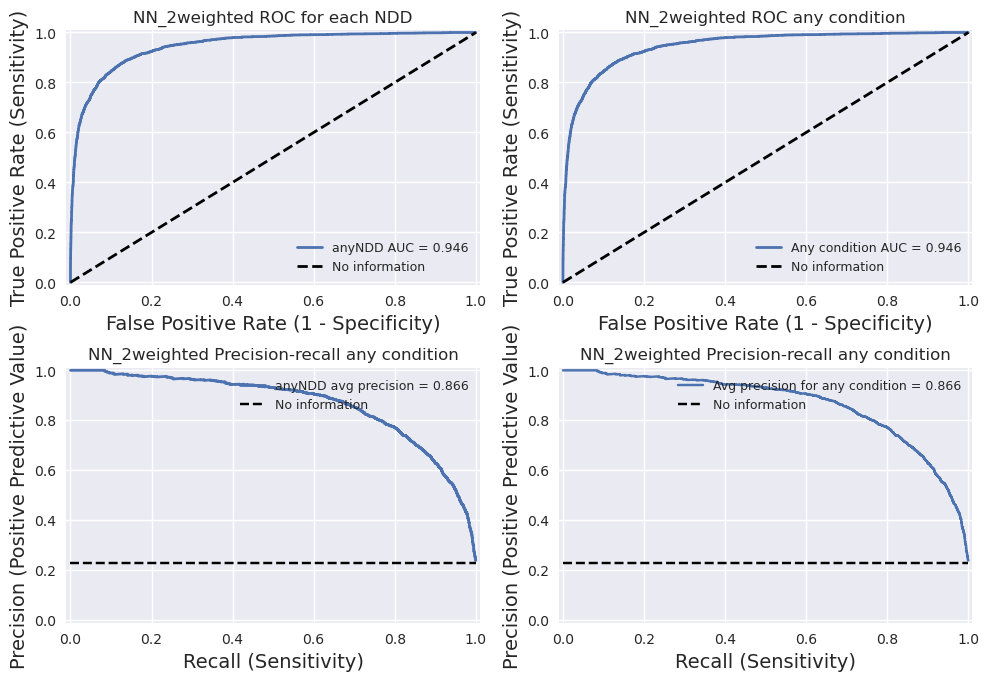

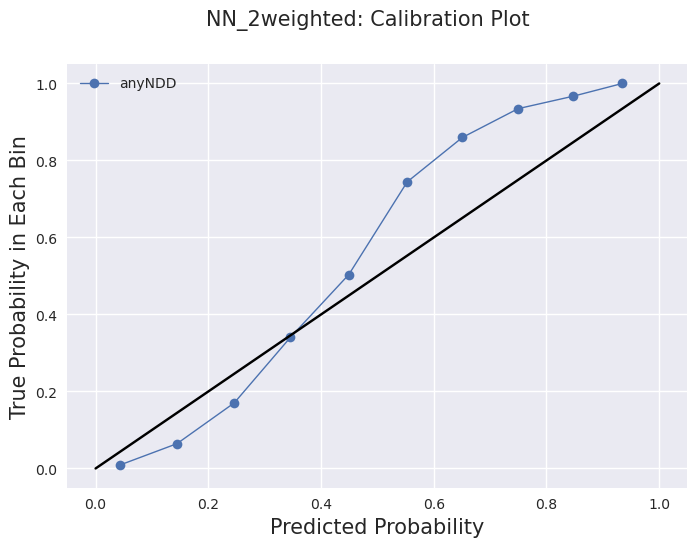

In [932]:
print(min_valid_loss)

# performance on test set (not used)
# y_target, y_pred, plt1, plt2 \
# = get_y_pred(model3na, model3n_name, model3na_output_dir, test_dlr, 'logit', suffix, NDD_label)

# Step b: use prediction from step a as a criteria to go into step b (predict each)
# Combined train and validation set to get prediction
tmp_X_train = X_train.to_numpy().astype(np.float32)
tmp_y_train = y_train_any.to_numpy().astype(np.float32)
tmp_set_train = TransData(xx=tmp_X_train, yy=tmp_y_train)
tmp_train_dlr = DataLoader(tmp_set_train, batch_size=batch_size, shuffle=False)

# output the prediction for training and validation set
y_train_target, y_train_pred, plt1, plt2 \
= get_y_pred(model3na, model3n_name, model3na_output_dir, tmp_train_dlr, 'logit', suffix, ['anyNDD'])

# threshold prediction data to determine which samples goes into step b
y_train_pred = np.array(y_train_pred)

In [1000]:
model3nb = MTLnet(input_dim,len(y_train_each.columns))
model3nb.to(device)
print(model3nb)
model3nb_output_dir = RESULT_DIR + '/' + model3n_name + '/b/'
model_flag = 'L21'

MTLnet(
  (flatten): Flatten(start_dim=1, end_dim=-1)
  (linear_sigmoid_stack): Sequential(
    (0): Linear(in_features=560, out_features=100, bias=True)
    (1): ReLU()
    (2): Linear(in_features=100, out_features=5, bias=True)
  )
)


In [1001]:
# start from step b (step a is the same as model3)
W_train = y_train_pred
if not os.path.exists(model3nb_output_dir):
        os.makedirs(model3nb_output_dir)
pickle.dump(y_train_pred, open(model3nb_output_dir + 'y_train_pred.p','wb'))

learning rate loop:   0%|          | 0/20 [00:00<?, ?it/s]

regularization lambda loop:   0%|          | 0/20 [00:00<?, ?it/s]

regularization lambda loop:   0%|          | 0/20 [00:00<?, ?it/s]

regularization lambda loop:   0%|          | 0/20 [00:00<?, ?it/s]

regularization lambda loop:   0%|          | 0/20 [00:00<?, ?it/s]

regularization lambda loop:   0%|          | 0/20 [00:00<?, ?it/s]

regularization lambda loop:   0%|          | 0/20 [00:00<?, ?it/s]

regularization lambda loop:   0%|          | 0/20 [00:00<?, ?it/s]

regularization lambda loop:   0%|          | 0/20 [00:00<?, ?it/s]

regularization lambda loop:   0%|          | 0/20 [00:00<?, ?it/s]

regularization lambda loop:   0%|          | 0/20 [00:00<?, ?it/s]

regularization lambda loop:   0%|          | 0/20 [00:00<?, ?it/s]

regularization lambda loop:   0%|          | 0/20 [00:00<?, ?it/s]

regularization lambda loop:   0%|          | 0/20 [00:00<?, ?it/s]

regularization lambda loop:   0%|          | 0/20 [00:00<?, ?it/s]

regularization lambda loop:   0%|          | 0/20 [00:00<?, ?it/s]

regularization lambda loop:   0%|          | 0/20 [00:00<?, ?it/s]

regularization lambda loop:   0%|          | 0/20 [00:00<?, ?it/s]

regularization lambda loop:   0%|          | 0/20 [00:00<?, ?it/s]

regularization lambda loop:   0%|          | 0/20 [00:00<?, ?it/s]

regularization lambda loop:   0%|          | 0/20 [00:00<?, ?it/s]

The new directory is created!
Best lambda, learning_rate, loss is [0.1        0.03359818 0.00027113]


<module 'matplotlib.pyplot' from '/scratch/wh173/Anaconda/lib/python3.9/site-packages/matplotlib/pyplot.py'>

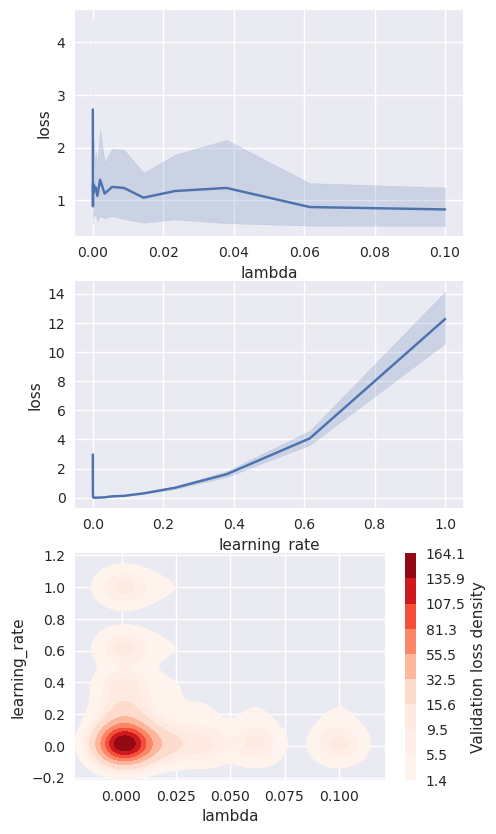

In [991]:
lams = np.logspace(-5, -1, 20) # 1,...,1000
learning_rates = np.logspace(-4, 0, 20) # 10^-5,...,10^-2
hyperparameter_tuning(model3nb, model3n_name + '/b/', X_train*W_train, y_train_each, model_flag, lams=lams, lr=learning_rates)

# linear signal_strength=2, similarity=0.8, nlatent=5, 'L21'
# -- 0.0001, 0.0001, epoch=800, minvalloss = 1.12, ASDAUC = 0.794

In [1002]:
# Use best hyperparameters for logistic regression
lam = 0.0001 # L1 regularization, get from cross-validation
learning_rate = 0.0005
epochs = 800 #  has the lowest validation loss
optimizer = torch.optim.Adam(model3nb.parameters(), lr=learning_rate)

stratify=y_train_each[['ASD_flag','DD_flag','LD_flag']]
train_dlr, valid_dlr, test_dlr = split_trainvaltest(X_train*W_train, y_train_each, stratify, X_test, y_test_each)

# initialize validation loss during training
loss_list = []  # track the loss change when training
iter = 0
min_valid_loss = 10000 # initialize as a large number

Dataset dimensions are (9648, 560) (9648, 5) (2412, 560) (2412, 5) (5940, 560) (5940, 5)


Training Epochs:   0%|          | 0/800 [00:00<?, ?it/s]

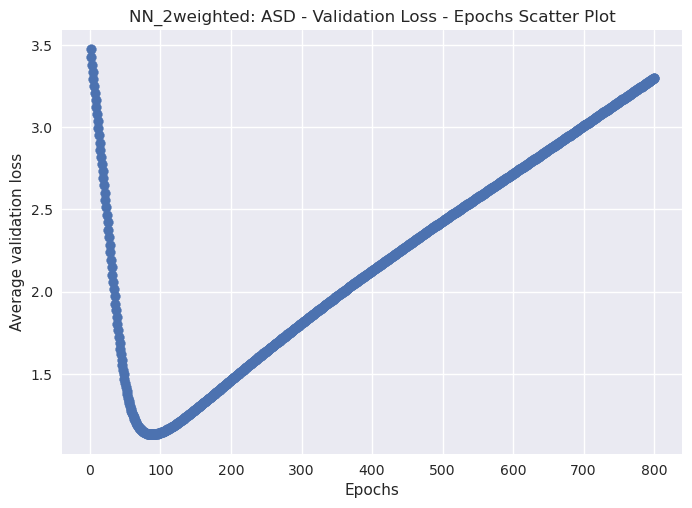

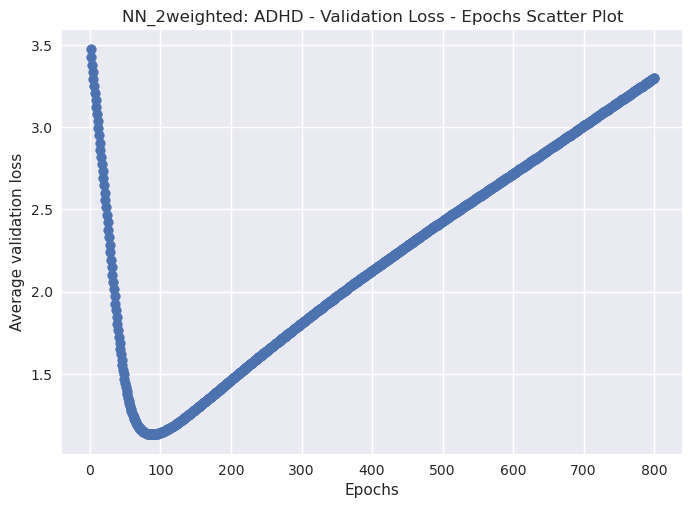

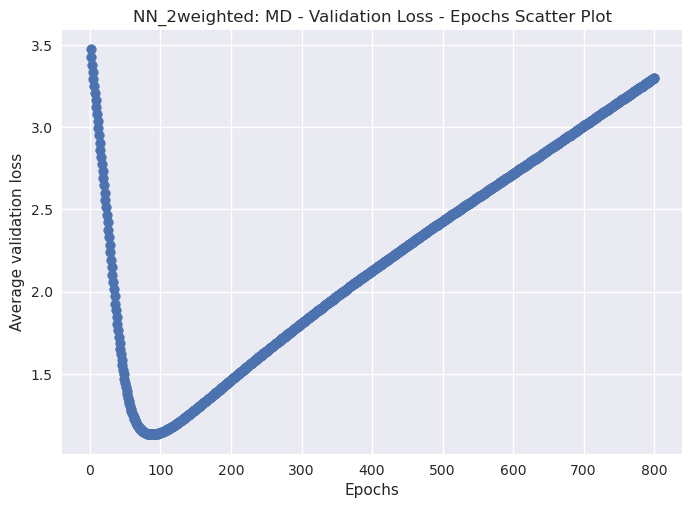

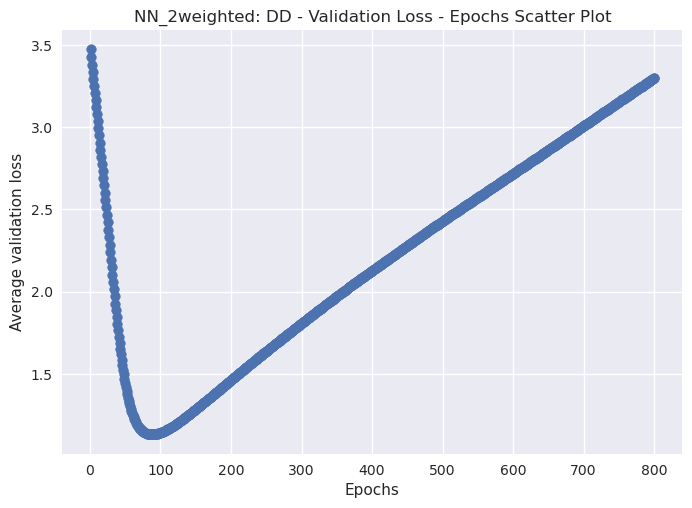

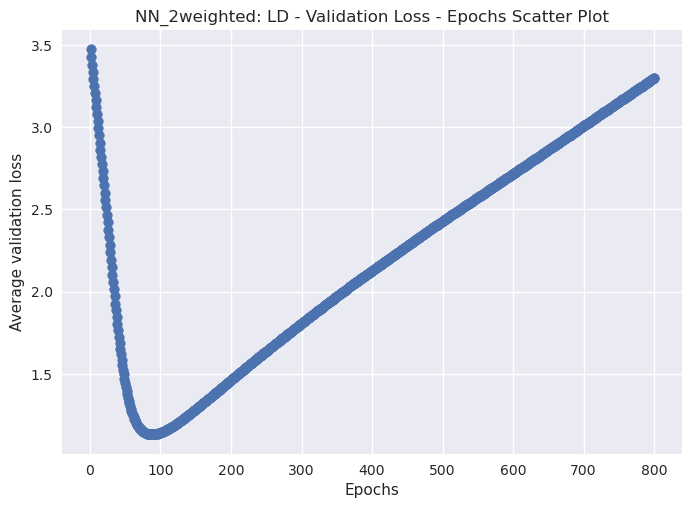

In [1003]:
# Train model
model3nb, loss_list, min_valid_loss, iter, suffix, plt \
= train_model(model3nb, model3n_name, model_flag, model3nb_output_dir, train_dlr, valid_dlr, iter, epochs, loss_list, min_valid_loss, optimizer, scheduler, lam, NDD_labels)

1.132769227027893
['ASD', 'ADHD', 'MD', 'DD', 'LD']


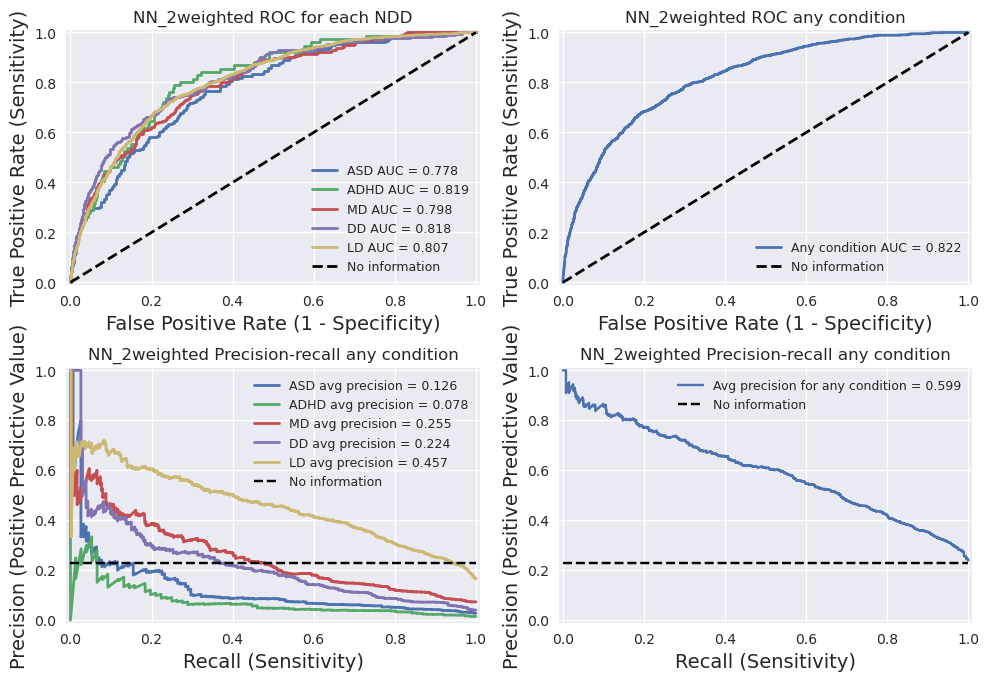

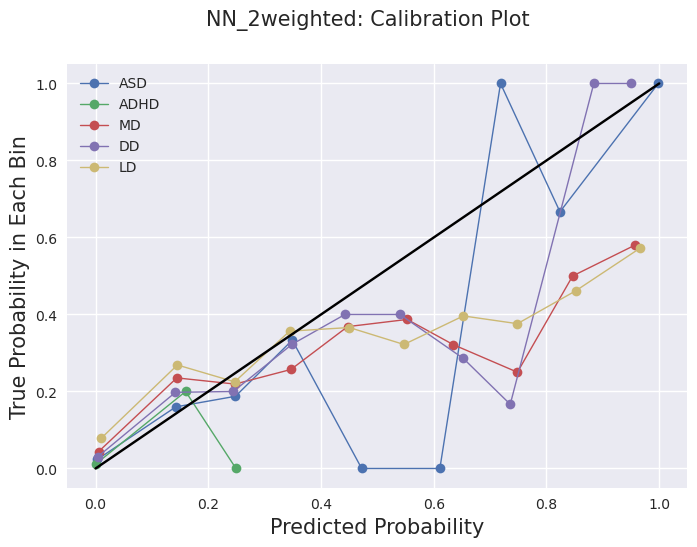

In [1004]:
# test results
print(min_valid_loss)
y_target, y_pred, plt1, plt2 \
= get_y_pred(model3nb, model3n_name, model3nb_output_dir, test_dlr, 'logit', suffix, NDD_labels)

## 3.9 Model 9

In [1013]:
model9n_name = 'NN_2in1weighted'
input_dim = len(X_train.columns) # number of input features 
output_dim = len(y_train.columns) # number of output labels: each+NDD
model9n = MTLnet(input_dim,output_dim)
model9n.to(device)
model_flag = '2in1weighted'
model9n_output_dir = RESULT_DIR + '/' + model9n_name
print(model9n)

MTLnet(
  (flatten): Flatten(start_dim=1, end_dim=-1)
  (linear_sigmoid_stack): Sequential(
    (0): Linear(in_features=560, out_features=100, bias=True)
    (1): ReLU()
    (2): Linear(in_features=100, out_features=6, bias=True)
  )
)


learning rate loop:   0%|          | 0/20 [00:00<?, ?it/s]

regularization lambda loop:   0%|          | 0/20 [00:00<?, ?it/s]

regularization lambda loop:   0%|          | 0/20 [00:00<?, ?it/s]

regularization lambda loop:   0%|          | 0/20 [00:00<?, ?it/s]

regularization lambda loop:   0%|          | 0/20 [00:00<?, ?it/s]

regularization lambda loop:   0%|          | 0/20 [00:00<?, ?it/s]

regularization lambda loop:   0%|          | 0/20 [00:00<?, ?it/s]

regularization lambda loop:   0%|          | 0/20 [00:00<?, ?it/s]

regularization lambda loop:   0%|          | 0/20 [00:00<?, ?it/s]

regularization lambda loop:   0%|          | 0/20 [00:00<?, ?it/s]

regularization lambda loop:   0%|          | 0/20 [00:00<?, ?it/s]

regularization lambda loop:   0%|          | 0/20 [00:00<?, ?it/s]

regularization lambda loop:   0%|          | 0/20 [00:00<?, ?it/s]

regularization lambda loop:   0%|          | 0/20 [00:00<?, ?it/s]

regularization lambda loop:   0%|          | 0/20 [00:00<?, ?it/s]

regularization lambda loop:   0%|          | 0/20 [00:00<?, ?it/s]

regularization lambda loop:   0%|          | 0/20 [00:00<?, ?it/s]

regularization lambda loop:   0%|          | 0/20 [00:00<?, ?it/s]

regularization lambda loop:   0%|          | 0/20 [00:00<?, ?it/s]

regularization lambda loop:   0%|          | 0/20 [00:00<?, ?it/s]

regularization lambda loop:   0%|          | 0/20 [00:00<?, ?it/s]

The new directory is created!
Best lambda, learning_rate, loss is [0.00127427 0.08858668 0.        ]


<module 'matplotlib.pyplot' from '/scratch/wh173/Anaconda/lib/python3.9/site-packages/matplotlib/pyplot.py'>

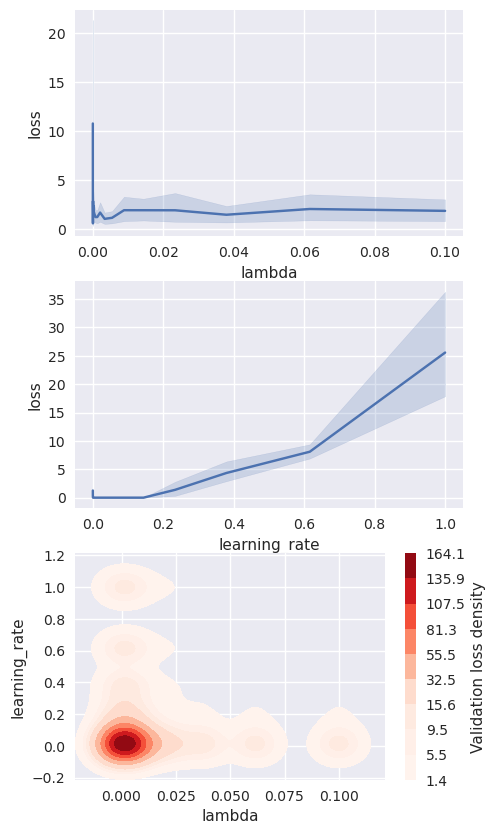

In [955]:
lams = np.logspace(-5, -1, 20) # 1,...,1000
learning_rates = np.logspace(-4, 0, 20) # 10^-5,...,10^-2
# learning rate should not matter too much since this is a convex problem
hyperparameter_tuning(model9n, model9n_name, X_train, y_train, model_flag=model_flag, lams=lams, lr=learning_rates)

# linear signal_strength=2, similarity=0.8, nlatent=5
# -- 0.001, 0.01, minvalloss = 0.364, ASDAUC = 0.811, ANY=0.70

In [1014]:
# Use best hyperparameters
lam = 0.001 #0.0002
learning_rate = 0.005 #0.008

epochs = 400 # has the lowest validation loss    
optimizer = optim.Adam(model9n.parameters(), lr=learning_rate) # switch to Adam 2/21/2023
stratify=y_train[['ASD_flag','LD_flag']]
train_dlr, valid_dlr, test_dlr = split_trainvaltest(X_train, y_train, stratify, X_test, y_test)

numbatches = len(train_dlr)
scheduler = []

# plot validation loss during training
loss_list = []  # track the loss change when training
iter = 0
min_valid_loss = 10000 # initialize as a large number

Dataset dimensions are (9648, 560) (9648, 6) (2412, 560) (2412, 6) (5940, 560) (5940, 6)


Training Epochs:   0%|          | 0/400 [00:00<?, ?it/s]

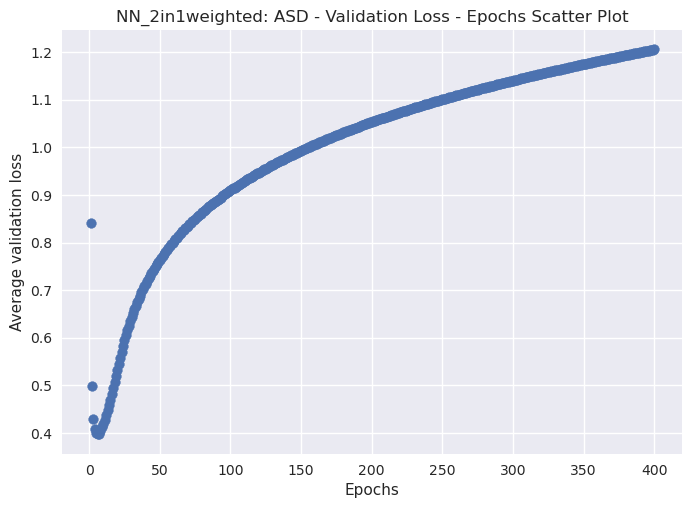

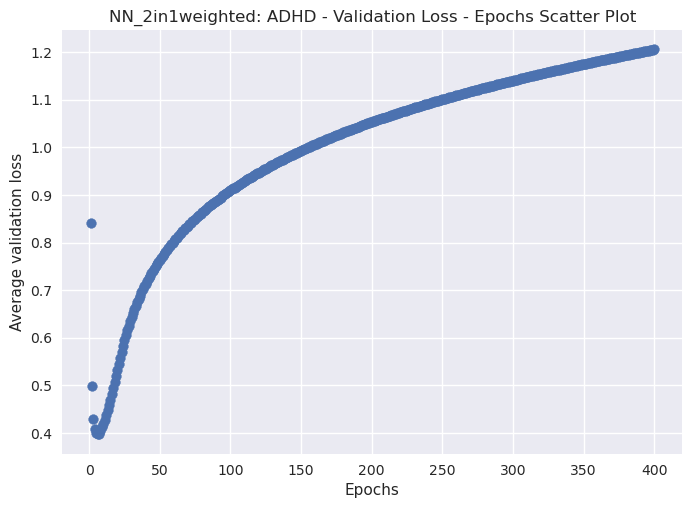

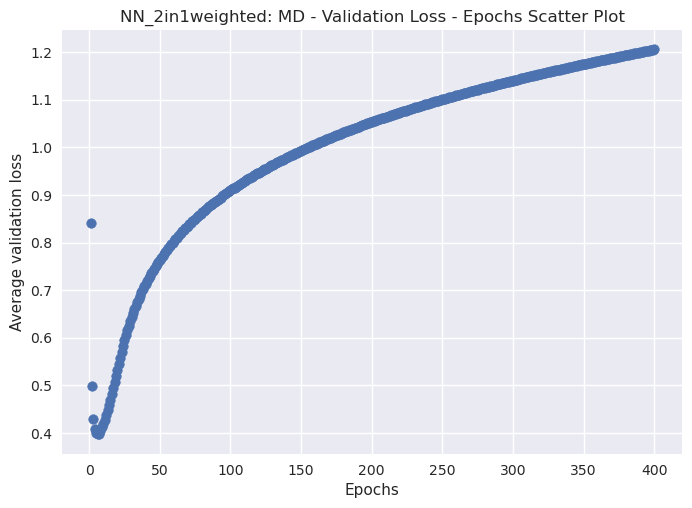

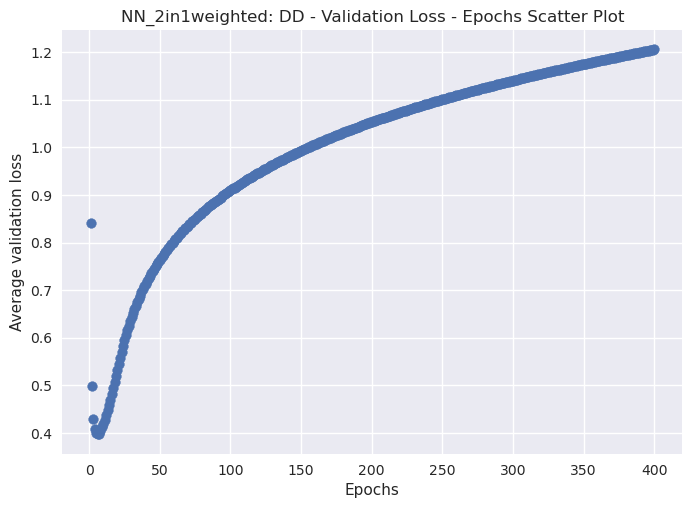

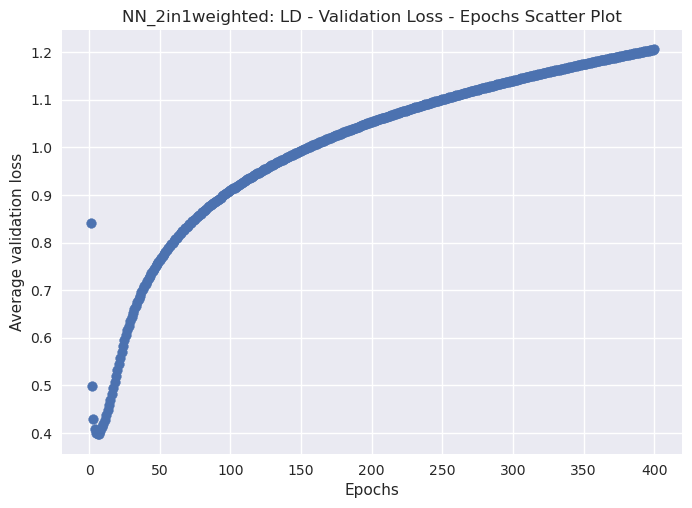

In [1015]:
# Train model
model9n, loss_list, min_valid_loss, iter, suffix, plt \
= train_model(model9n, model9n_name, model_flag, model9n_output_dir, train_dlr, valid_dlr, iter, epochs, loss_list, min_valid_loss, optimizer, scheduler, lam, NDD_labels)

0.39714086055755615
['ASD', 'ADHD', 'MD', 'DD', 'LD']


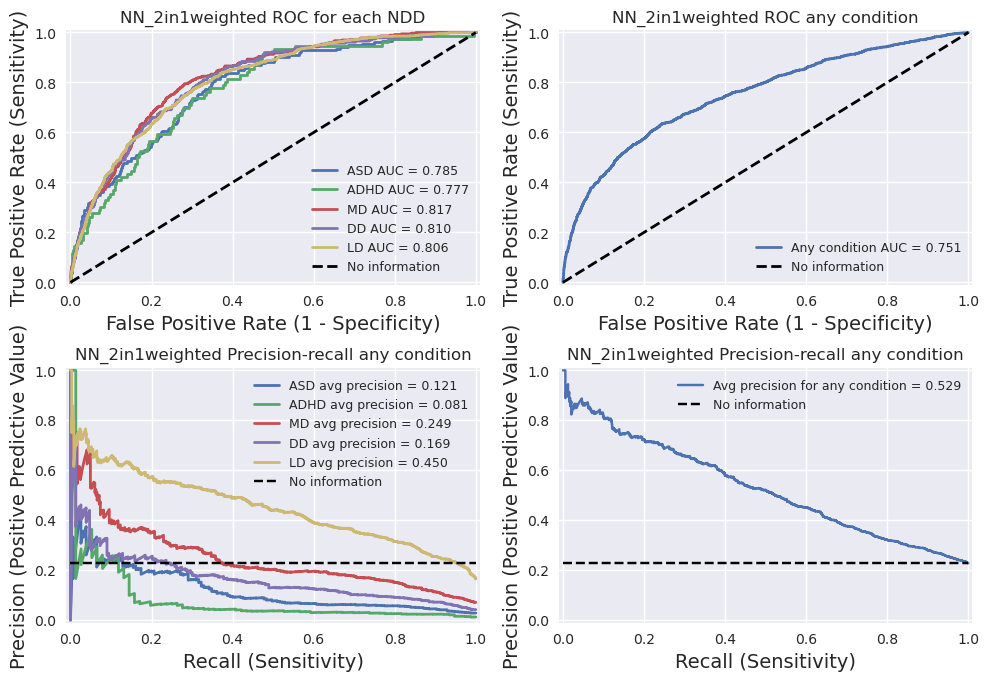

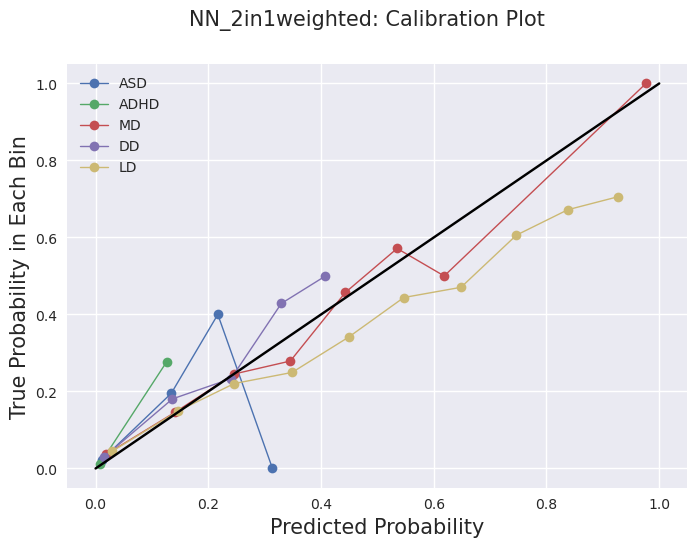

In [1016]:
# Test results
print(min_valid_loss)
y_target, y_pred, plt1, plt2 \
= get_y_pred(model9n, model9n_name, model9n_output_dir, test_dlr, 'logit', suffix, NDD_labels)

## 3.10 Model 10

In [1310]:
model10n_name = 'NN_2weighted_1L'
input_dim = len(X_train.columns) # number of input features 
output_dim = len(y_train_any.columns) # 1/0
model10na = MTLnet(input_dim,output_dim)
model10na.to(device)
print(model10na)
model10na_output_dir = RESULT_DIR + '/' + model10n_name + '/a/'
model10n_output_dir = RESULT_DIR + '/' + model10n_name
model_flag = 0

MTLnet(
  (flatten): Flatten(start_dim=1, end_dim=-1)
  (linear_sigmoid_stack): Sequential(
    (0): Linear(in_features=560, out_features=100, bias=True)
    (1): ReLU()
    (2): Linear(in_features=100, out_features=1, bias=True)
  )
)


learning rate loop:   0%|          | 0/20 [00:00<?, ?it/s]

regularization lambda loop:   0%|          | 0/20 [00:00<?, ?it/s]

regularization lambda loop:   0%|          | 0/20 [00:00<?, ?it/s]

regularization lambda loop:   0%|          | 0/20 [00:00<?, ?it/s]

regularization lambda loop:   0%|          | 0/20 [00:00<?, ?it/s]

regularization lambda loop:   0%|          | 0/20 [00:00<?, ?it/s]

regularization lambda loop:   0%|          | 0/20 [00:00<?, ?it/s]

regularization lambda loop:   0%|          | 0/20 [00:00<?, ?it/s]

regularization lambda loop:   0%|          | 0/20 [00:00<?, ?it/s]

regularization lambda loop:   0%|          | 0/20 [00:00<?, ?it/s]

regularization lambda loop:   0%|          | 0/20 [00:00<?, ?it/s]

regularization lambda loop:   0%|          | 0/20 [00:00<?, ?it/s]

regularization lambda loop:   0%|          | 0/20 [00:00<?, ?it/s]

regularization lambda loop:   0%|          | 0/20 [00:00<?, ?it/s]

regularization lambda loop:   0%|          | 0/20 [00:00<?, ?it/s]

regularization lambda loop:   0%|          | 0/20 [00:00<?, ?it/s]

regularization lambda loop:   0%|          | 0/20 [00:00<?, ?it/s]

regularization lambda loop:   0%|          | 0/20 [00:00<?, ?it/s]

regularization lambda loop:   0%|          | 0/20 [00:00<?, ?it/s]

regularization lambda loop:   0%|          | 0/20 [00:00<?, ?it/s]

regularization lambda loop:   0%|          | 0/20 [00:00<?, ?it/s]

The new directory is created!
Best lambda, learning_rate, loss is [4.28133240e-05 1.27427499e-02 9.85594373e-03]


<module 'matplotlib.pyplot' from '/scratch/wh173/Anaconda/lib/python3.9/site-packages/matplotlib/pyplot.py'>

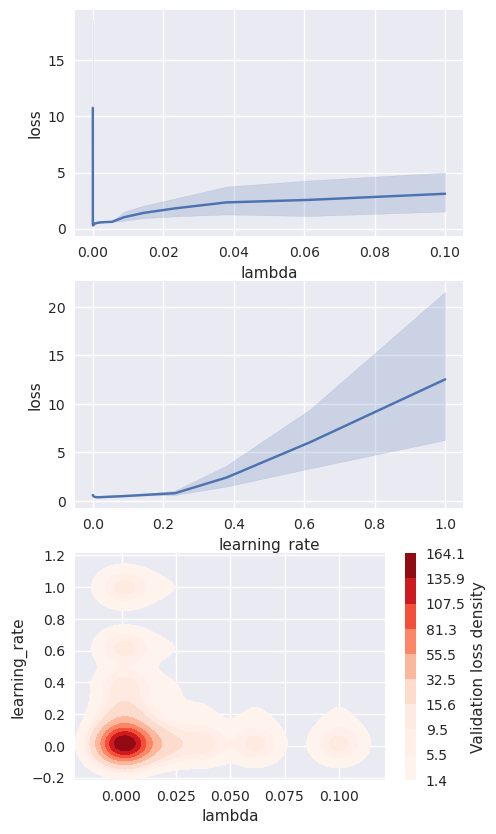

In [444]:
lams = np.logspace(-5, -1, 20) # 1,...,1000
learning_rates = np.logspace(-4, 0, 20) # 10^-5,...,10^-2
hyperparameter_tuning(model3na, model3n_name + '/a/', X_train, y_train_any, model_flag=model_flag, lams=lams, lr=learning_rates)

# linear signal_strength=2, similarity=0.8, nlatent=5
# -- 0.0001, 0.0001, epoch=400, minvalloss = 0.393, anyAUC = 0.948

In [1311]:
# Use best hyperparameters for logistic regression
lam = 0.0001
learning_rate = 0.0001
epochs = 400
optimizer = torch.optim.Adam(model10na.parameters(), lr=learning_rate)

stratify=y_train_any
train_dlr, valid_dlr, test_dlr = split_trainvaltest(X_train, y_train_any, stratify, X_test, y_test_any)
numbatches = len(train_dlr)
scheduler = []

# initialize validation loss during training
loss_list = []  # track the loss change when training
iter = 0
min_valid_loss = 10000 # initialize as a large number

Dataset dimensions are (9648, 560) (9648, 1) (2412, 560) (2412, 1) (5940, 560) (5940, 1)


Training Epochs:   0%|          | 0/400 [00:00<?, ?it/s]

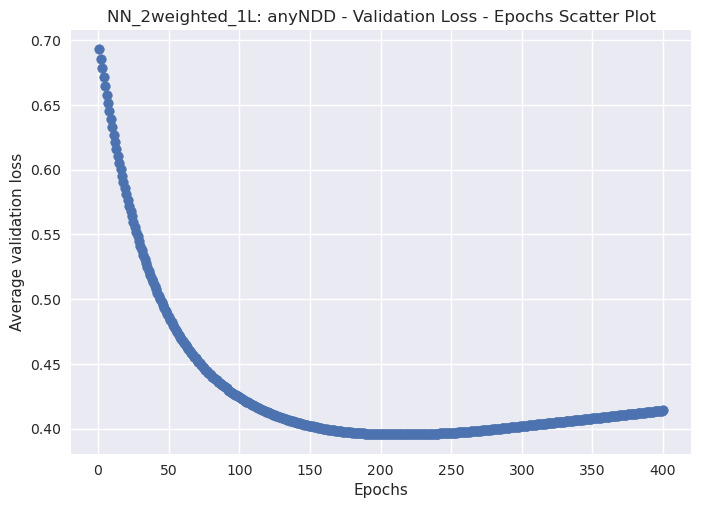

In [1312]:
# Train model
model10na, loss_list, min_valid_loss, iter, suffix, plt \
= train_model(model10na, model10n_name, model_flag, model10na_output_dir,train_dlr, valid_dlr,  iter, epochs, loss_list, min_valid_loss, optimizer, scheduler, lam, ['anyNDD'])

0.39555738866329193
['anyNDD']


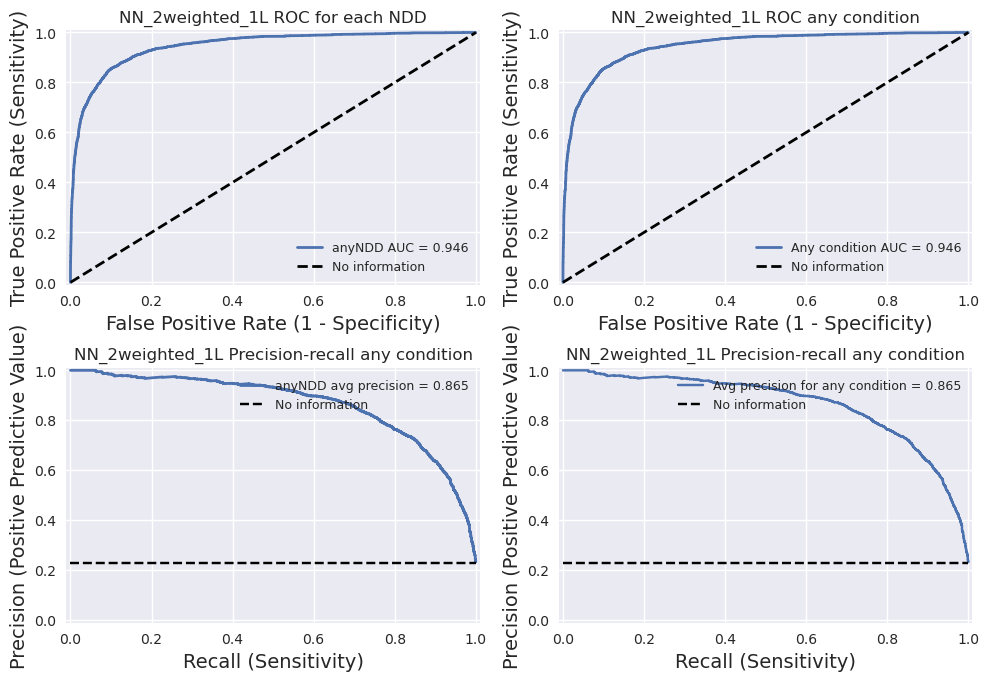

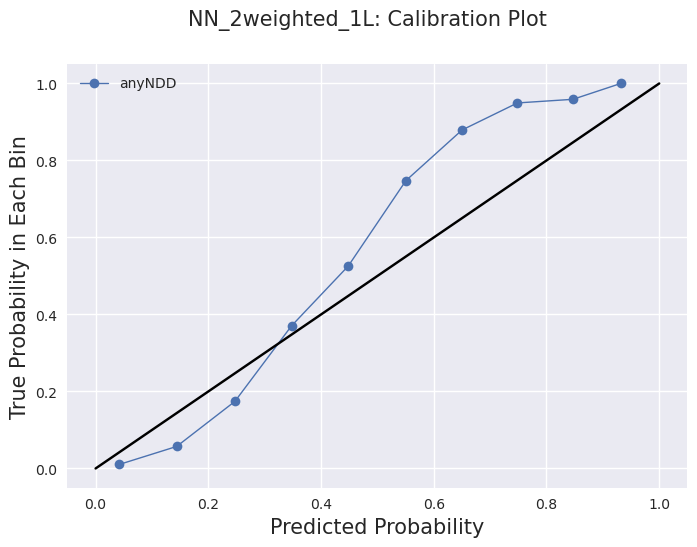

In [1313]:
print(min_valid_loss)

# performance on test set (not used)
# y_target, y_pred, plt1, plt2 \
# = get_y_pred(model3na, model3n_name, model3na_output_dir, test_dlr, 'logit', suffix, NDD_label)

# Step b: use prediction from step a as a criteria to go into step b (predict each)
# Combined train and validation set to get prediction
tmp_X_train = X_train.to_numpy().astype(np.float32)
tmp_y_train = y_train_any.to_numpy().astype(np.float32)
tmp_set_train = TransData(xx=tmp_X_train, yy=tmp_y_train)
tmp_train_dlr = DataLoader(tmp_set_train, batch_size=batch_size, shuffle=False)

# output the prediction for training and validation set
y_train_target, y_train_pred, plt1, plt2 \
= get_y_pred(model10na, model10n_name, model10na_output_dir, tmp_train_dlr, 'logit', suffix, ['anyNDD'])

# threshold prediction data to determine which samples goes into step b
y_train_pred = np.array(y_train_pred)

In [1380]:
model10nb = MTLnet(input_dim,len(y_train_asd.columns))
model10nb.to(device)
print(model3nb)
model10nb_output_dir = RESULT_DIR + '/' + model10n_name + '/b/'
model_flag = 0

MTLnet(
  (flatten): Flatten(start_dim=1, end_dim=-1)
  (linear_sigmoid_stack): Sequential(
    (0): Linear(in_features=560, out_features=100, bias=True)
    (1): ReLU()
    (2): Linear(in_features=100, out_features=5, bias=True)
  )
)


In [1381]:
# start from step b (step a is the same as model3)
W_train = y_train_pred
if not os.path.exists(model10nb_output_dir):
        os.makedirs(model10nb_output_dir)
pickle.dump(y_train_pred, open(model10nb_output_dir + 'y_train_pred.p','wb'))

learning rate loop:   0%|          | 0/20 [00:00<?, ?it/s]

regularization lambda loop:   0%|          | 0/20 [00:00<?, ?it/s]

regularization lambda loop:   0%|          | 0/20 [00:00<?, ?it/s]

regularization lambda loop:   0%|          | 0/20 [00:00<?, ?it/s]

regularization lambda loop:   0%|          | 0/20 [00:00<?, ?it/s]

regularization lambda loop:   0%|          | 0/20 [00:00<?, ?it/s]

regularization lambda loop:   0%|          | 0/20 [00:00<?, ?it/s]

regularization lambda loop:   0%|          | 0/20 [00:00<?, ?it/s]

regularization lambda loop:   0%|          | 0/20 [00:00<?, ?it/s]

regularization lambda loop:   0%|          | 0/20 [00:00<?, ?it/s]

regularization lambda loop:   0%|          | 0/20 [00:00<?, ?it/s]

regularization lambda loop:   0%|          | 0/20 [00:00<?, ?it/s]

regularization lambda loop:   0%|          | 0/20 [00:00<?, ?it/s]

regularization lambda loop:   0%|          | 0/20 [00:00<?, ?it/s]

regularization lambda loop:   0%|          | 0/20 [00:00<?, ?it/s]

regularization lambda loop:   0%|          | 0/20 [00:00<?, ?it/s]

regularization lambda loop:   0%|          | 0/20 [00:00<?, ?it/s]

regularization lambda loop:   0%|          | 0/20 [00:00<?, ?it/s]

regularization lambda loop:   0%|          | 0/20 [00:00<?, ?it/s]

regularization lambda loop:   0%|          | 0/20 [00:00<?, ?it/s]

regularization lambda loop:   0%|          | 0/20 [00:00<?, ?it/s]

Best lambda, learning_rate, loss is [3.35981829e-05 6.15848211e-03 1.49171823e-03]


<module 'matplotlib.pyplot' from '/scratch/wh173/Anaconda/lib/python3.9/site-packages/matplotlib/pyplot.py'>

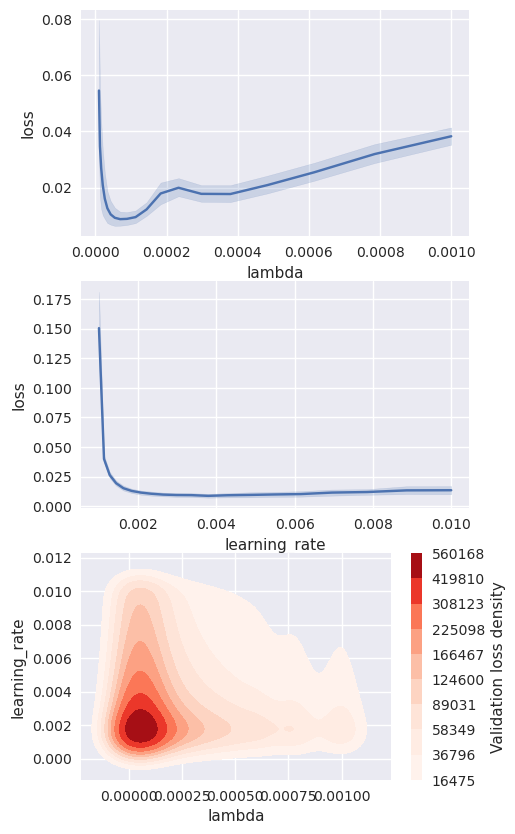

In [1339]:
lams = np.logspace(-5, -3, 20) # 1,...,1000
learning_rates = np.logspace(-3, -2, 20) # 10^-5,...,10^-2
hyperparameter_tuning(model10nb, model10n_name + '/b/', X_train*W_train, y_train_asd, model_flag, lams=lams, lr=learning_rates)

# -- 0.0001, 0.05, minloss = 0.154, ASDAUC = 0.726

In [1382]:
# Use best hyperparameters for logistic regression
lam = 0.0001 # L1 regularization, get from cross-validation
learning_rate = 0.05
epochs = 200 #  has the lowest validation loss
optimizer = torch.optim.Adam(model10nb.parameters(), lr=learning_rate)

stratify=y_train_asd
train_dlr, valid_dlr, test_dlr = split_trainvaltest(X_train*W_train, y_train_asd, stratify, X_test, y_test_asd)

# initialize validation loss during training
loss_list = []  # track the loss change when training
iter = 0
min_valid_loss = 10000 # initialize as a large number

Dataset dimensions are (9648, 560) (9648, 1) (2412, 560) (2412, 1) (5940, 560) (5940, 1)


Training Epochs:   0%|          | 0/200 [00:00<?, ?it/s]

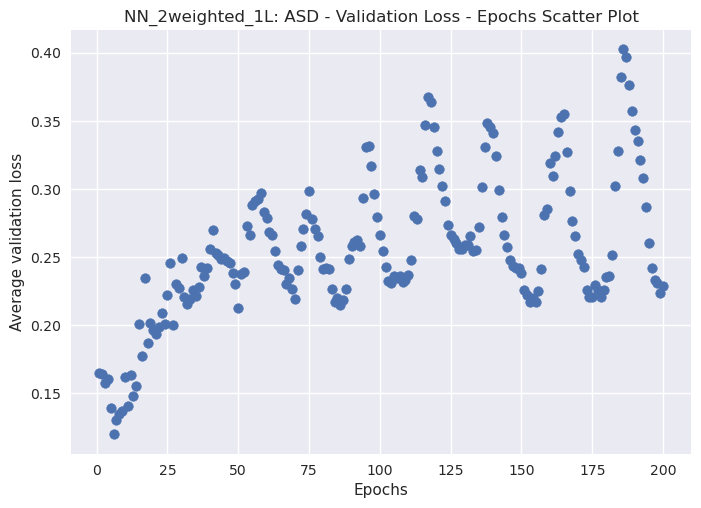

In [1383]:
# Train model
model10nb, loss_list, min_valid_loss, iter, suffix, plt \
= train_model(model10nb, model10n_name, model_flag, model10nb_output_dir, train_dlr, valid_dlr, iter, epochs, loss_list, min_valid_loss, optimizer, scheduler, lam, [NDD_labels[0]])

0.11990660801529884
['ASD']


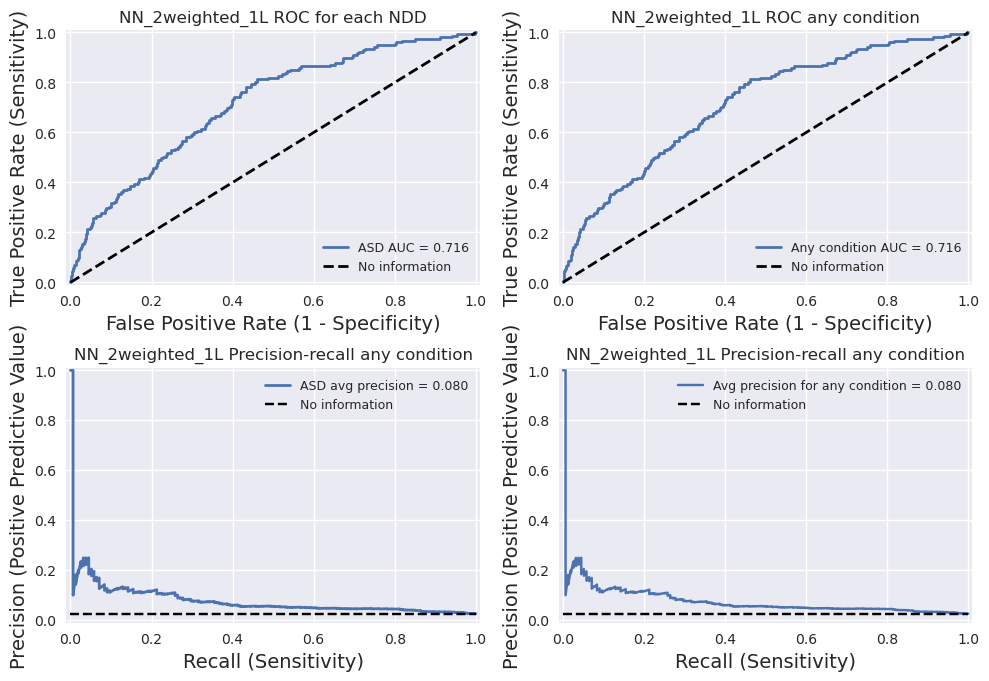

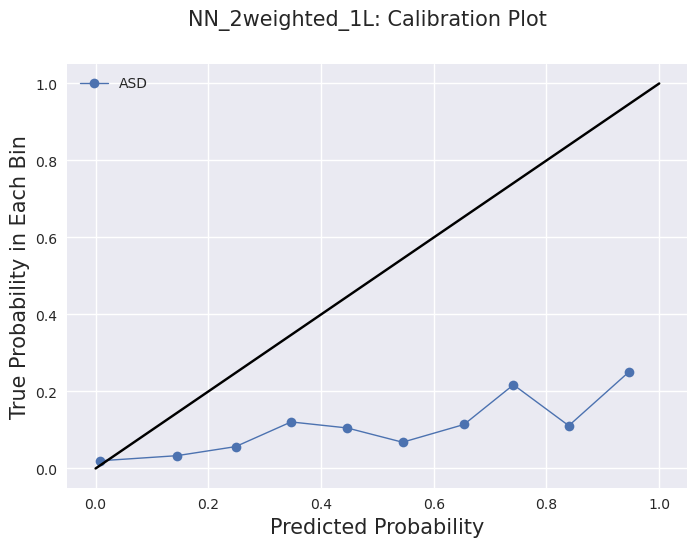

In [1384]:
# test results
print(min_valid_loss)
y_target, y_pred, plt1, plt2 \
= get_y_pred(model10nb, model10n_name, model10nb_output_dir, test_dlr, 'logit', suffix, [NDD_labels[0]])

## 3.11 Model 11

In [1235]:
model11n_name = 'NN_2in1weighted_1L'
input_dim = len(X_train.columns) # number of input features 
output_dim = len(y_train_asd_any.columns) # number of output labels: each+NDD
model11n = MTLnet(input_dim,output_dim)
model11n.to(device)
model_flag = '2in1weighted'
model11n_output_dir = RESULT_DIR + '/' + model11n_name
print(model11n)

MTLnet(
  (flatten): Flatten(start_dim=1, end_dim=-1)
  (linear_sigmoid_stack): Sequential(
    (0): Linear(in_features=560, out_features=100, bias=True)
    (1): ReLU()
    (2): Linear(in_features=100, out_features=2, bias=True)
  )
)


learning rate loop:   0%|          | 0/20 [00:00<?, ?it/s]

regularization lambda loop:   0%|          | 0/20 [00:00<?, ?it/s]

regularization lambda loop:   0%|          | 0/20 [00:00<?, ?it/s]

regularization lambda loop:   0%|          | 0/20 [00:00<?, ?it/s]

regularization lambda loop:   0%|          | 0/20 [00:00<?, ?it/s]

regularization lambda loop:   0%|          | 0/20 [00:00<?, ?it/s]

regularization lambda loop:   0%|          | 0/20 [00:00<?, ?it/s]

regularization lambda loop:   0%|          | 0/20 [00:00<?, ?it/s]

regularization lambda loop:   0%|          | 0/20 [00:00<?, ?it/s]

regularization lambda loop:   0%|          | 0/20 [00:00<?, ?it/s]

regularization lambda loop:   0%|          | 0/20 [00:00<?, ?it/s]

regularization lambda loop:   0%|          | 0/20 [00:00<?, ?it/s]

regularization lambda loop:   0%|          | 0/20 [00:00<?, ?it/s]

regularization lambda loop:   0%|          | 0/20 [00:00<?, ?it/s]

regularization lambda loop:   0%|          | 0/20 [00:00<?, ?it/s]

regularization lambda loop:   0%|          | 0/20 [00:00<?, ?it/s]

regularization lambda loop:   0%|          | 0/20 [00:00<?, ?it/s]

regularization lambda loop:   0%|          | 0/20 [00:00<?, ?it/s]

regularization lambda loop:   0%|          | 0/20 [00:00<?, ?it/s]

regularization lambda loop:   0%|          | 0/20 [00:00<?, ?it/s]

regularization lambda loop:   0%|          | 0/20 [00:00<?, ?it/s]

Best lambda, learning_rate, loss is [4.28133240e-05 3.35981829e-02 4.42886190e-03]


<module 'matplotlib.pyplot' from '/scratch/wh173/Anaconda/lib/python3.9/site-packages/matplotlib/pyplot.py'>

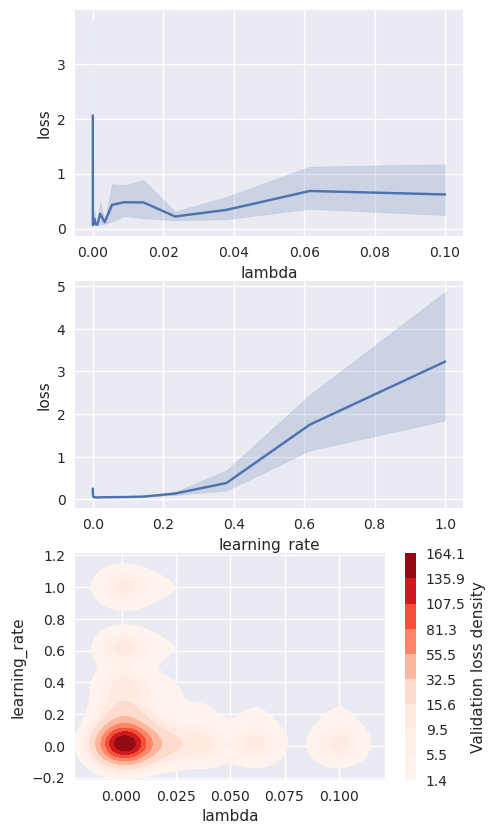

In [1202]:
lams = np.logspace(-5, -1, 20) # 1,...,1000
learning_rates = np.logspace(-4, 0, 20) # 10^-5,...,10^-2
# learning rate should not matter too much since this is a convex problem
hyperparameter_tuning(model11n, model11n_name, X_train, y_train_asd_any, model_flag=model_flag, lams=lams, lr=learning_rates)

# Best lambda, learning_rate, loss is
# -- 0.001, 0.01, minvalloss = 0.054, ASDAUC = 0.756


In [1236]:
# Use best hyperparameters
lam = 0.001 #0.0002
learning_rate = 0.01 #0.008

epochs = 400 # has the lowest validation loss    
optimizer = optim.Adam(model11n.parameters(), lr=learning_rate) # switch to Adam 2/21/2023
stratify=y_train_asd_any
train_dlr, valid_dlr, test_dlr = split_trainvaltest(X_train, y_train_asd_any, stratify, X_test, y_test_asd_any)

numbatches = len(train_dlr)
scheduler = []

# plot validation loss during training
loss_list = []  # track the loss change when training
iter = 0
min_valid_loss = 10000 # initialize as a large number

Dataset dimensions are (9648, 560) (9648, 2) (2412, 560) (2412, 2) (5940, 560) (5940, 2)


Training Epochs:   0%|          | 0/400 [00:00<?, ?it/s]

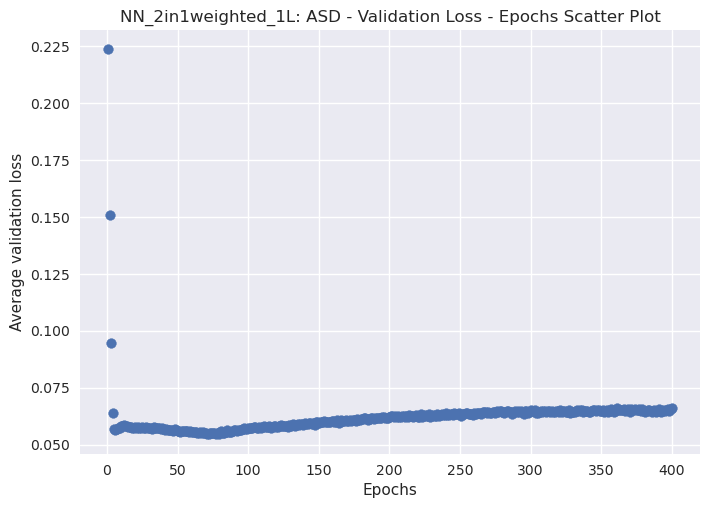

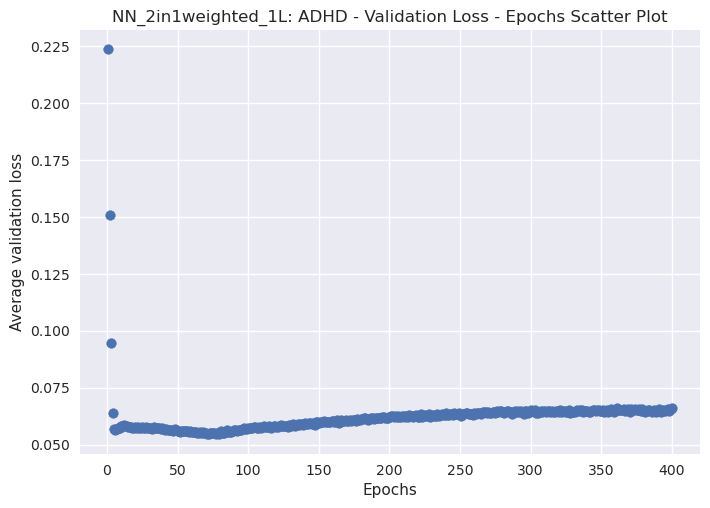

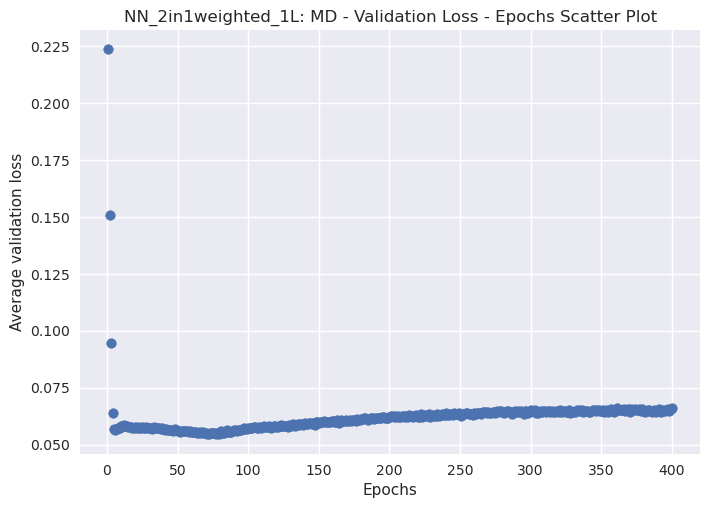

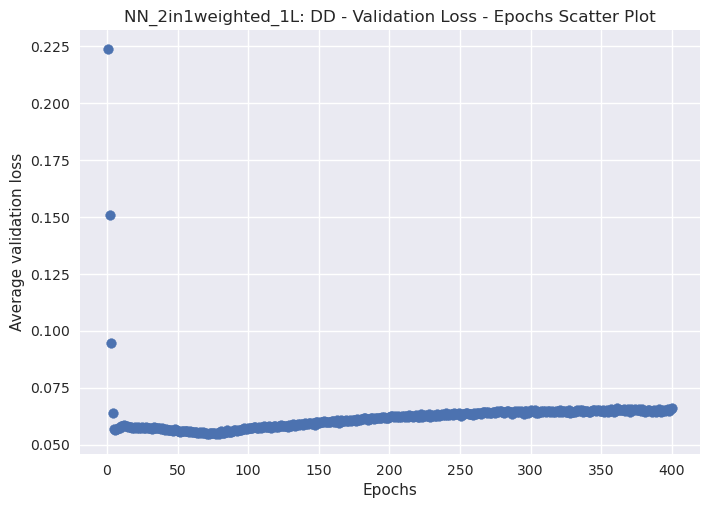

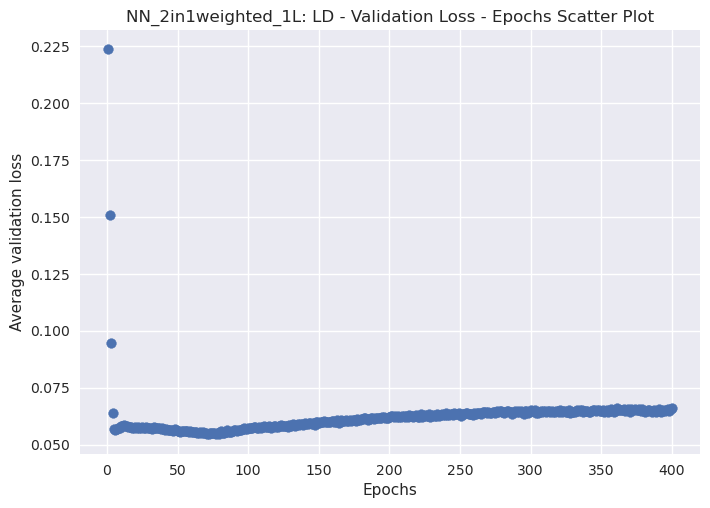

In [1237]:
# Train model
model11n, loss_list, min_valid_loss, iter, suffix, plt \
= train_model(model11n, model11n_name, model_flag, model11n_output_dir, train_dlr, valid_dlr, iter, epochs, loss_list, min_valid_loss, optimizer, scheduler, lam, NDD_labels)

0.05446147918701172
['ASD']


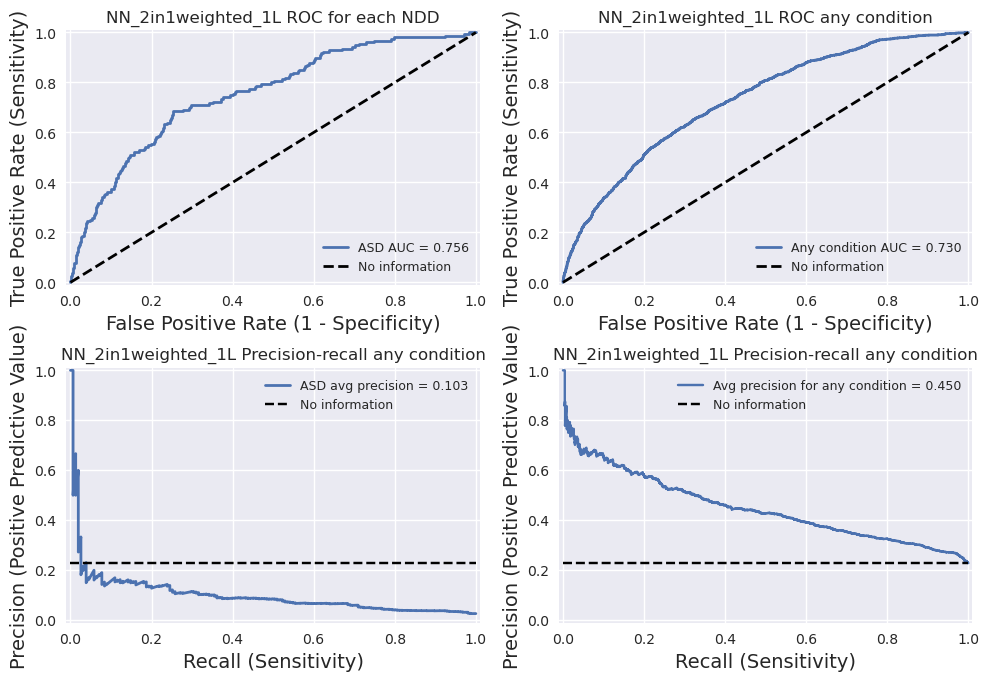

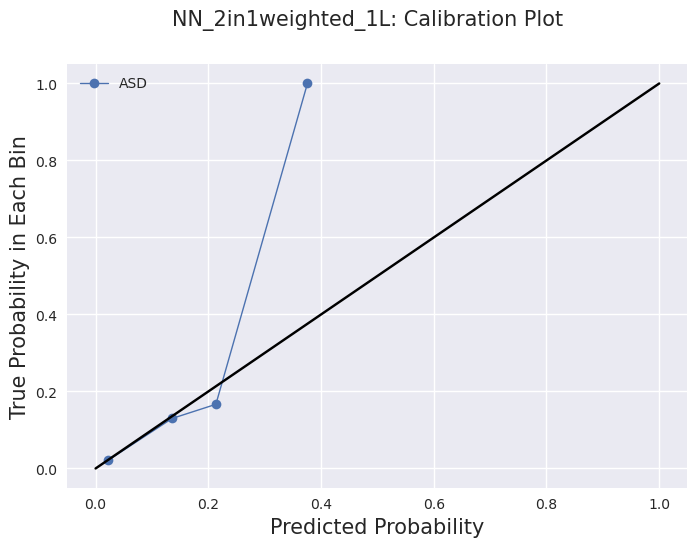

In [1238]:
# Test results
print(min_valid_loss)
y_target, y_pred, plt1, plt2 \
= get_y_pred(model11n, model11n_name, model11n_output_dir, test_dlr, 'logit', suffix, [NDD_labels[0]])

# 4 Cross-validation

## 4.0 Calculate CV all models

In [1405]:
# 10-folds cross-validation
from iterstrat.ml_stratifiers import MultilabelStratifiedKFold
n_folds = 10
mskf = MultilabelStratifiedKFold(n_splits=n_folds, random_state=42, shuffle = True) 
# shuffle needs to be True to use random_state to control for shuffled before splitting into folds, so you'll get same splits each time.
fold_indices = []

In [1406]:
all_y_target = []
all_y_pred = {}
all_y_pred['model0n'] = []
all_y_pred['model1n'] = []
all_y_pred['model3n'] = []
all_y_pred['model9n'] = []
all_y_pred['model10n'] = []
all_y_pred['model11n'] = []

all_y_target1 = {}
all_y_pred1 = {} # 1st step of 2 step models
all_y_target1['model3n'] = []
all_y_target1['model10n'] = []
all_y_pred1['model3n'] = []
all_y_pred1['model10n'] = []

all_auc_scores = {}
all_auc_scores['model0n'] = []
all_auc_scores['model1n'] = []
all_auc_scores['model3n'] = []
all_auc_scores['model9n'] = []
all_auc_scores['model10n'] = []
all_auc_scores['model11n'] = []

all_ap_scores = {}
all_ap_scores['model0n'] = []
all_ap_scores['model1n'] = []
all_ap_scores['model3n'] = []
all_ap_scores['model9n'] = []
all_ap_scores['model10n'] = []
all_ap_scores['model11n'] = []

cv_output_dir = RESULT_DIR + '/model_comparison_CV/'
if not os.path.exists(cv_output_dir):
        os.makedirs(cv_output_dir)

In [1407]:
# 10-fold cross-validation to get performance matrix for models of interest
# ~30min for 10-folds 5NN models (4:48-)
# lassox4+nnx4 for 10folds: 4:55-5:54 (1h)

hyperparameters = {
    'model0n': {
        'linear': {
            'learning_rate': 0.001,
            'lam': 0.0001,
            'epochs': 200
        },
        'nonlinear': {
            'learning_rate': 0.01,
            'lam': 0.01,
            'epochs': 200
        }
    },
    'model1n': {
        'linear': {
            'learning_rate': 0.0001,
            'lam': 0.01,
            'epochs': 400
        },
        'nonlinear': {
           'learning_rate': 0.0001,
            'lam': 0.01,
            'epochs': 400
        }
    },
    'model3n': {
        'linear': {
            'learning_rate': 0.0001,
            'lam': 0.00004,
            'epochs': 400,
            'learning_rate2': 0.0001,
            'lam2': 0.0001,
            'epochs2': 800
        },
        'nonlinear': {
            'learning_rate': 0.00005,
            'lam': 0.00004,
            'epochs': 400,
            'learning_rate2': 0.0005,
            'lam2': 0.0001,
            'epochs2': 400
        }
    },
    'model9n': {
        'linear': {
            'learning_rate': 0.01,
            'lam': 0.001,
            'epochs': 400
        },
        'nonlinear': {
           'learning_rate': 0.0005,
            'lam': 0.0001,
            'epochs': 400
        }
    },
    'model10n': {
        'linear': {
            'learning_rate': 0.0001,
            'lam': 0.0001,
            'epochs': 400,
            'learning_rate2': 0.05,
            'lam2': 0.0001,
            'epochs2': 400
        },
        'nonlinear': {
            'learning_rate': 0.00005,
            'lam': 0.00004,
            'epochs': 400,
            'learning_rate2': 0.0005,
            'lam2': 0.0001,
            'epochs2': 400
        }
    },
    'model11n': {
        'linear': {
            'learning_rate': 0.01,
            'lam': 0.001,
            'epochs': 400
        },
        'nonlinear': {
           'learning_rate': 0.0005,
            'lam': 0.0001,
            'epochs': 400
        }
    }
}

Fold 1/10
Dataset dimensions are (12960, 560) (12960, 1) (3240, 560) (3240, 1) (1800, 560) (1800, 1)
The new directory is created!



A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


Training Epochs:   0%|          | 0/200 [00:00<?, ?it/s]

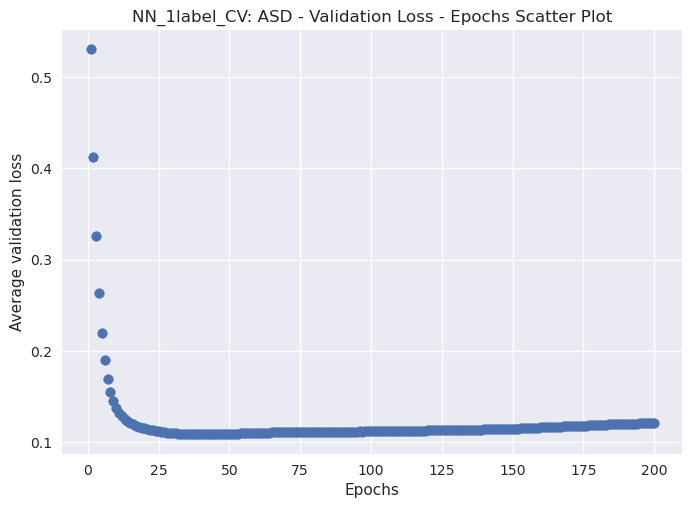

0.10874178260564804
['ASD']


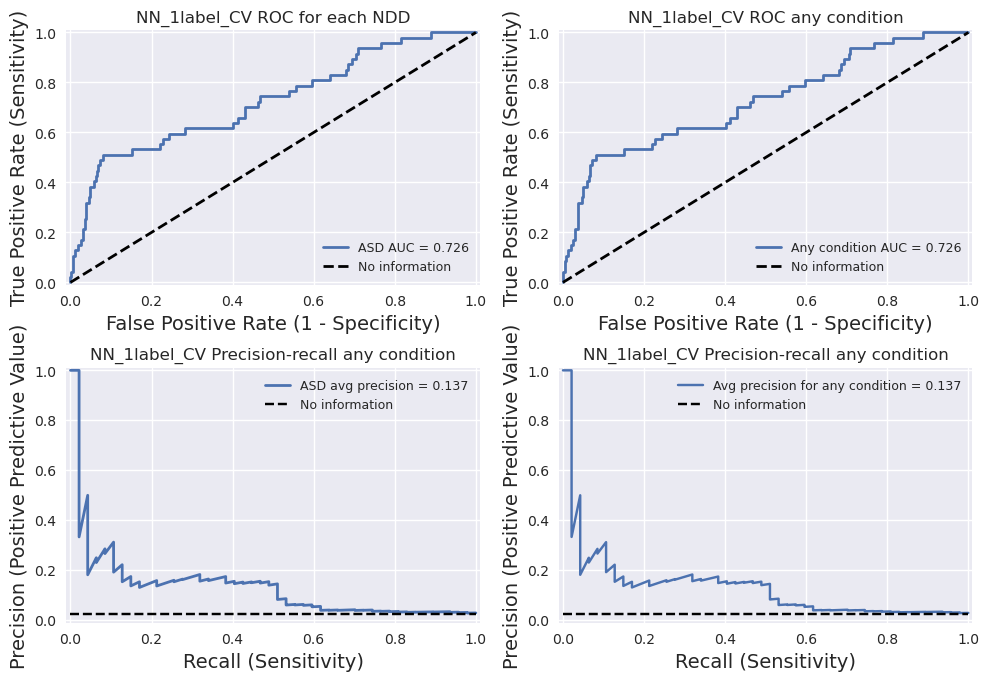

Dataset dimensions are (12960, 560) (12960, 5) (3240, 560) (3240, 5) (1800, 560) (1800, 5)
The new directory is created!


Training Epochs:   0%|          | 0/400 [00:00<?, ?it/s]

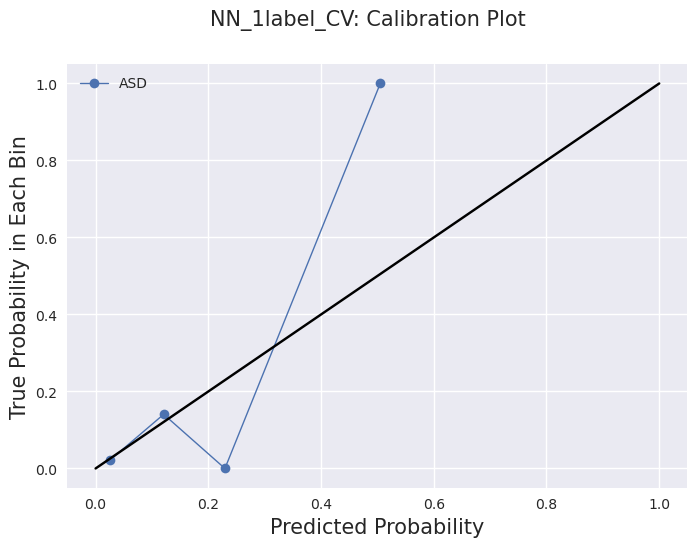

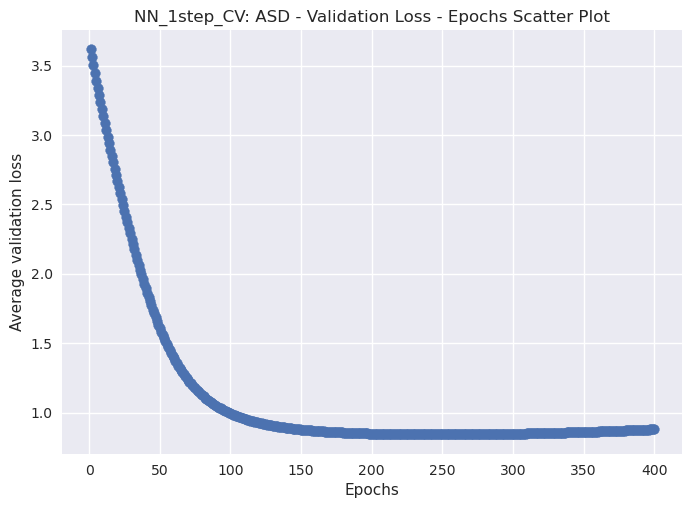

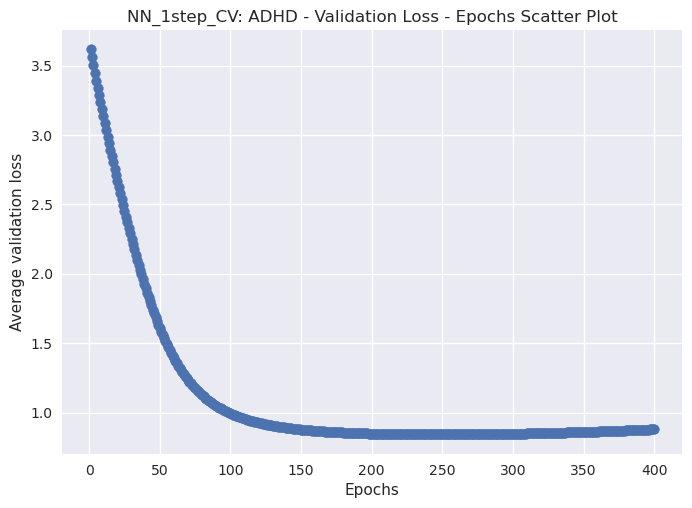

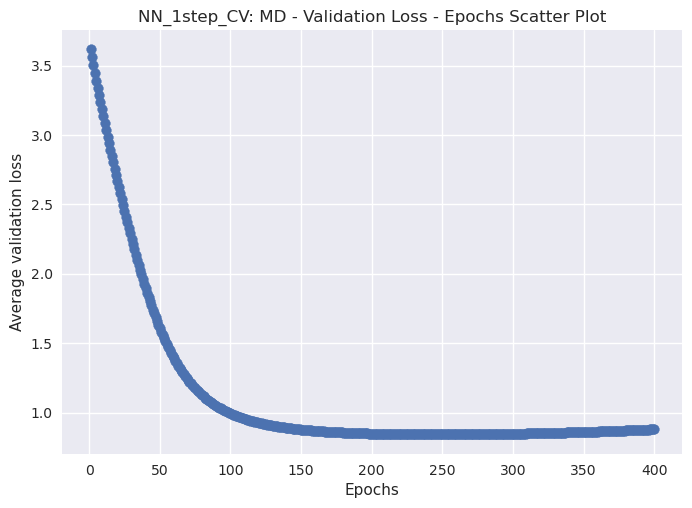

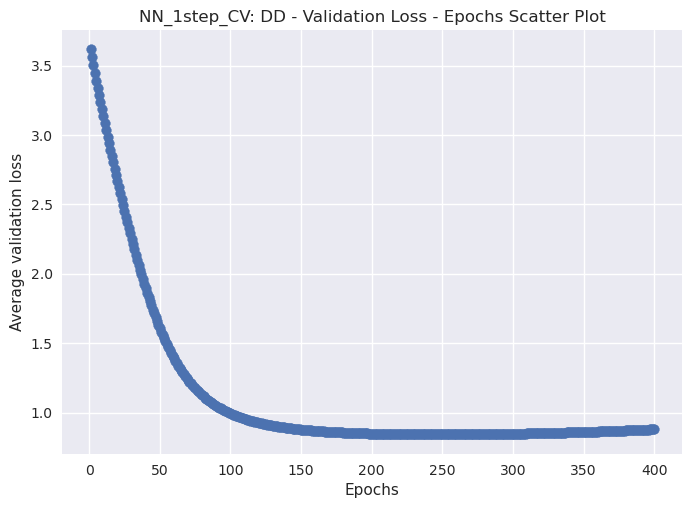

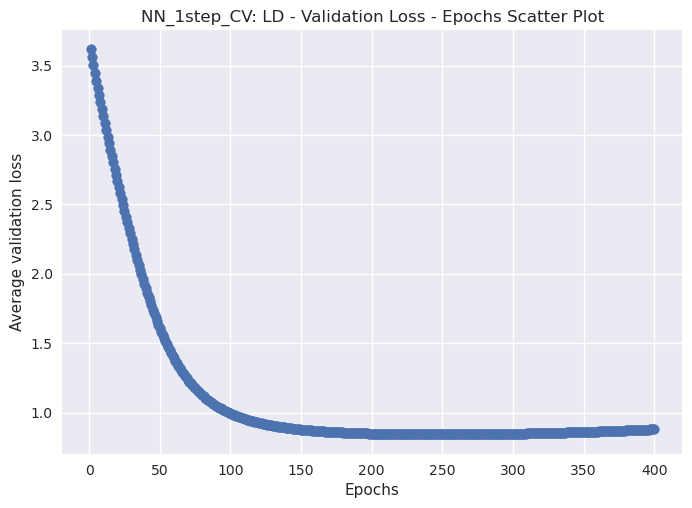

0.8425652086734772
['ASD', 'ADHD', 'MD', 'DD', 'LD']


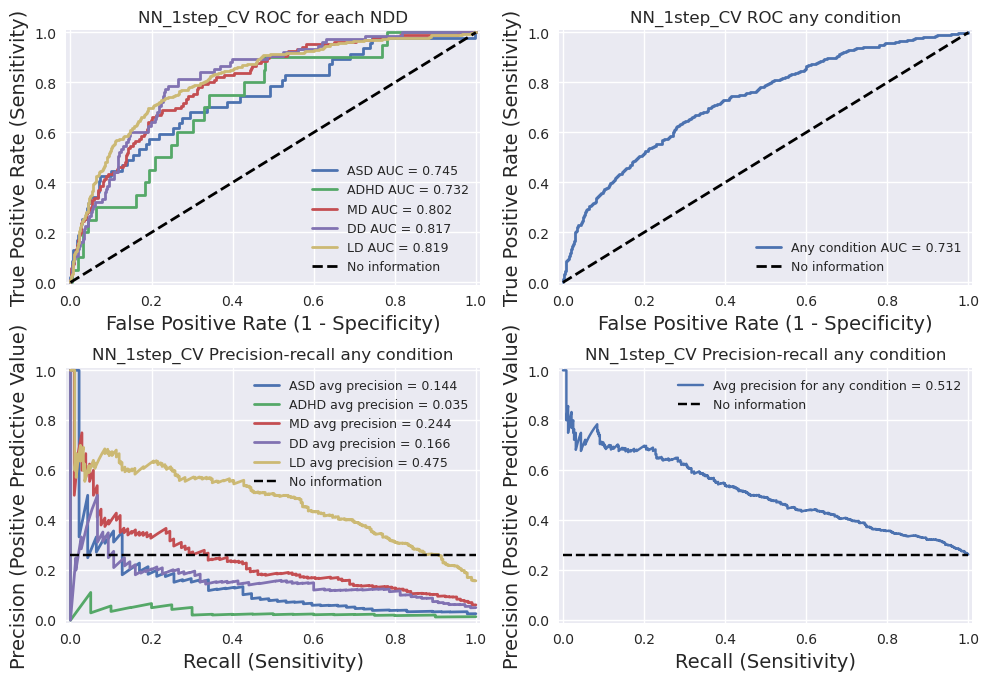

MTLnet(
  (flatten): Flatten(start_dim=1, end_dim=-1)
  (linear_sigmoid_stack): Sequential(
    (0): Linear(in_features=560, out_features=100, bias=True)
    (1): ReLU()
    (2): Linear(in_features=100, out_features=1, bias=True)
  )
)
MTLnet(
  (flatten): Flatten(start_dim=1, end_dim=-1)
  (linear_sigmoid_stack): Sequential(
    (0): Linear(in_features=560, out_features=100, bias=True)
    (1): ReLU()
    (2): Linear(in_features=100, out_features=5, bias=True)
  )
)
Dataset dimensions are (12960, 560) (12960, 1) (3240, 560) (3240, 1) (1800, 560) (1800, 1)
The new directory is created!


Training Epochs:   0%|          | 0/400 [00:00<?, ?it/s]

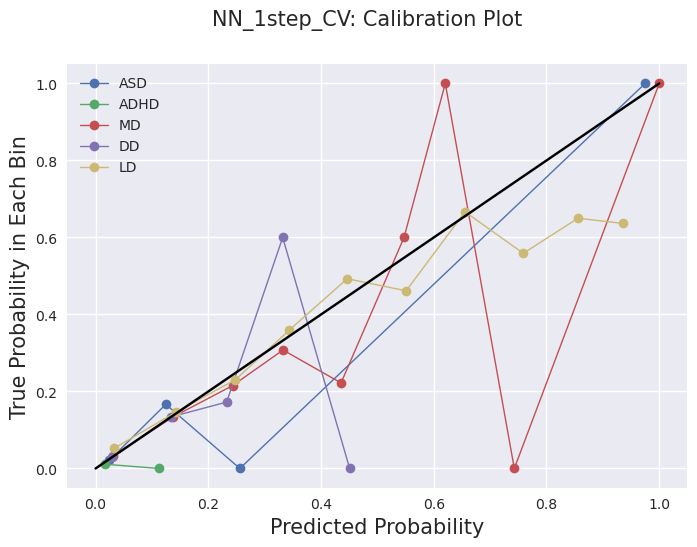

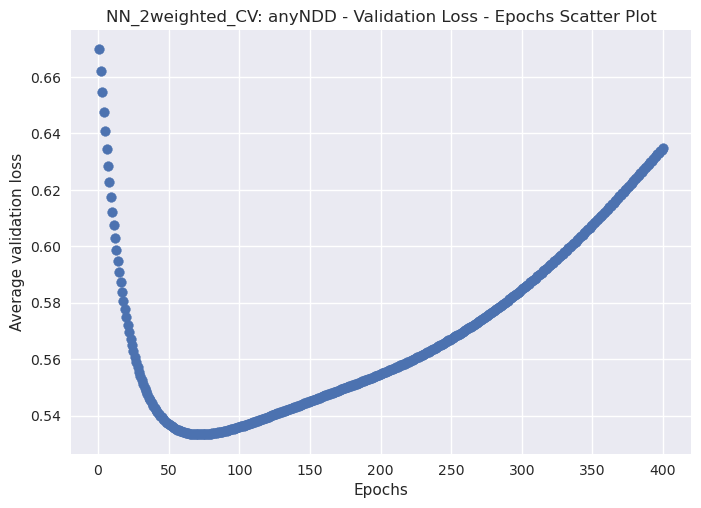

['anyNDD']


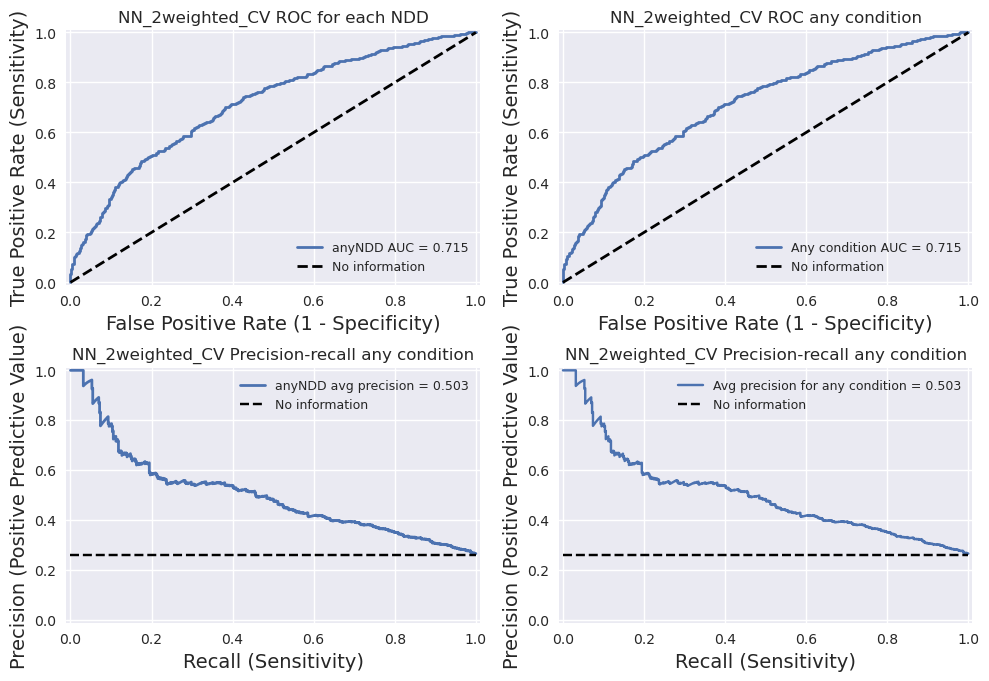

['anyNDD']


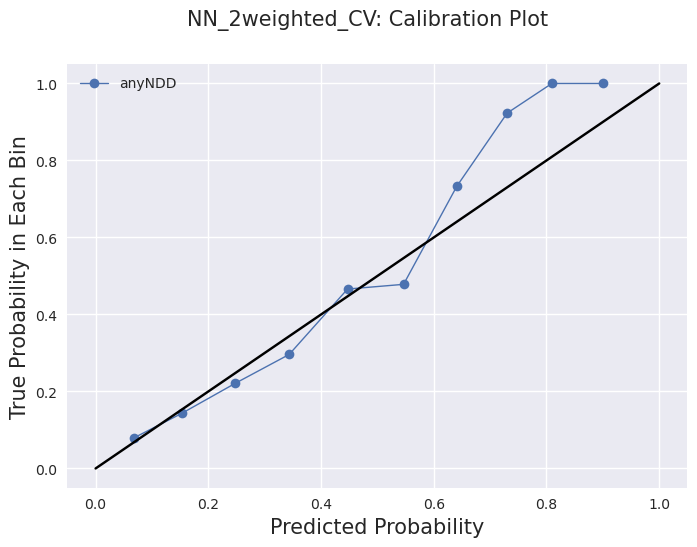

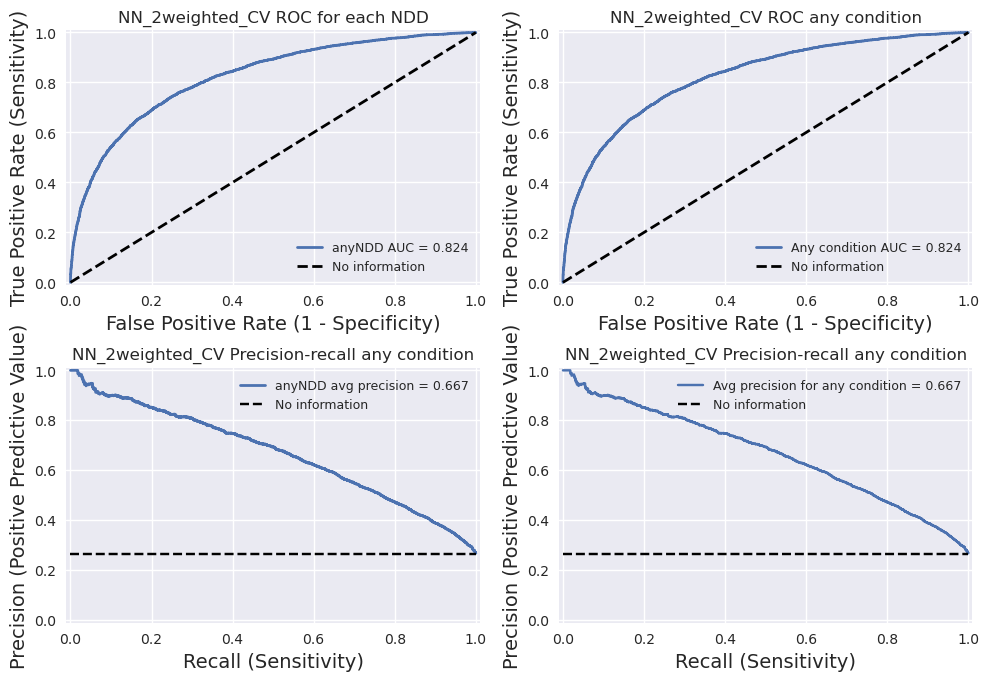

['anyNDD']


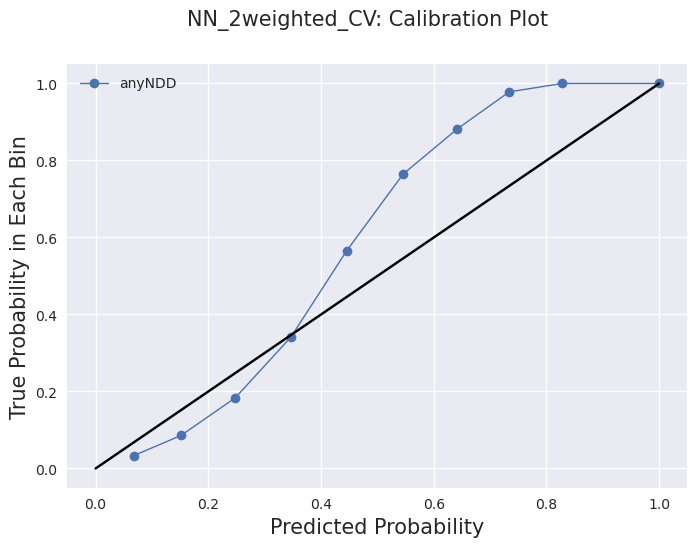

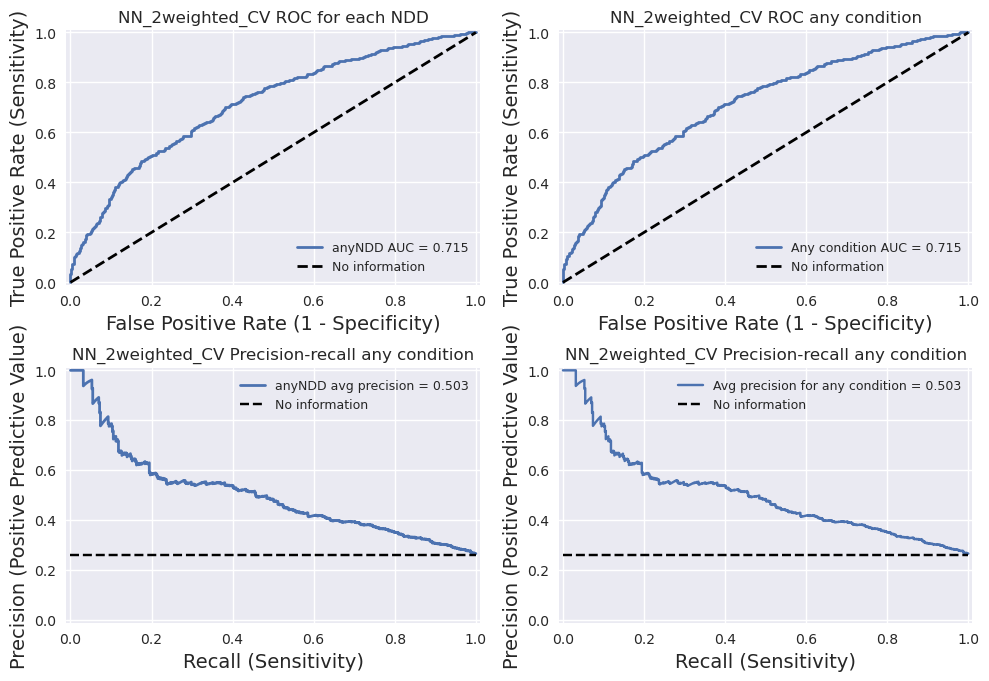

Dataset dimensions are (12960, 560) (12960, 5) (3240, 560) (3240, 5) (1800, 560) (1800, 5)


Training Epochs:   0%|          | 0/800 [00:00<?, ?it/s]

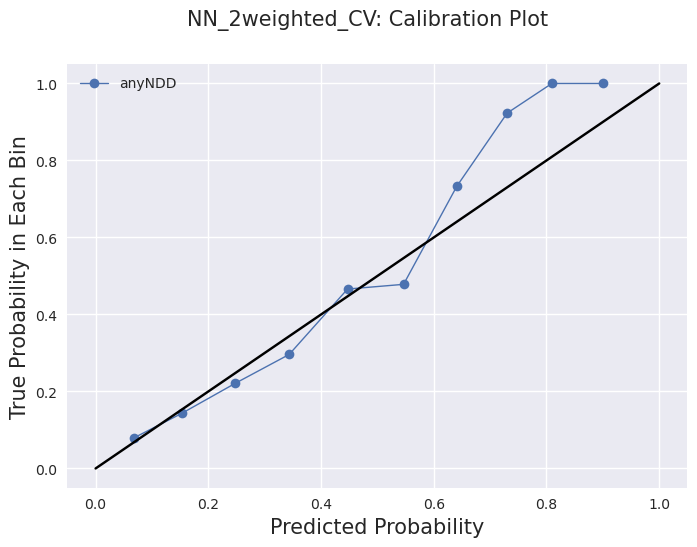

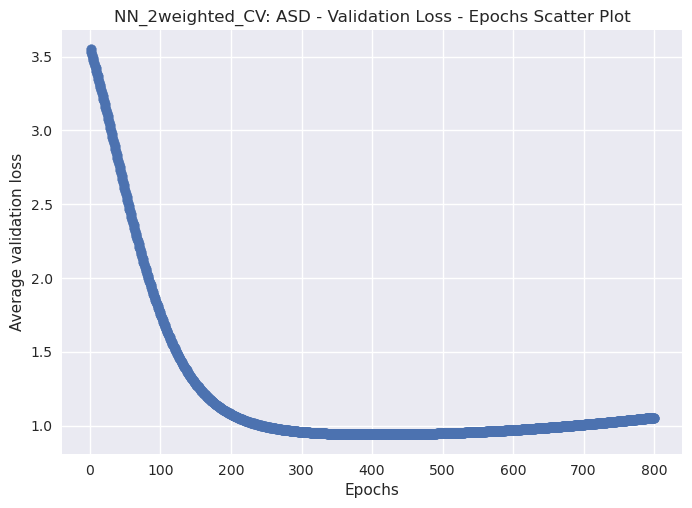

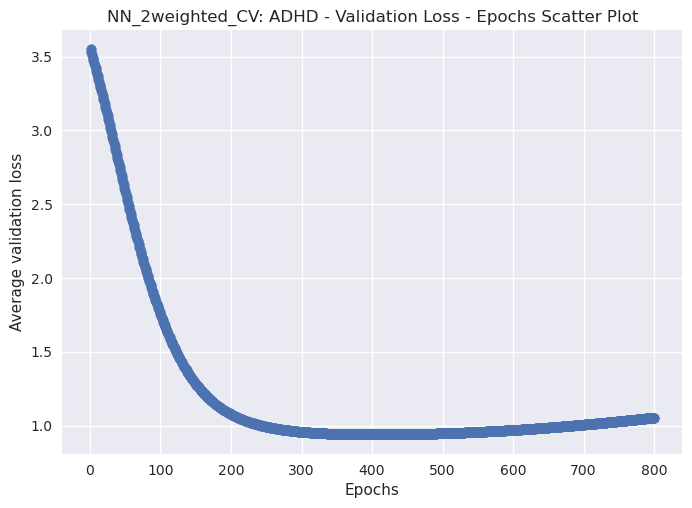

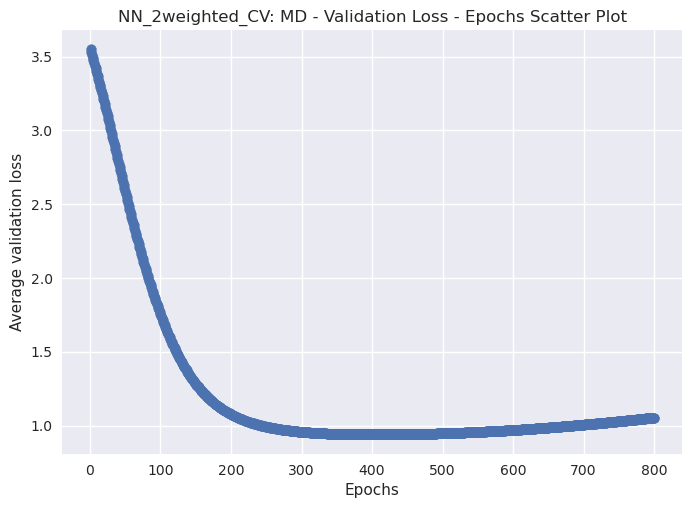

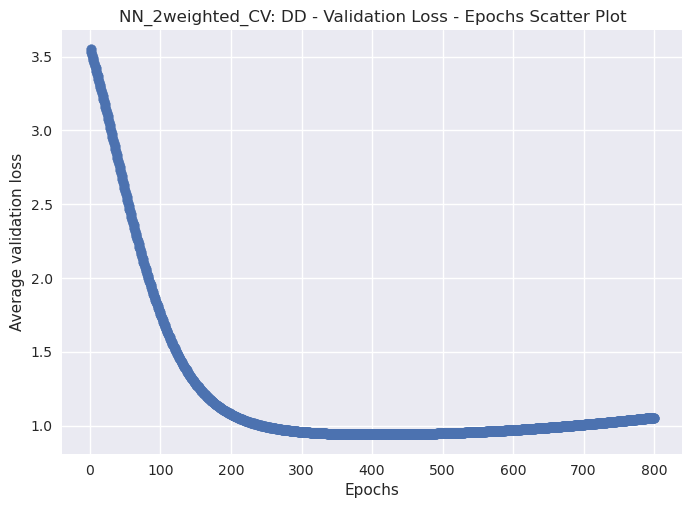

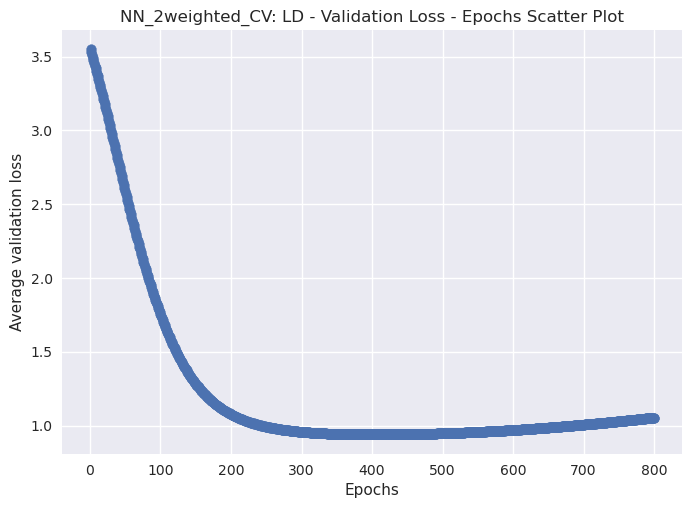

0.9402291178703308
['ASD', 'ADHD', 'MD', 'DD', 'LD']


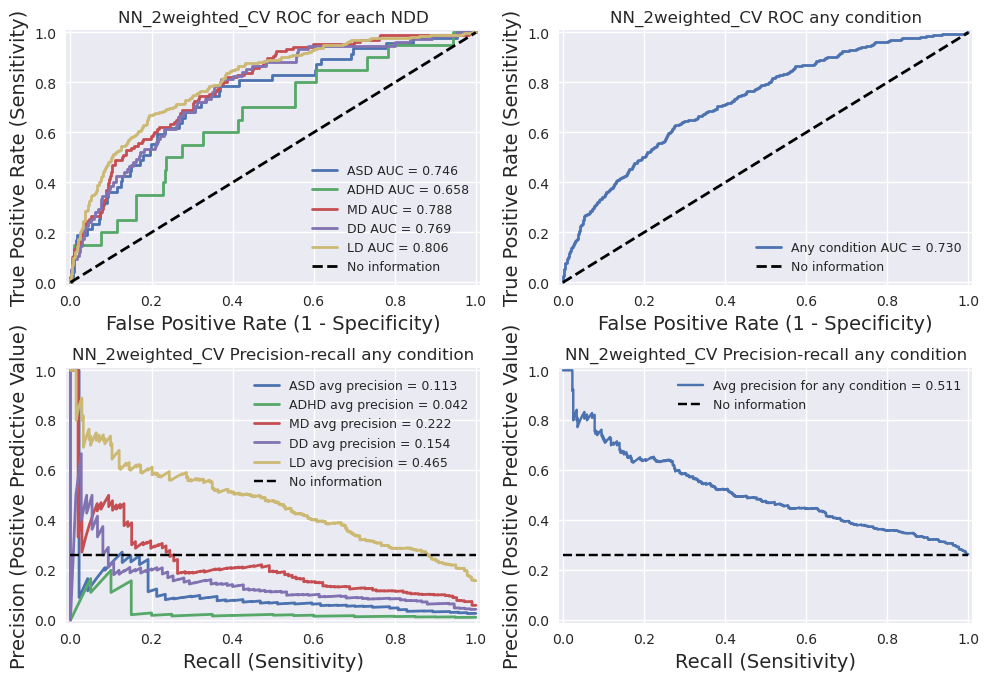

MTLnet(
  (flatten): Flatten(start_dim=1, end_dim=-1)
  (linear_sigmoid_stack): Sequential(
    (0): Linear(in_features=560, out_features=100, bias=True)
    (1): ReLU()
    (2): Linear(in_features=100, out_features=6, bias=True)
  )
)
Dataset dimensions are (12960, 560) (12960, 6) (3240, 560) (3240, 6) (1800, 560) (1800, 6)
The new directory is created!


Training Epochs:   0%|          | 0/400 [00:00<?, ?it/s]

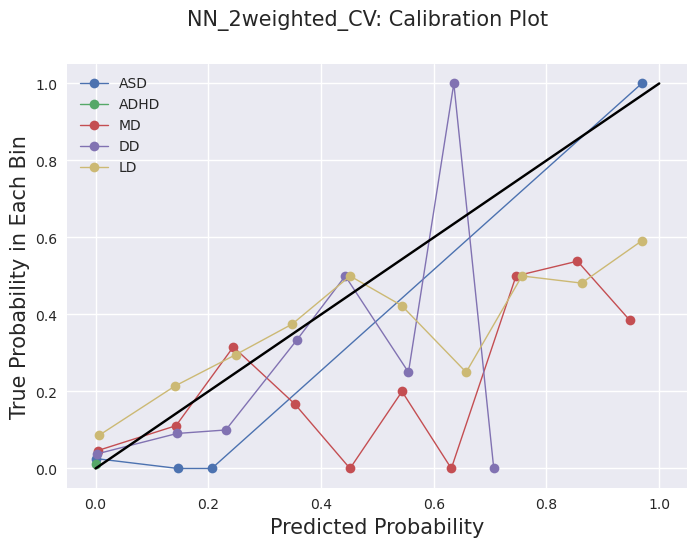

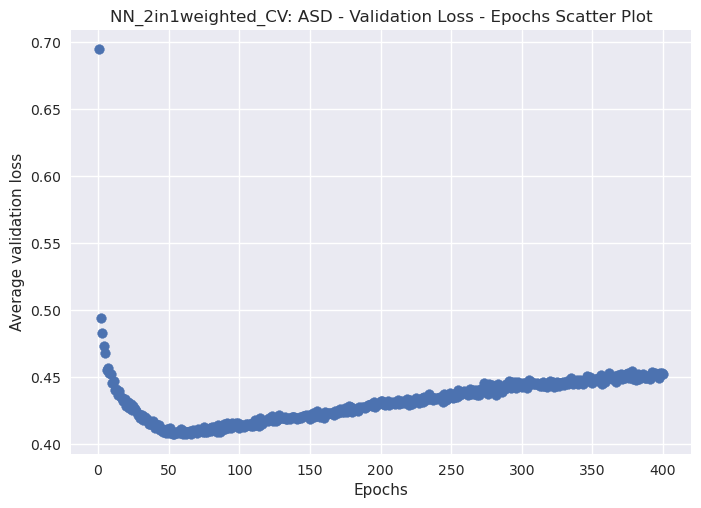

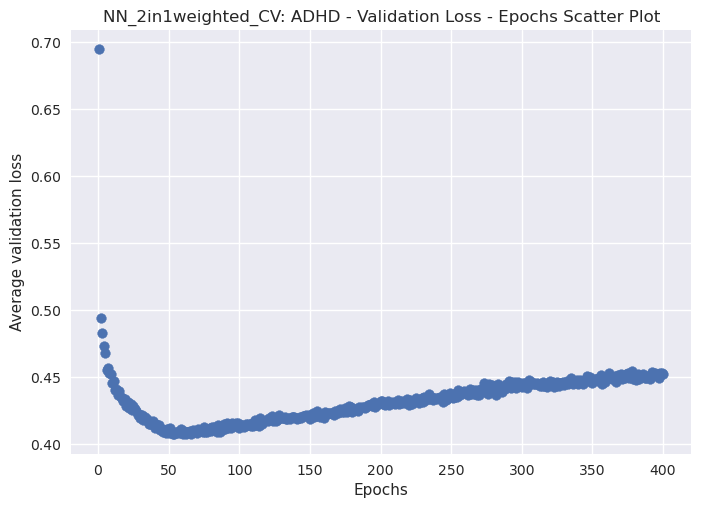

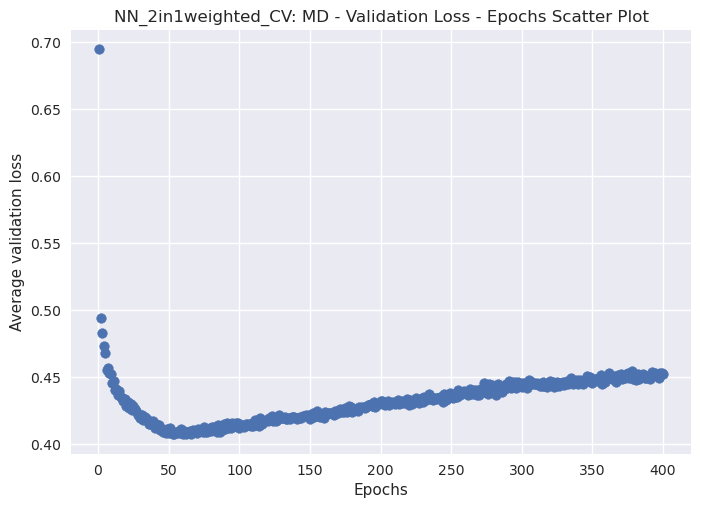

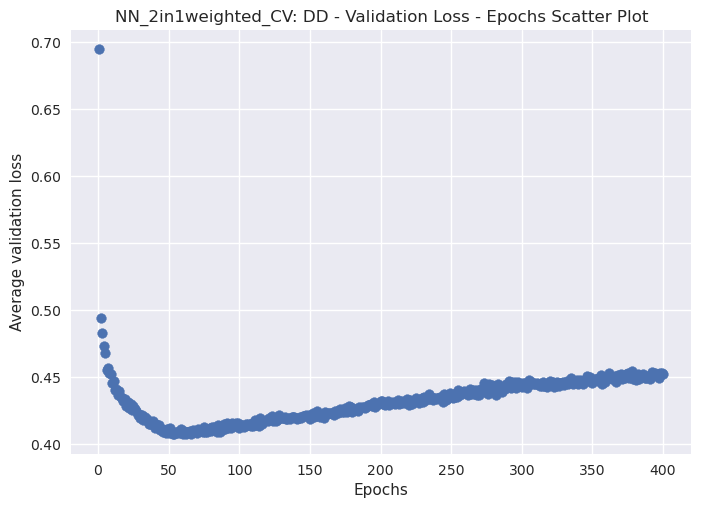

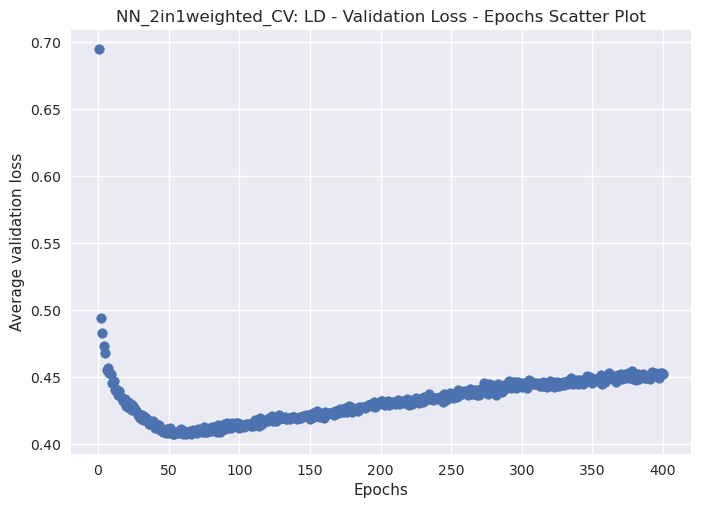

0.4071279466152191
['ASD', 'ADHD', 'MD', 'DD', 'LD']


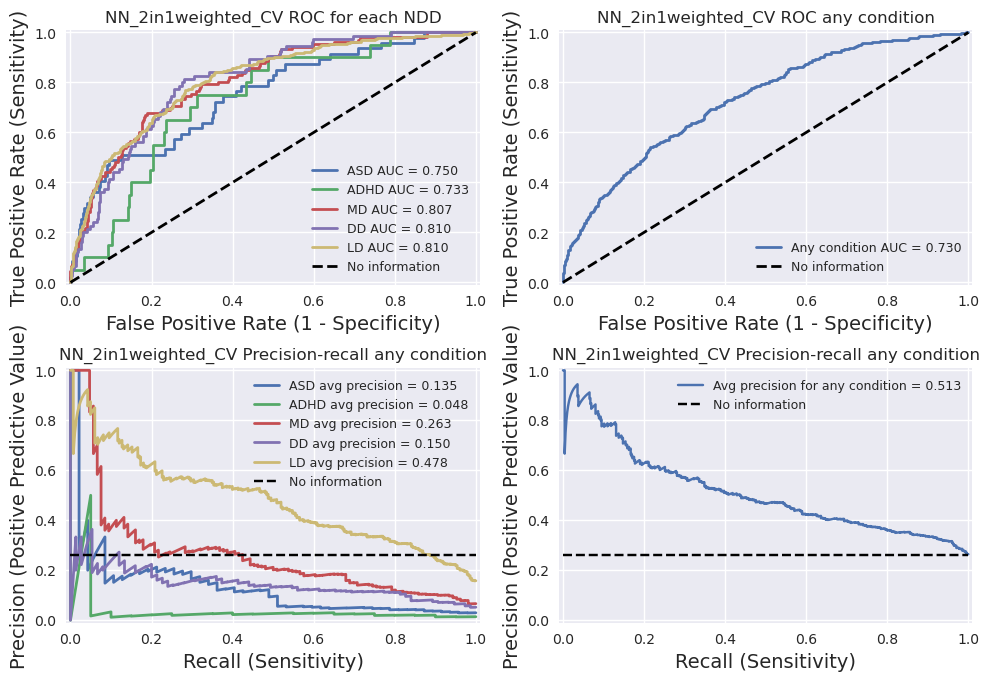

Dataset dimensions are (12960, 560) (12960, 1) (3240, 560) (3240, 1) (1800, 560) (1800, 1)
The new directory is created!


Training Epochs:   0%|          | 0/400 [00:00<?, ?it/s]

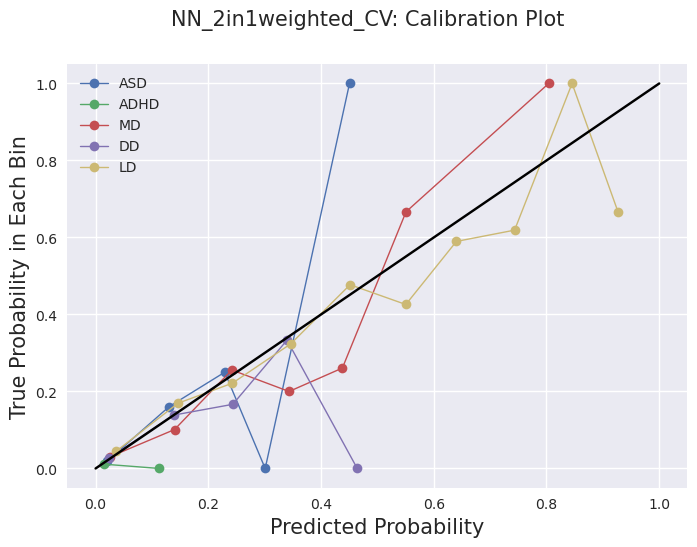

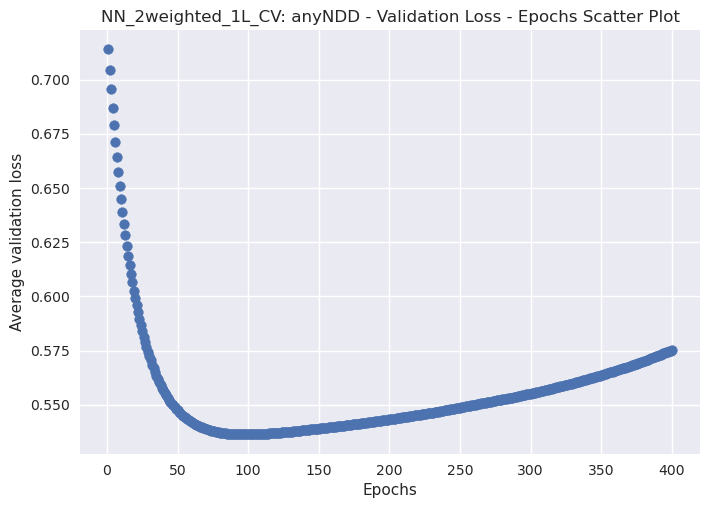

['anyNDD']


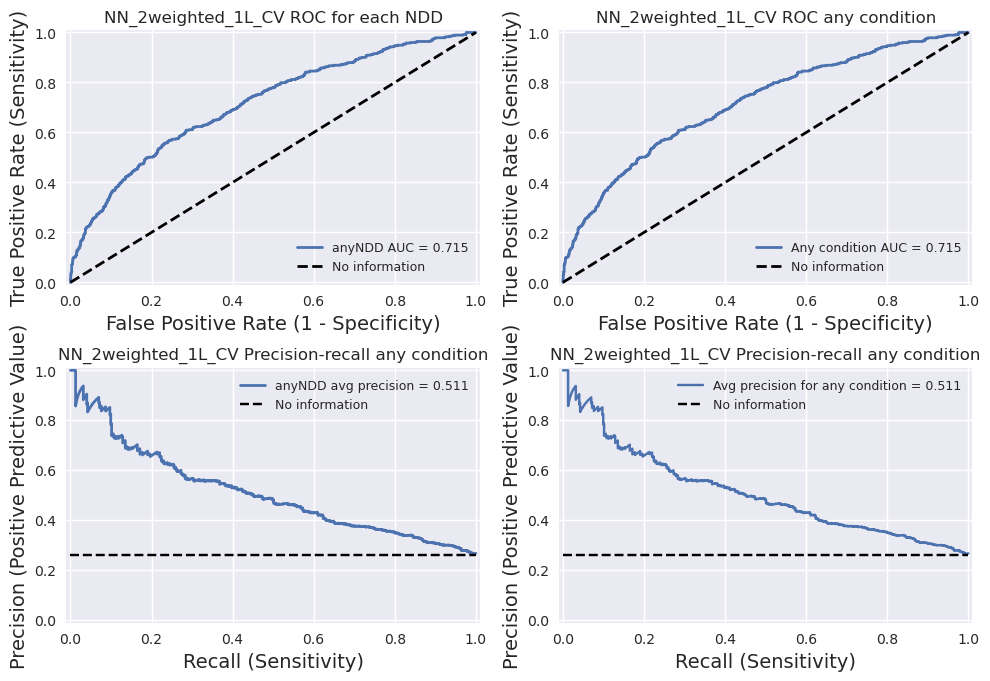

['anyNDD']


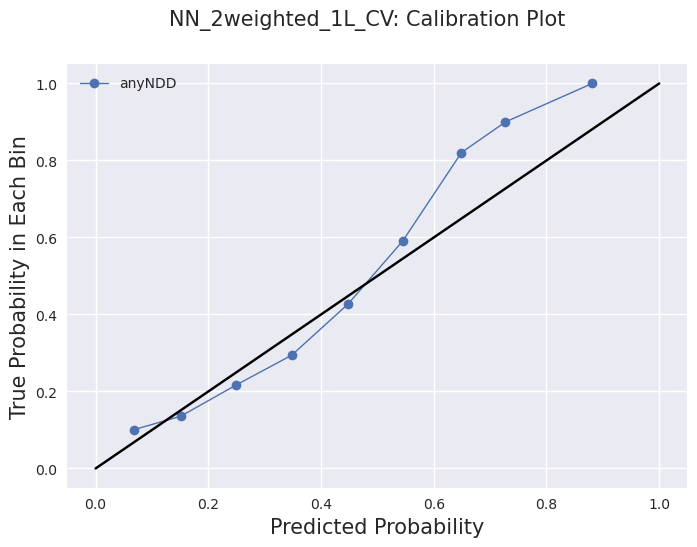

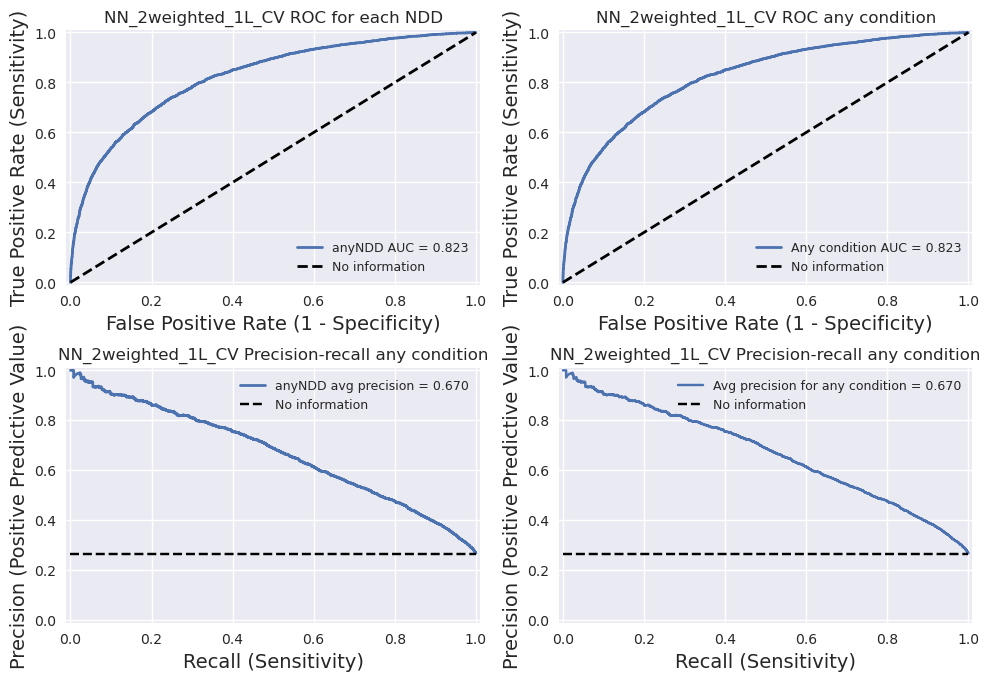

['anyNDD']


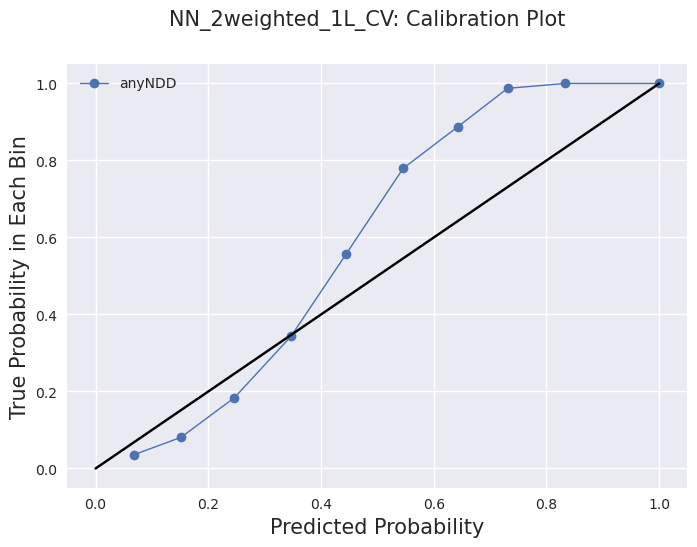

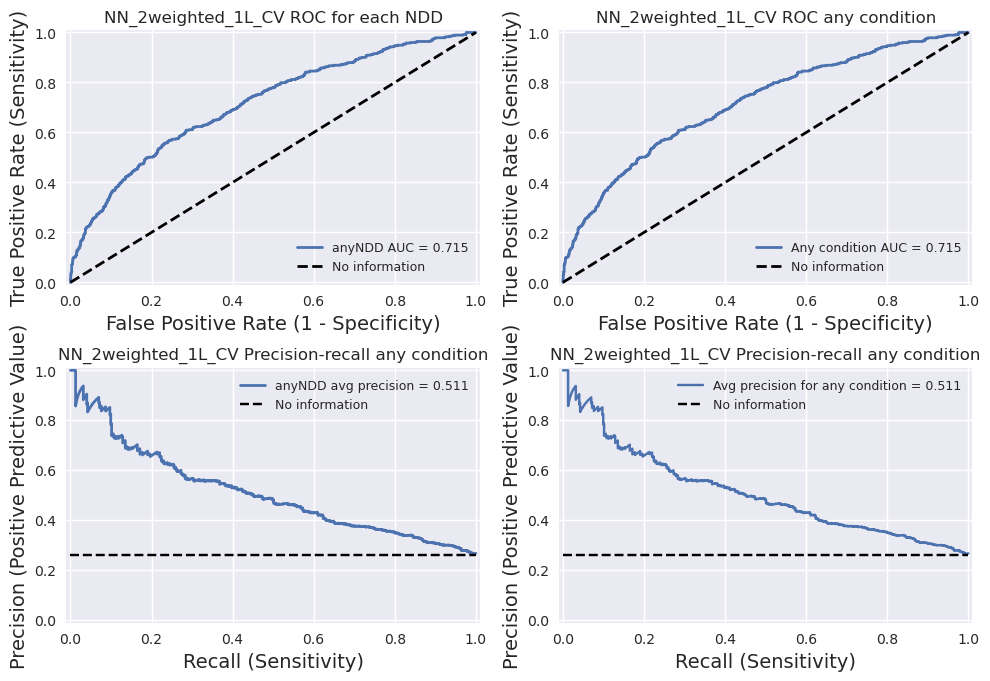

Dataset dimensions are (12960, 560) (12960, 1) (3240, 560) (3240, 1) (1800, 560) (1800, 1)


Training Epochs:   0%|          | 0/400 [00:00<?, ?it/s]

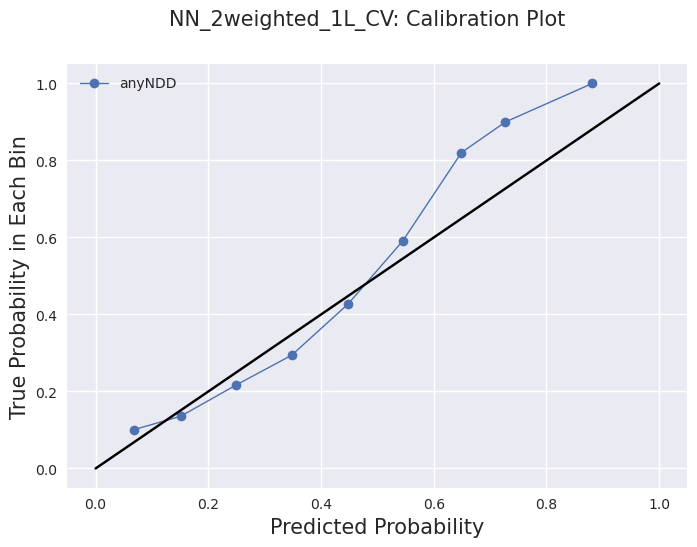

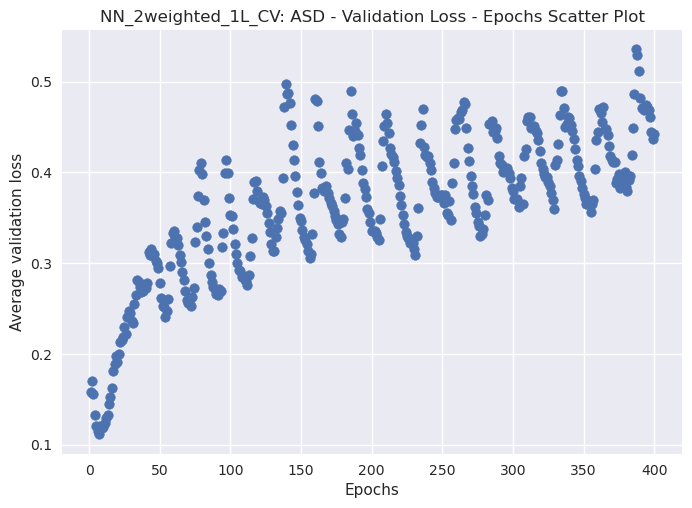

0.11145724356174469
['ASD']


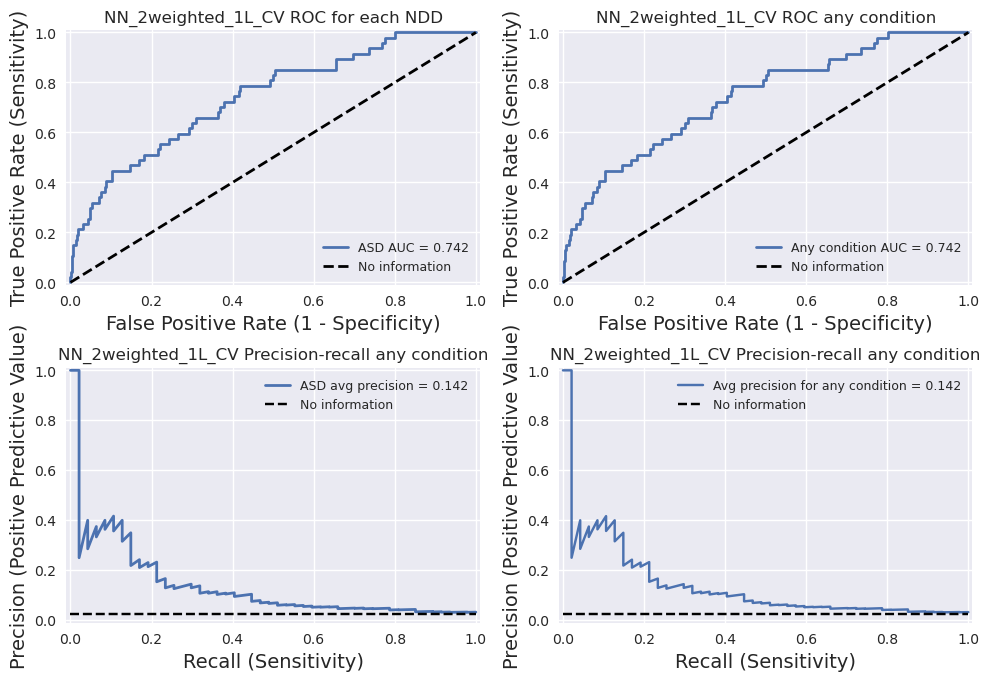

MTLnet(
  (flatten): Flatten(start_dim=1, end_dim=-1)
  (linear_sigmoid_stack): Sequential(
    (0): Linear(in_features=560, out_features=100, bias=True)
    (1): ReLU()
    (2): Linear(in_features=100, out_features=2, bias=True)
  )
)
Dataset dimensions are (12960, 560) (12960, 2) (3240, 560) (3240, 2) (1800, 560) (1800, 2)
The new directory is created!


Training Epochs:   0%|          | 0/400 [00:00<?, ?it/s]

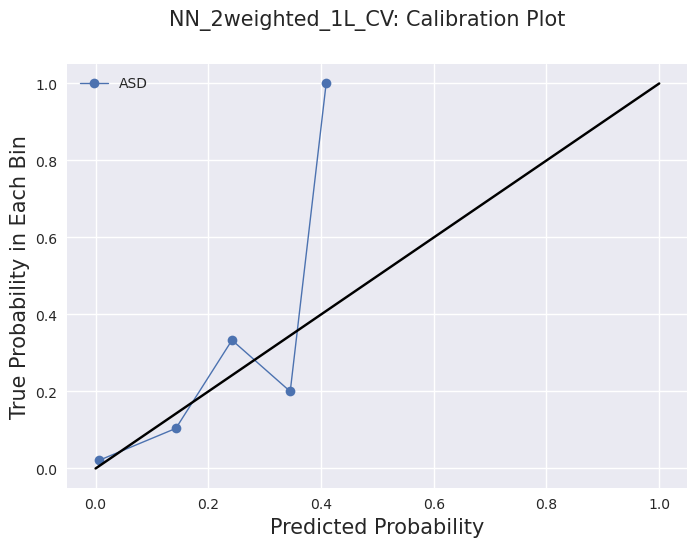

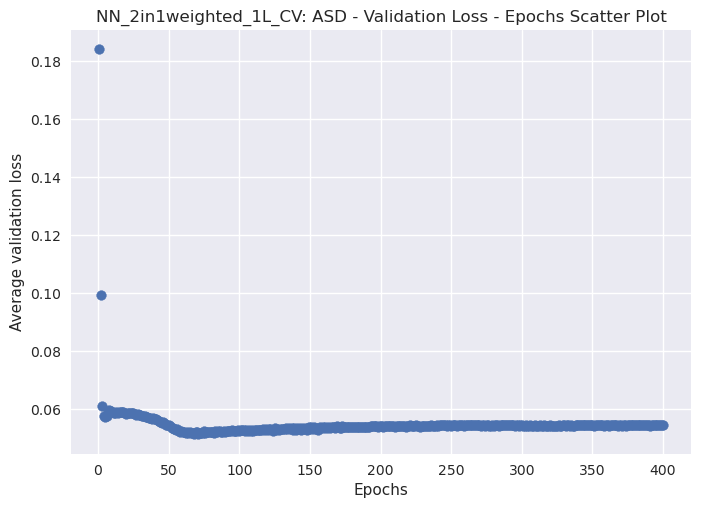

0.051214855164289474
['ASD']


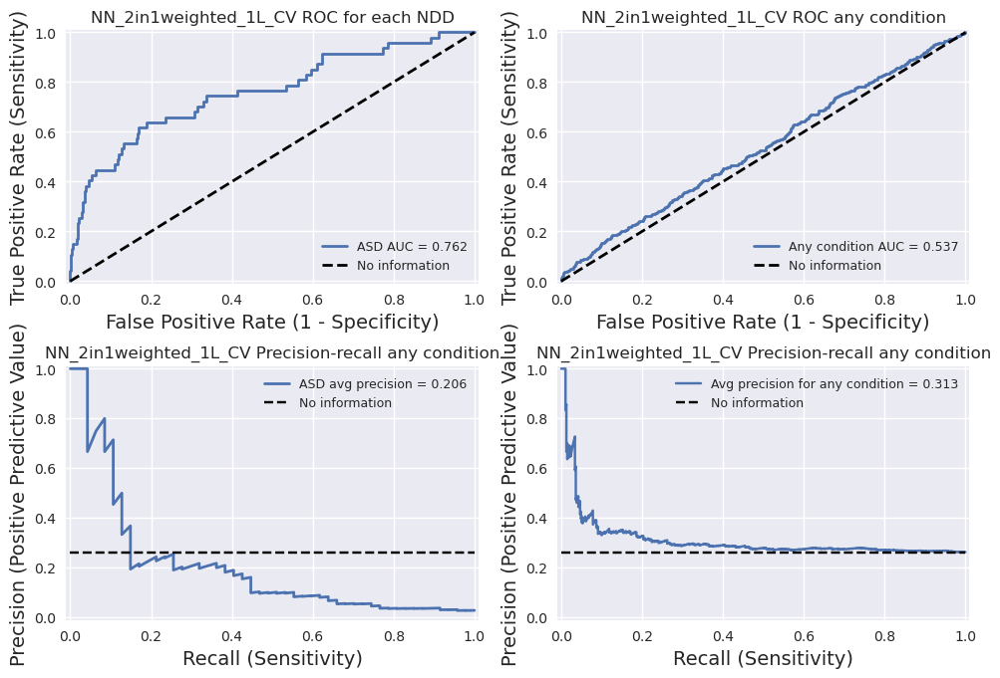

Fold 2/10
Dataset dimensions are (12960, 560) (12960, 1) (3240, 560) (3240, 1) (1800, 560) (1800, 1)



A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


Training Epochs:   0%|          | 0/200 [00:00<?, ?it/s]

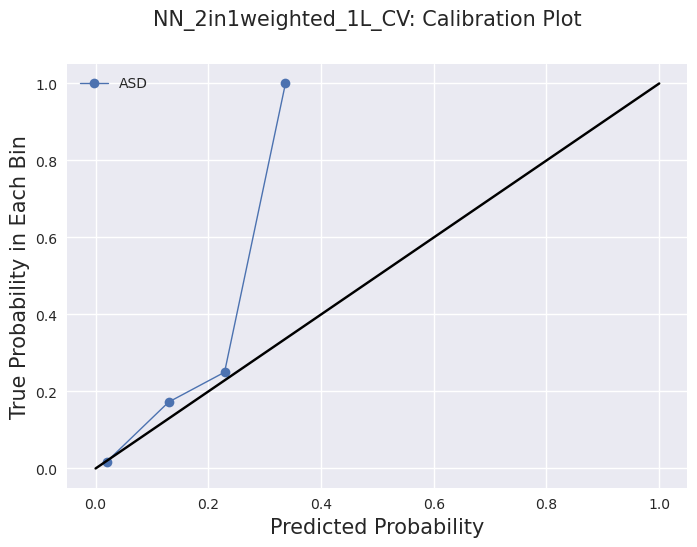

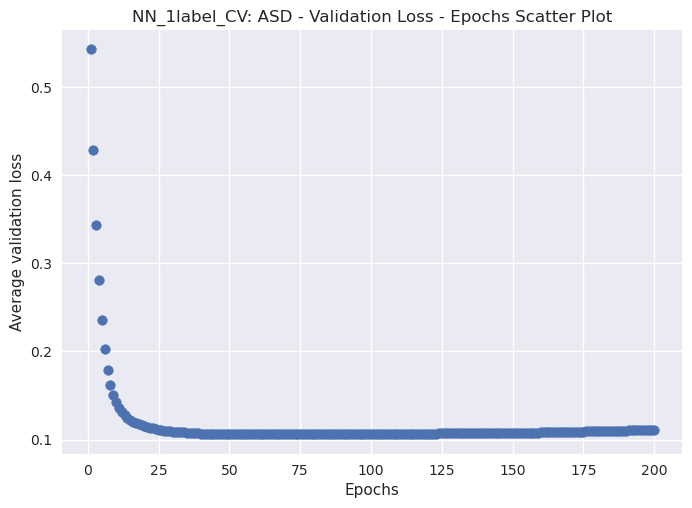

0.1057714968919754
['ASD']


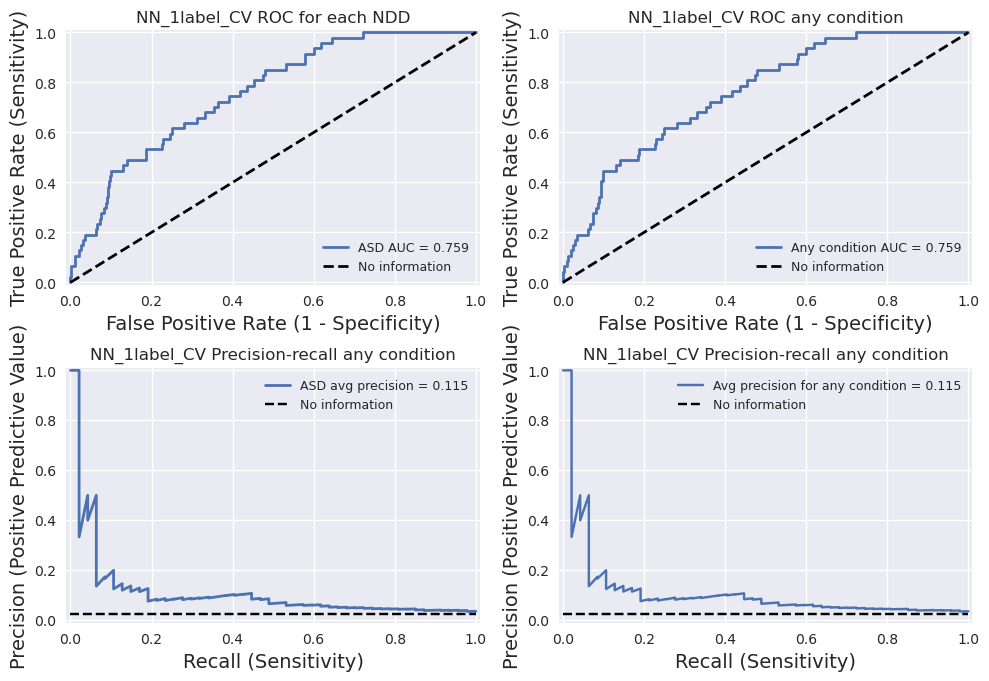

Dataset dimensions are (12960, 560) (12960, 5) (3240, 560) (3240, 5) (1800, 560) (1800, 5)


Training Epochs:   0%|          | 0/400 [00:00<?, ?it/s]

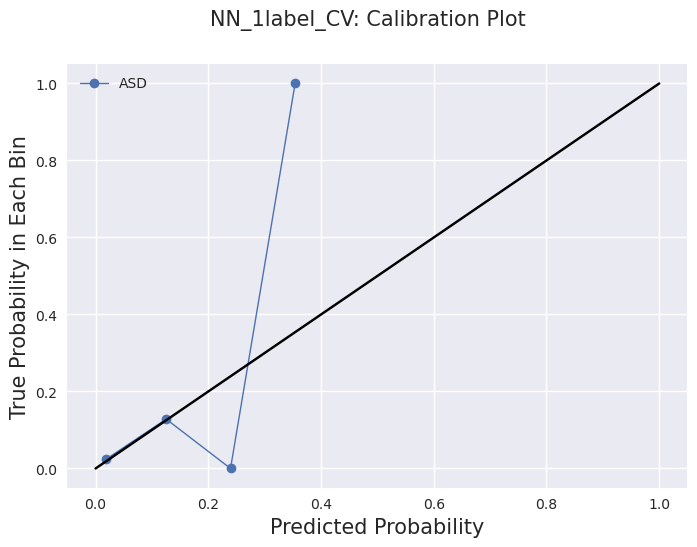

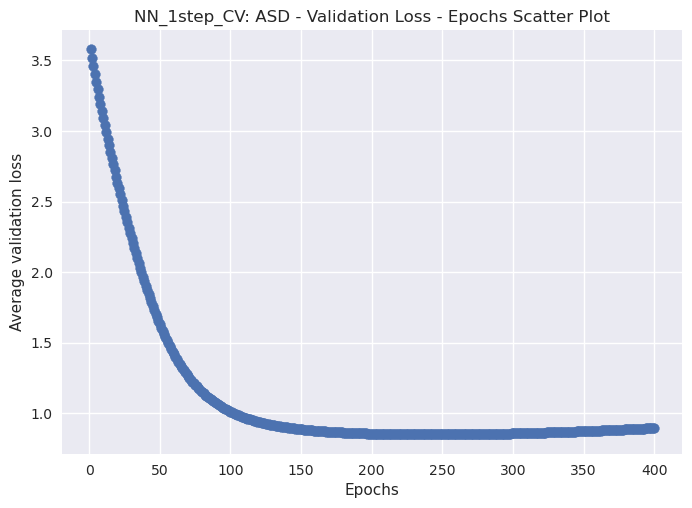

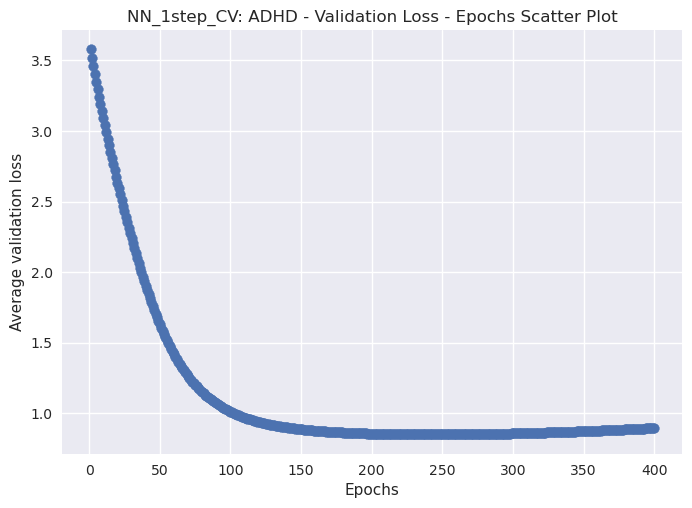

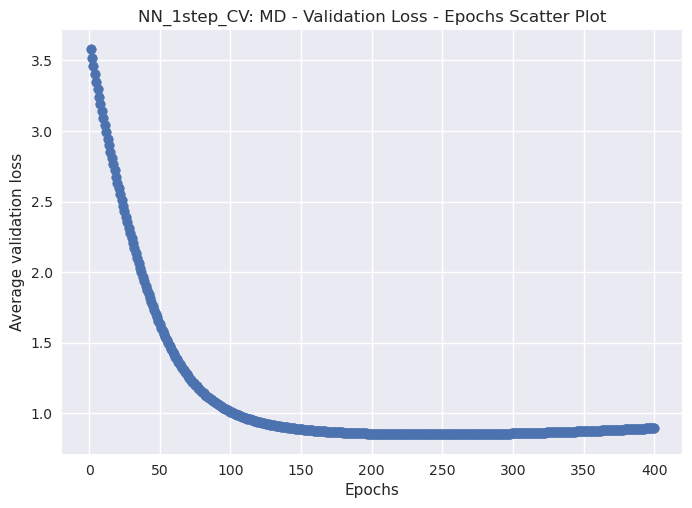

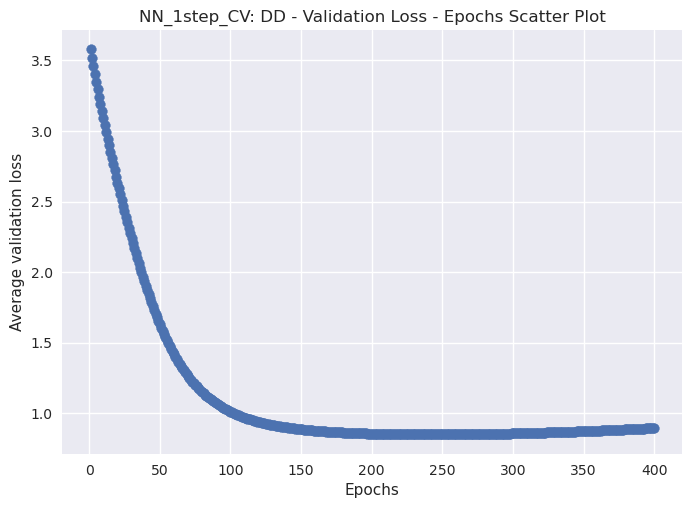

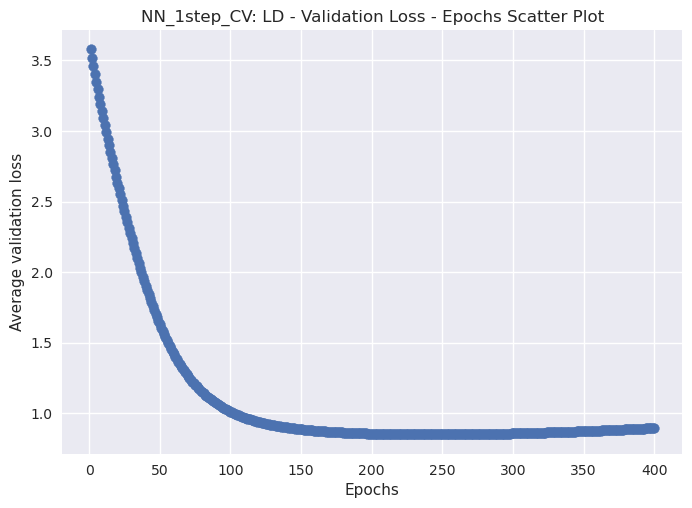

0.8504183292388916
['ASD', 'ADHD', 'MD', 'DD', 'LD']


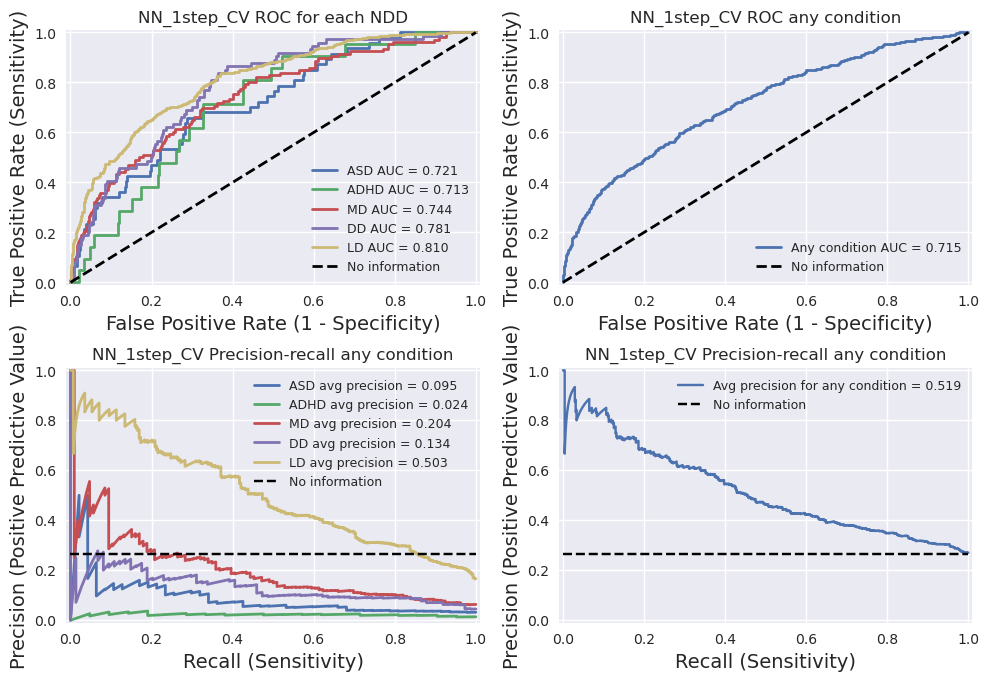

MTLnet(
  (flatten): Flatten(start_dim=1, end_dim=-1)
  (linear_sigmoid_stack): Sequential(
    (0): Linear(in_features=560, out_features=100, bias=True)
    (1): ReLU()
    (2): Linear(in_features=100, out_features=1, bias=True)
  )
)
MTLnet(
  (flatten): Flatten(start_dim=1, end_dim=-1)
  (linear_sigmoid_stack): Sequential(
    (0): Linear(in_features=560, out_features=100, bias=True)
    (1): ReLU()
    (2): Linear(in_features=100, out_features=5, bias=True)
  )
)
Dataset dimensions are (12960, 560) (12960, 1) (3240, 560) (3240, 1) (1800, 560) (1800, 1)


Training Epochs:   0%|          | 0/400 [00:00<?, ?it/s]

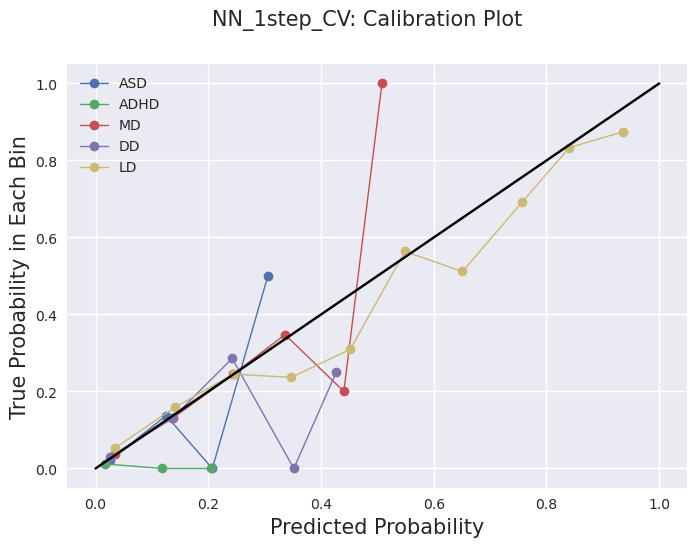

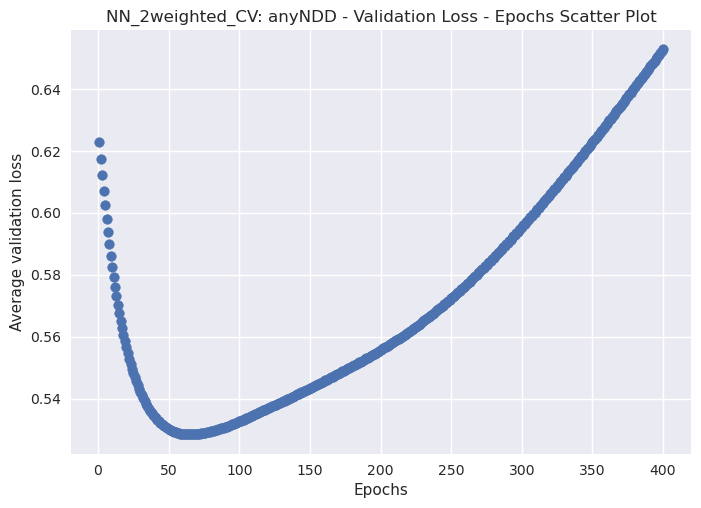

['anyNDD']


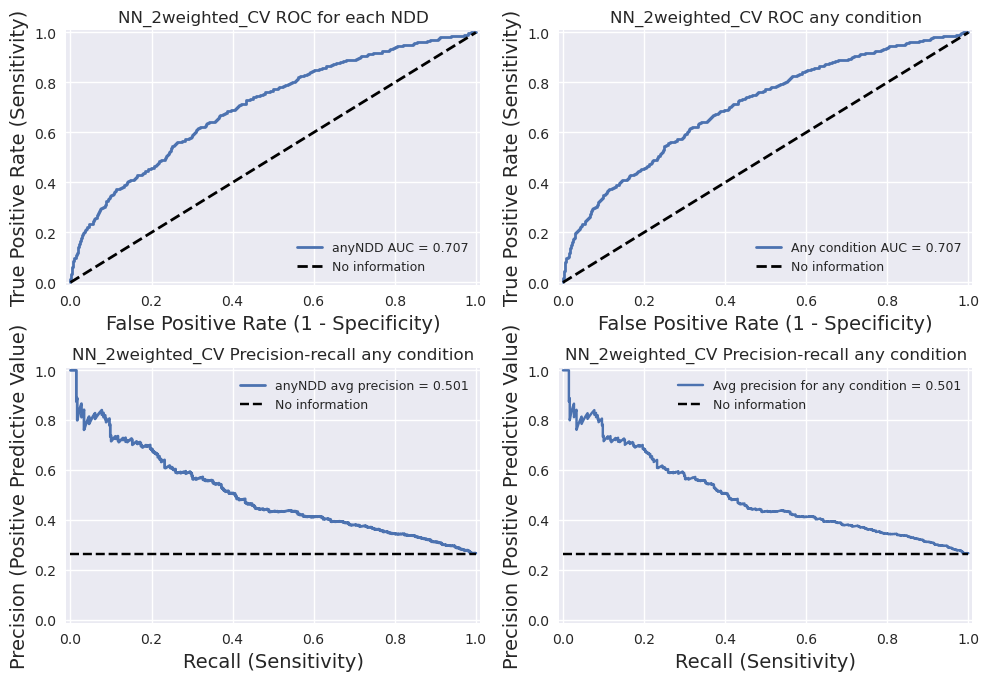

['anyNDD']


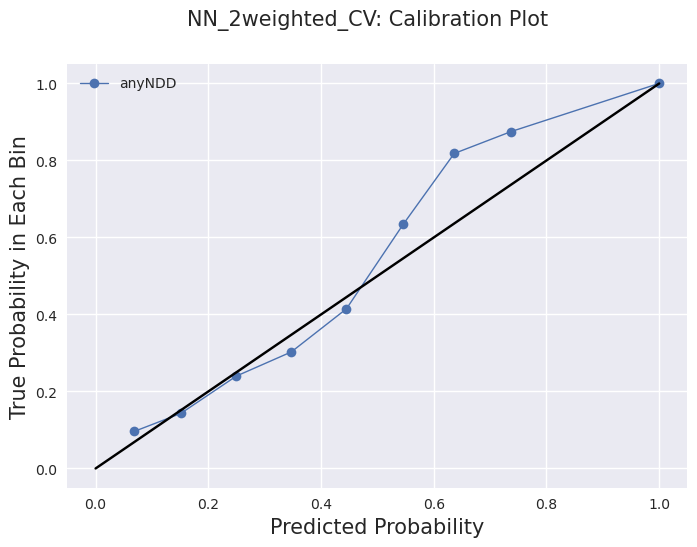

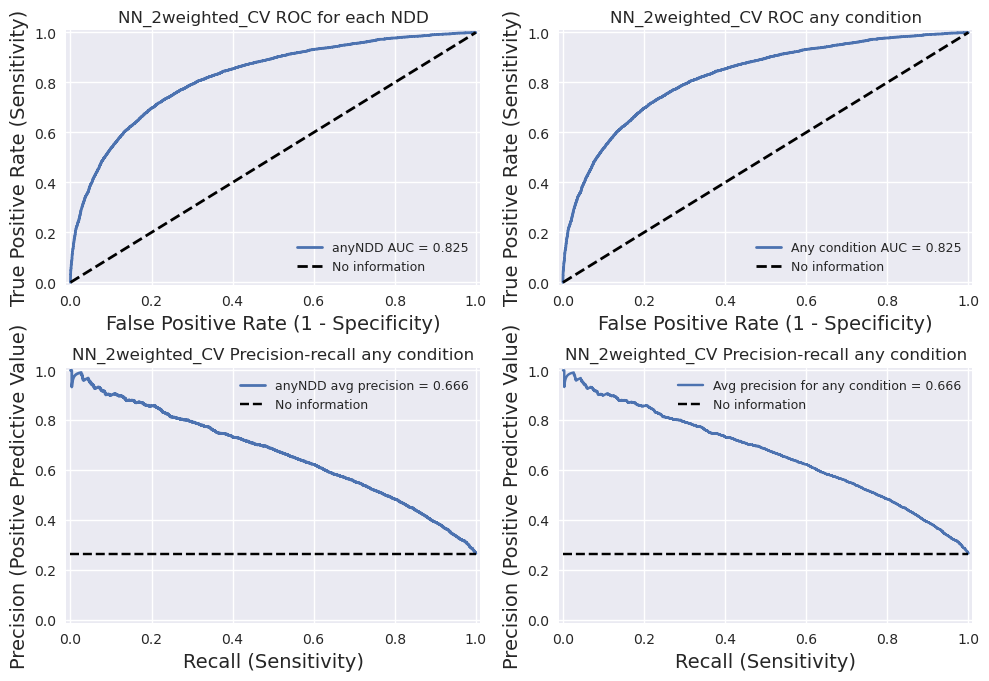

['anyNDD']


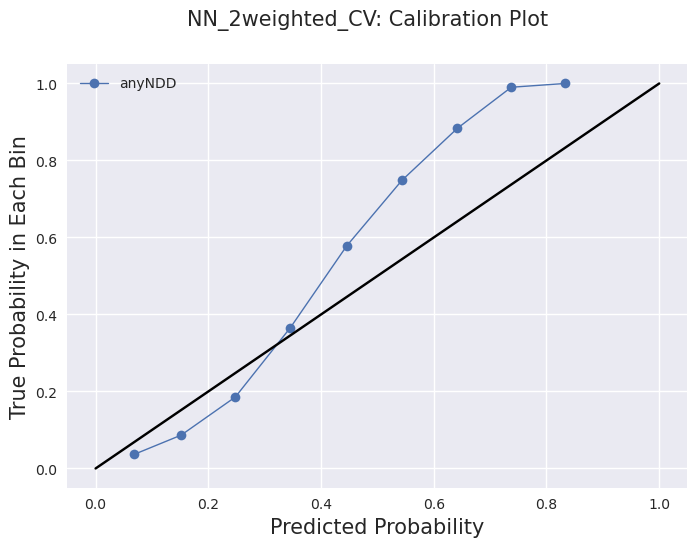

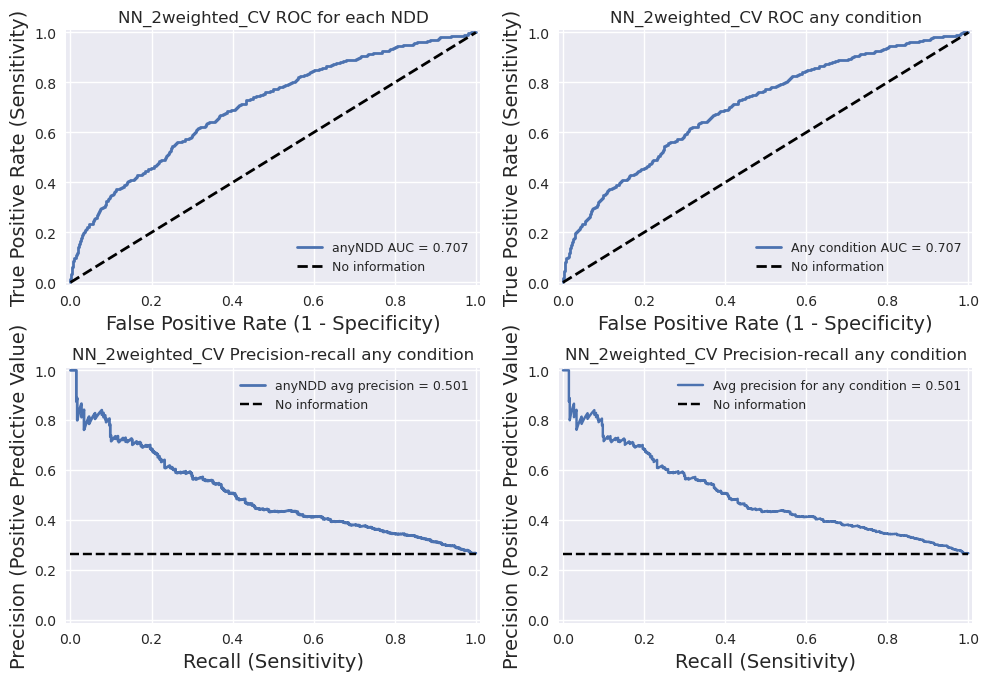

Dataset dimensions are (12960, 560) (12960, 5) (3240, 560) (3240, 5) (1800, 560) (1800, 5)


Training Epochs:   0%|          | 0/800 [00:00<?, ?it/s]

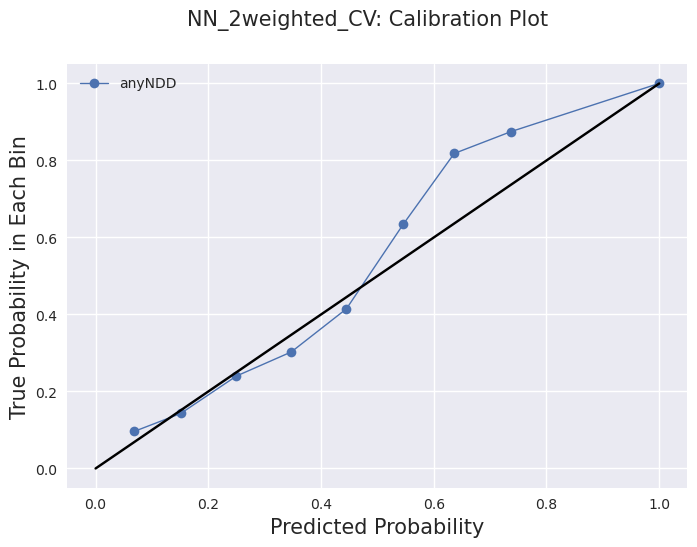

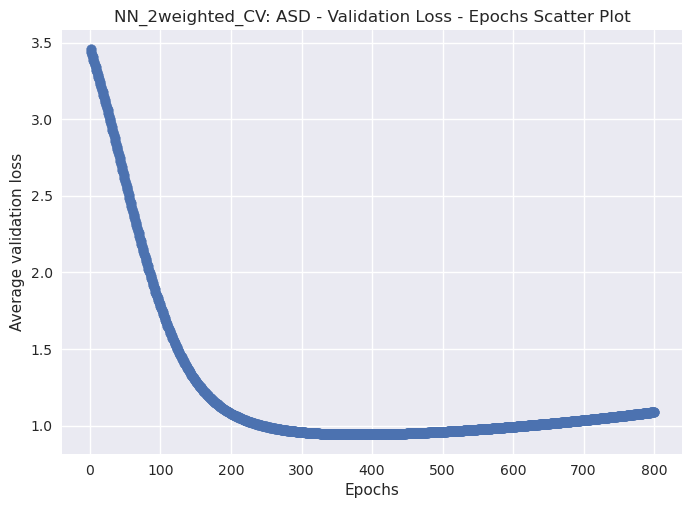

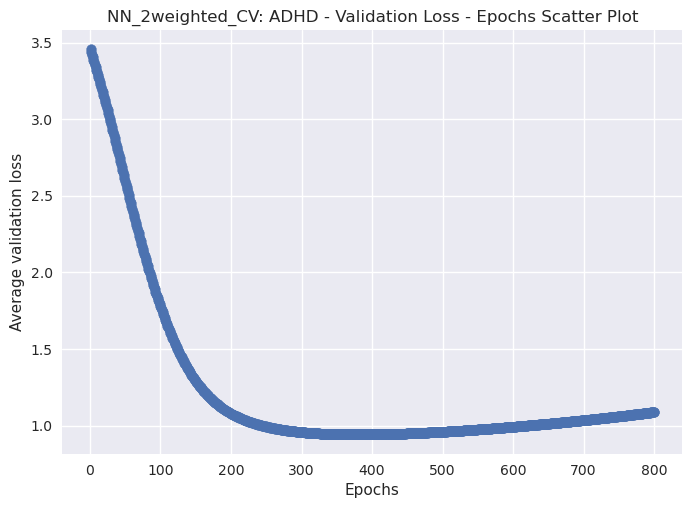

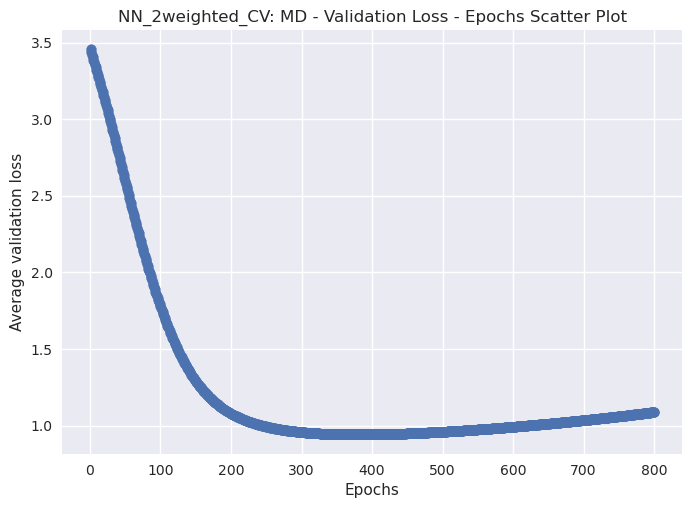

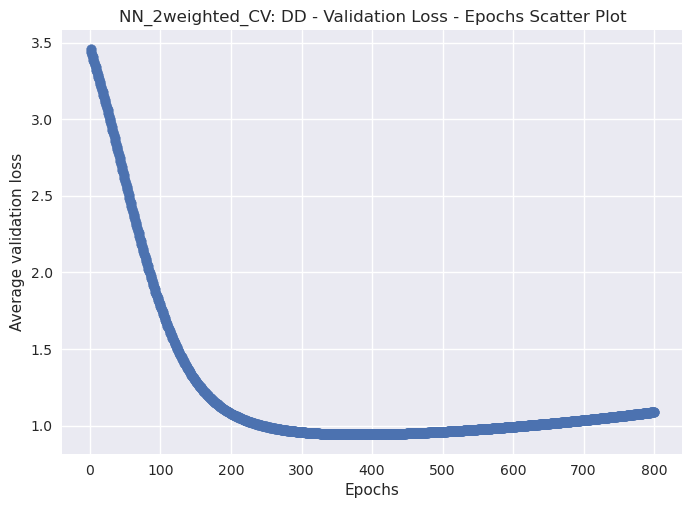

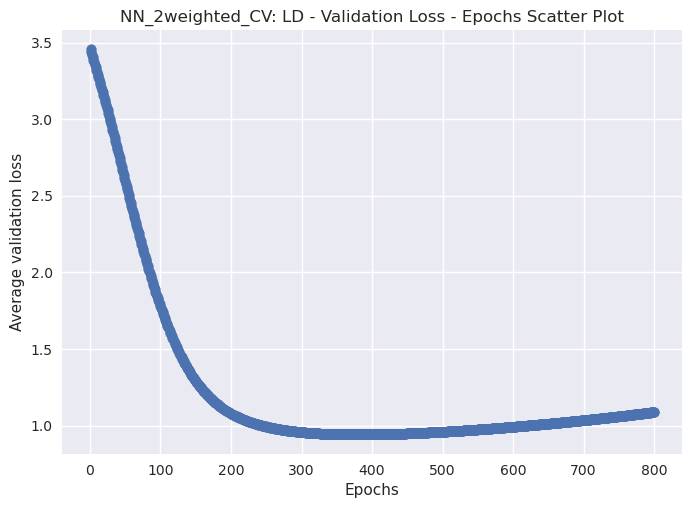

0.943160355091095
['ASD', 'ADHD', 'MD', 'DD', 'LD']


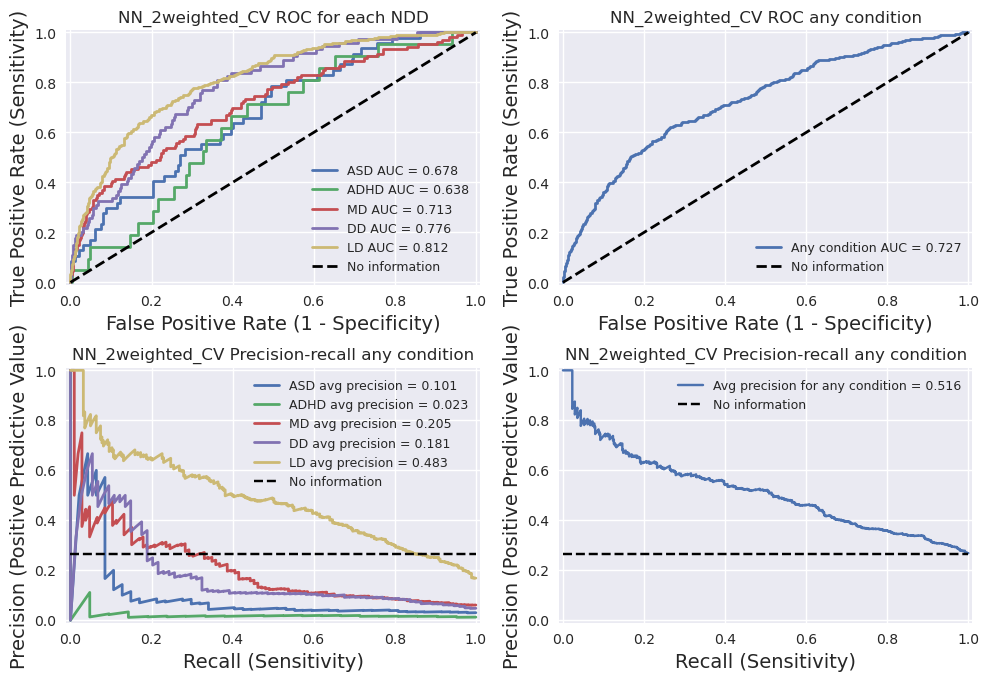

MTLnet(
  (flatten): Flatten(start_dim=1, end_dim=-1)
  (linear_sigmoid_stack): Sequential(
    (0): Linear(in_features=560, out_features=100, bias=True)
    (1): ReLU()
    (2): Linear(in_features=100, out_features=6, bias=True)
  )
)
Dataset dimensions are (12960, 560) (12960, 6) (3240, 560) (3240, 6) (1800, 560) (1800, 6)


Training Epochs:   0%|          | 0/400 [00:00<?, ?it/s]

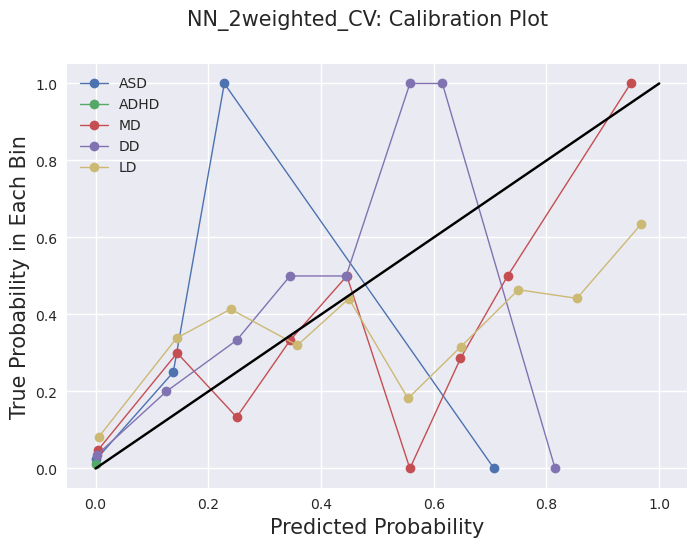

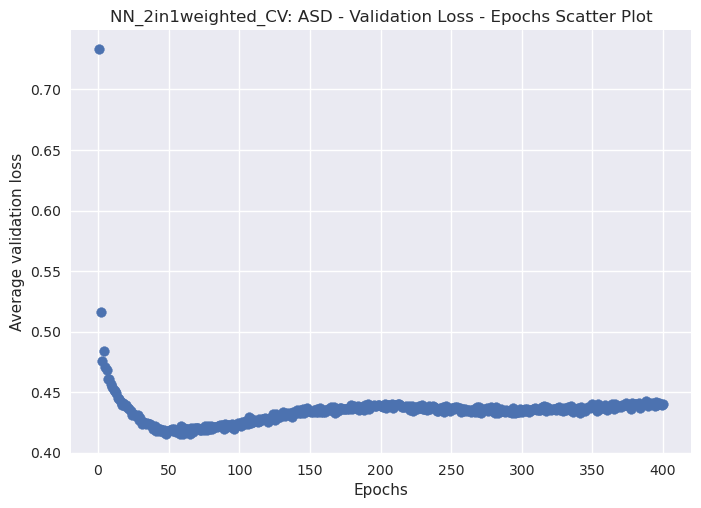

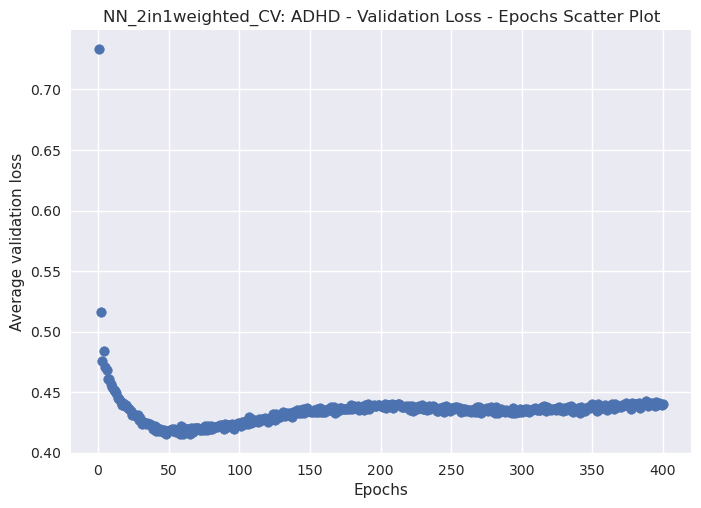

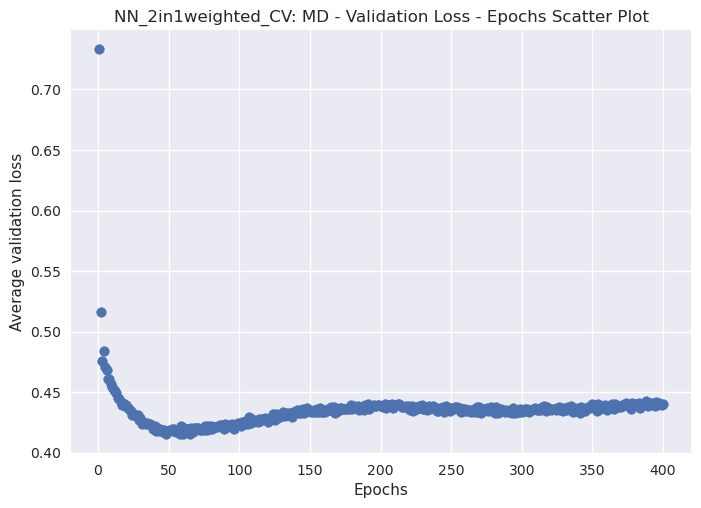

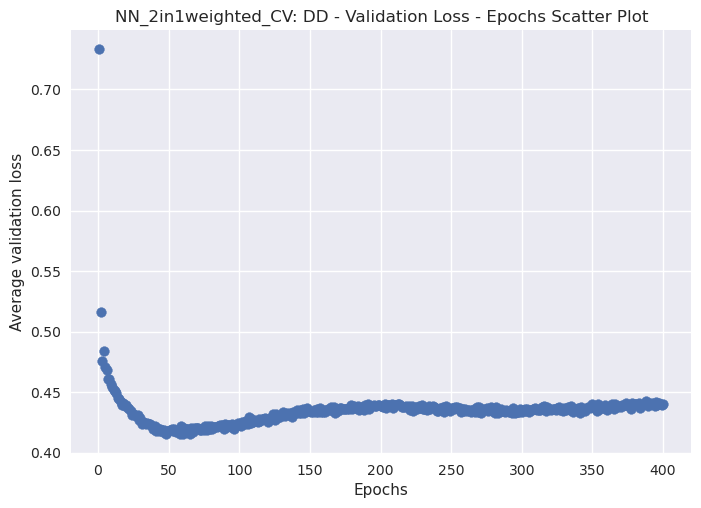

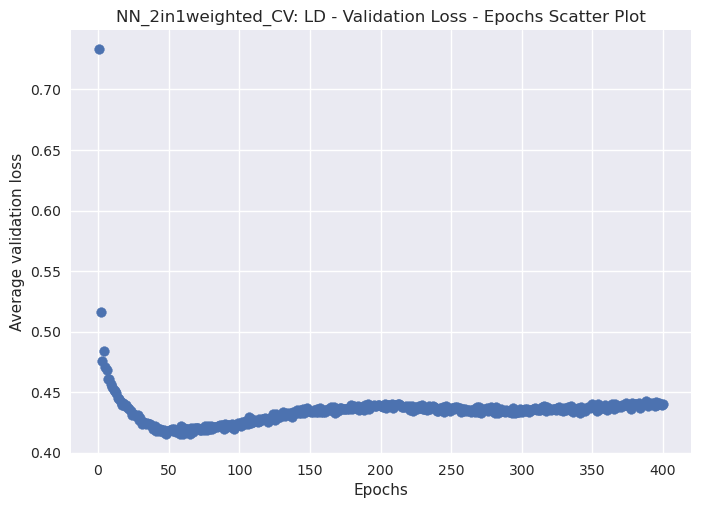

0.4151489585638046
['ASD', 'ADHD', 'MD', 'DD', 'LD']


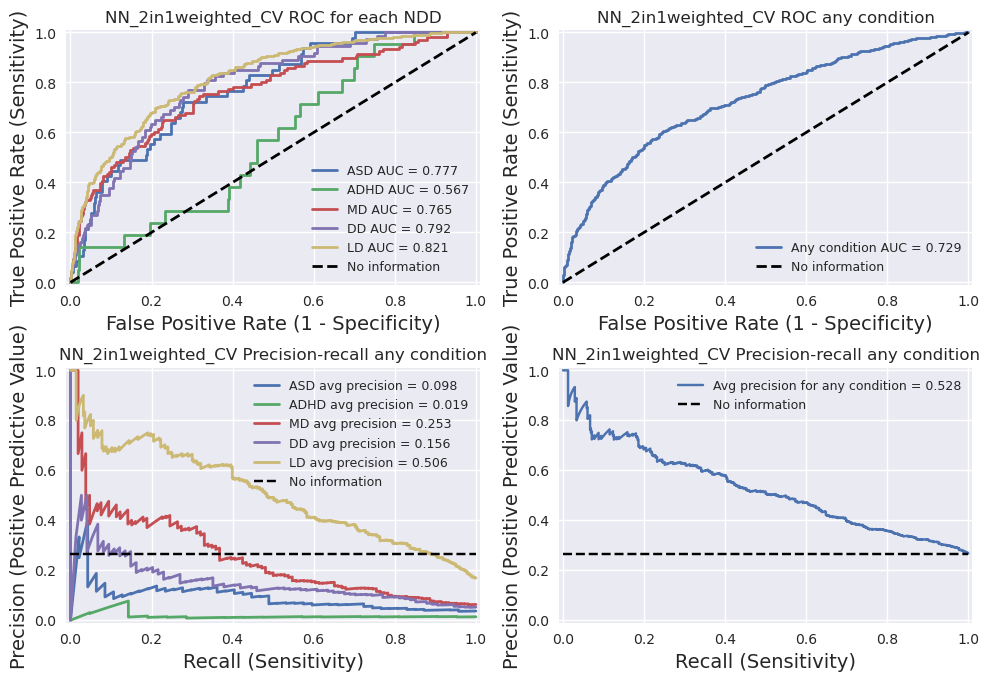

Dataset dimensions are (12960, 560) (12960, 1) (3240, 560) (3240, 1) (1800, 560) (1800, 1)


Training Epochs:   0%|          | 0/400 [00:00<?, ?it/s]

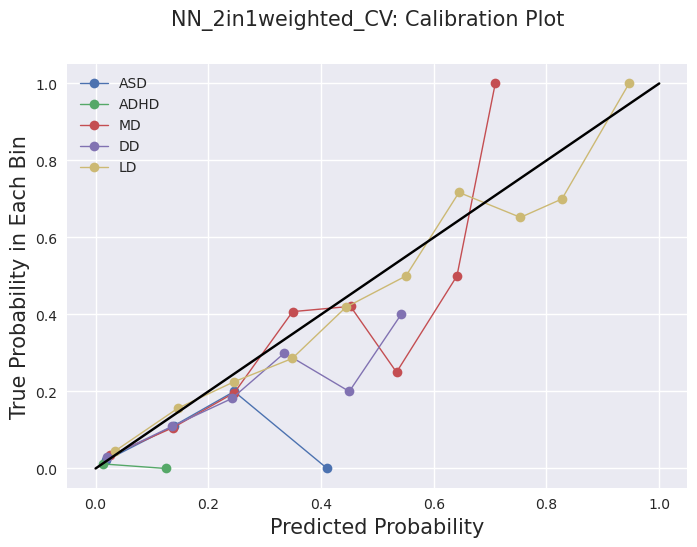

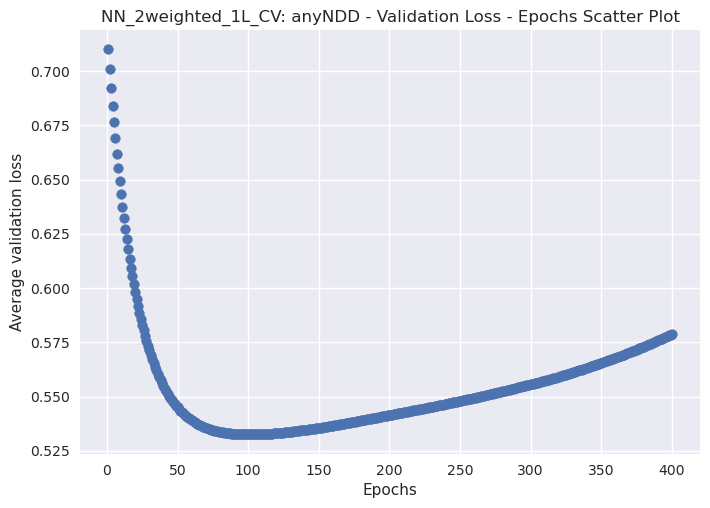

['anyNDD']


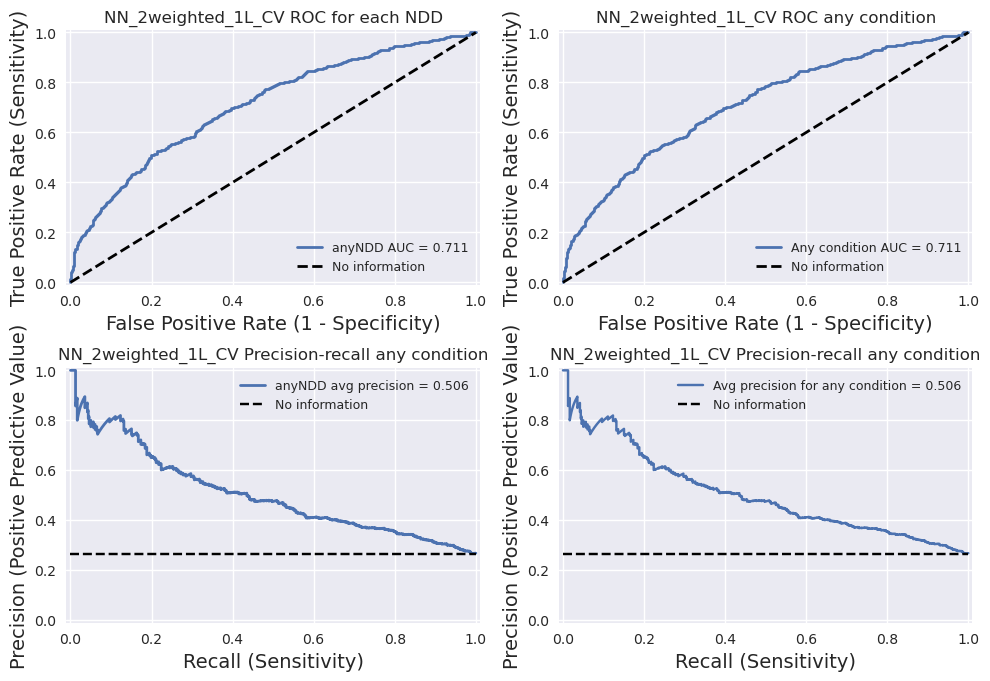

['anyNDD']


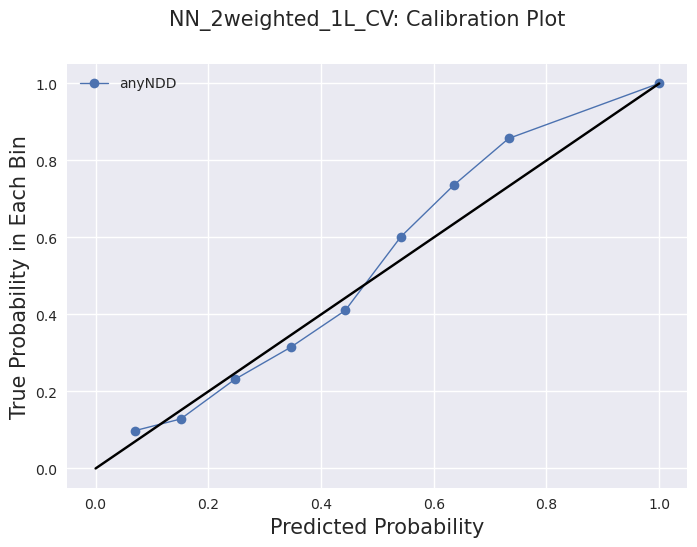

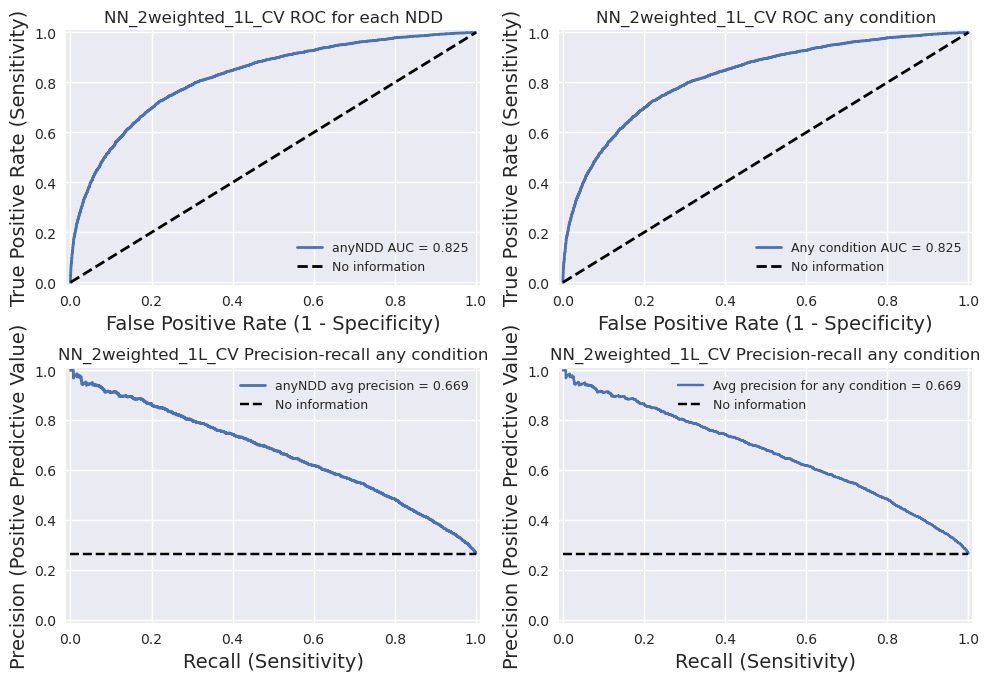

['anyNDD']


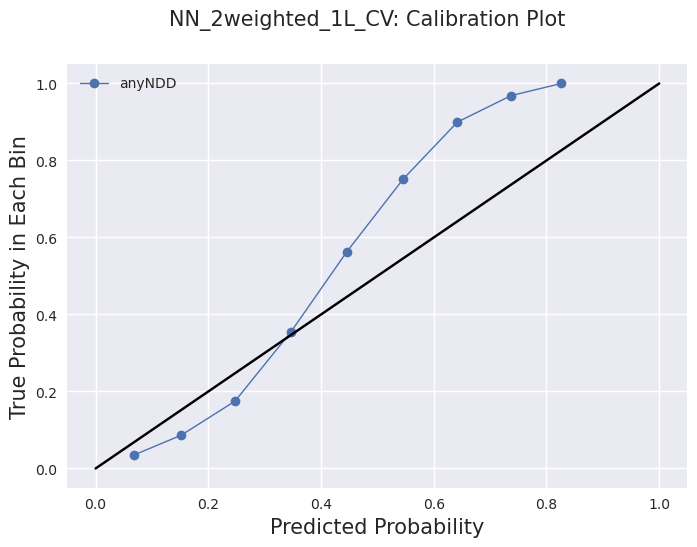

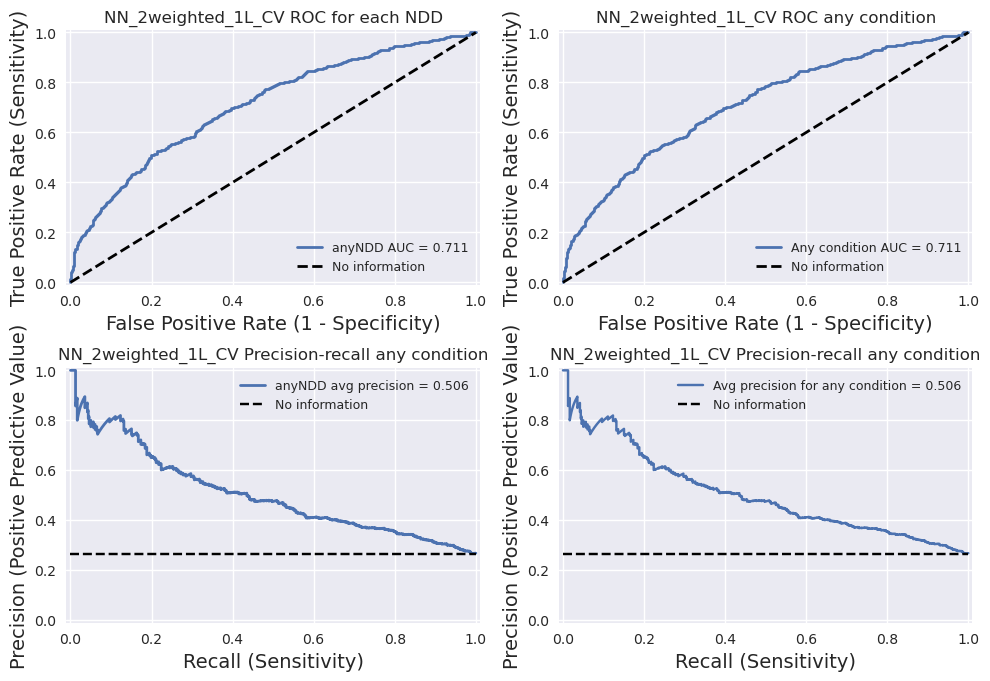

Dataset dimensions are (12960, 560) (12960, 1) (3240, 560) (3240, 1) (1800, 560) (1800, 1)


Training Epochs:   0%|          | 0/400 [00:00<?, ?it/s]

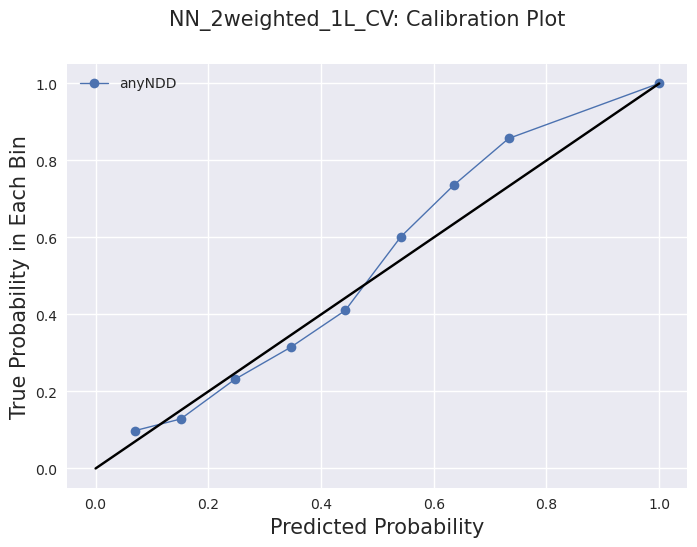

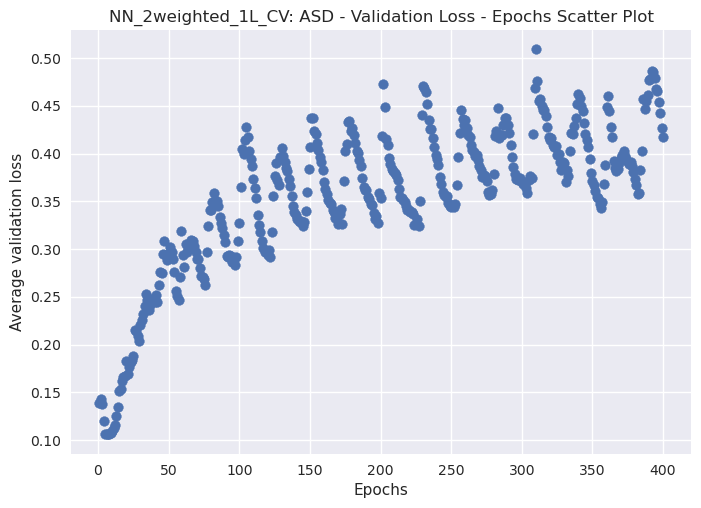

0.10593821108341217
['ASD']


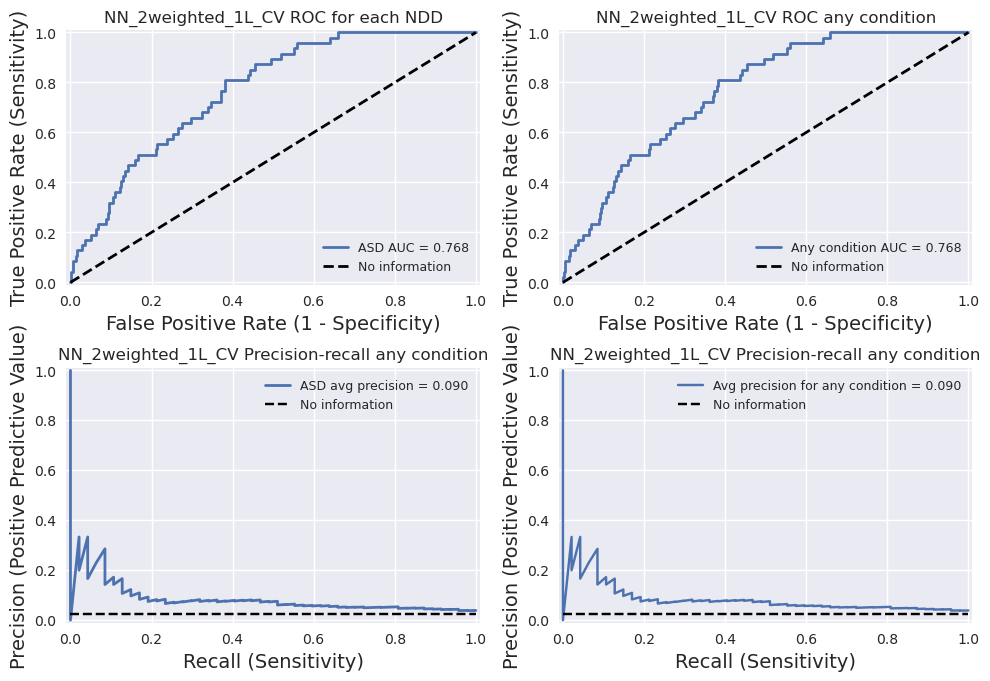

MTLnet(
  (flatten): Flatten(start_dim=1, end_dim=-1)
  (linear_sigmoid_stack): Sequential(
    (0): Linear(in_features=560, out_features=100, bias=True)
    (1): ReLU()
    (2): Linear(in_features=100, out_features=2, bias=True)
  )
)
Dataset dimensions are (12960, 560) (12960, 2) (3240, 560) (3240, 2) (1800, 560) (1800, 2)


Training Epochs:   0%|          | 0/400 [00:00<?, ?it/s]

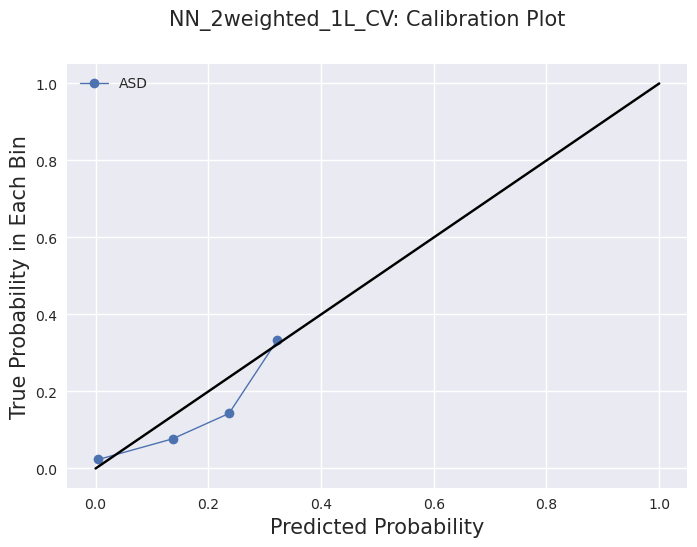

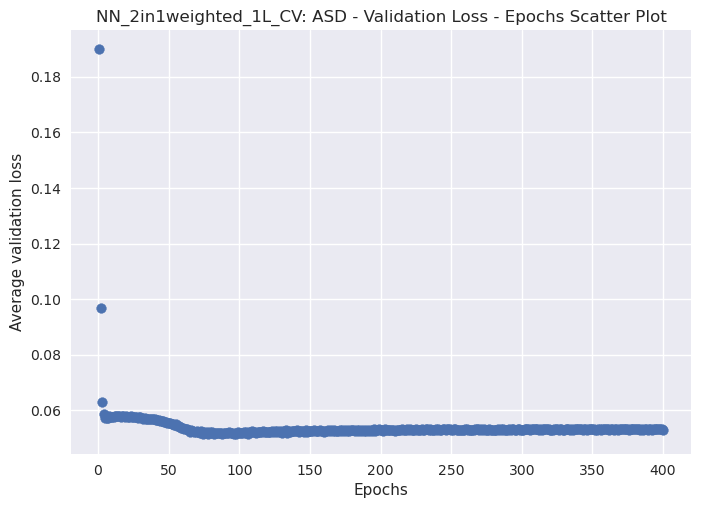

0.051373204216361046
['ASD']


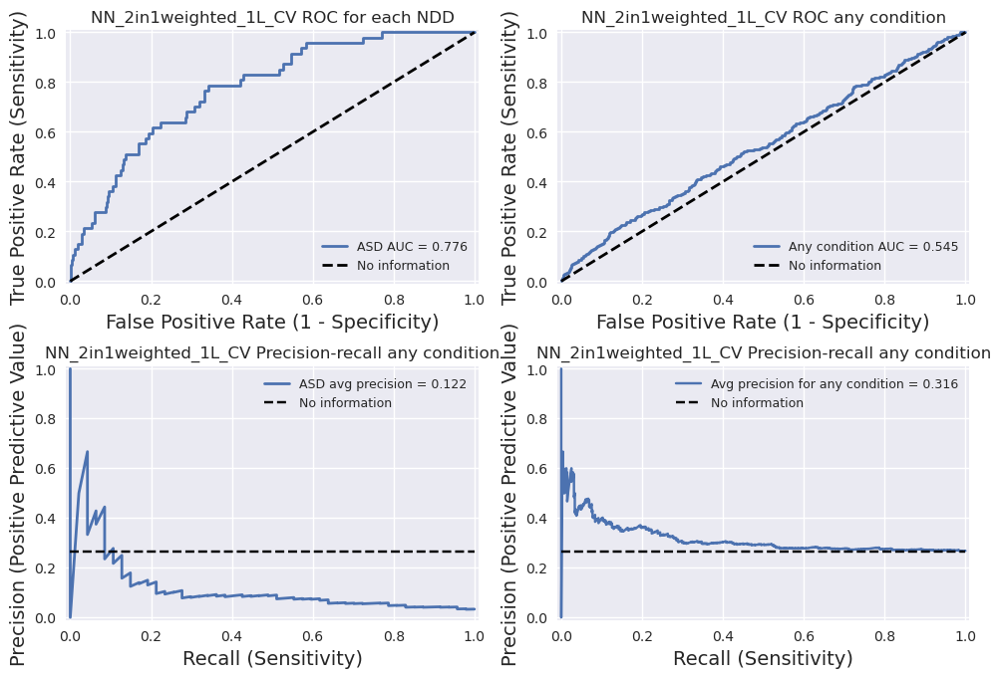

Fold 3/10
Dataset dimensions are (12960, 560) (12960, 1) (3240, 560) (3240, 1) (1800, 560) (1800, 1)



A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


Training Epochs:   0%|          | 0/200 [00:00<?, ?it/s]

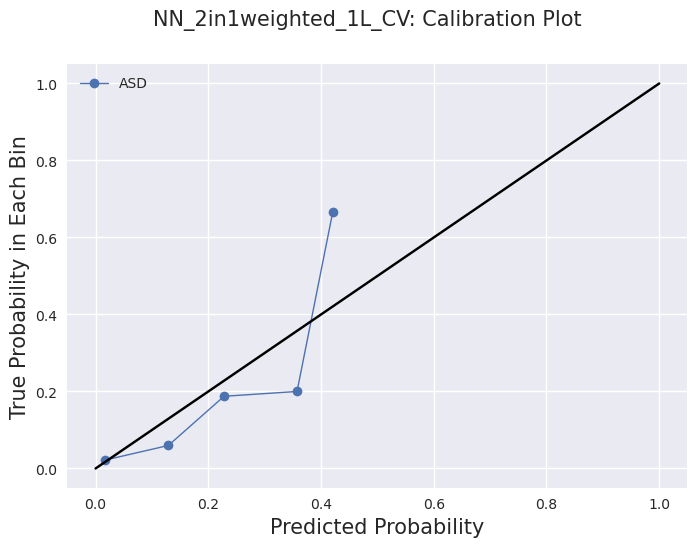

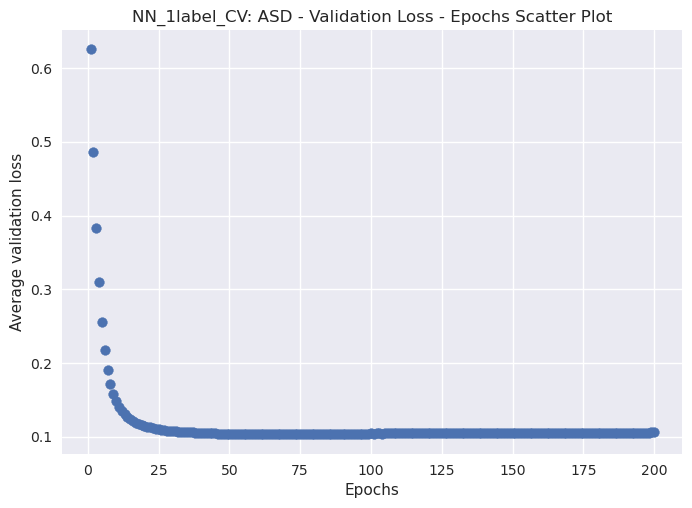

0.10324098914861679
['ASD']


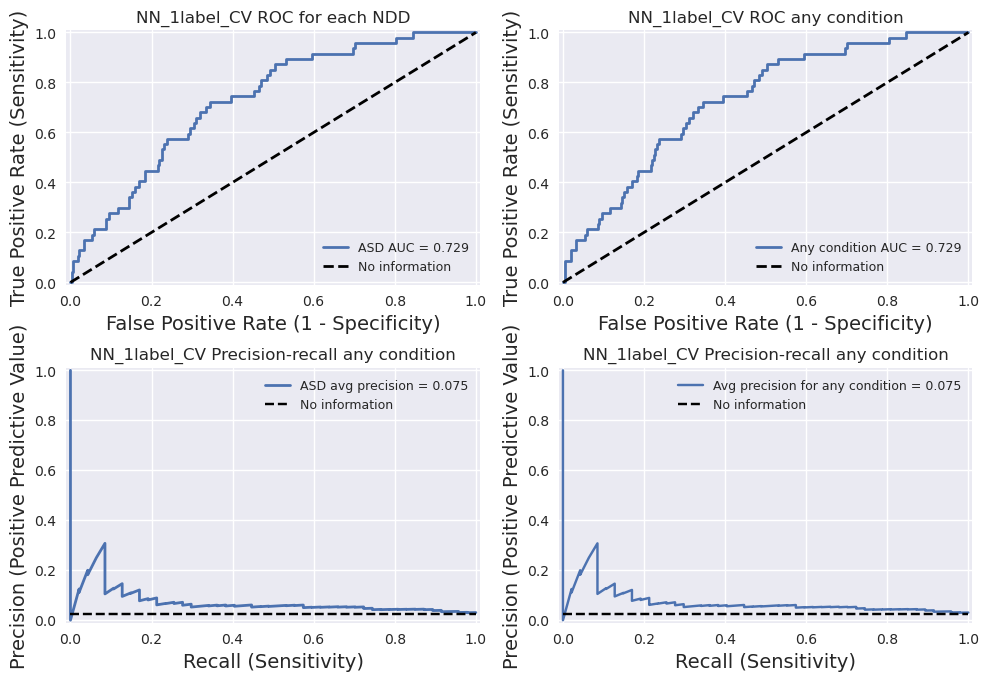

Dataset dimensions are (12960, 560) (12960, 5) (3240, 560) (3240, 5) (1800, 560) (1800, 5)


Training Epochs:   0%|          | 0/400 [00:00<?, ?it/s]

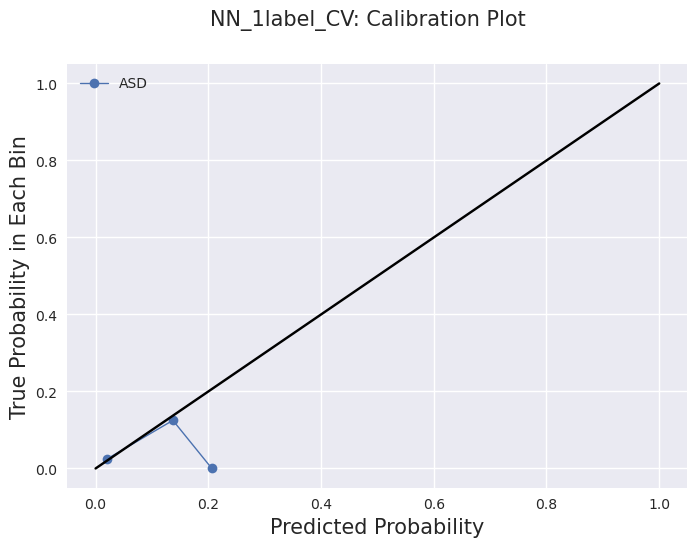

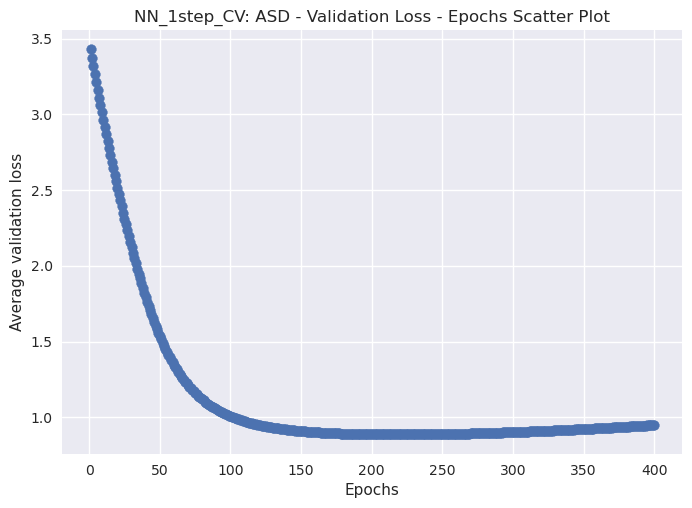

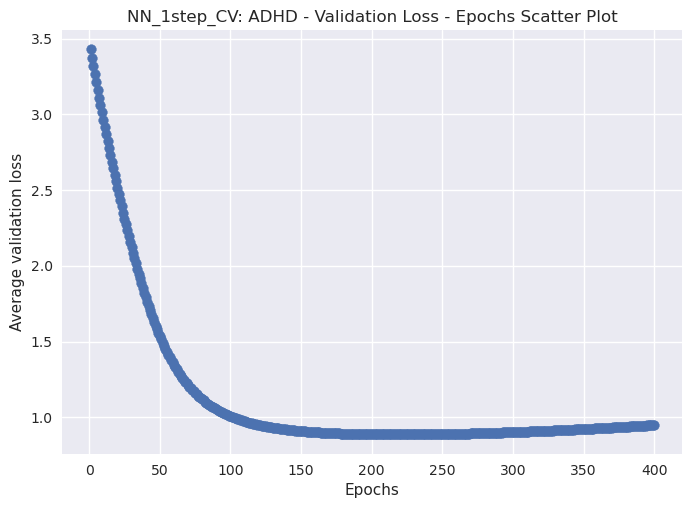

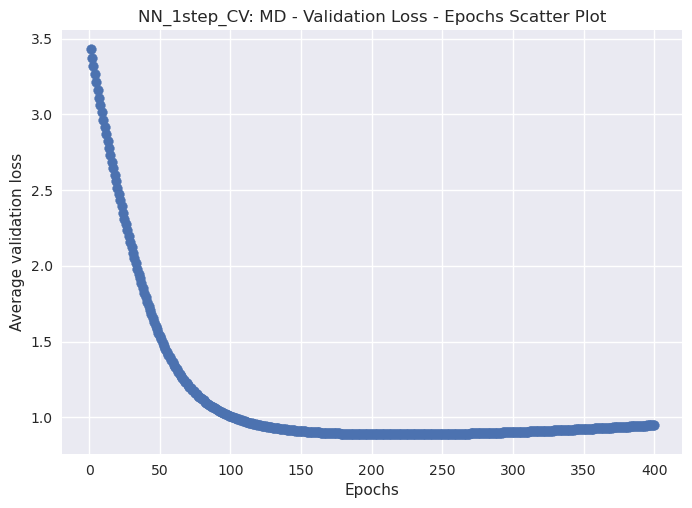

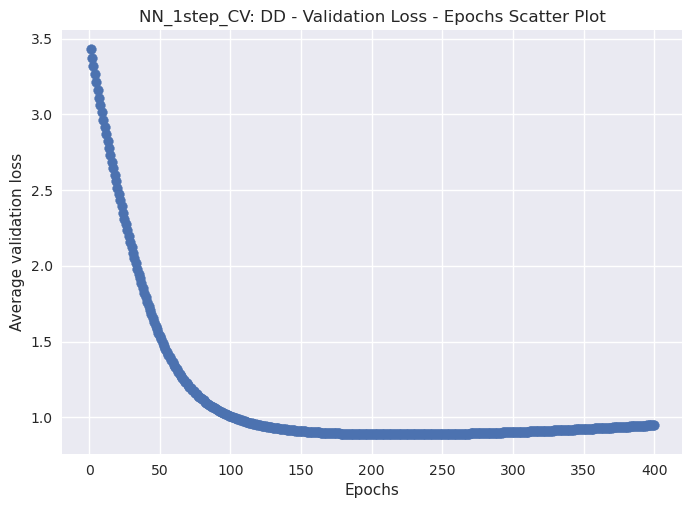

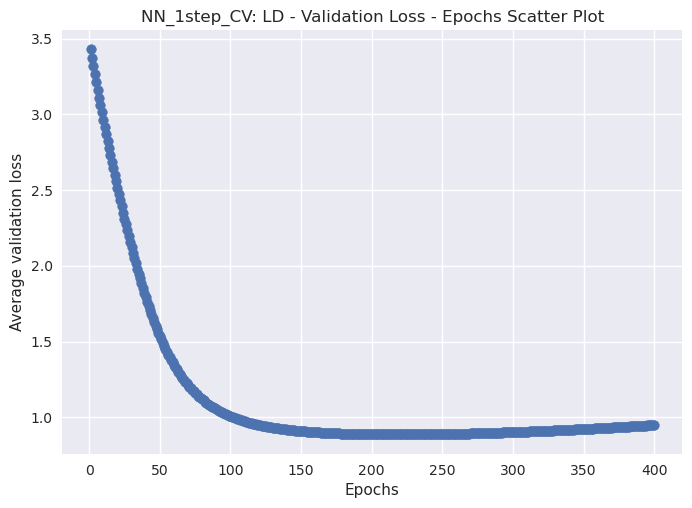

0.8873480558395386
['ASD', 'ADHD', 'MD', 'DD', 'LD']


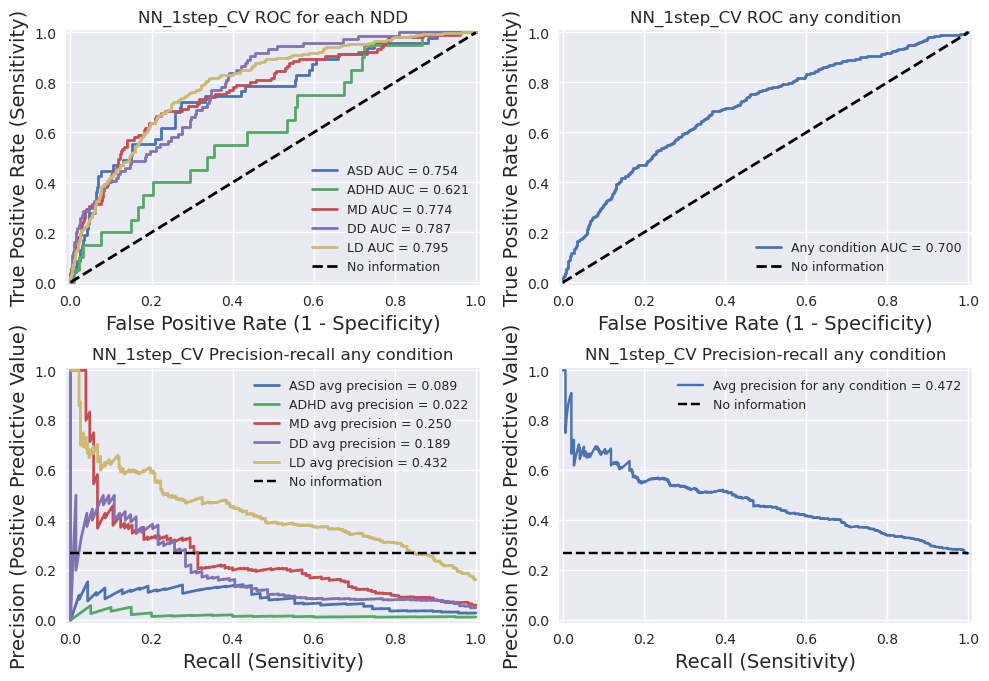

MTLnet(
  (flatten): Flatten(start_dim=1, end_dim=-1)
  (linear_sigmoid_stack): Sequential(
    (0): Linear(in_features=560, out_features=100, bias=True)
    (1): ReLU()
    (2): Linear(in_features=100, out_features=1, bias=True)
  )
)
MTLnet(
  (flatten): Flatten(start_dim=1, end_dim=-1)
  (linear_sigmoid_stack): Sequential(
    (0): Linear(in_features=560, out_features=100, bias=True)
    (1): ReLU()
    (2): Linear(in_features=100, out_features=5, bias=True)
  )
)
Dataset dimensions are (12960, 560) (12960, 1) (3240, 560) (3240, 1) (1800, 560) (1800, 1)


Training Epochs:   0%|          | 0/400 [00:00<?, ?it/s]

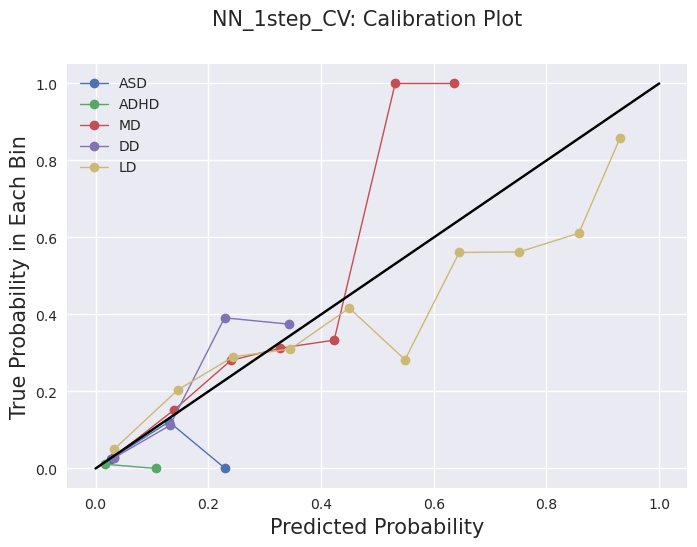

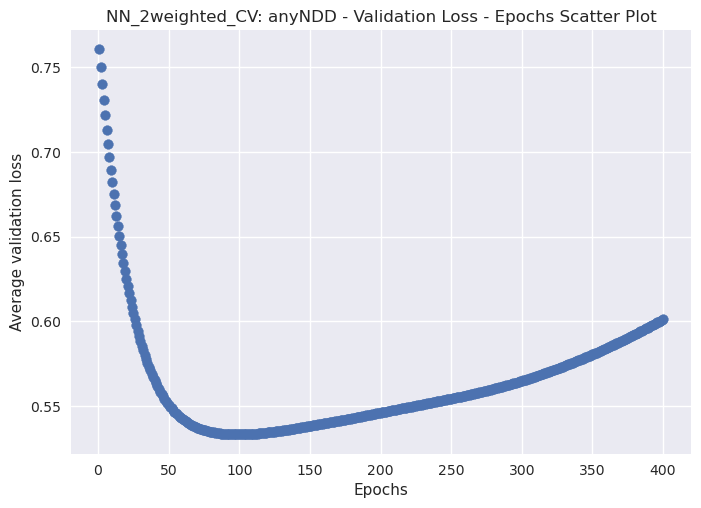

['anyNDD']


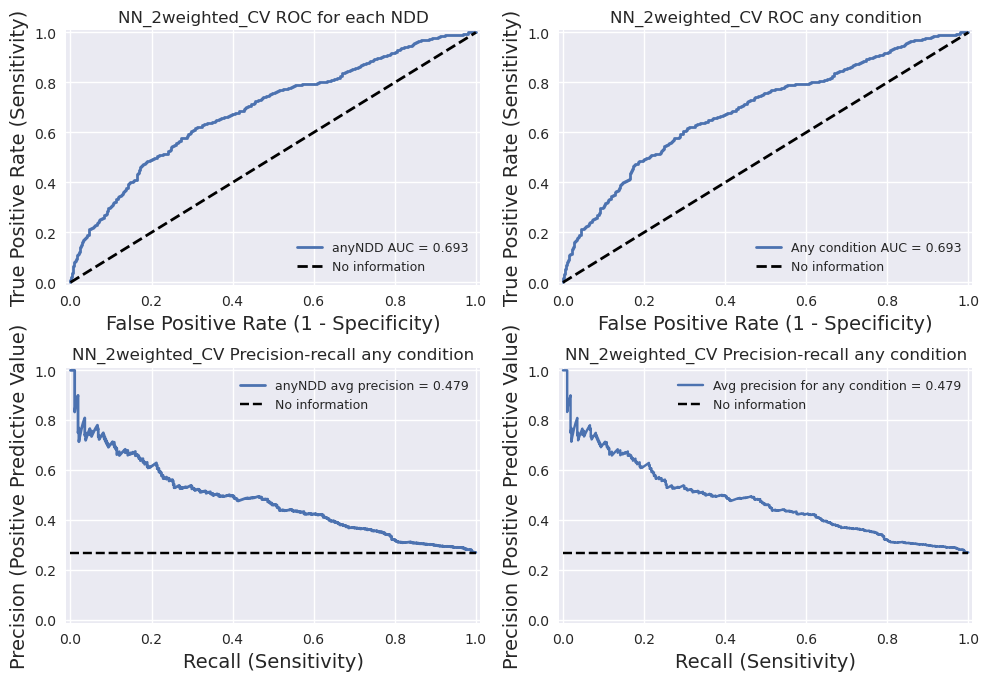

['anyNDD']


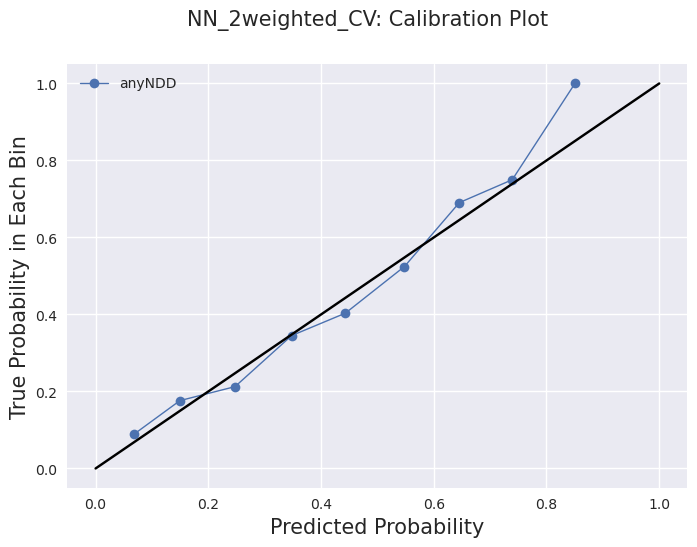

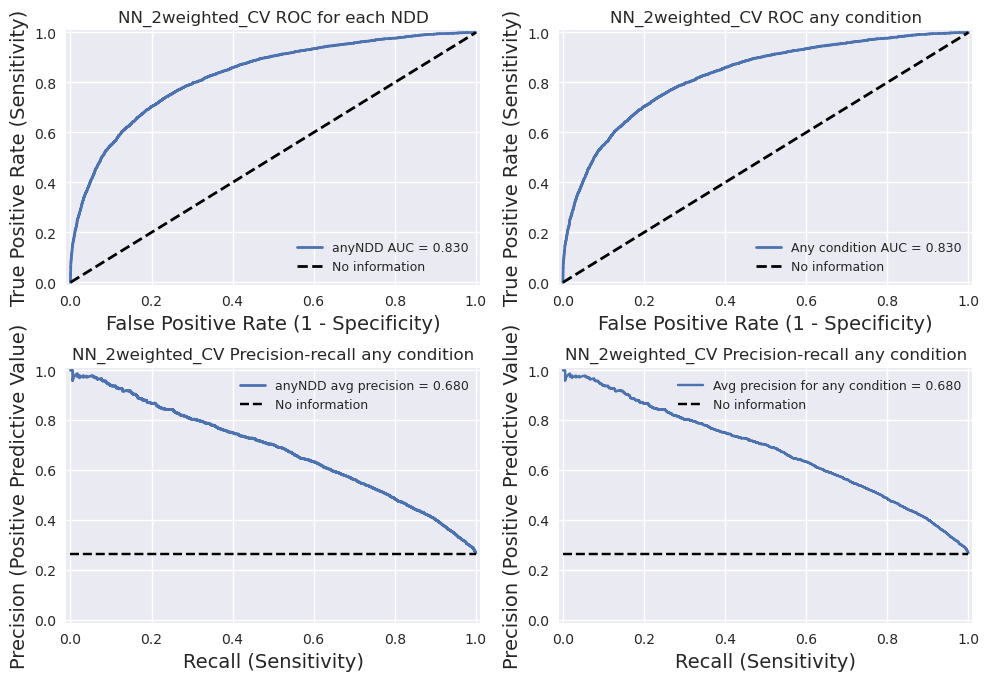

['anyNDD']


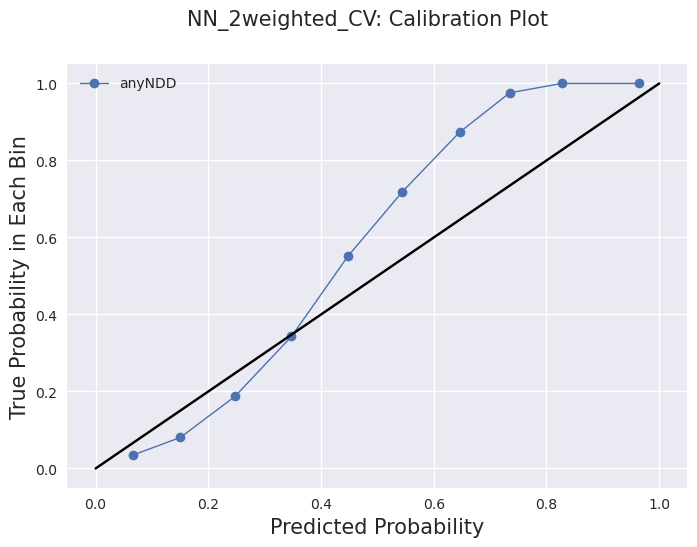

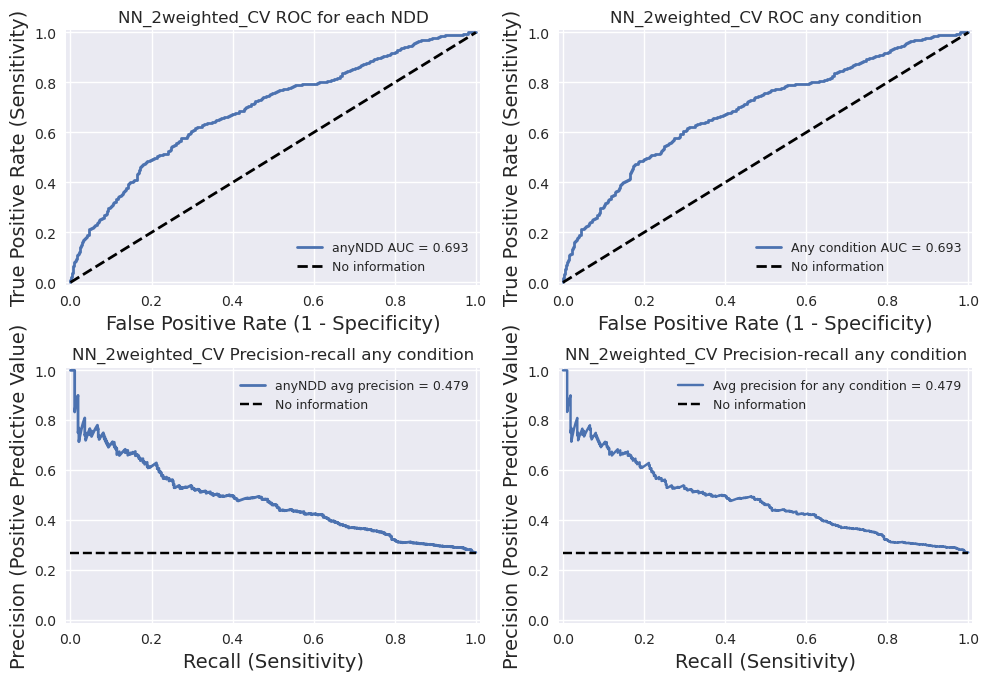

Dataset dimensions are (12960, 560) (12960, 5) (3240, 560) (3240, 5) (1800, 560) (1800, 5)


Training Epochs:   0%|          | 0/800 [00:00<?, ?it/s]

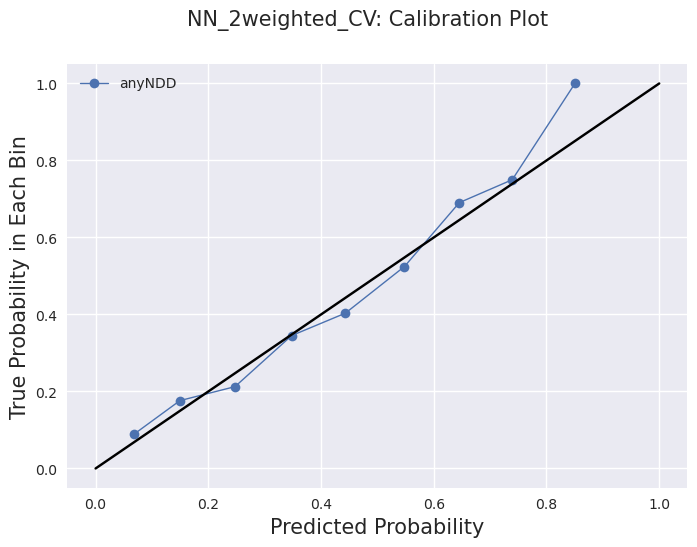

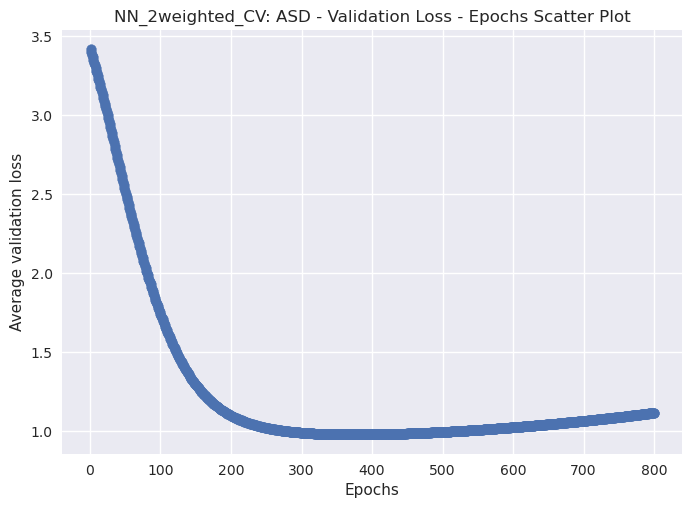

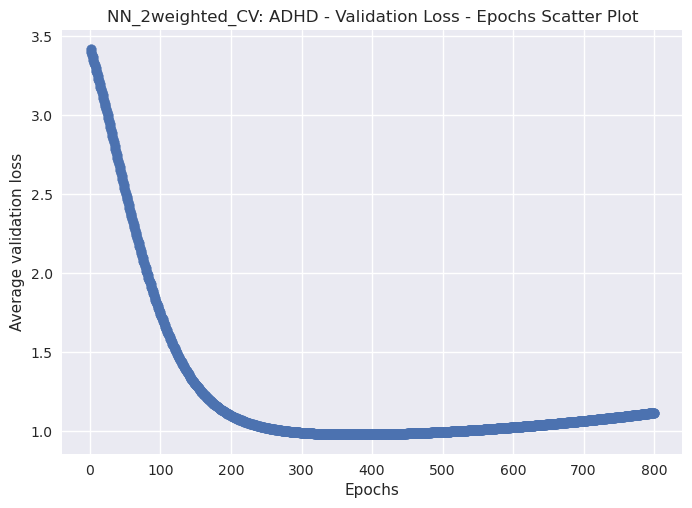

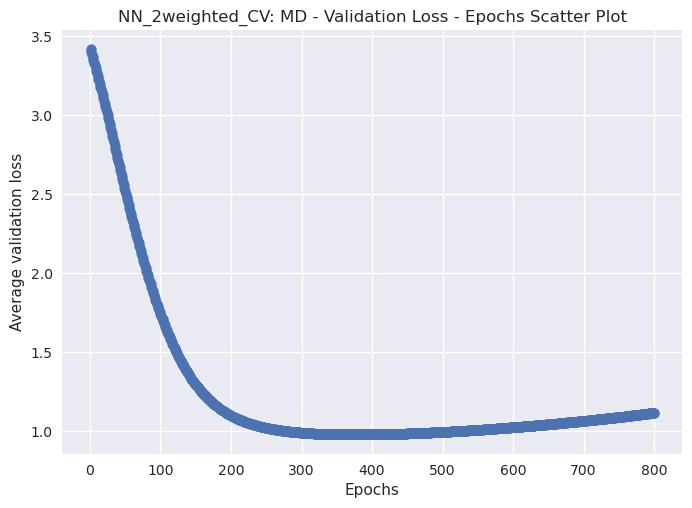

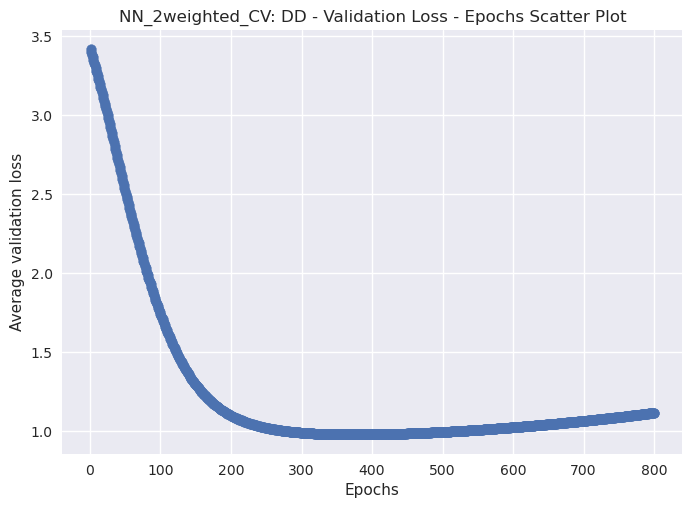

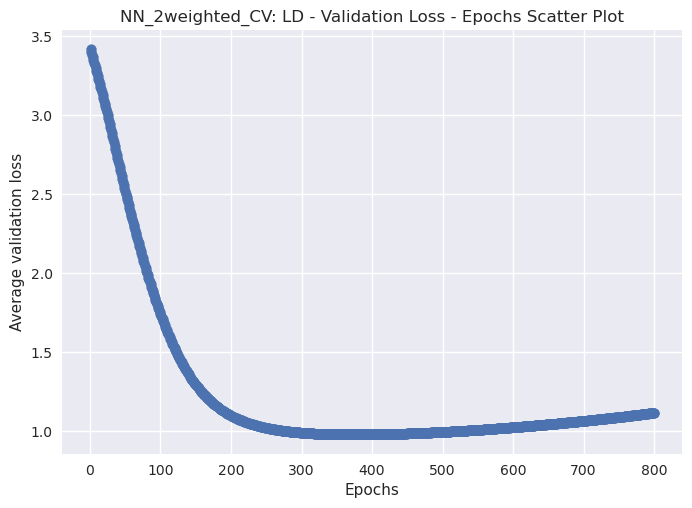

0.9782687425613403
['ASD', 'ADHD', 'MD', 'DD', 'LD']


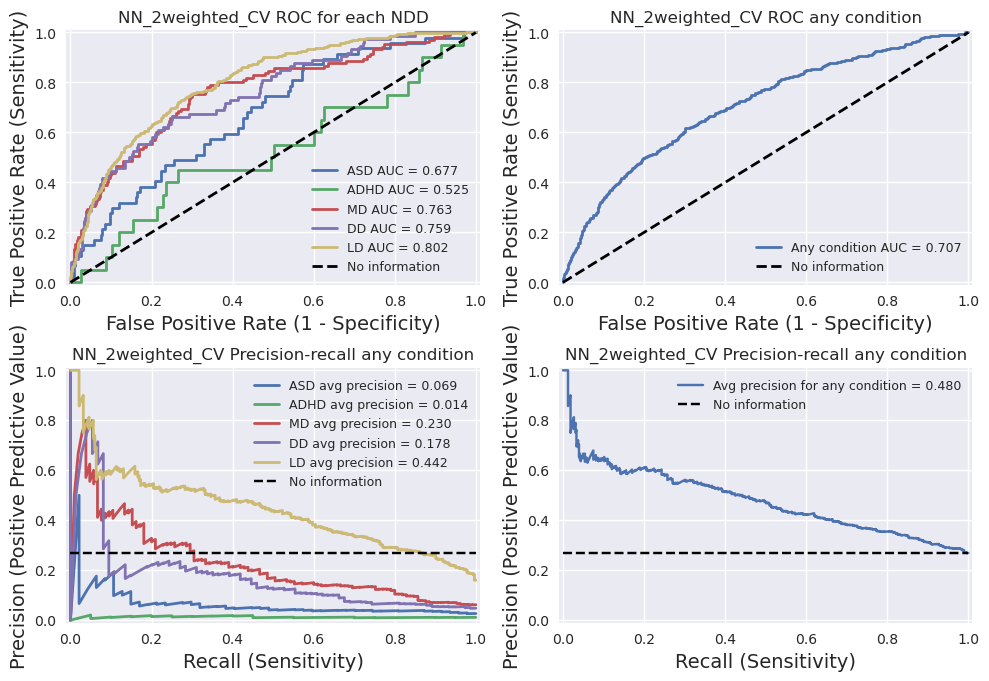

MTLnet(
  (flatten): Flatten(start_dim=1, end_dim=-1)
  (linear_sigmoid_stack): Sequential(
    (0): Linear(in_features=560, out_features=100, bias=True)
    (1): ReLU()
    (2): Linear(in_features=100, out_features=6, bias=True)
  )
)
Dataset dimensions are (12960, 560) (12960, 6) (3240, 560) (3240, 6) (1800, 560) (1800, 6)


Training Epochs:   0%|          | 0/400 [00:00<?, ?it/s]

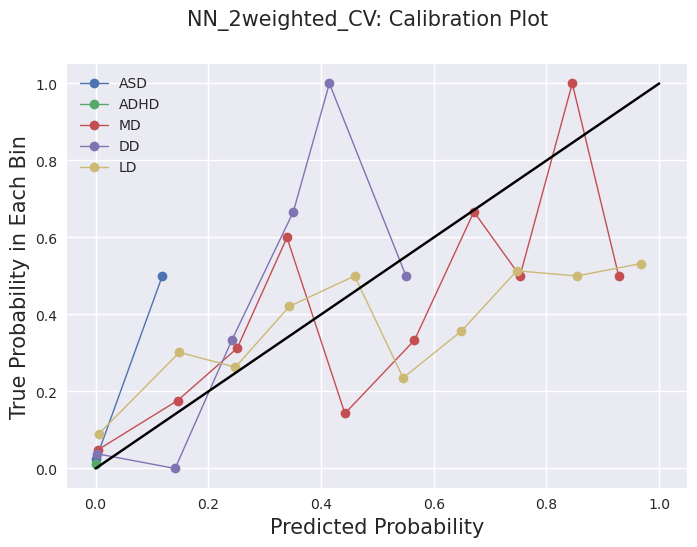

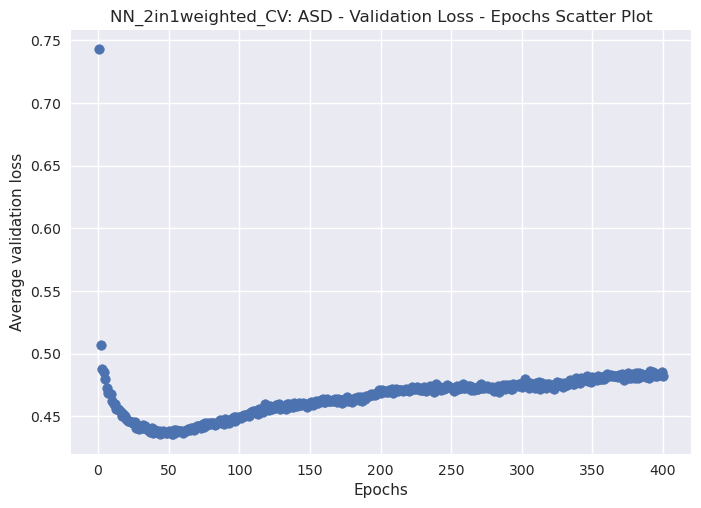

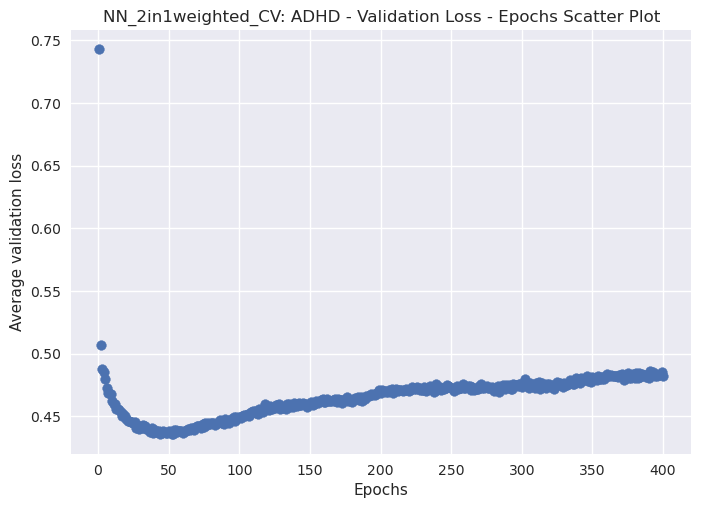

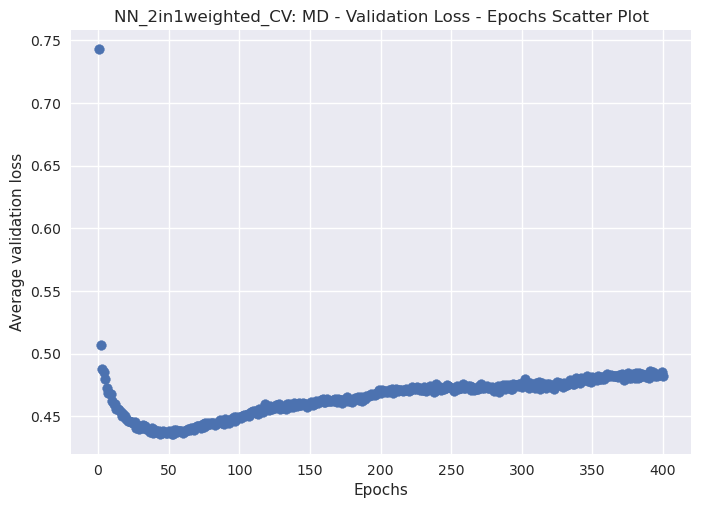

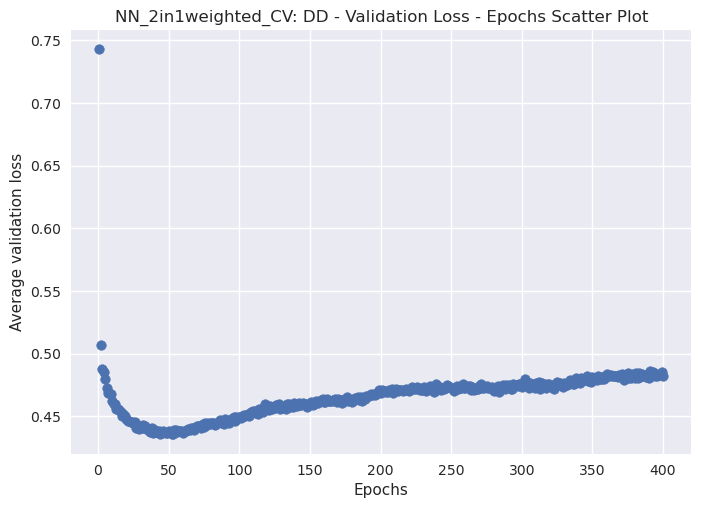

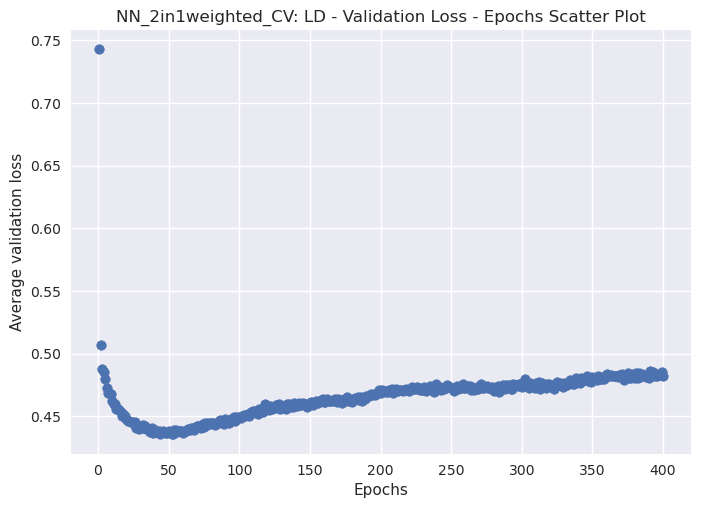

0.435514360666275
['ASD', 'ADHD', 'MD', 'DD', 'LD']


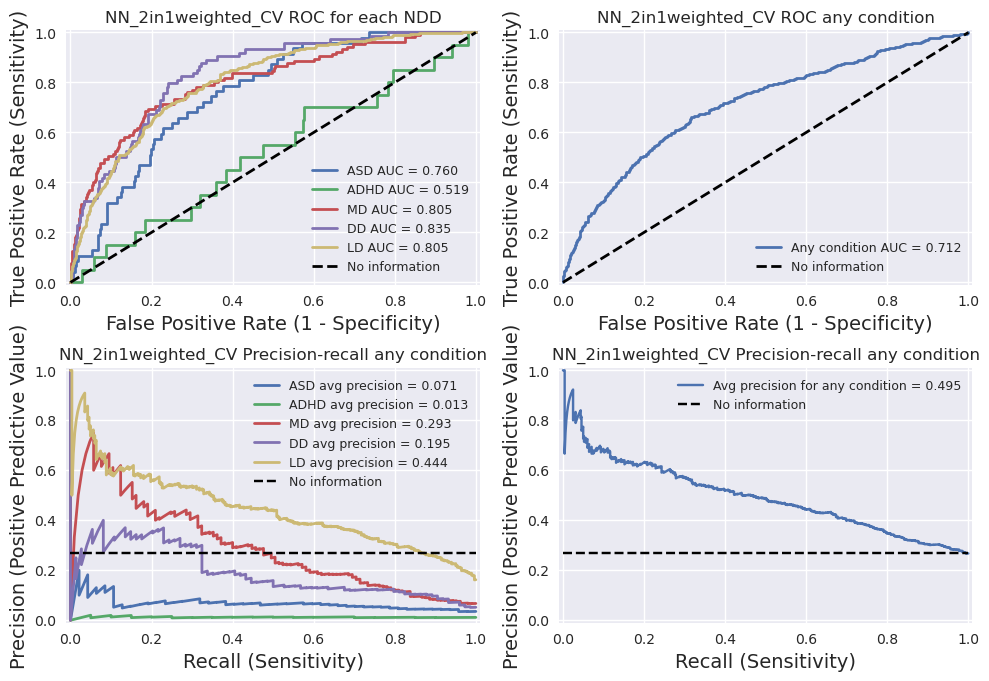

Dataset dimensions are (12960, 560) (12960, 1) (3240, 560) (3240, 1) (1800, 560) (1800, 1)


Training Epochs:   0%|          | 0/400 [00:00<?, ?it/s]

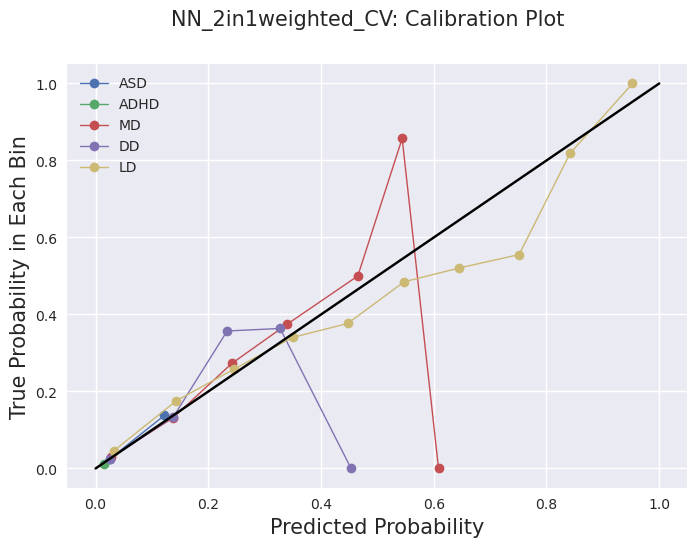

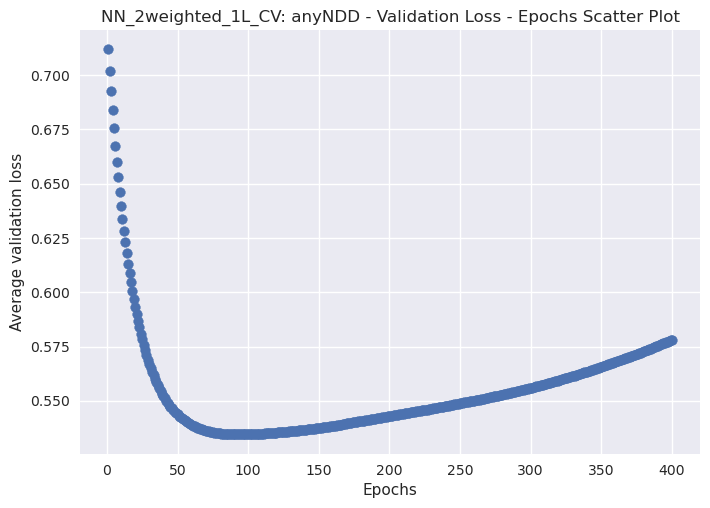

['anyNDD']


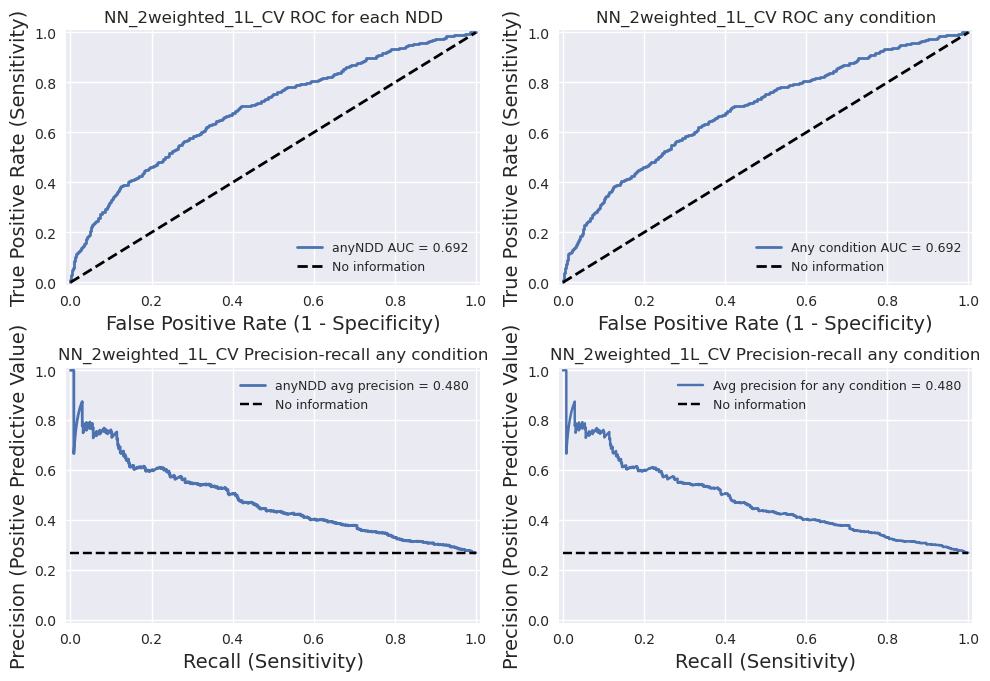

['anyNDD']


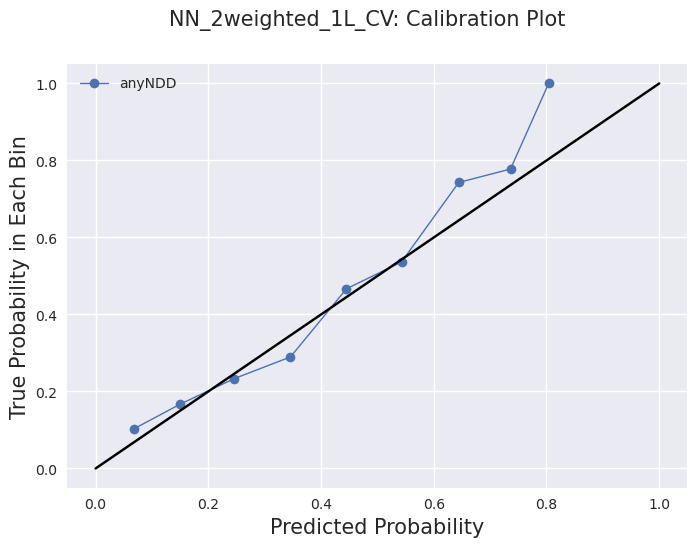

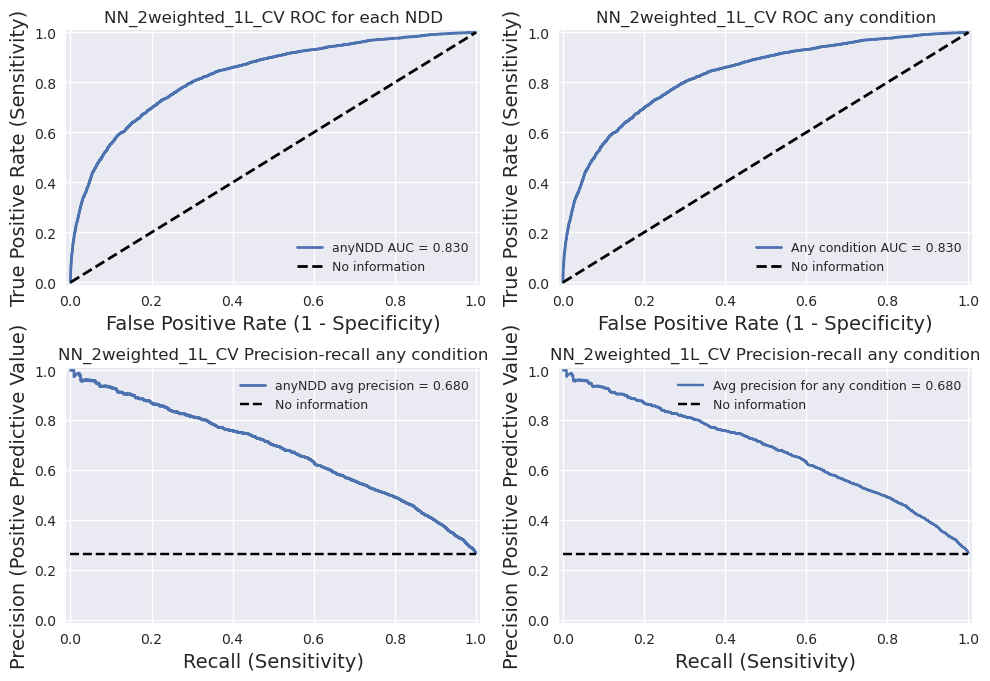

['anyNDD']


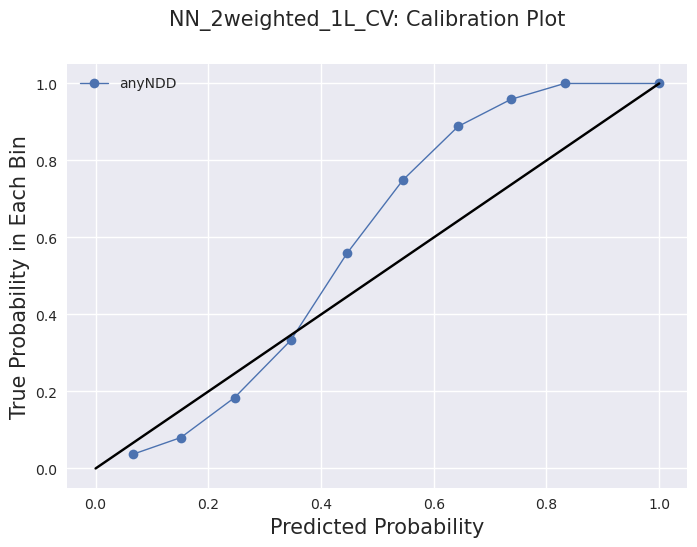

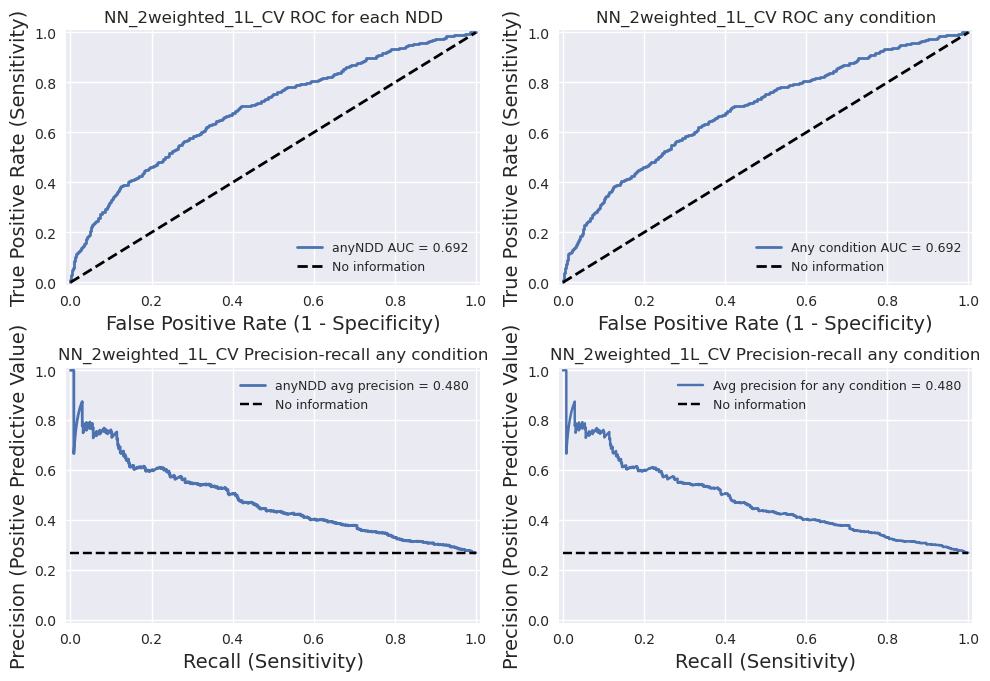

Dataset dimensions are (12960, 560) (12960, 1) (3240, 560) (3240, 1) (1800, 560) (1800, 1)


Training Epochs:   0%|          | 0/400 [00:00<?, ?it/s]

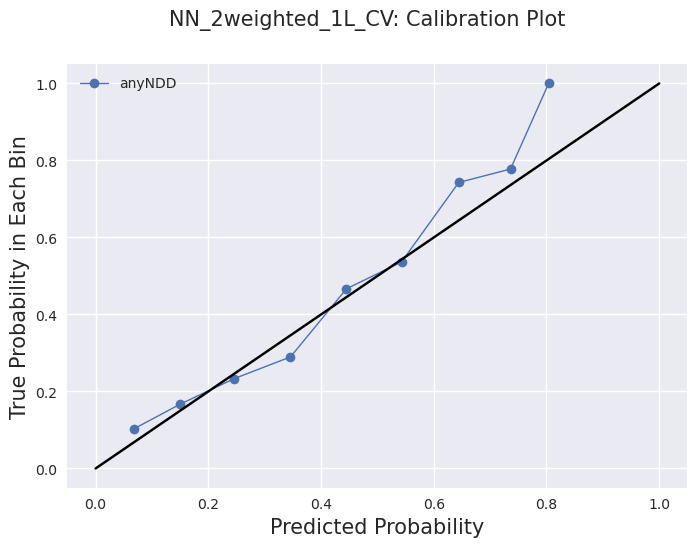

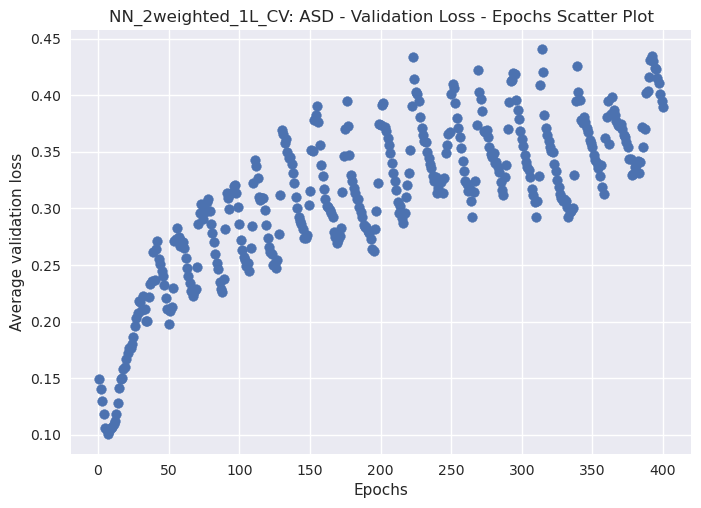

0.10027197003364563
['ASD']


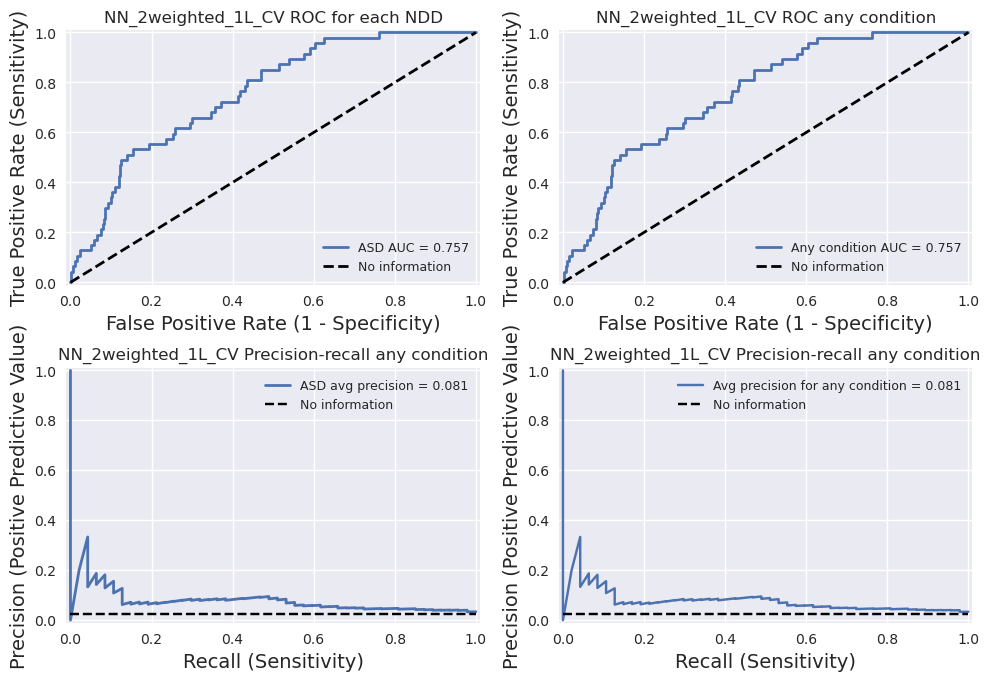

MTLnet(
  (flatten): Flatten(start_dim=1, end_dim=-1)
  (linear_sigmoid_stack): Sequential(
    (0): Linear(in_features=560, out_features=100, bias=True)
    (1): ReLU()
    (2): Linear(in_features=100, out_features=2, bias=True)
  )
)
Dataset dimensions are (12960, 560) (12960, 2) (3240, 560) (3240, 2) (1800, 560) (1800, 2)


Training Epochs:   0%|          | 0/400 [00:00<?, ?it/s]

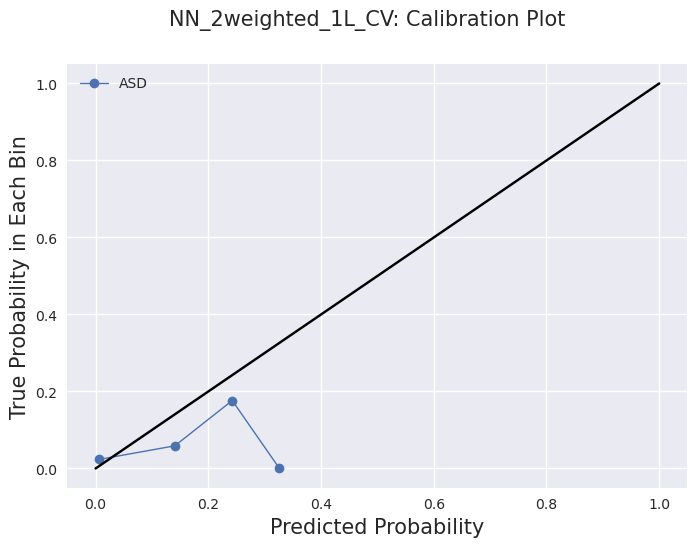

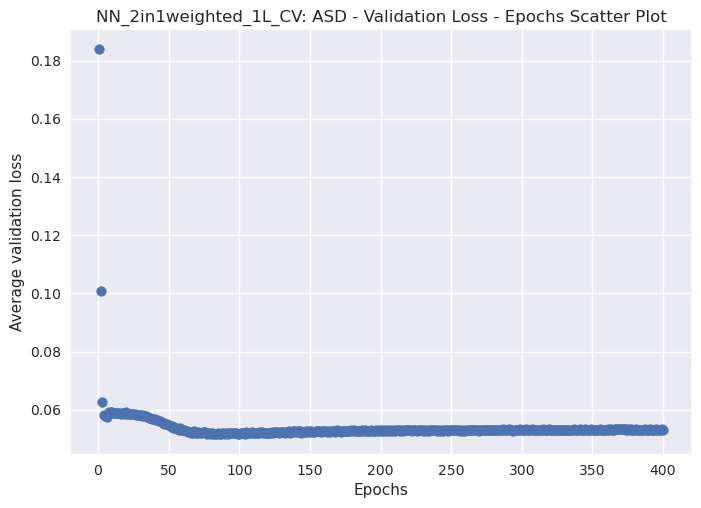

0.05152742378413677
['ASD']


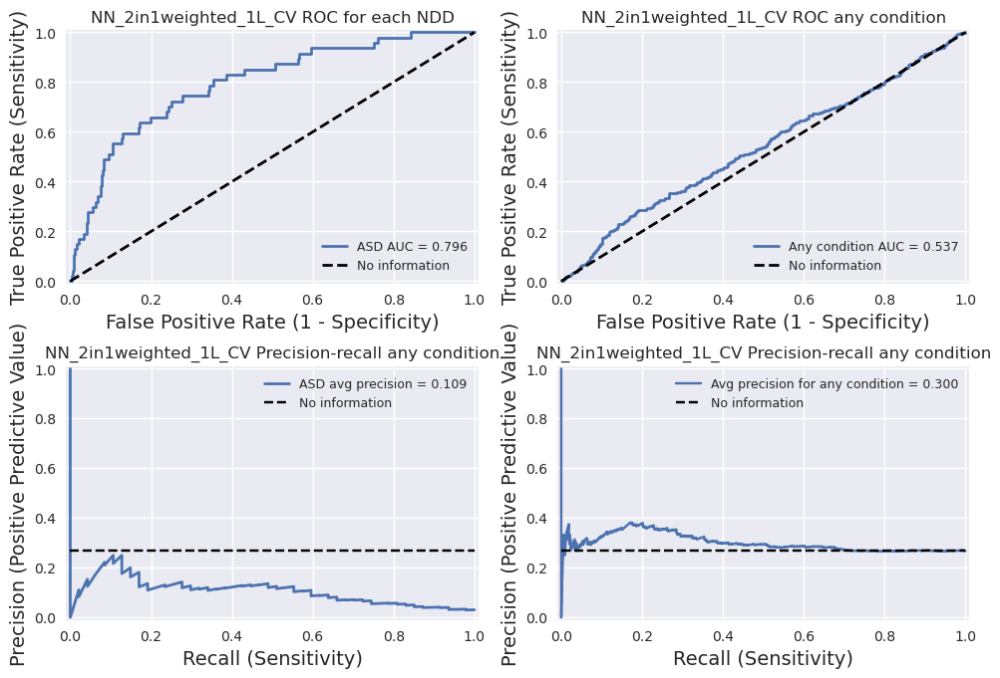

Fold 4/10
Dataset dimensions are (12960, 560) (12960, 1) (3240, 560) (3240, 1) (1800, 560) (1800, 1)



A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


Training Epochs:   0%|          | 0/200 [00:00<?, ?it/s]

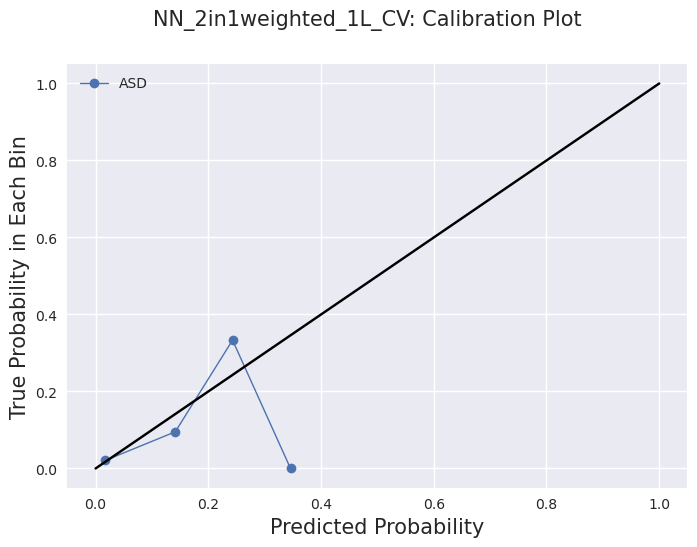

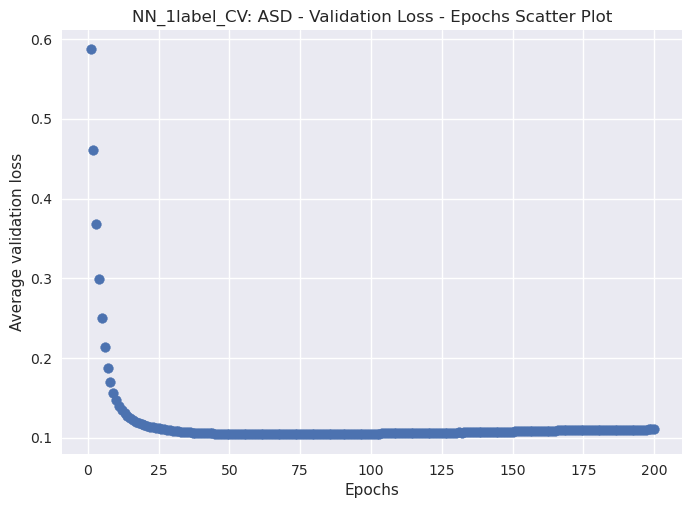

0.10402623191475868
['ASD']


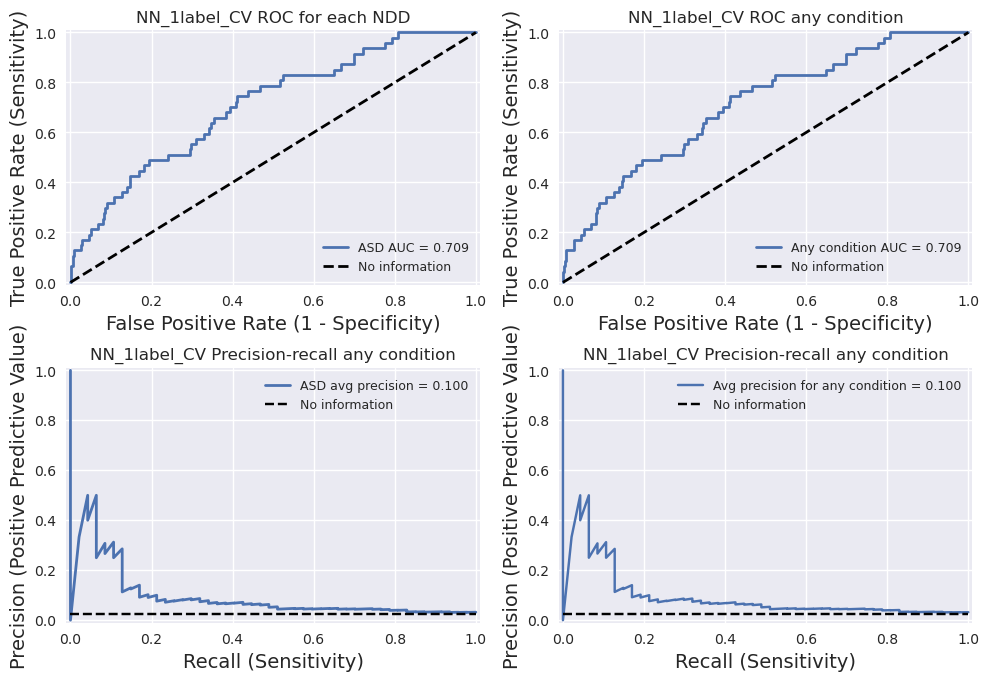

Dataset dimensions are (12960, 560) (12960, 5) (3240, 560) (3240, 5) (1800, 560) (1800, 5)


Training Epochs:   0%|          | 0/400 [00:00<?, ?it/s]

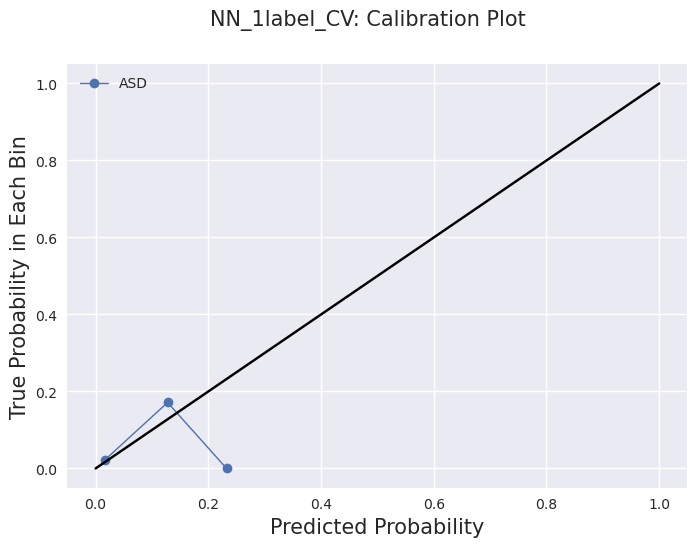

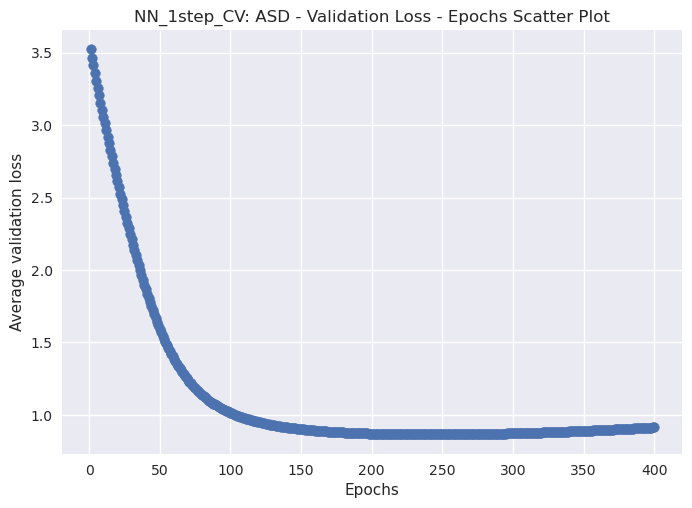

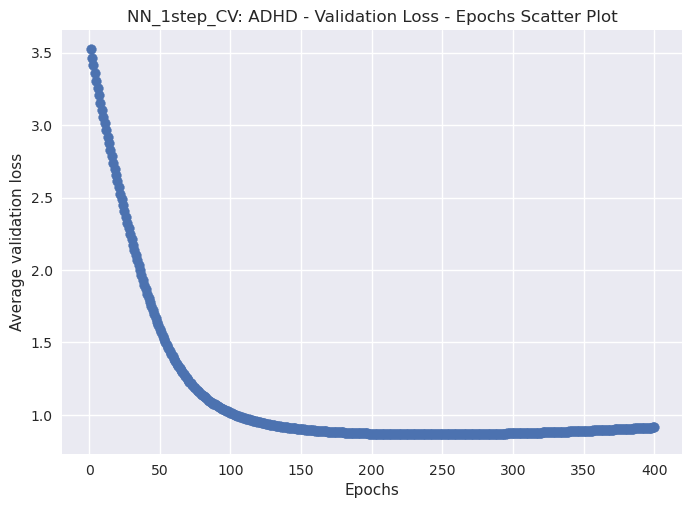

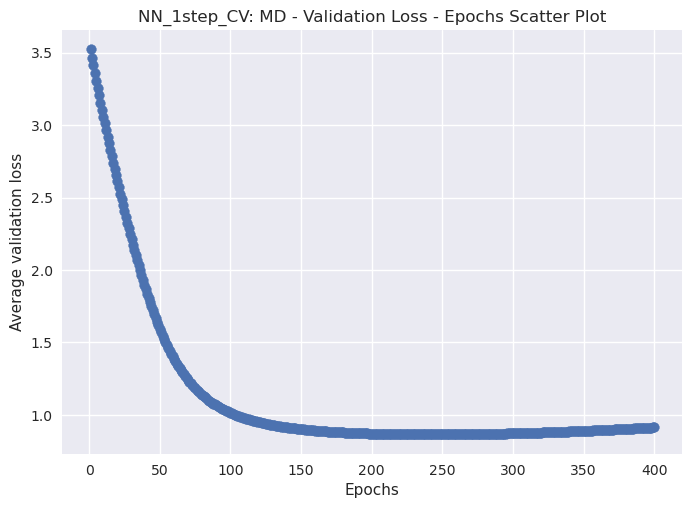

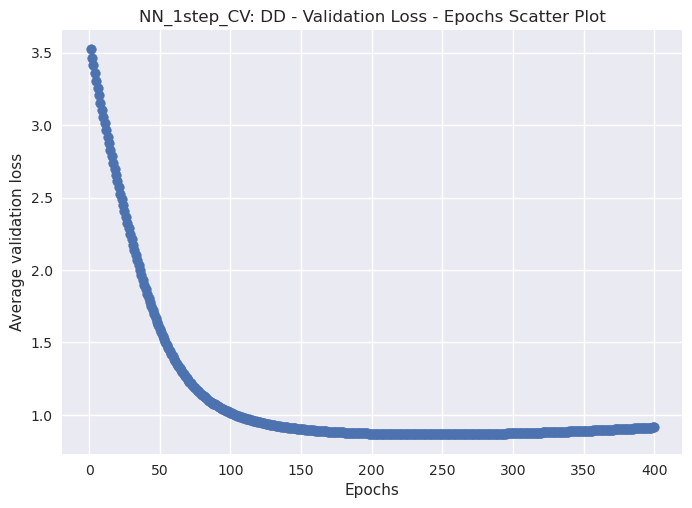

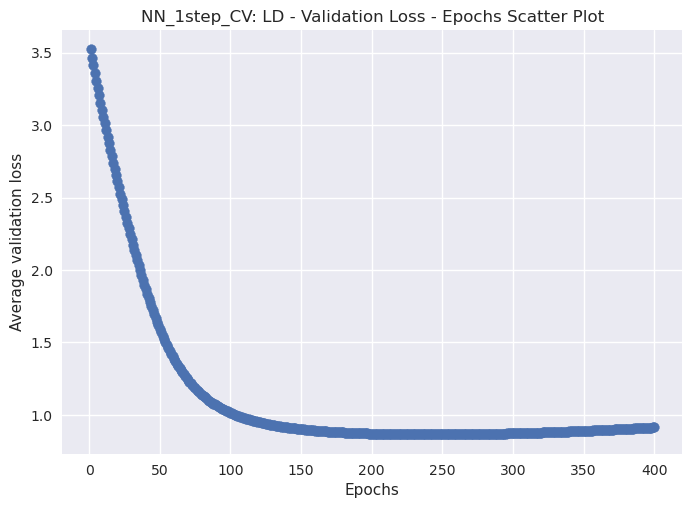

0.8653442859649658
['ASD', 'ADHD', 'MD', 'DD', 'LD']


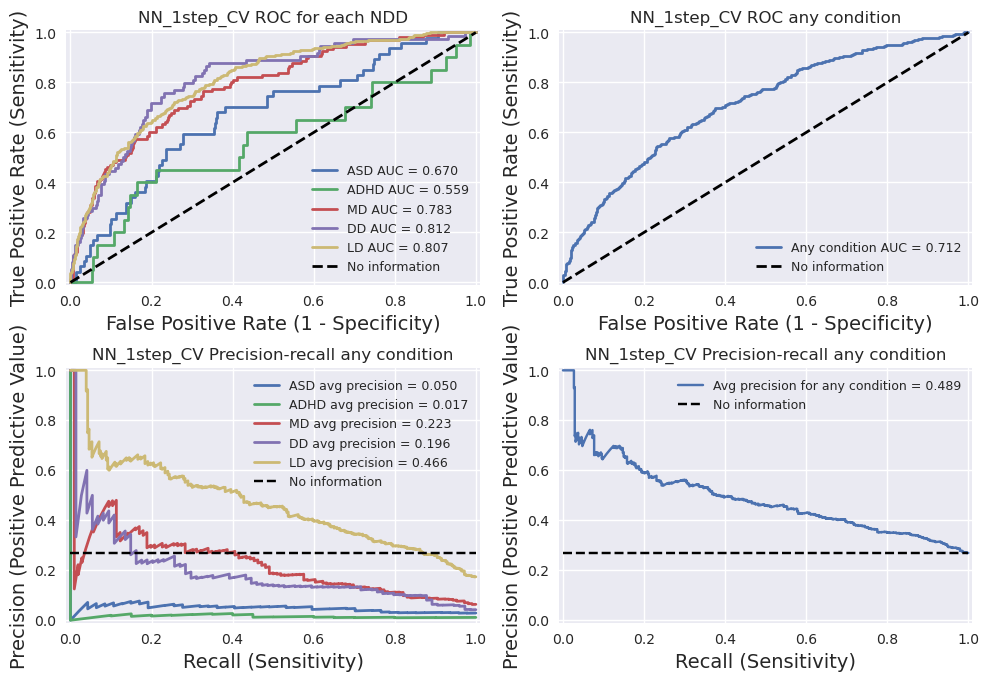

MTLnet(
  (flatten): Flatten(start_dim=1, end_dim=-1)
  (linear_sigmoid_stack): Sequential(
    (0): Linear(in_features=560, out_features=100, bias=True)
    (1): ReLU()
    (2): Linear(in_features=100, out_features=1, bias=True)
  )
)
MTLnet(
  (flatten): Flatten(start_dim=1, end_dim=-1)
  (linear_sigmoid_stack): Sequential(
    (0): Linear(in_features=560, out_features=100, bias=True)
    (1): ReLU()
    (2): Linear(in_features=100, out_features=5, bias=True)
  )
)
Dataset dimensions are (12960, 560) (12960, 1) (3240, 560) (3240, 1) (1800, 560) (1800, 1)


Training Epochs:   0%|          | 0/400 [00:00<?, ?it/s]

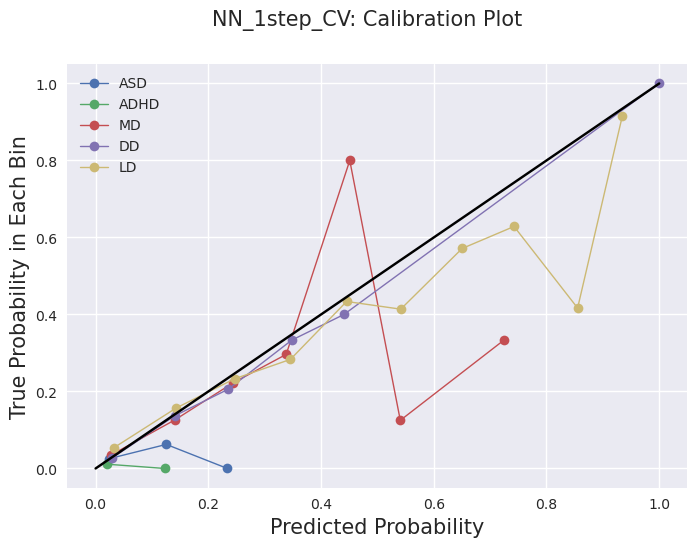

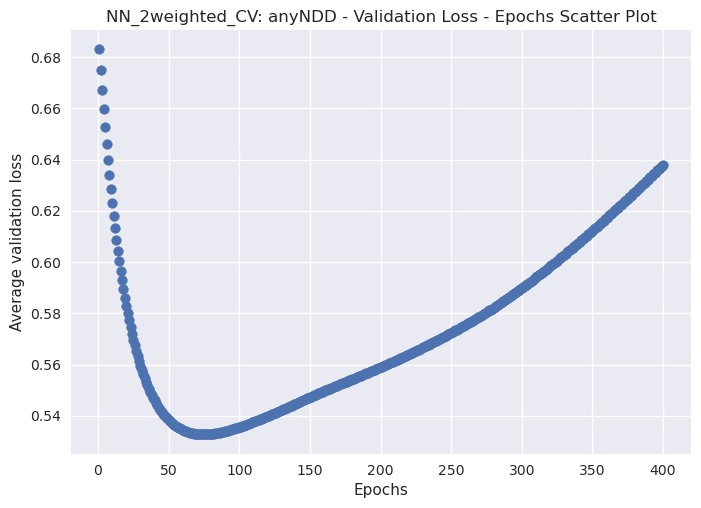

['anyNDD']


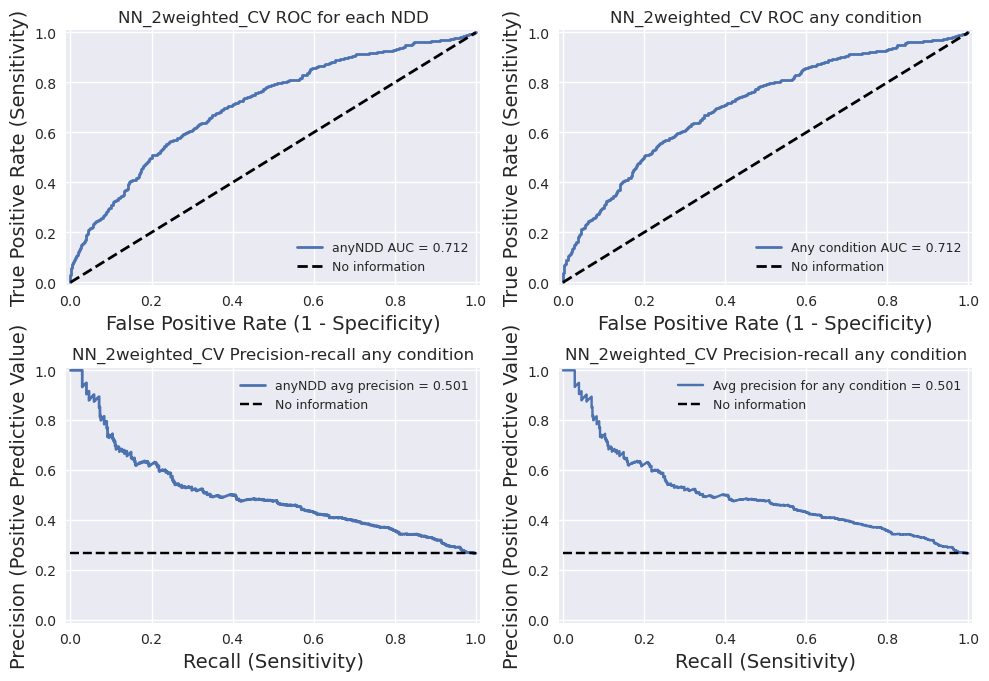

['anyNDD']


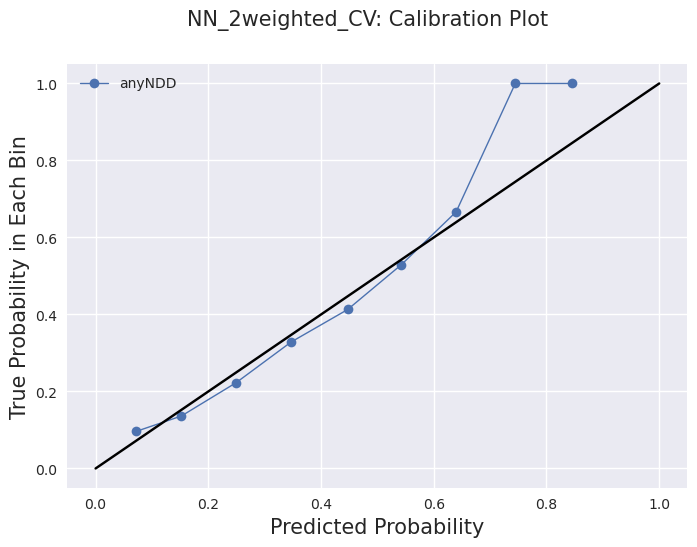

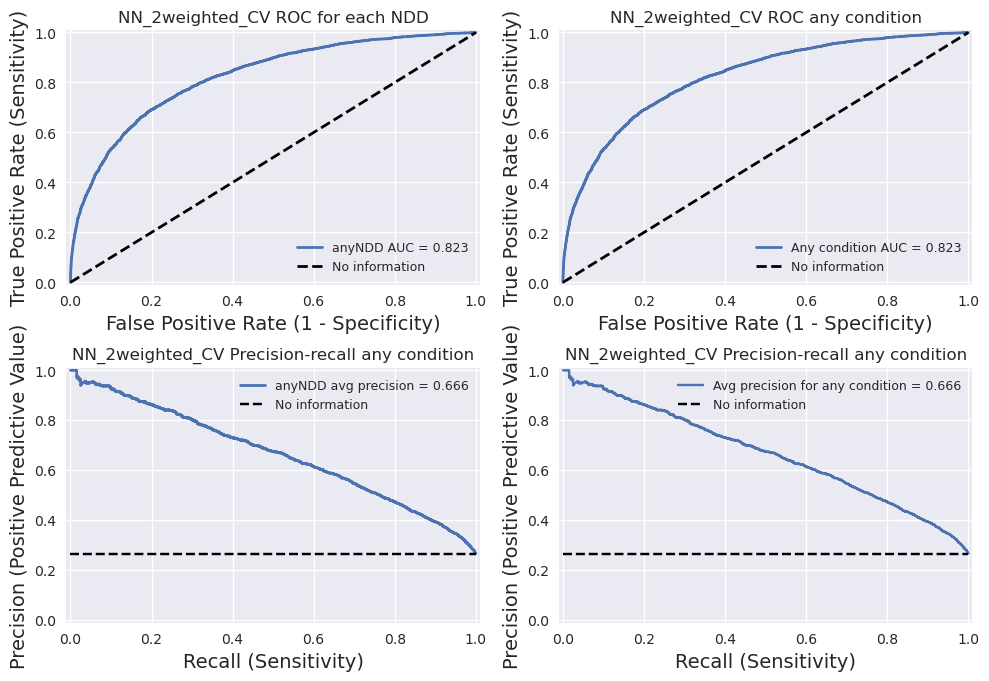

['anyNDD']


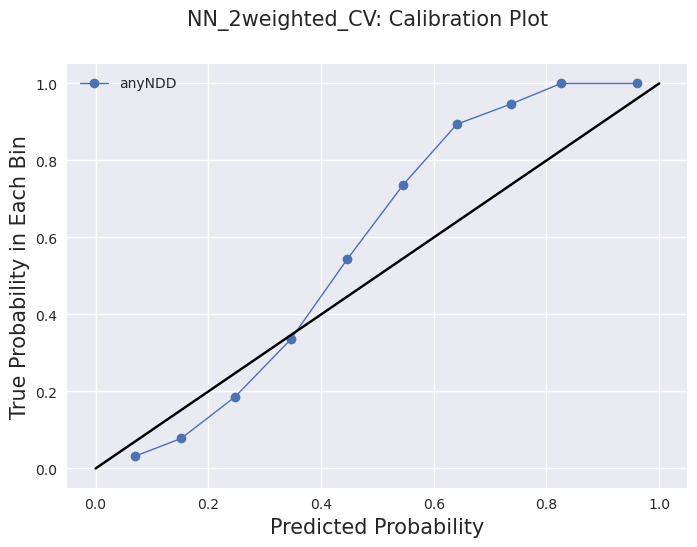

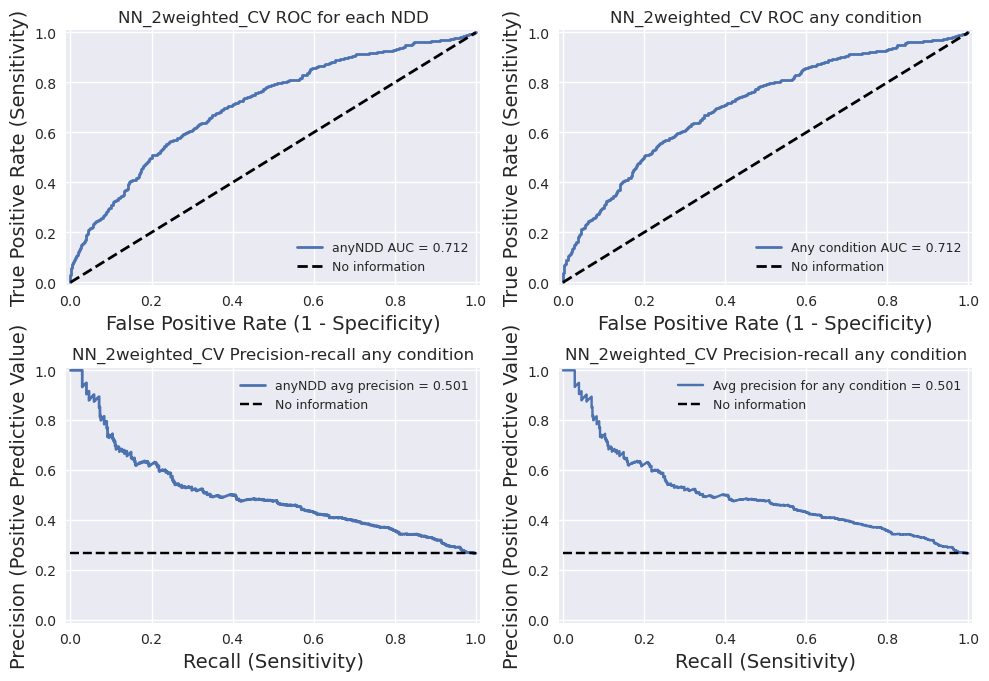

Dataset dimensions are (12960, 560) (12960, 5) (3240, 560) (3240, 5) (1800, 560) (1800, 5)


Training Epochs:   0%|          | 0/800 [00:00<?, ?it/s]

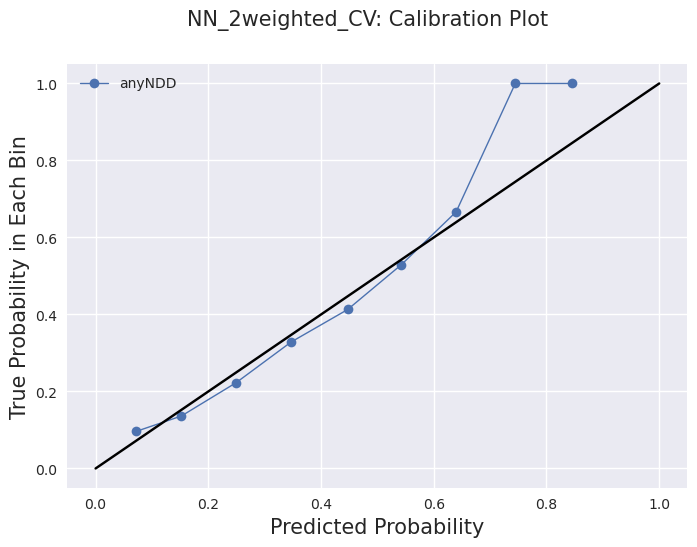

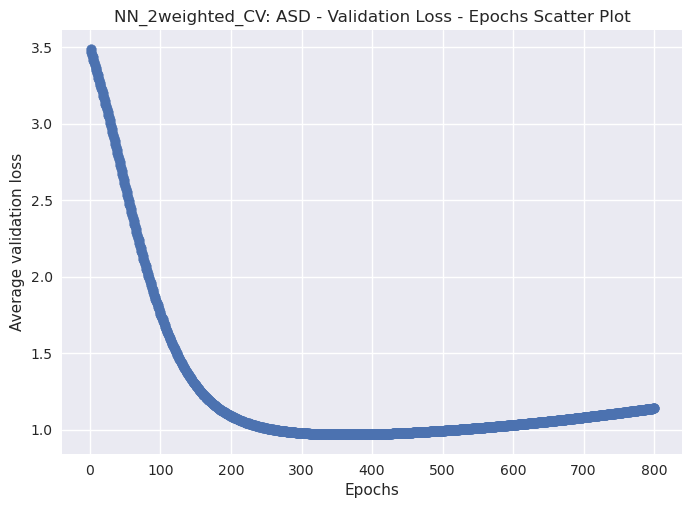

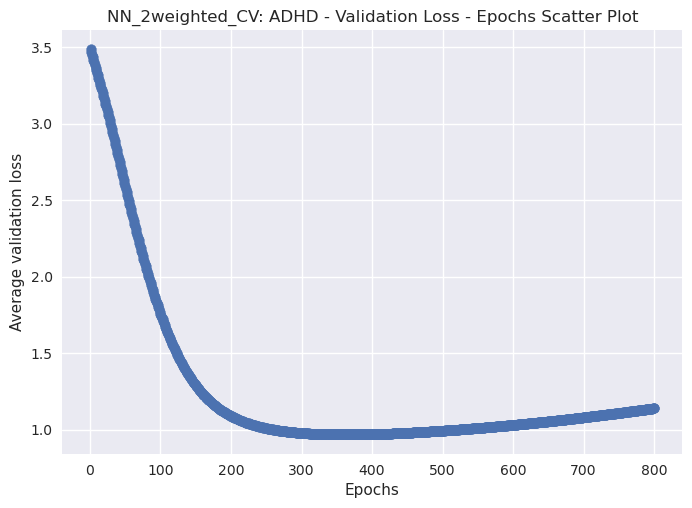

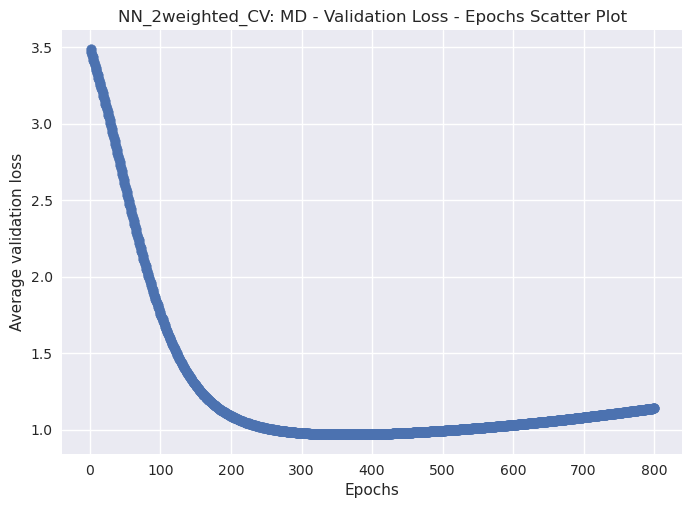

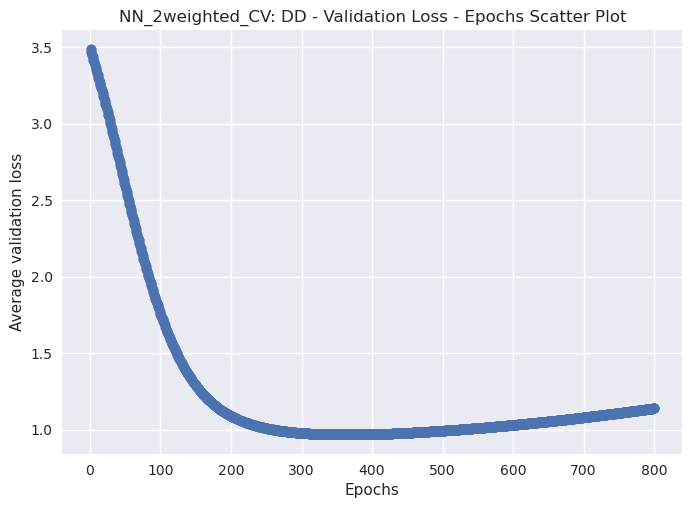

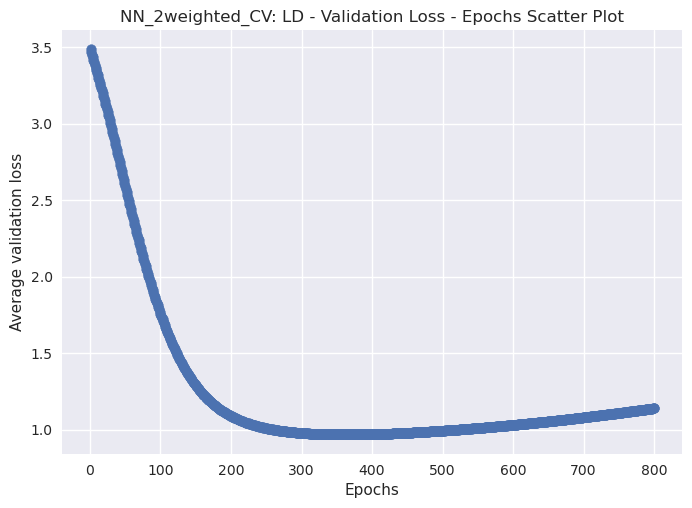

0.9678049683570862
['ASD', 'ADHD', 'MD', 'DD', 'LD']


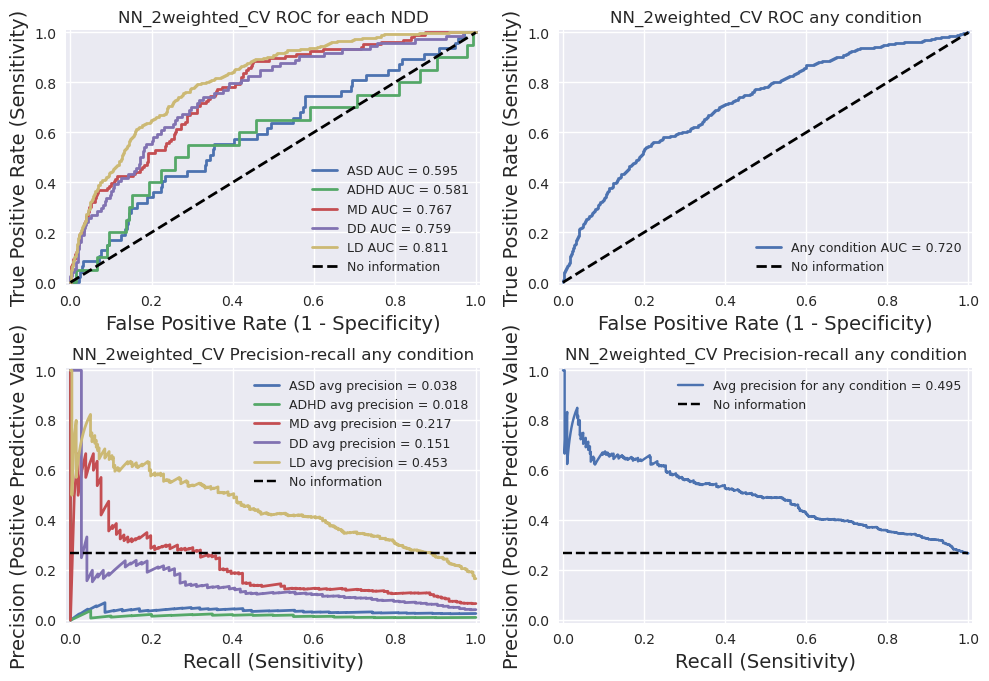

MTLnet(
  (flatten): Flatten(start_dim=1, end_dim=-1)
  (linear_sigmoid_stack): Sequential(
    (0): Linear(in_features=560, out_features=100, bias=True)
    (1): ReLU()
    (2): Linear(in_features=100, out_features=6, bias=True)
  )
)
Dataset dimensions are (12960, 560) (12960, 6) (3240, 560) (3240, 6) (1800, 560) (1800, 6)


Training Epochs:   0%|          | 0/400 [00:00<?, ?it/s]

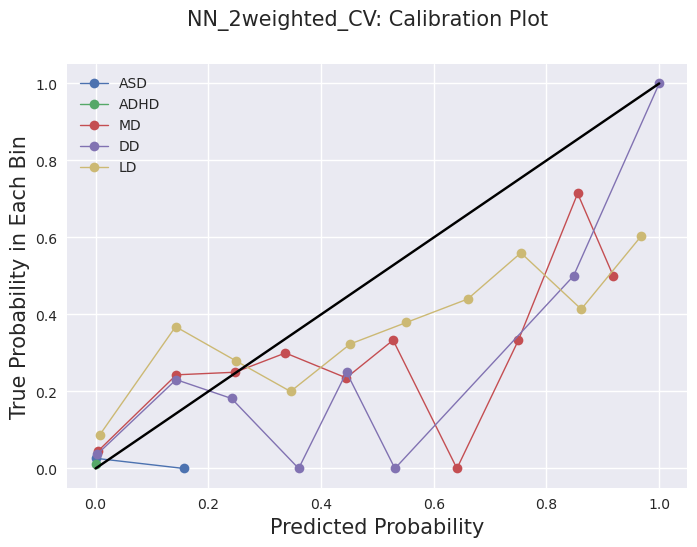

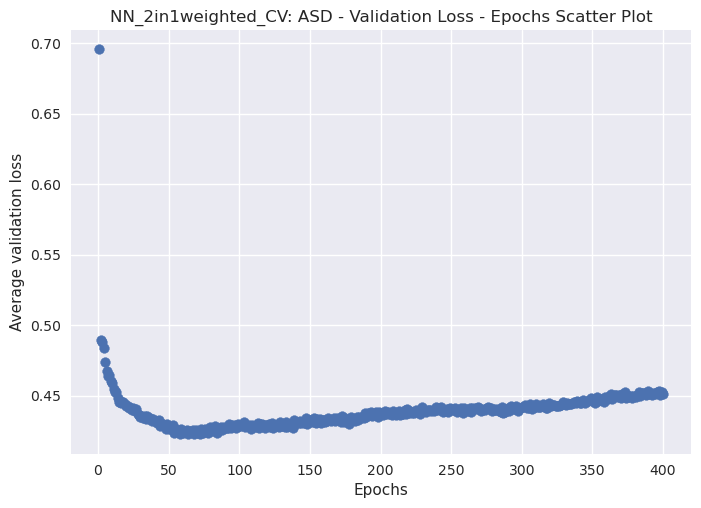

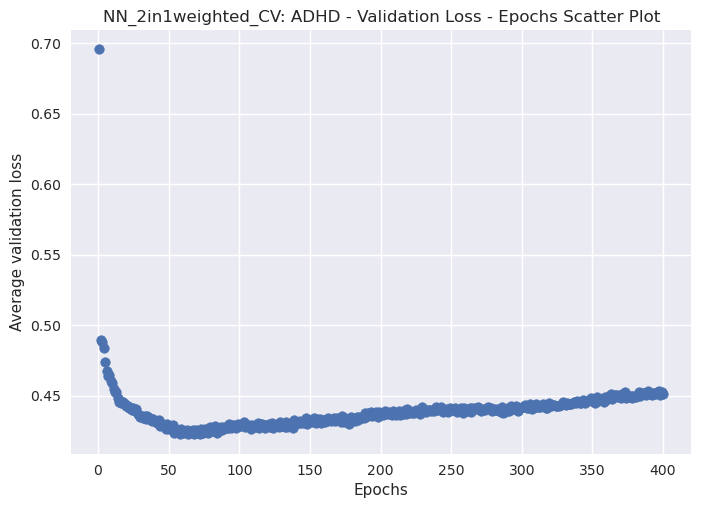

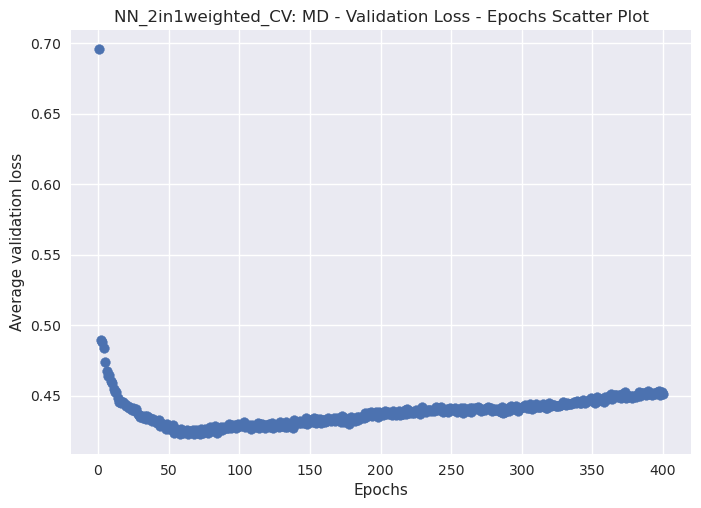

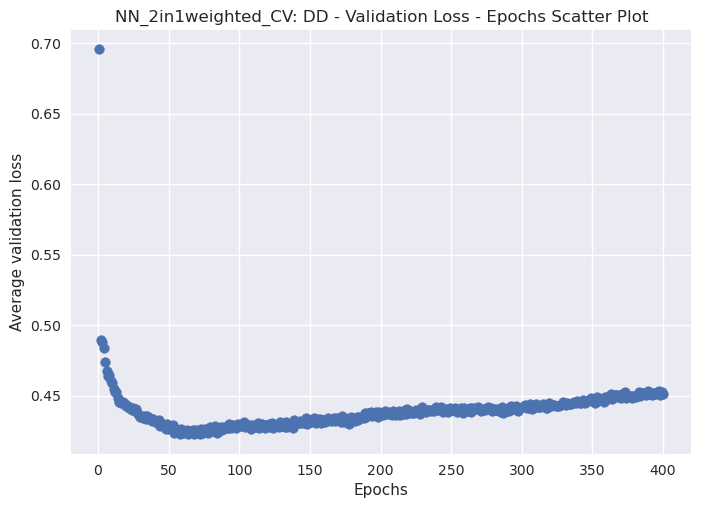

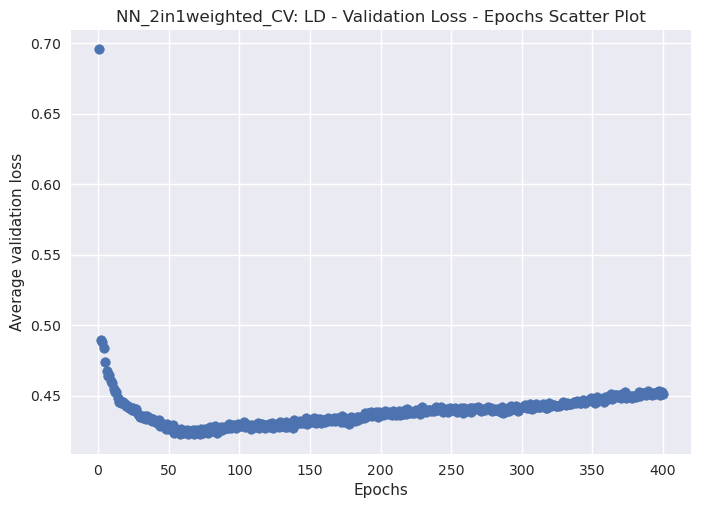

0.422519251704216
['ASD', 'ADHD', 'MD', 'DD', 'LD']


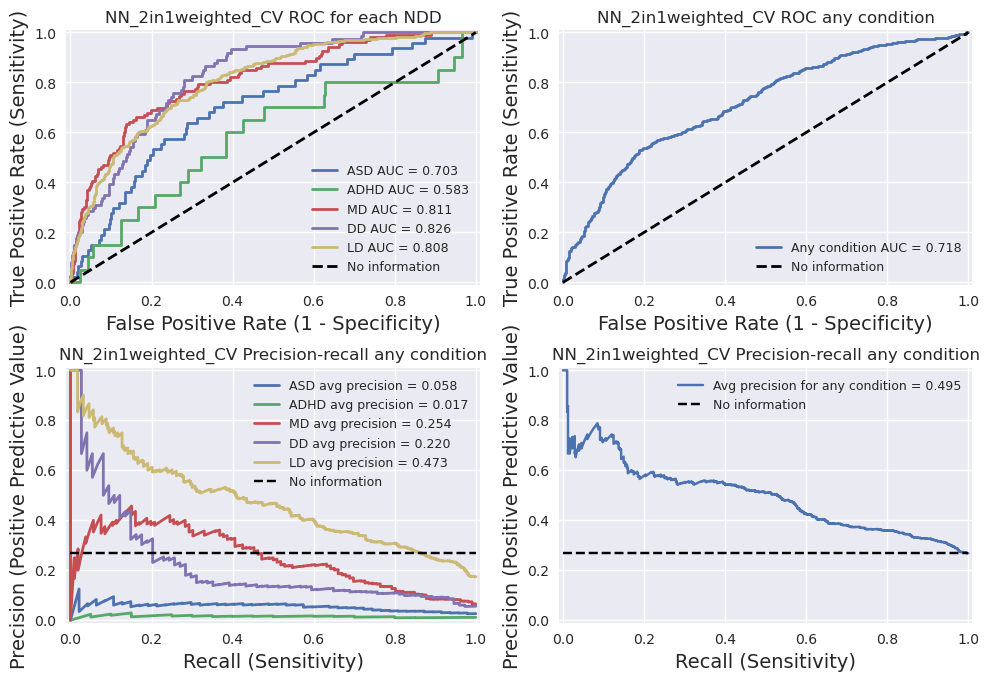

Dataset dimensions are (12960, 560) (12960, 1) (3240, 560) (3240, 1) (1800, 560) (1800, 1)


Training Epochs:   0%|          | 0/400 [00:00<?, ?it/s]

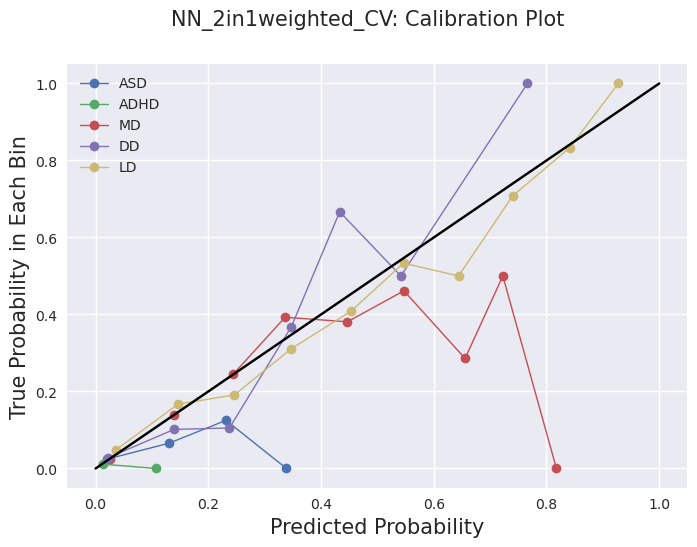

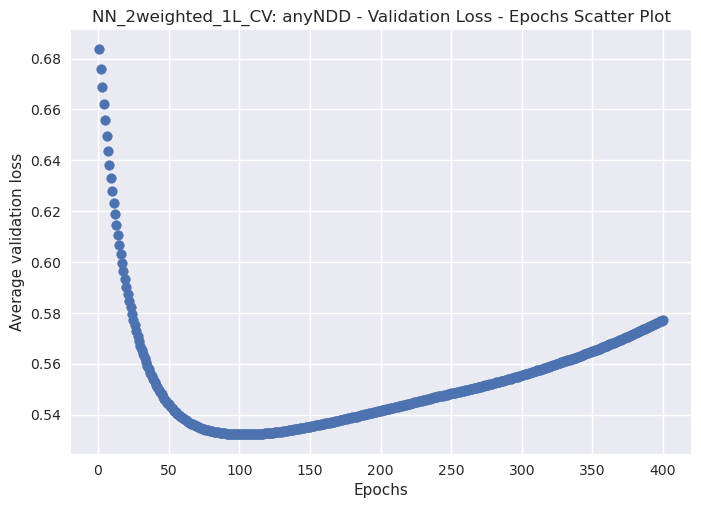

['anyNDD']


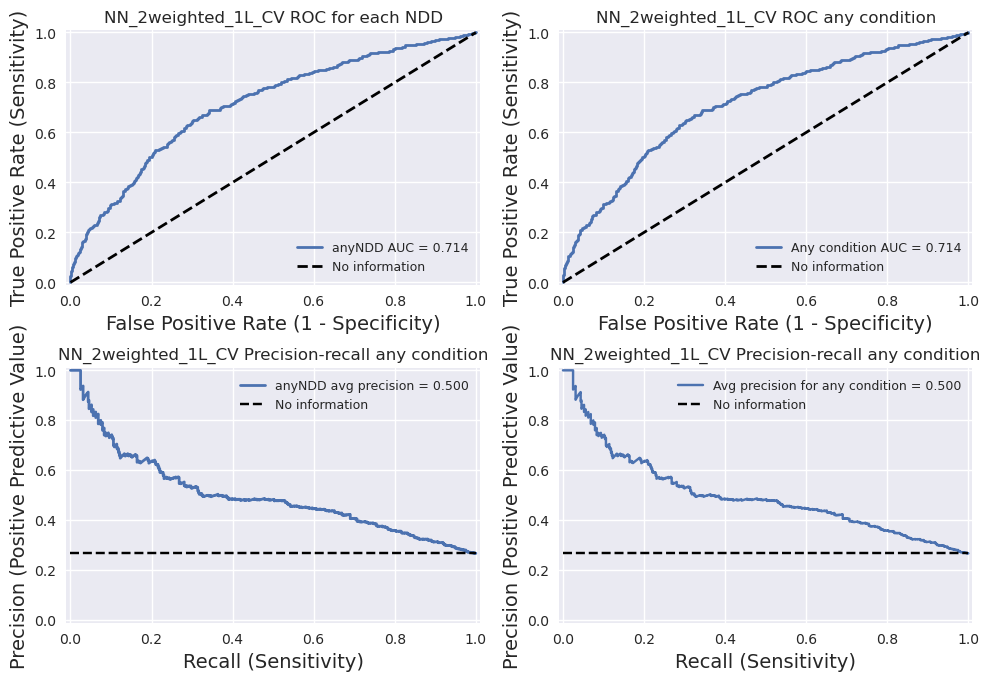

['anyNDD']


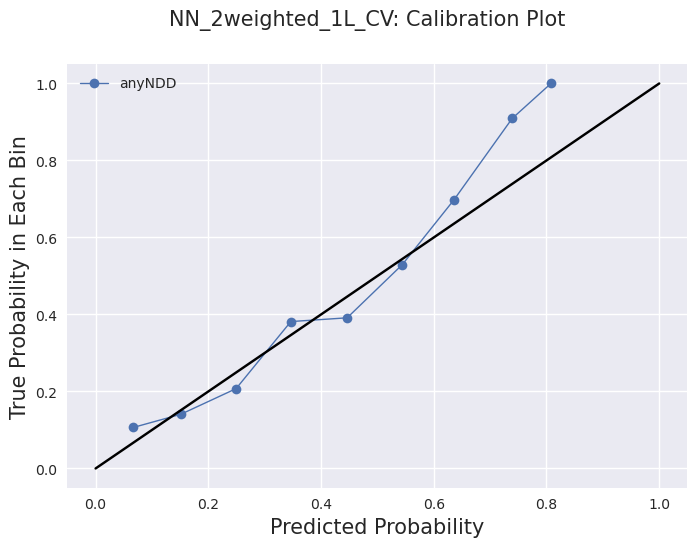

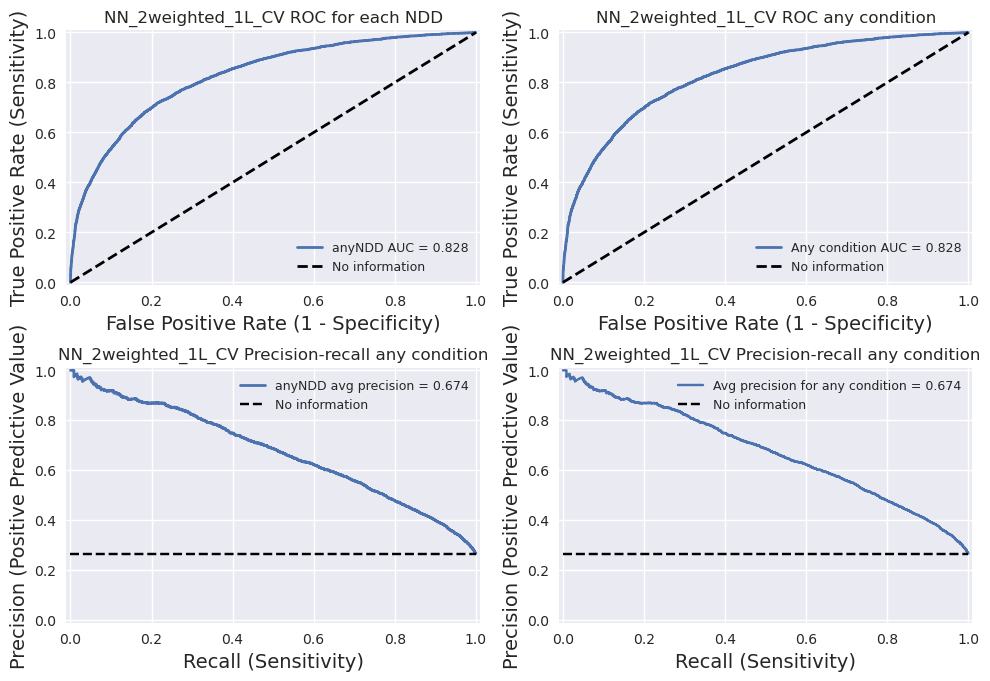

['anyNDD']


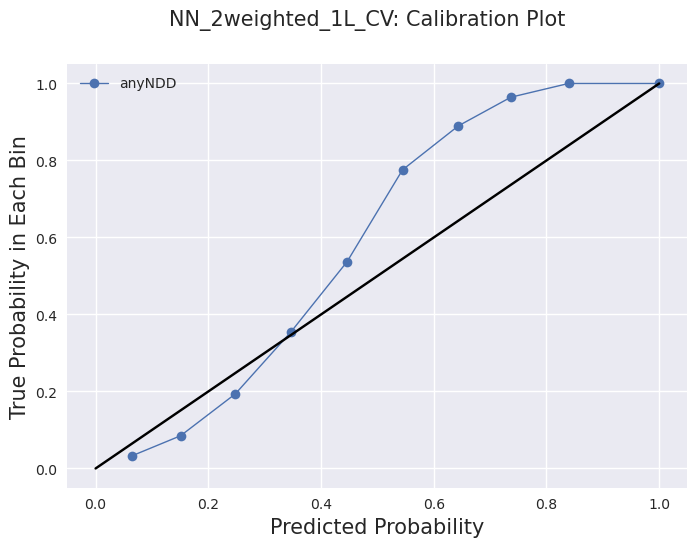

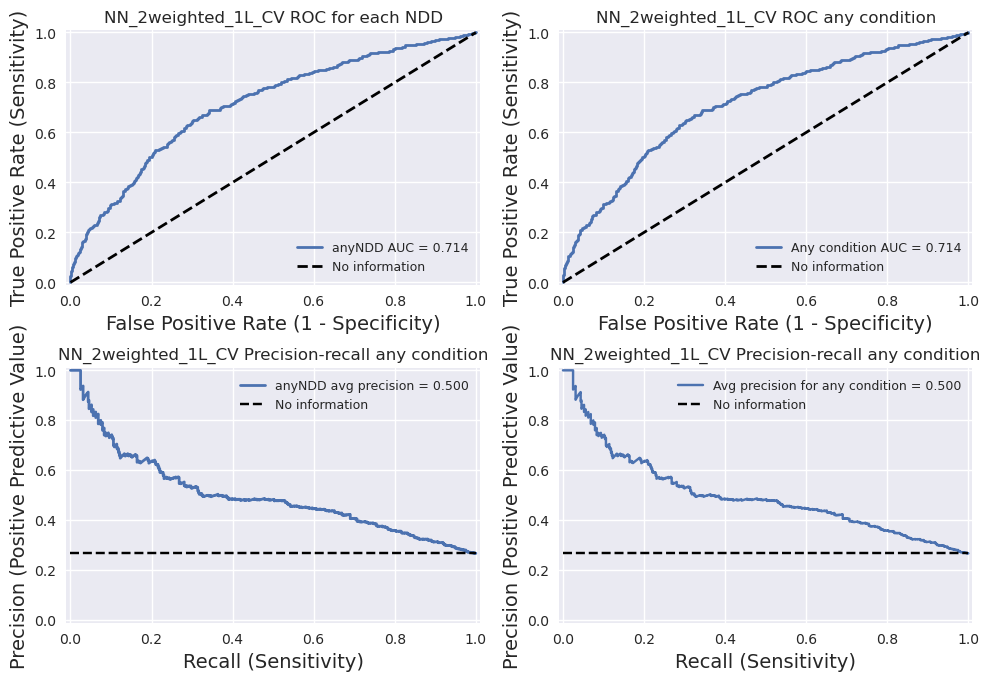

Dataset dimensions are (12960, 560) (12960, 1) (3240, 560) (3240, 1) (1800, 560) (1800, 1)


Training Epochs:   0%|          | 0/400 [00:00<?, ?it/s]

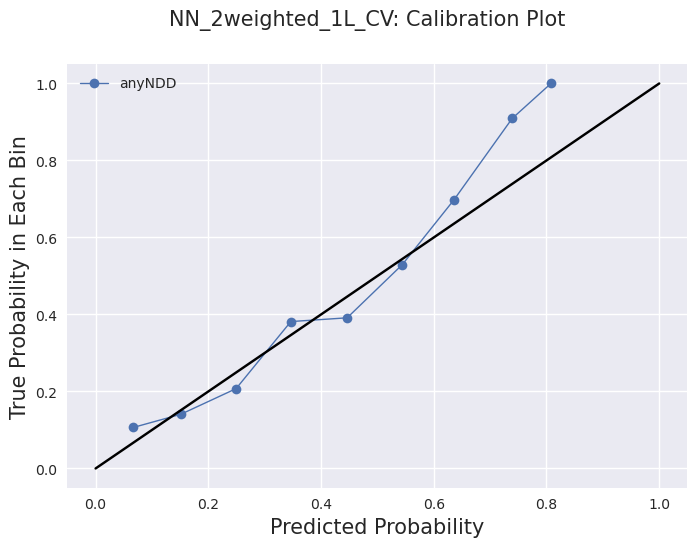

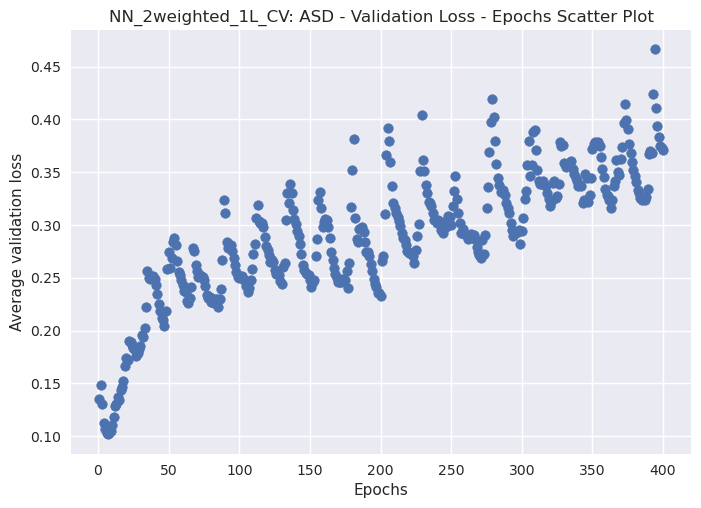

0.10170414298772812
['ASD']


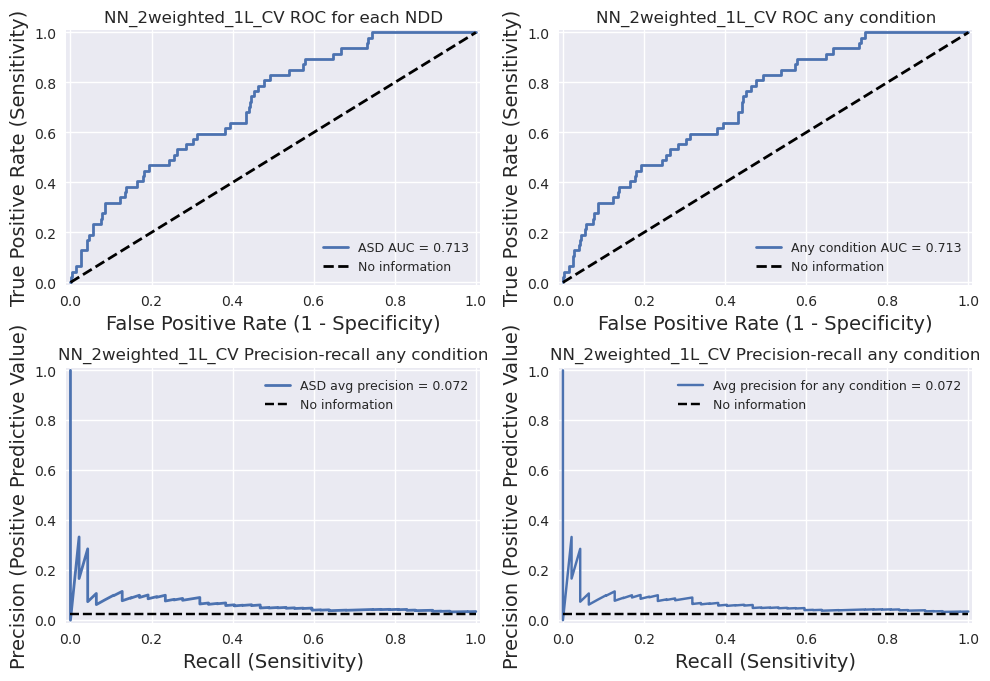

MTLnet(
  (flatten): Flatten(start_dim=1, end_dim=-1)
  (linear_sigmoid_stack): Sequential(
    (0): Linear(in_features=560, out_features=100, bias=True)
    (1): ReLU()
    (2): Linear(in_features=100, out_features=2, bias=True)
  )
)
Dataset dimensions are (12960, 560) (12960, 2) (3240, 560) (3240, 2) (1800, 560) (1800, 2)


Training Epochs:   0%|          | 0/400 [00:00<?, ?it/s]

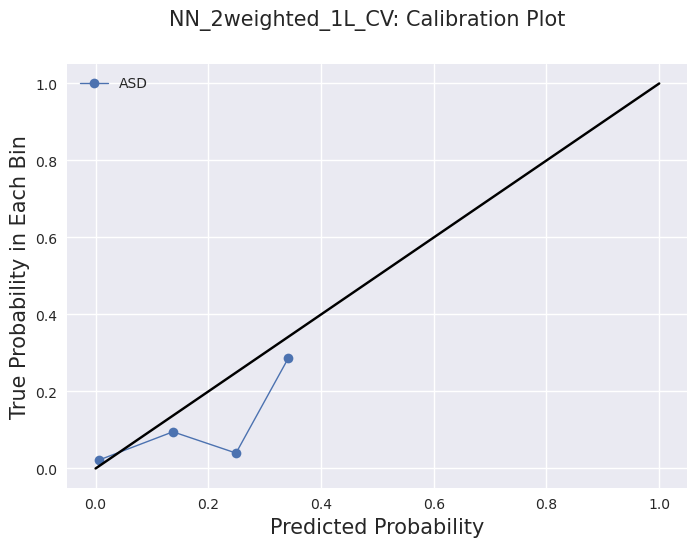

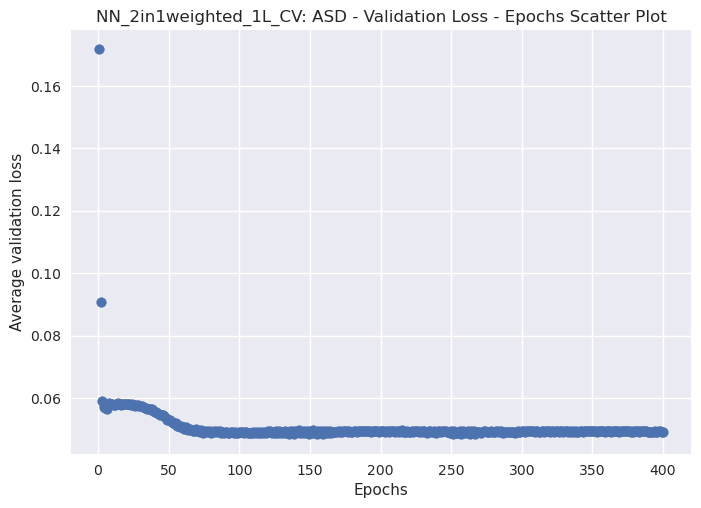

0.04842488095164299
['ASD']


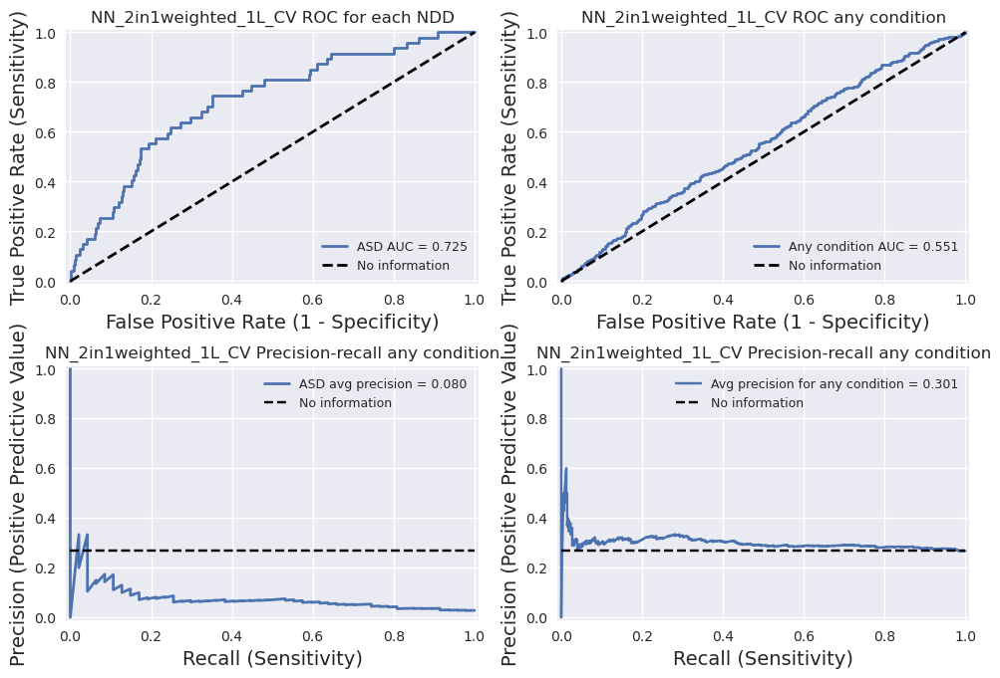

Fold 5/10
Dataset dimensions are (12960, 560) (12960, 1) (3240, 560) (3240, 1) (1800, 560) (1800, 1)



A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


Training Epochs:   0%|          | 0/200 [00:00<?, ?it/s]

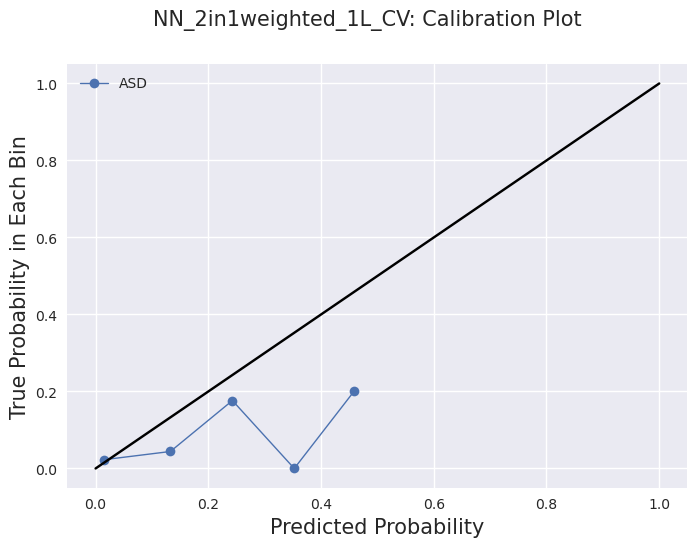

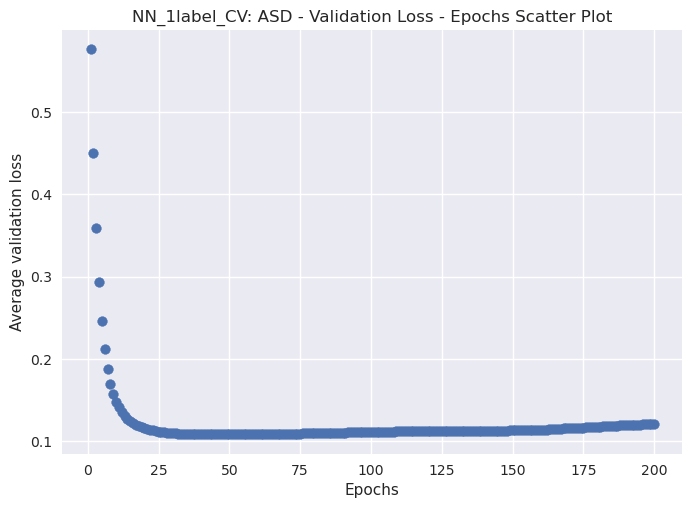

0.10846986994147301
['ASD']


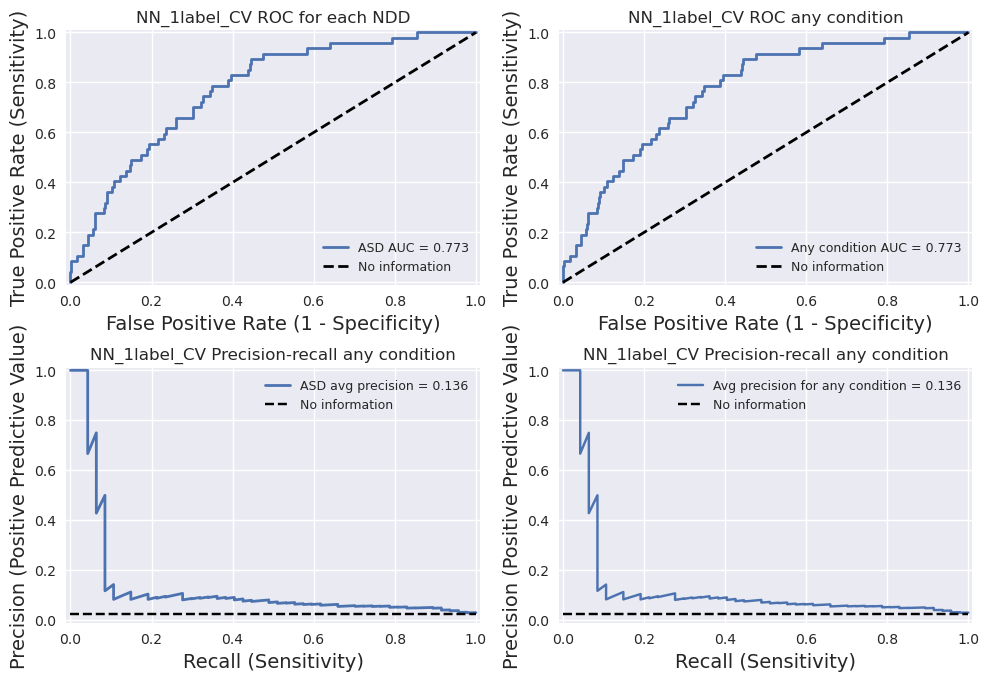

Dataset dimensions are (12960, 560) (12960, 5) (3240, 560) (3240, 5) (1800, 560) (1800, 5)


Training Epochs:   0%|          | 0/400 [00:00<?, ?it/s]

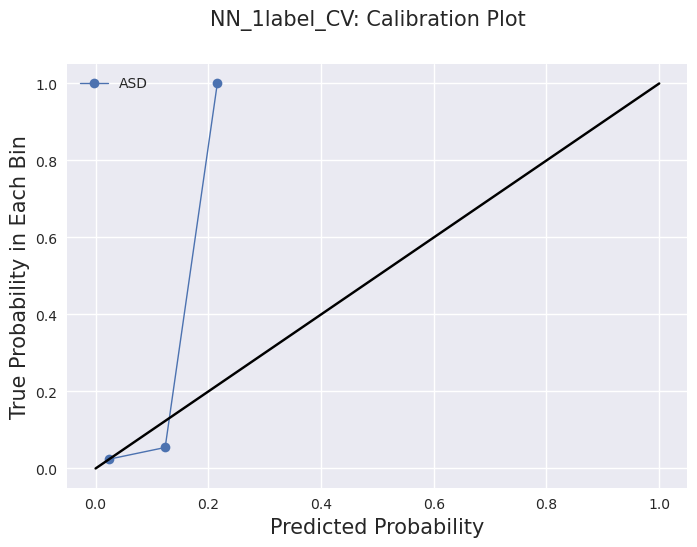

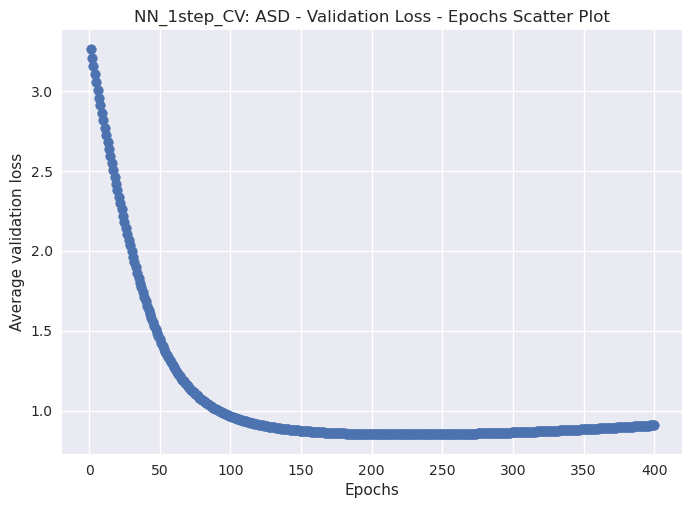

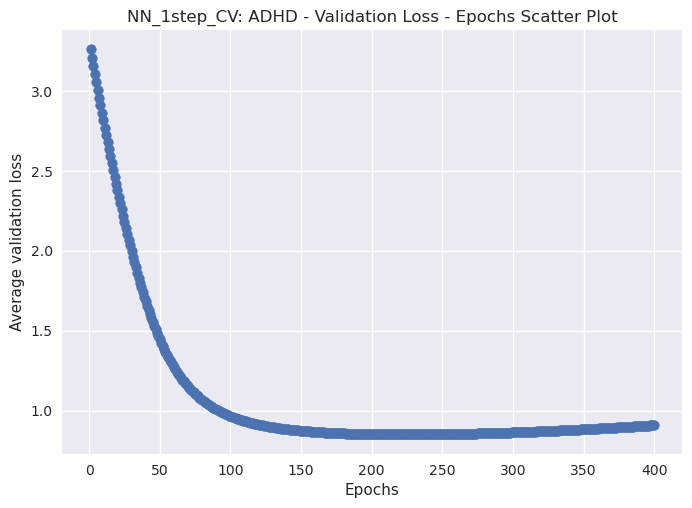

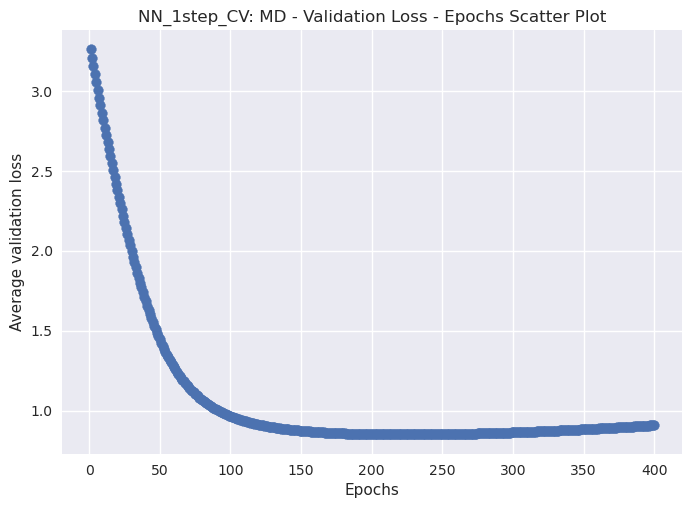

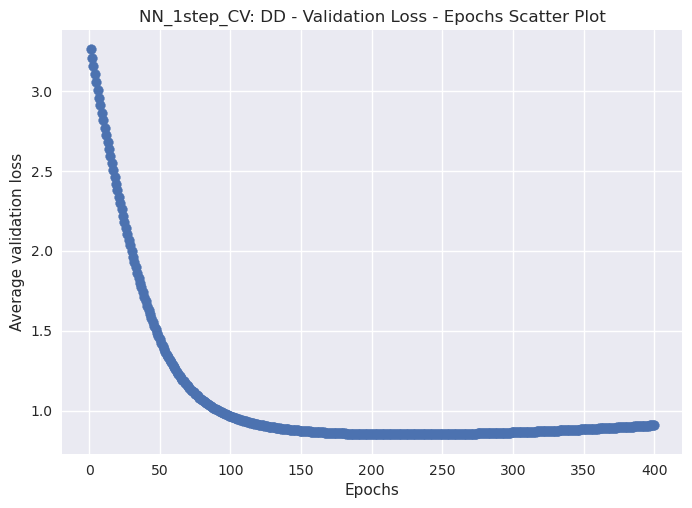

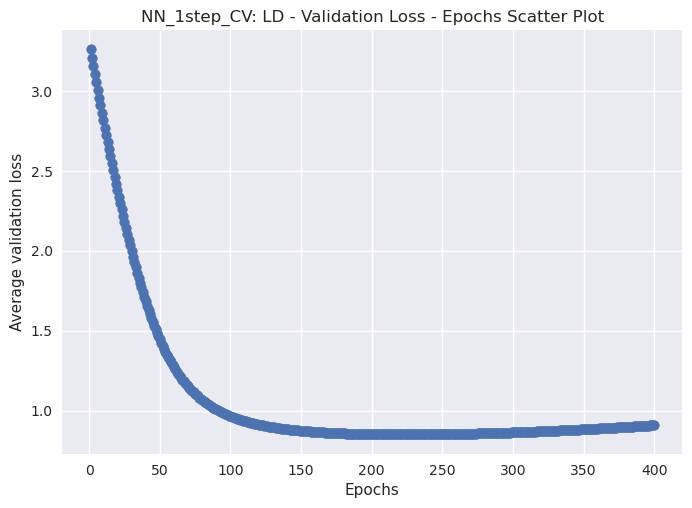

0.8508922755718231
['ASD', 'ADHD', 'MD', 'DD', 'LD']


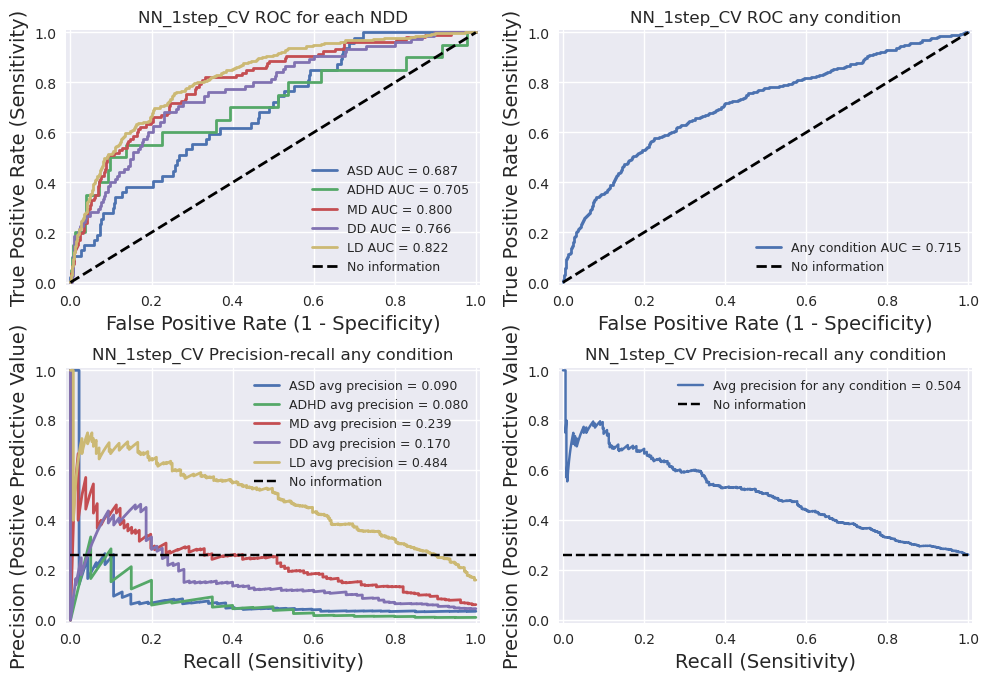

MTLnet(
  (flatten): Flatten(start_dim=1, end_dim=-1)
  (linear_sigmoid_stack): Sequential(
    (0): Linear(in_features=560, out_features=100, bias=True)
    (1): ReLU()
    (2): Linear(in_features=100, out_features=1, bias=True)
  )
)
MTLnet(
  (flatten): Flatten(start_dim=1, end_dim=-1)
  (linear_sigmoid_stack): Sequential(
    (0): Linear(in_features=560, out_features=100, bias=True)
    (1): ReLU()
    (2): Linear(in_features=100, out_features=5, bias=True)
  )
)
Dataset dimensions are (12960, 560) (12960, 1) (3240, 560) (3240, 1) (1800, 560) (1800, 1)


Training Epochs:   0%|          | 0/400 [00:00<?, ?it/s]

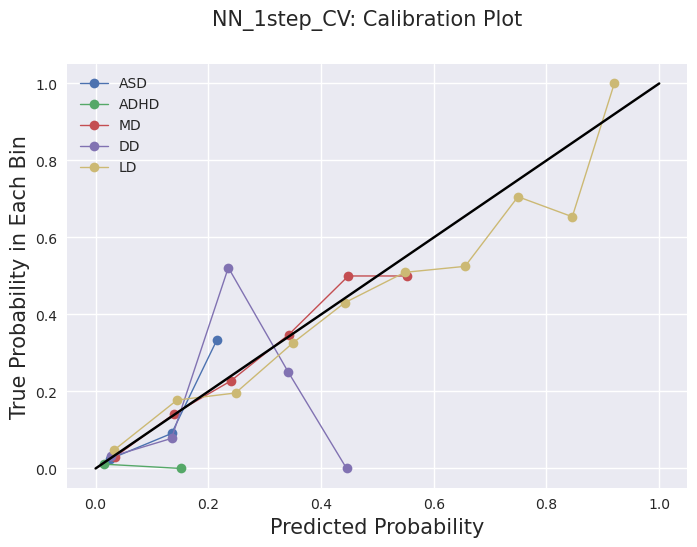

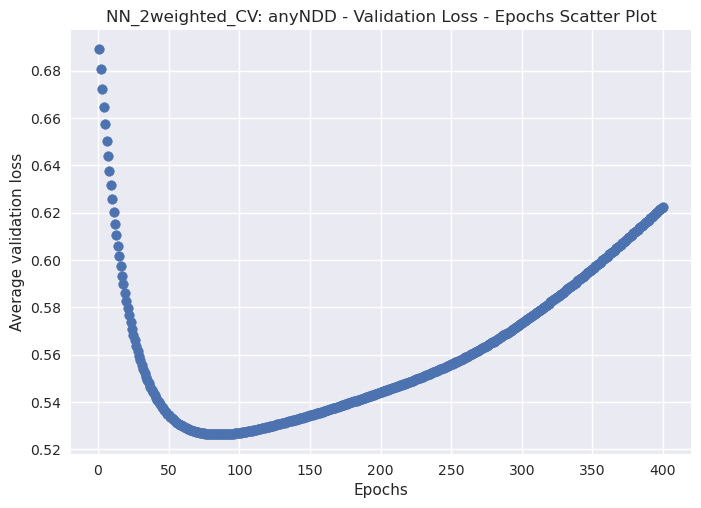

['anyNDD']


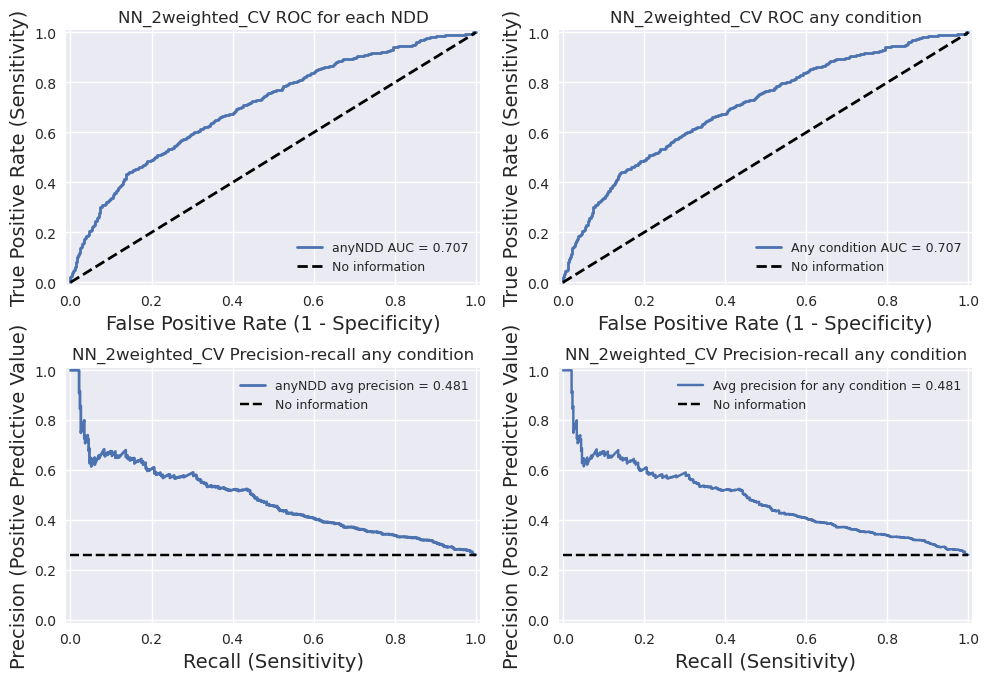

['anyNDD']


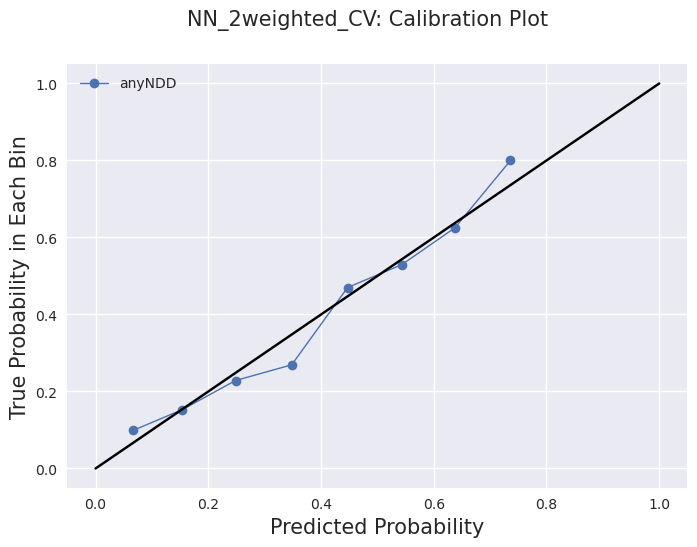

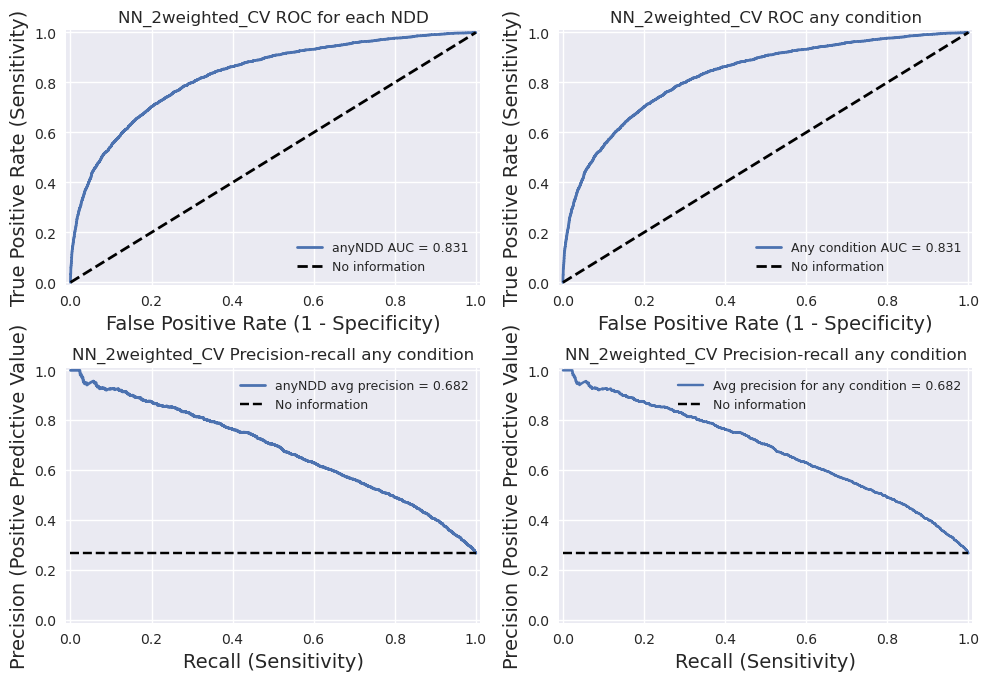

['anyNDD']


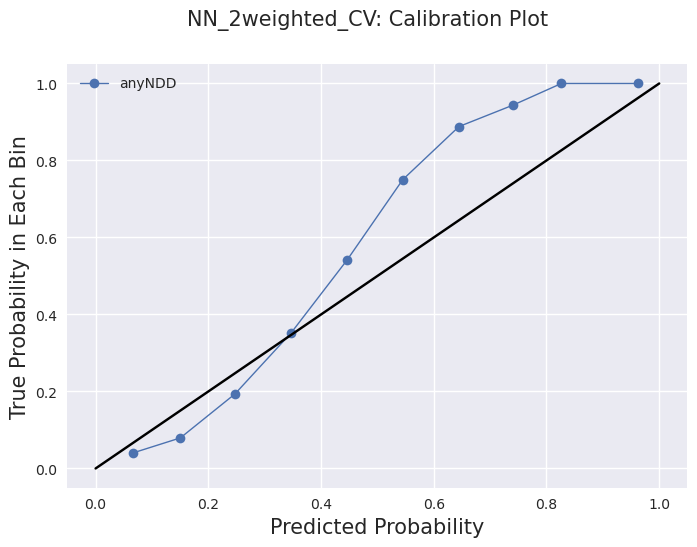

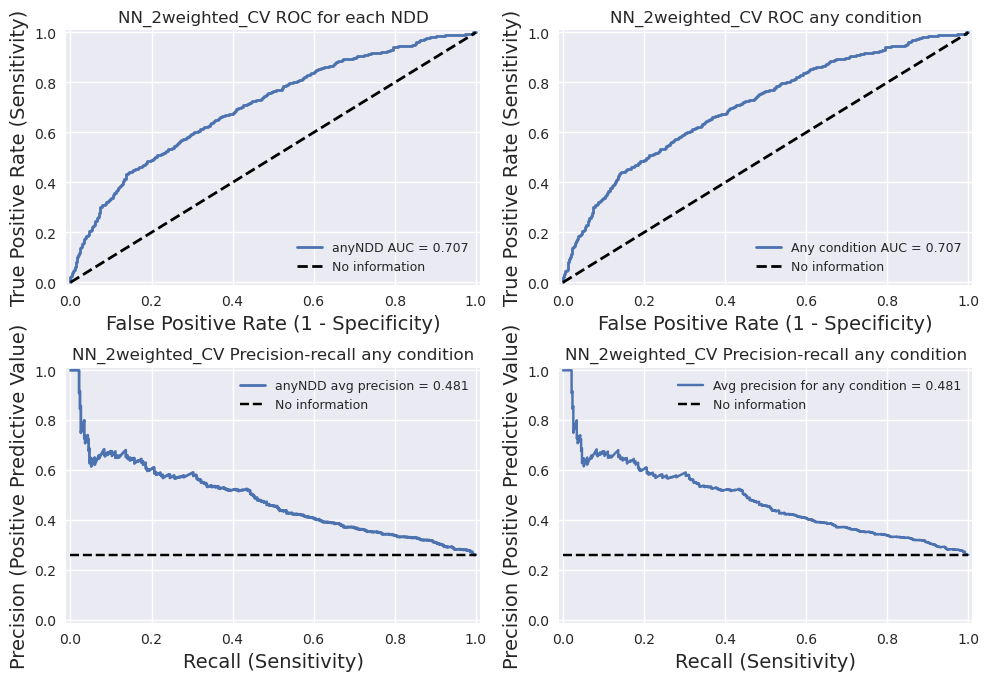

Dataset dimensions are (12960, 560) (12960, 5) (3240, 560) (3240, 5) (1800, 560) (1800, 5)


Training Epochs:   0%|          | 0/800 [00:00<?, ?it/s]

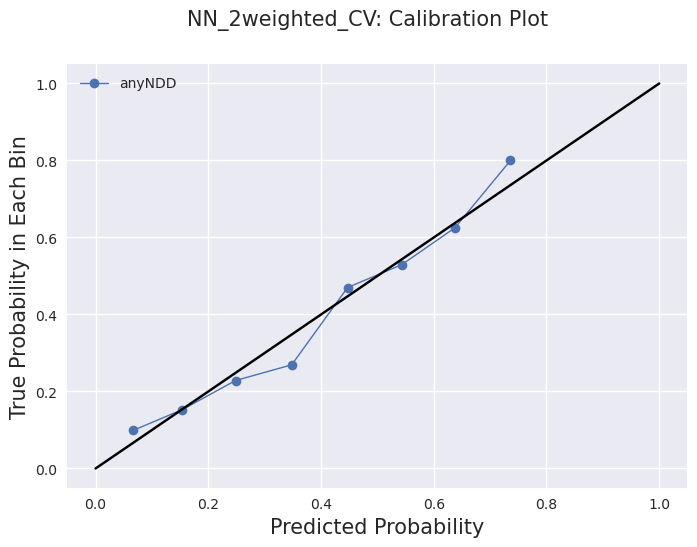

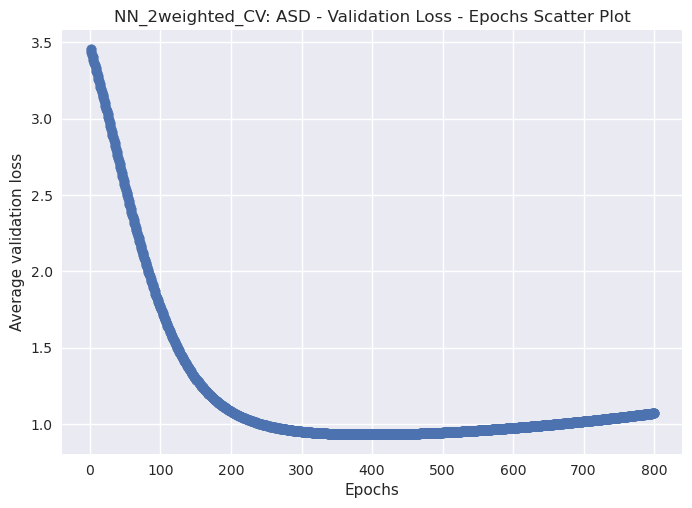

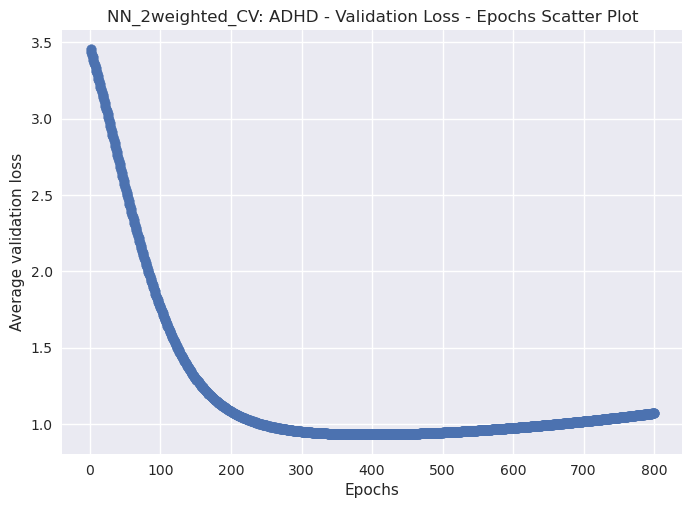

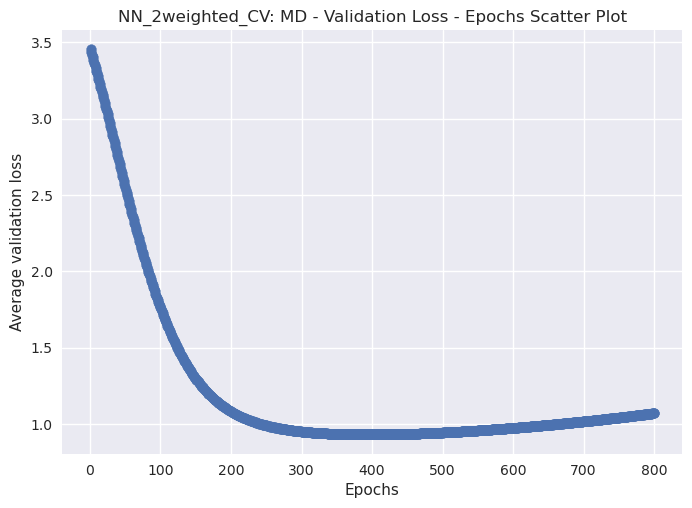

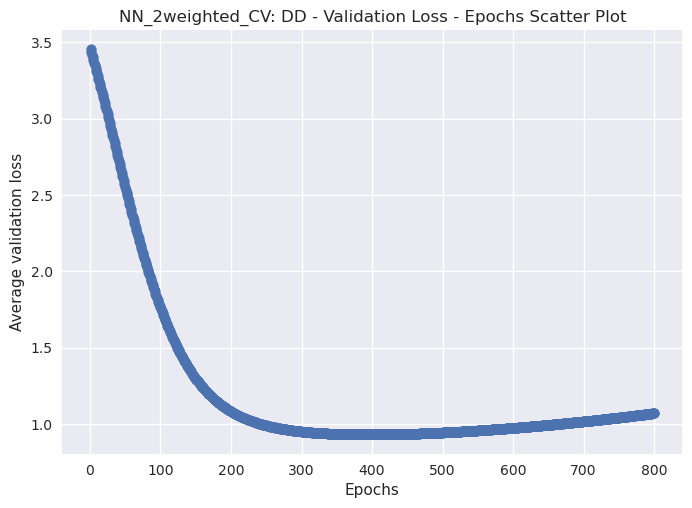

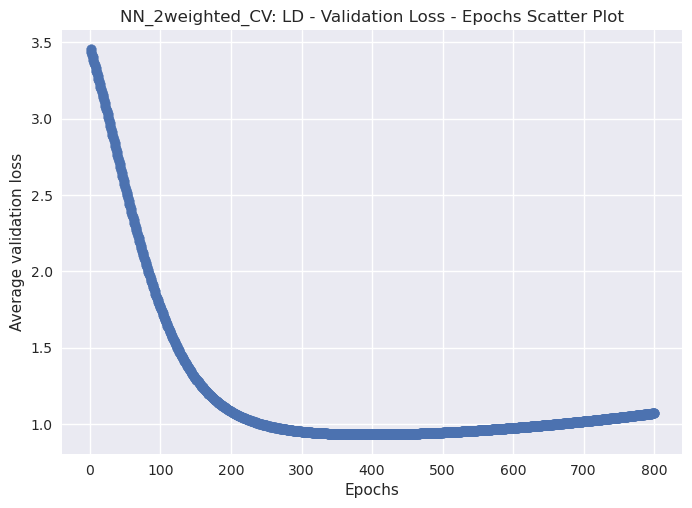

0.9324731528759003
['ASD', 'ADHD', 'MD', 'DD', 'LD']


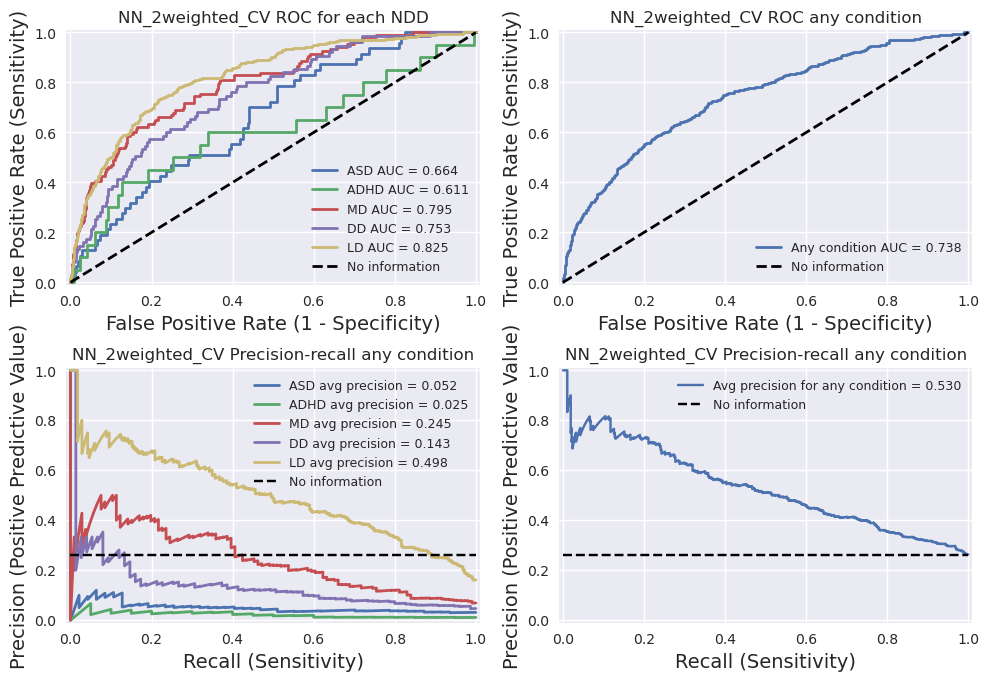

MTLnet(
  (flatten): Flatten(start_dim=1, end_dim=-1)
  (linear_sigmoid_stack): Sequential(
    (0): Linear(in_features=560, out_features=100, bias=True)
    (1): ReLU()
    (2): Linear(in_features=100, out_features=6, bias=True)
  )
)
Dataset dimensions are (12960, 560) (12960, 6) (3240, 560) (3240, 6) (1800, 560) (1800, 6)


Training Epochs:   0%|          | 0/400 [00:00<?, ?it/s]

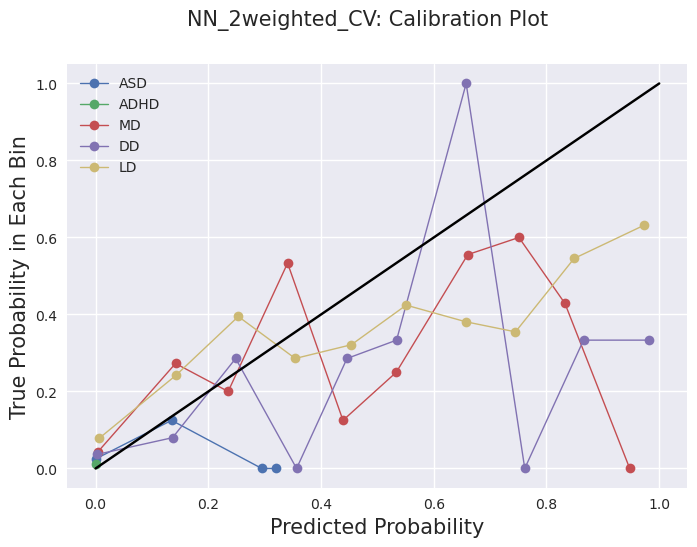

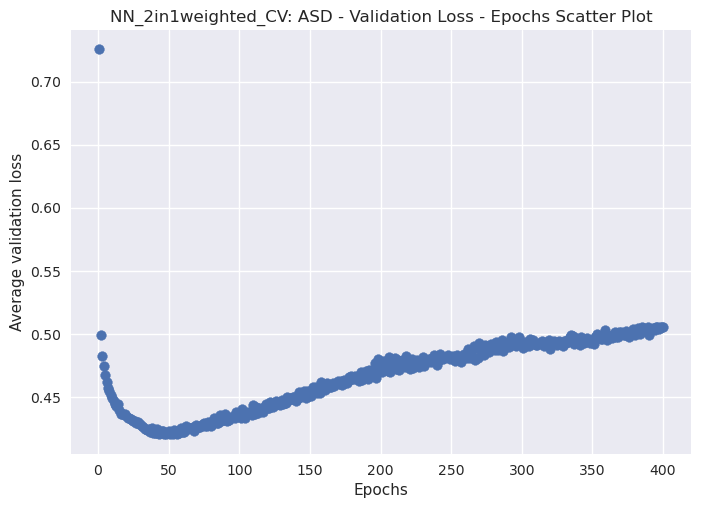

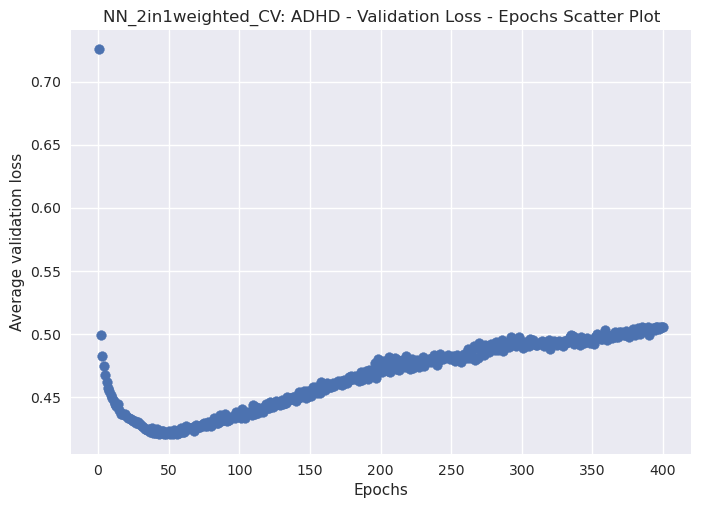

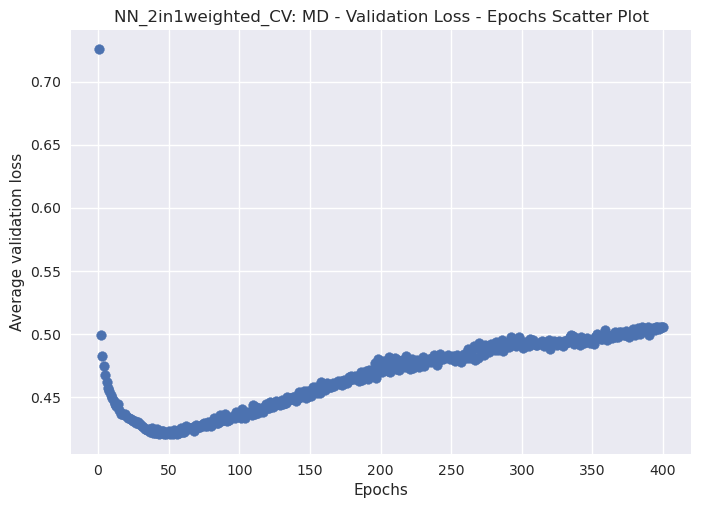

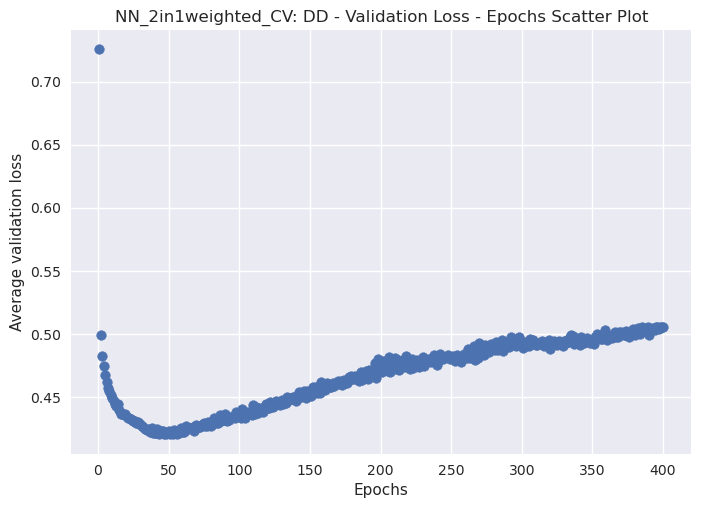

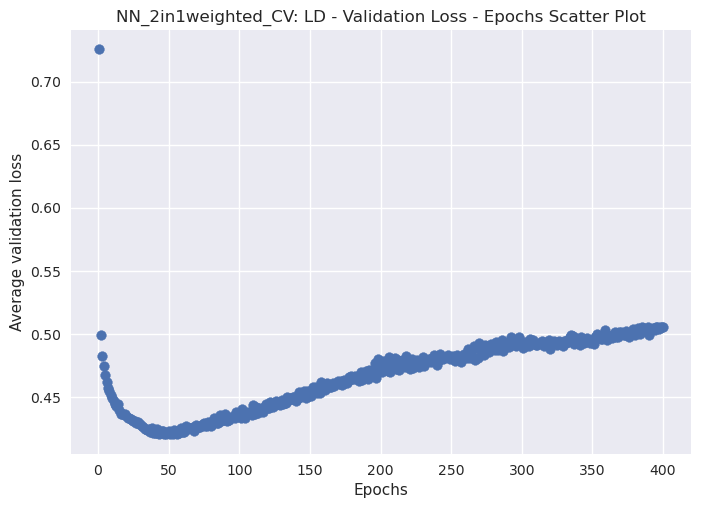

0.4204804301261902
['ASD', 'ADHD', 'MD', 'DD', 'LD']


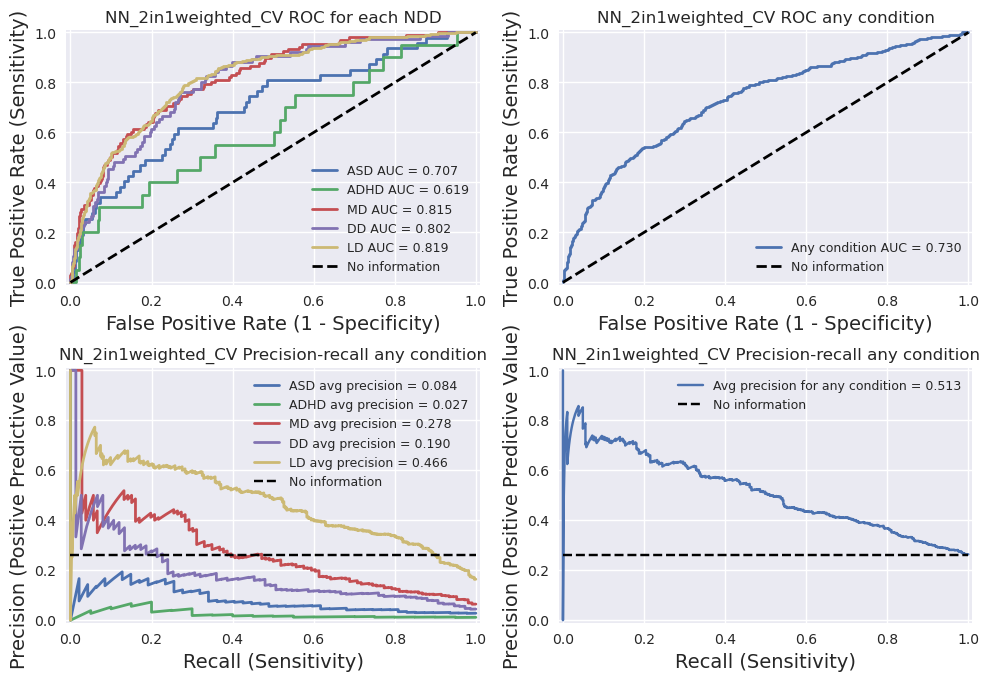

Dataset dimensions are (12960, 560) (12960, 1) (3240, 560) (3240, 1) (1800, 560) (1800, 1)


Training Epochs:   0%|          | 0/400 [00:00<?, ?it/s]

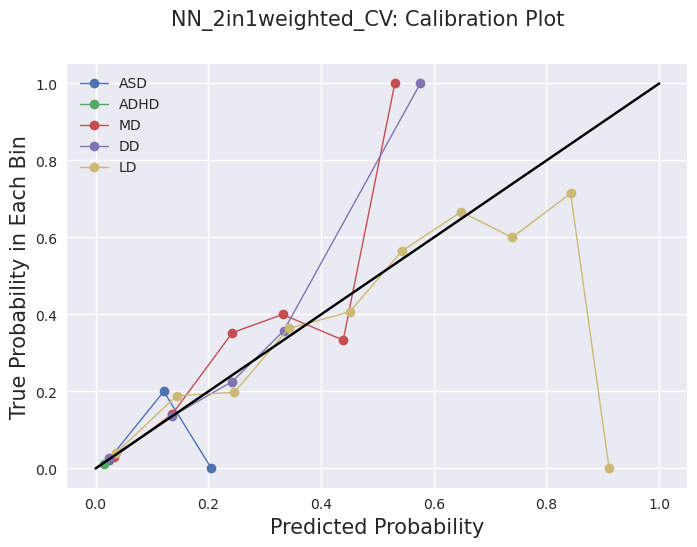

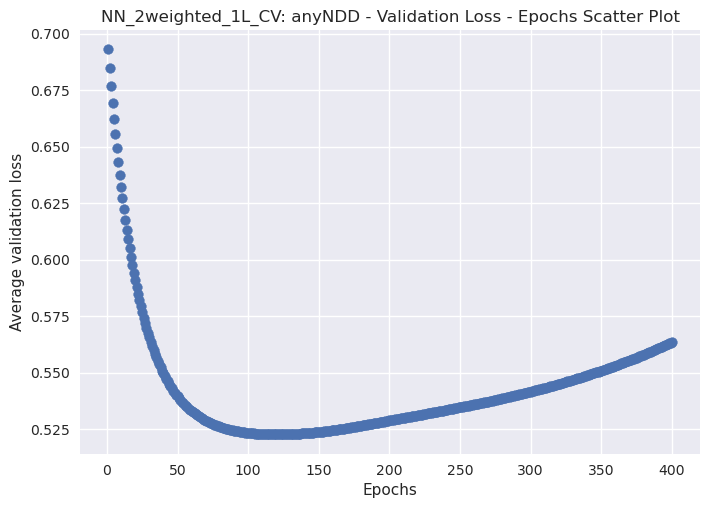

['anyNDD']


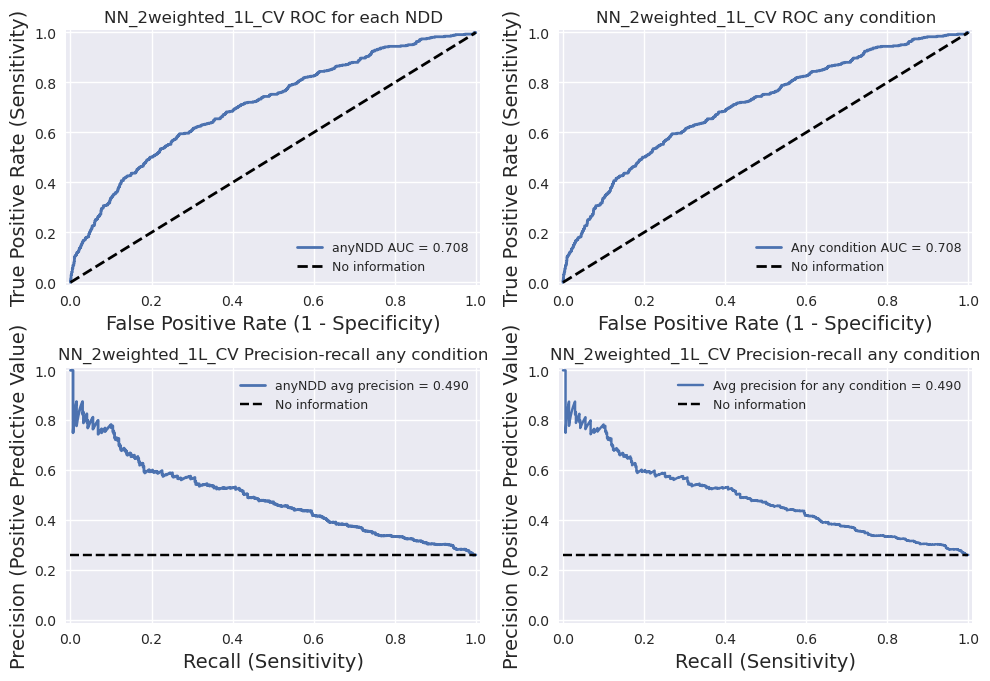

['anyNDD']


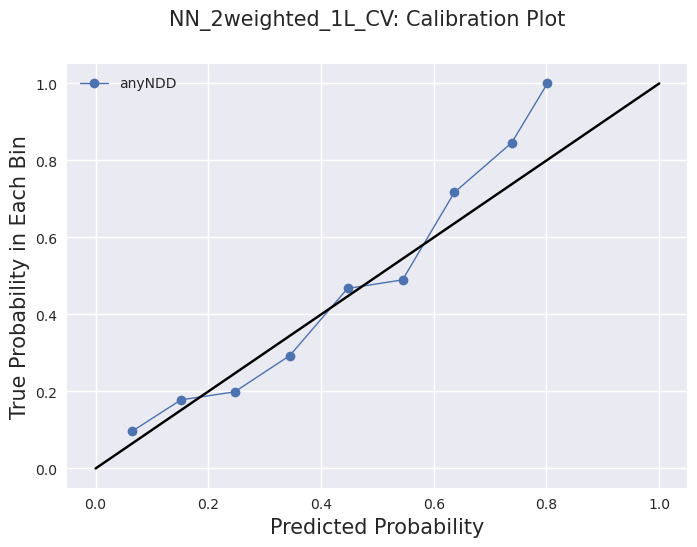

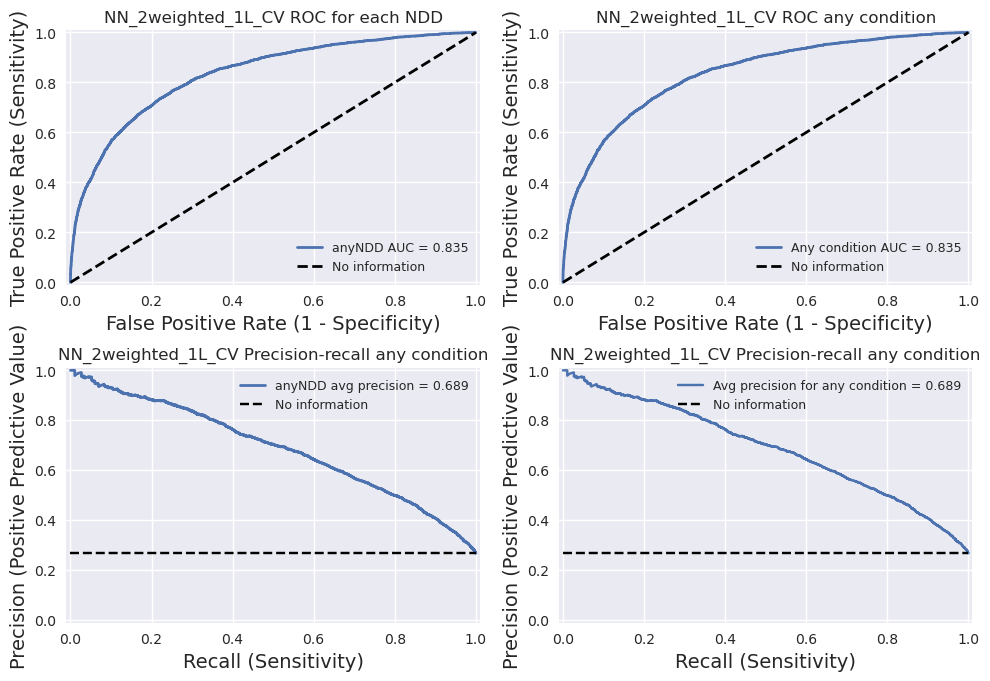

['anyNDD']


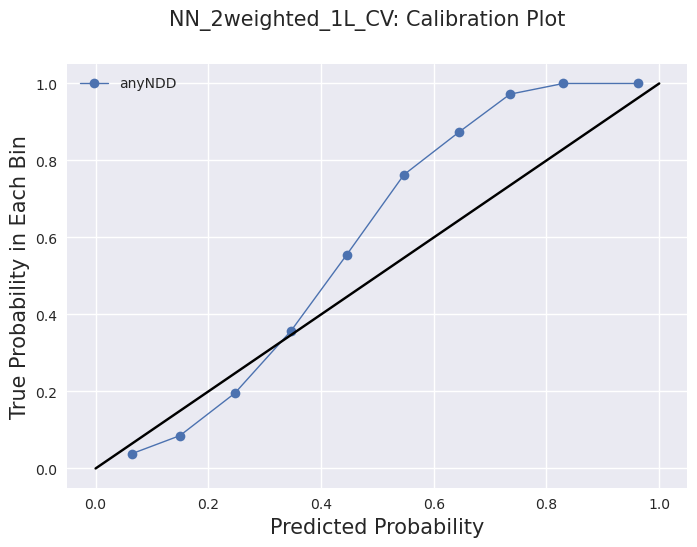

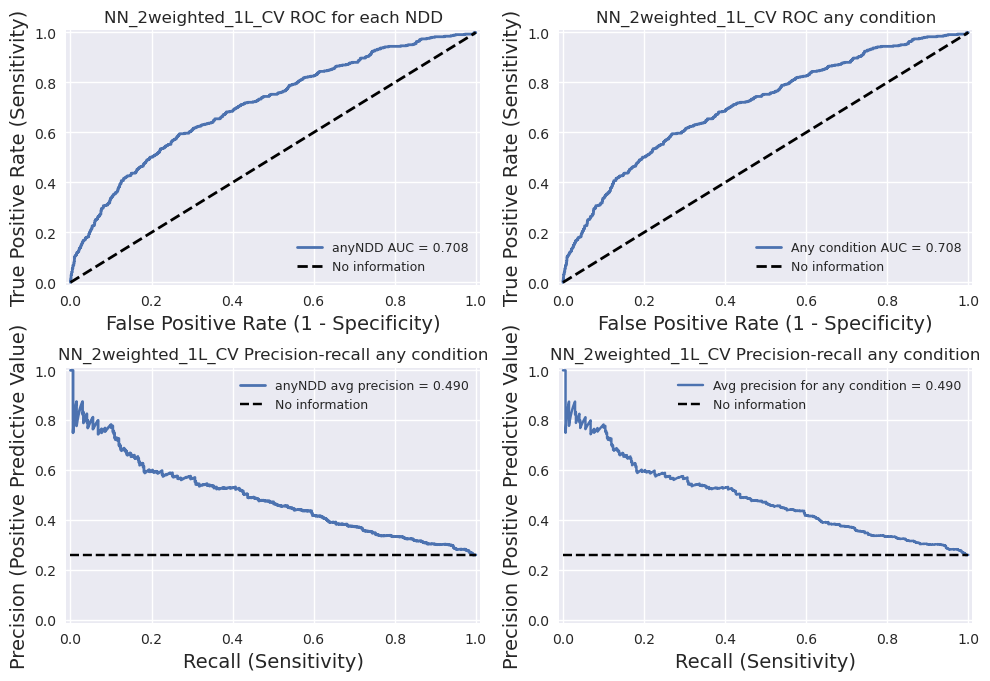

Dataset dimensions are (12960, 560) (12960, 1) (3240, 560) (3240, 1) (1800, 560) (1800, 1)


Training Epochs:   0%|          | 0/400 [00:00<?, ?it/s]

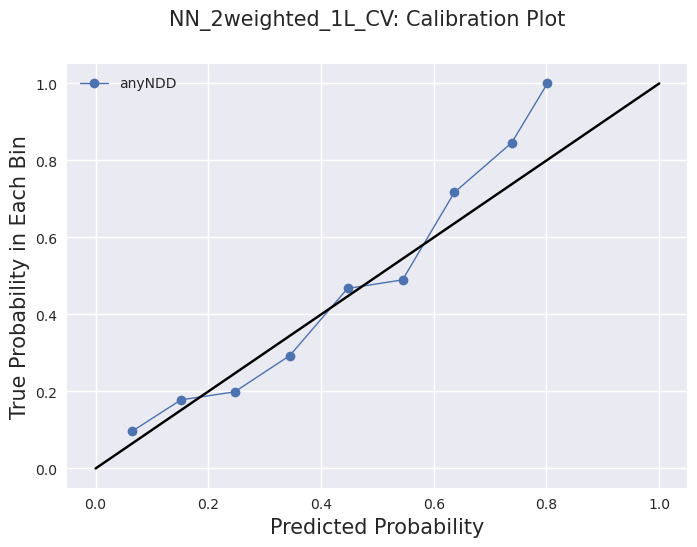

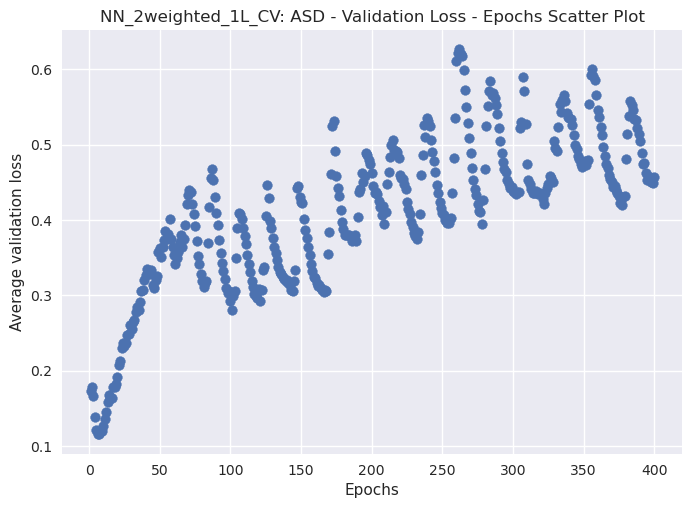

0.1155083067715168
['ASD']


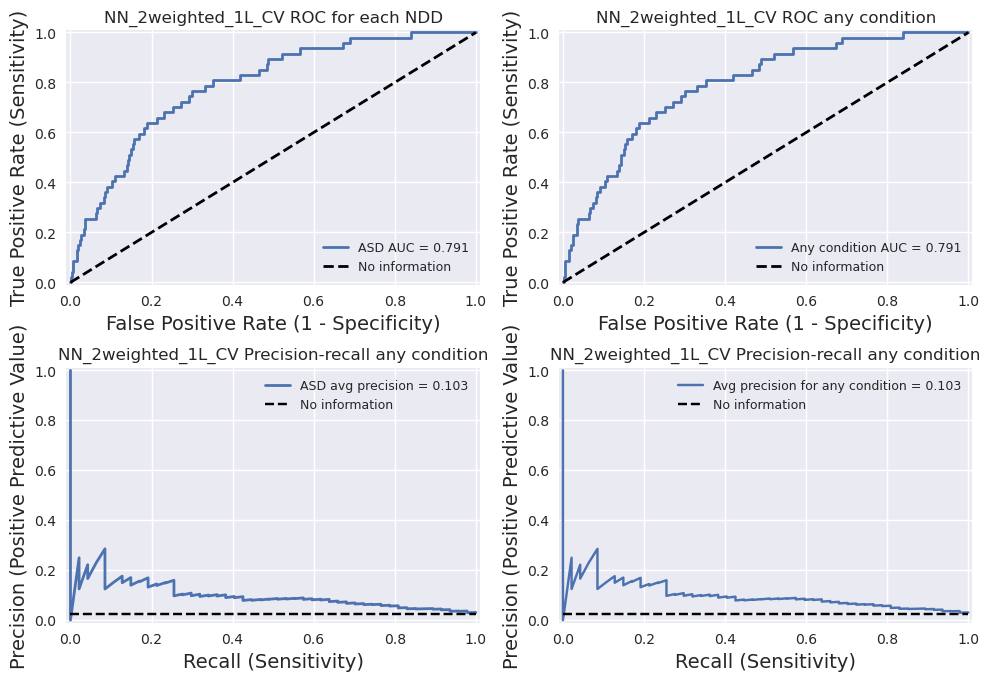

MTLnet(
  (flatten): Flatten(start_dim=1, end_dim=-1)
  (linear_sigmoid_stack): Sequential(
    (0): Linear(in_features=560, out_features=100, bias=True)
    (1): ReLU()
    (2): Linear(in_features=100, out_features=2, bias=True)
  )
)
Dataset dimensions are (12960, 560) (12960, 2) (3240, 560) (3240, 2) (1800, 560) (1800, 2)


Training Epochs:   0%|          | 0/400 [00:00<?, ?it/s]

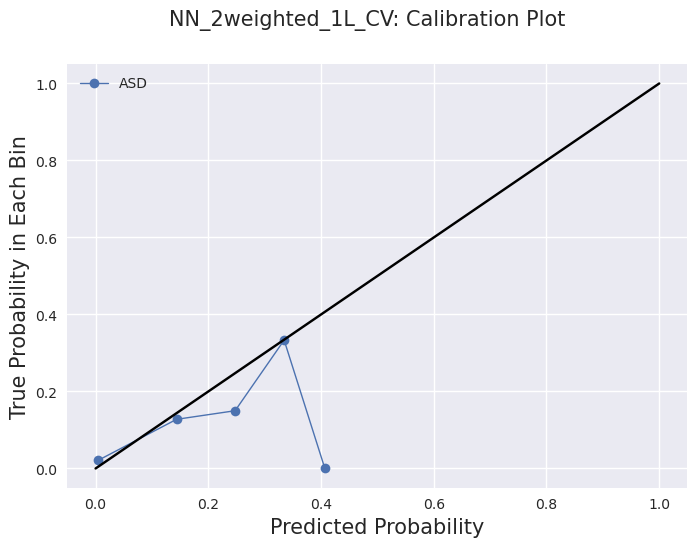

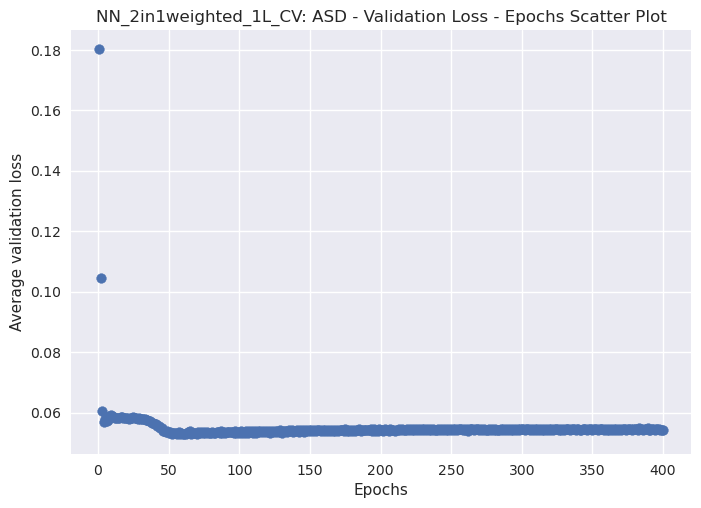

0.05275537259876728
['ASD']


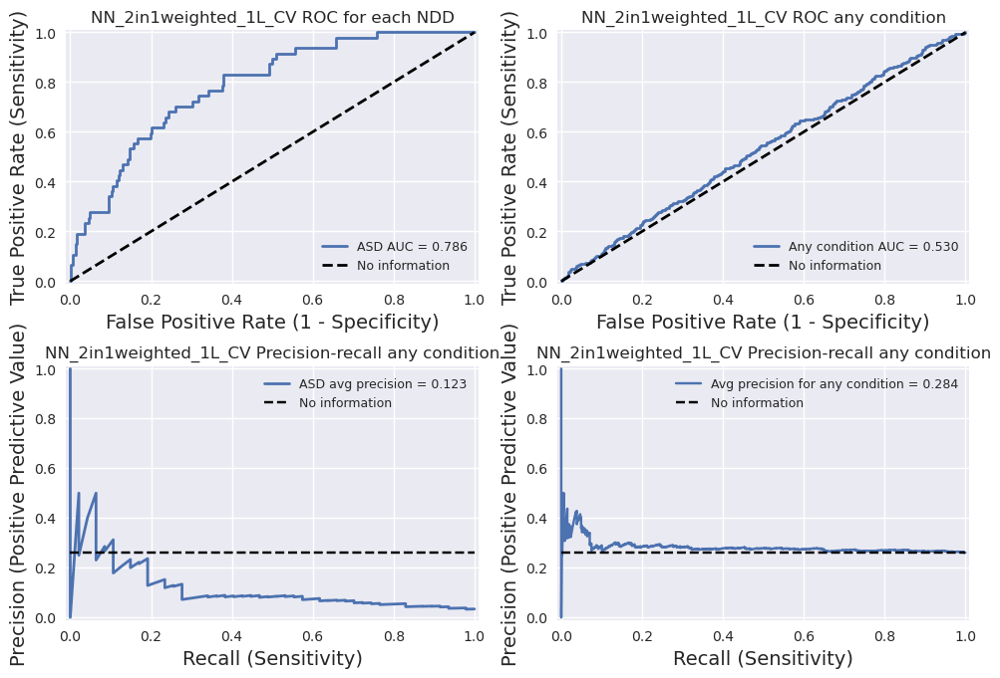

Fold 6/10
Dataset dimensions are (12960, 560) (12960, 1) (3240, 560) (3240, 1) (1800, 560) (1800, 1)



A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


Training Epochs:   0%|          | 0/200 [00:00<?, ?it/s]

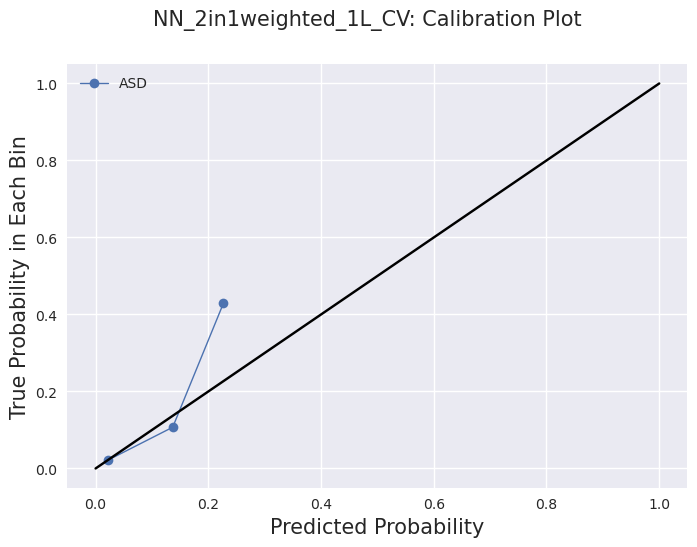

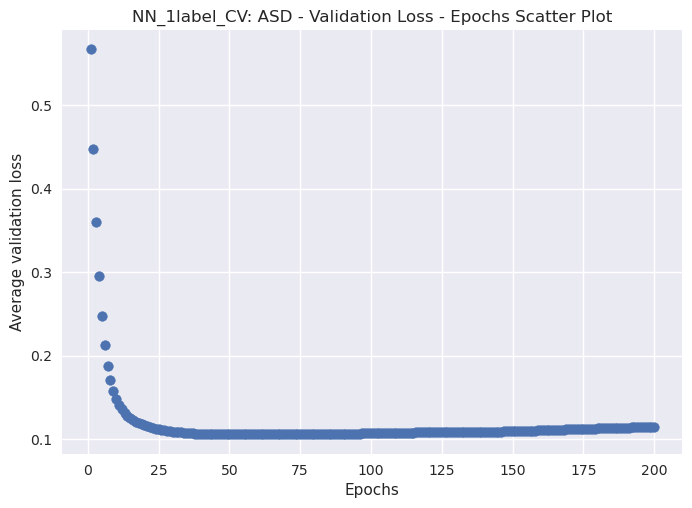

0.10569331422448158
['ASD']


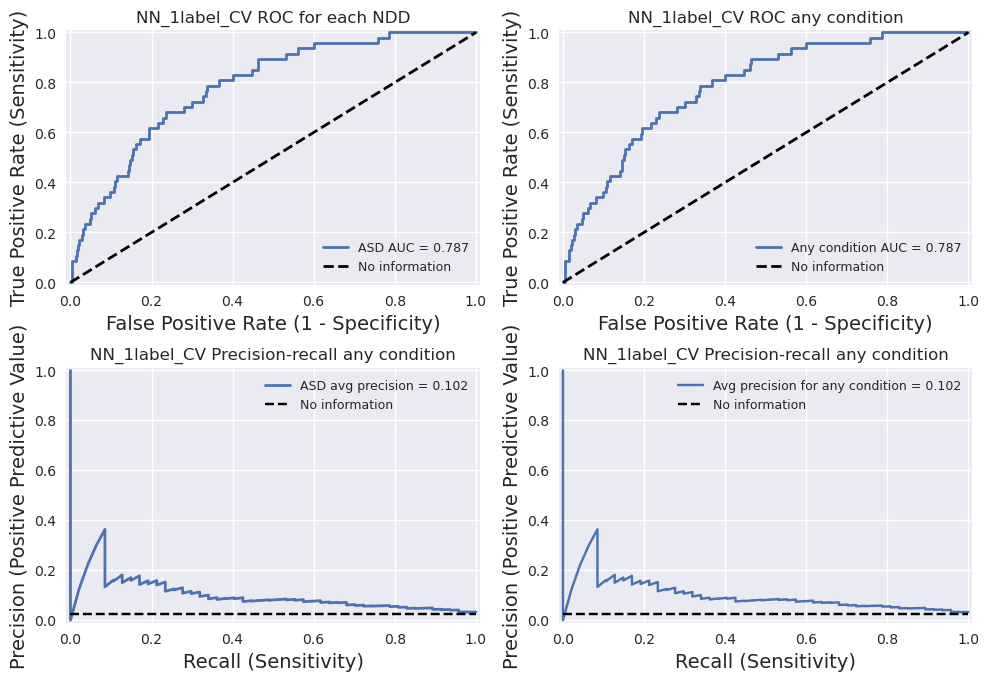

Dataset dimensions are (12960, 560) (12960, 5) (3240, 560) (3240, 5) (1800, 560) (1800, 5)


Training Epochs:   0%|          | 0/400 [00:00<?, ?it/s]

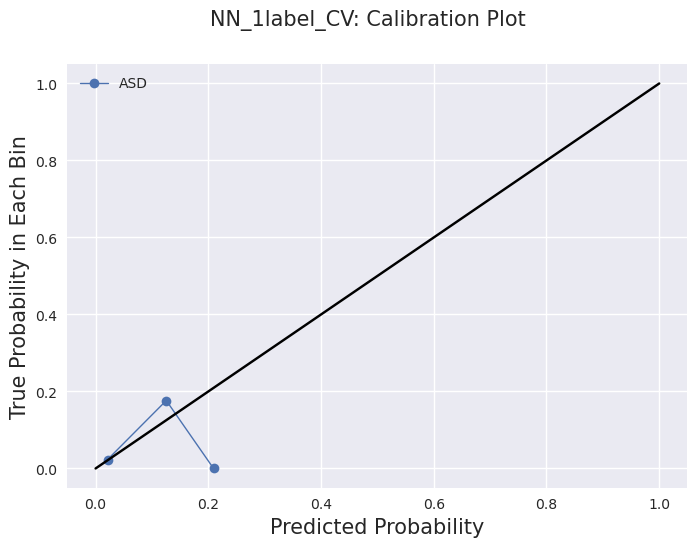

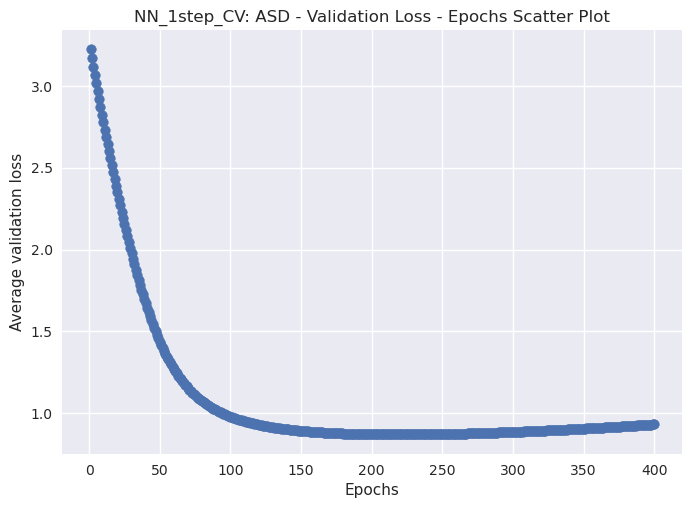

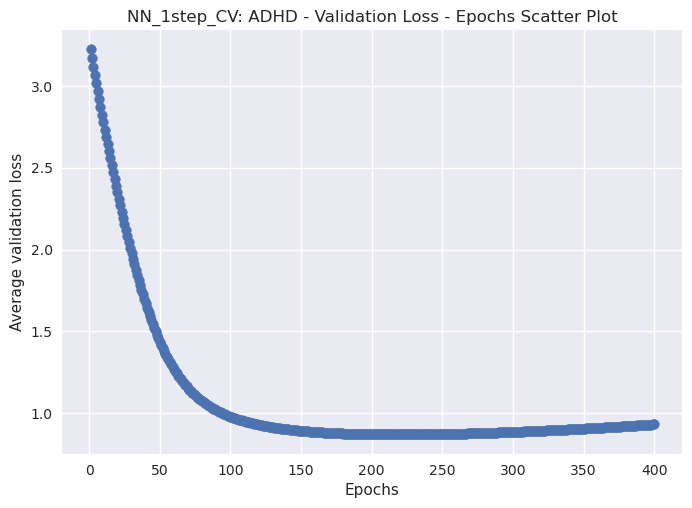

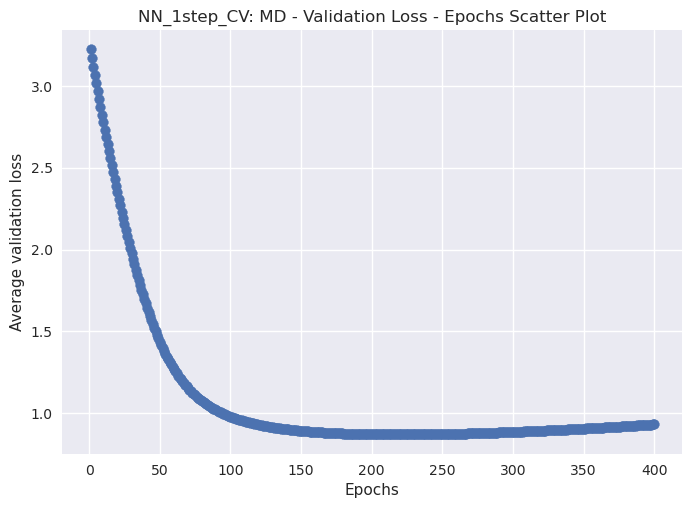

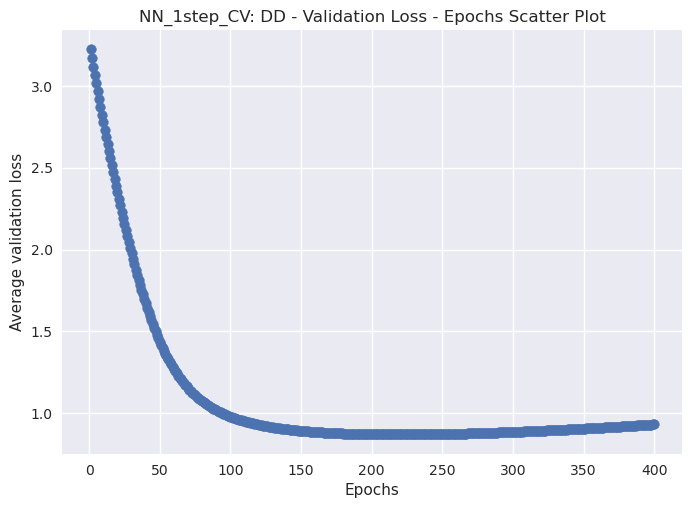

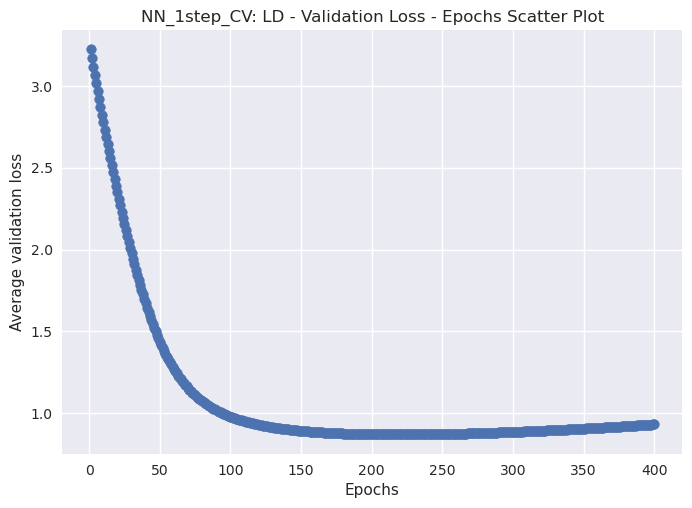

0.8703595697879791
['ASD', 'ADHD', 'MD', 'DD', 'LD']


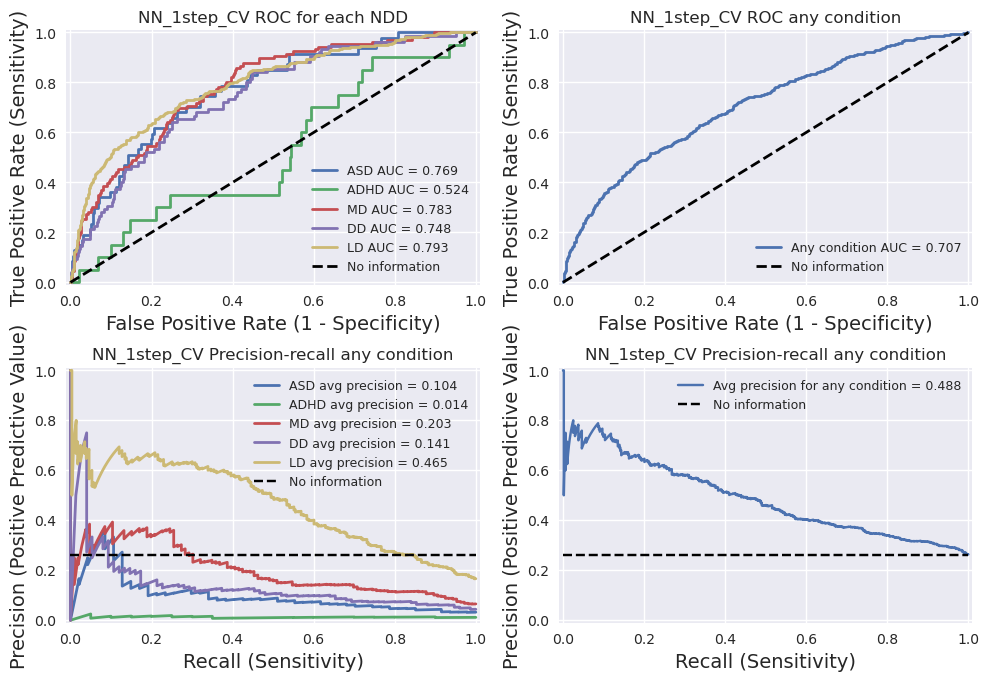

MTLnet(
  (flatten): Flatten(start_dim=1, end_dim=-1)
  (linear_sigmoid_stack): Sequential(
    (0): Linear(in_features=560, out_features=100, bias=True)
    (1): ReLU()
    (2): Linear(in_features=100, out_features=1, bias=True)
  )
)
MTLnet(
  (flatten): Flatten(start_dim=1, end_dim=-1)
  (linear_sigmoid_stack): Sequential(
    (0): Linear(in_features=560, out_features=100, bias=True)
    (1): ReLU()
    (2): Linear(in_features=100, out_features=5, bias=True)
  )
)
Dataset dimensions are (12960, 560) (12960, 1) (3240, 560) (3240, 1) (1800, 560) (1800, 1)


Training Epochs:   0%|          | 0/400 [00:00<?, ?it/s]

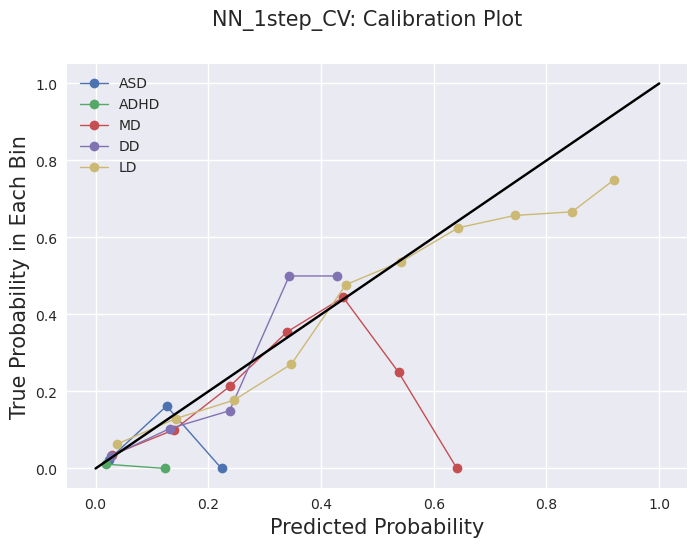

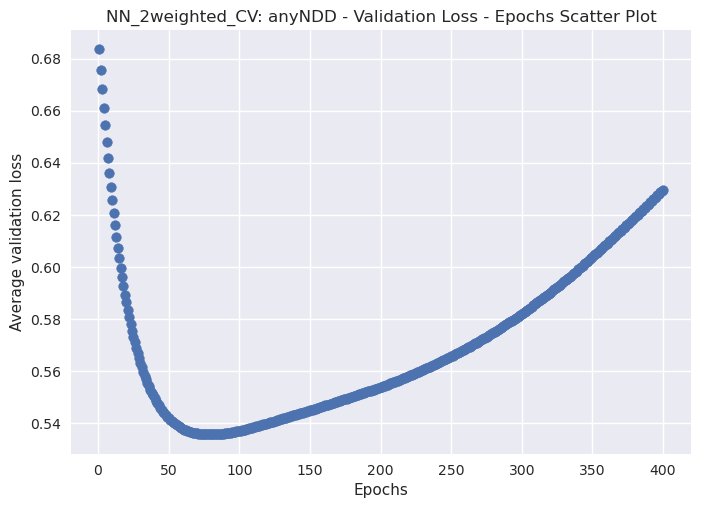

['anyNDD']


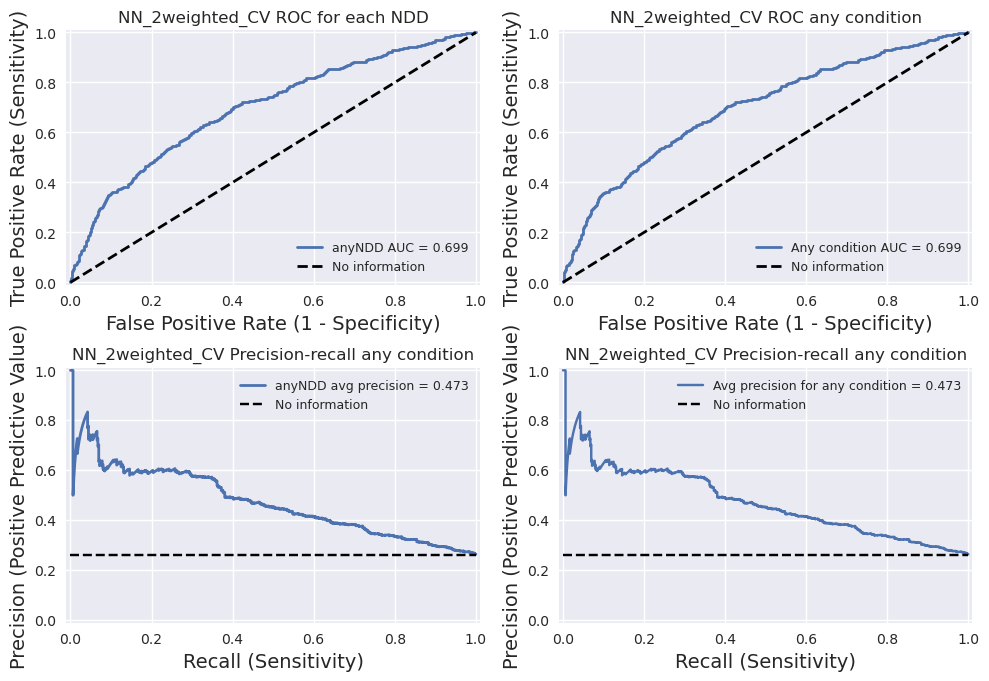

['anyNDD']


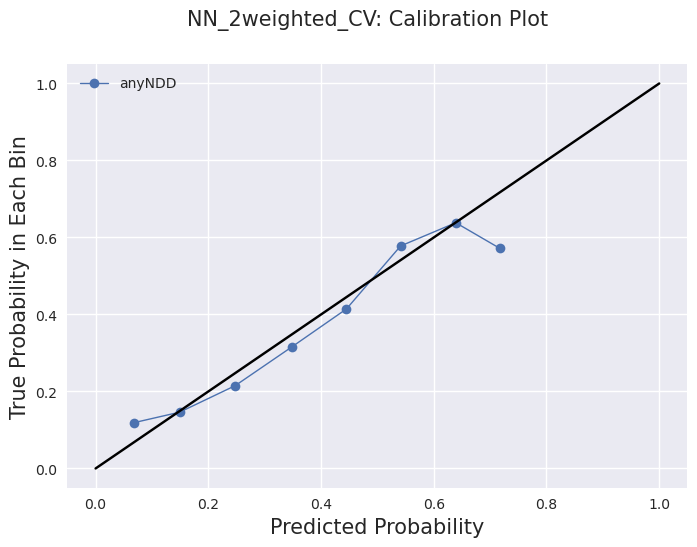

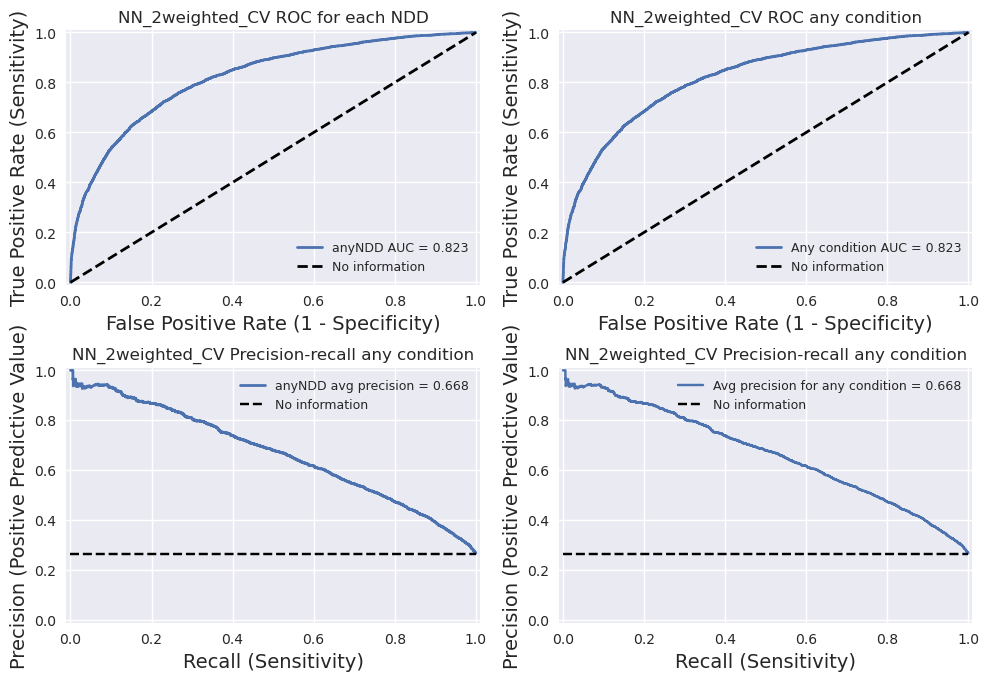

['anyNDD']


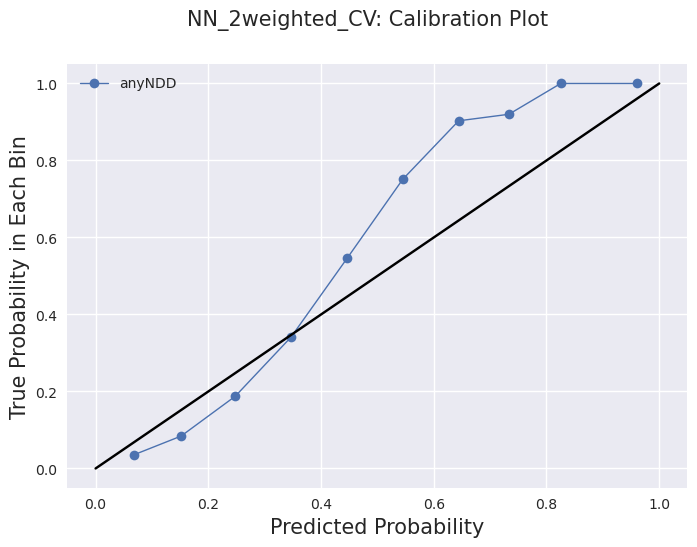

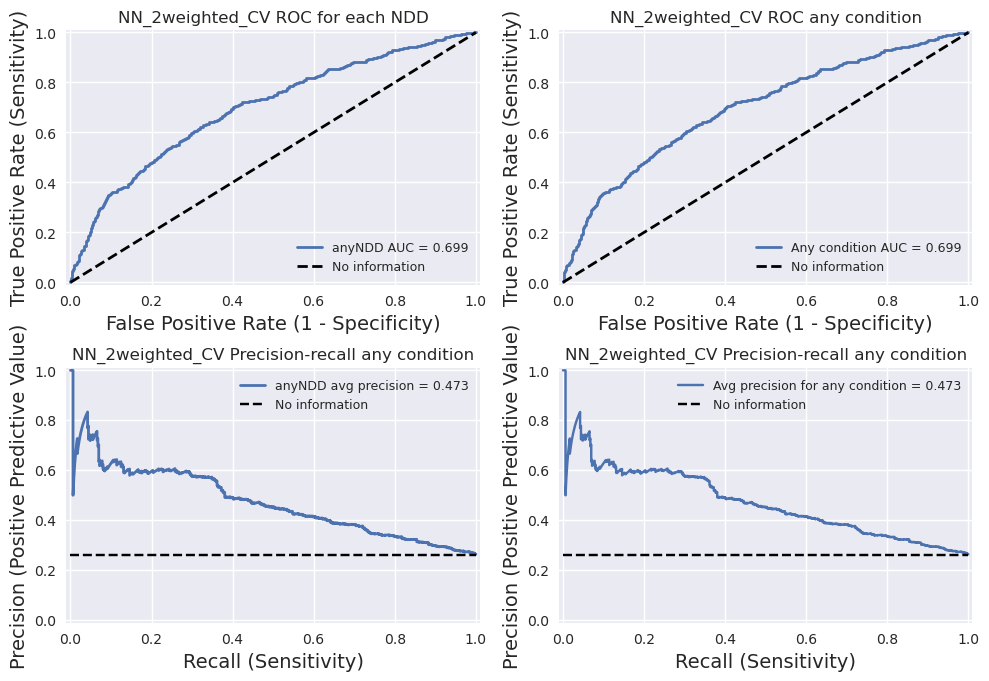

Dataset dimensions are (12960, 560) (12960, 5) (3240, 560) (3240, 5) (1800, 560) (1800, 5)


Training Epochs:   0%|          | 0/800 [00:00<?, ?it/s]

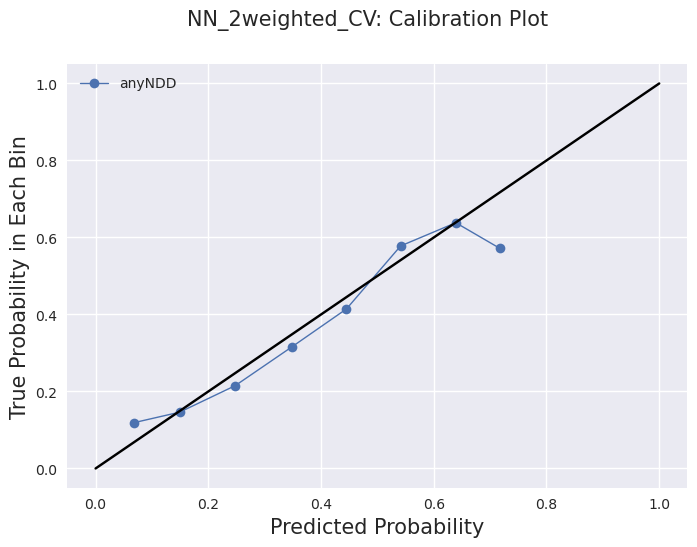

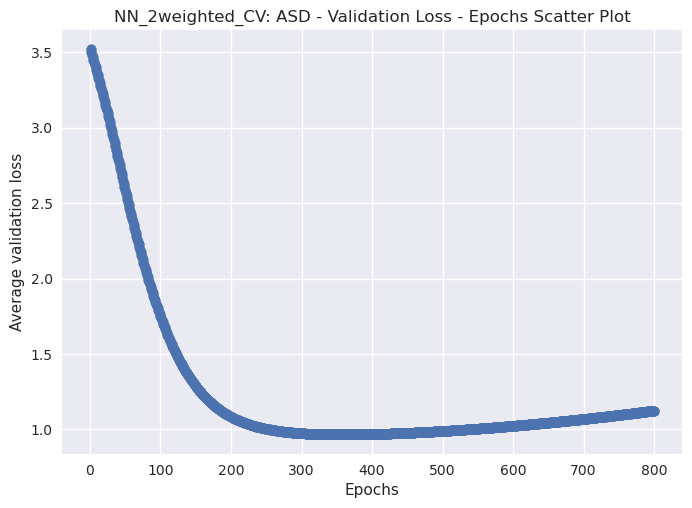

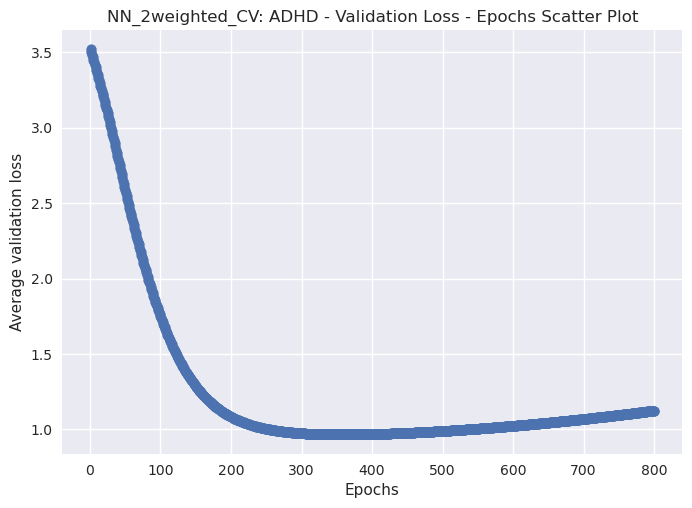

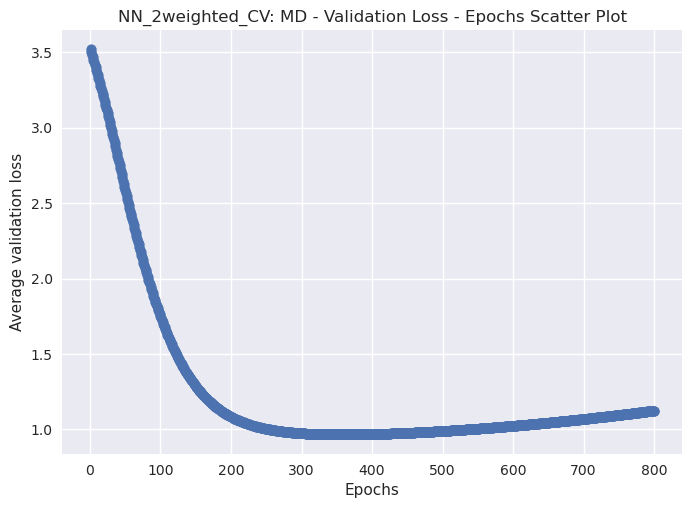

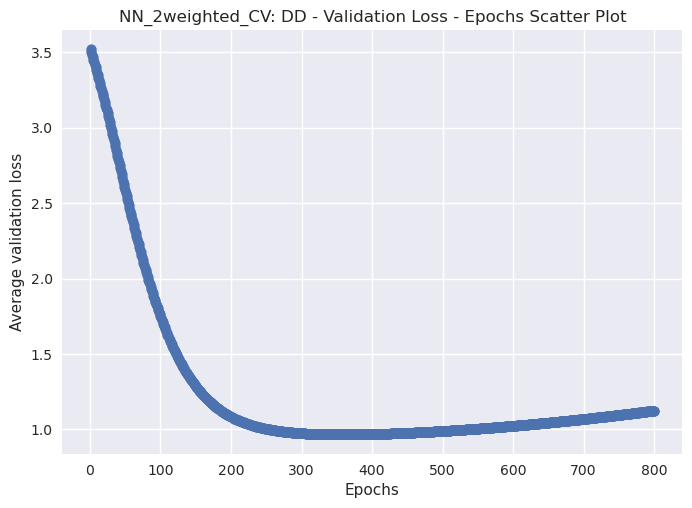

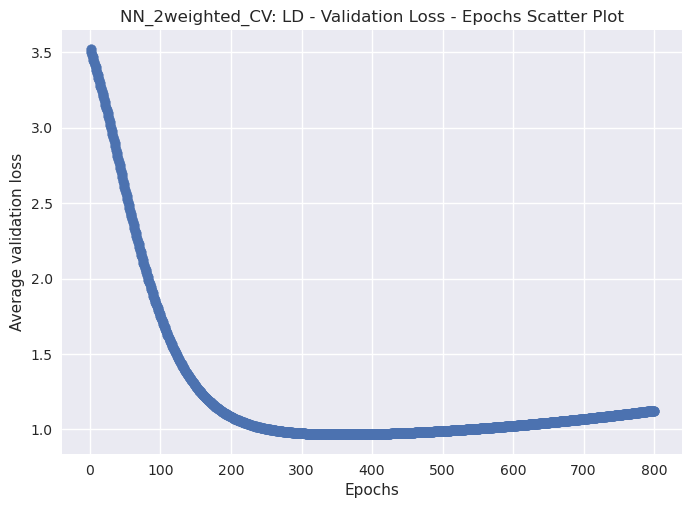

0.9668473601341248
['ASD', 'ADHD', 'MD', 'DD', 'LD']


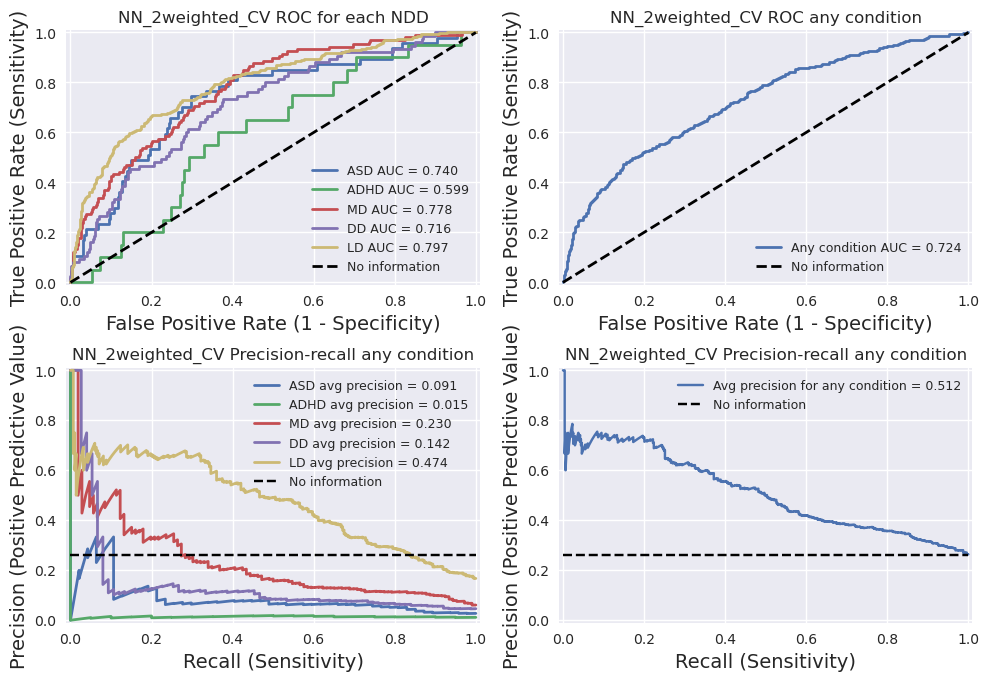

MTLnet(
  (flatten): Flatten(start_dim=1, end_dim=-1)
  (linear_sigmoid_stack): Sequential(
    (0): Linear(in_features=560, out_features=100, bias=True)
    (1): ReLU()
    (2): Linear(in_features=100, out_features=6, bias=True)
  )
)
Dataset dimensions are (12960, 560) (12960, 6) (3240, 560) (3240, 6) (1800, 560) (1800, 6)


Training Epochs:   0%|          | 0/400 [00:00<?, ?it/s]

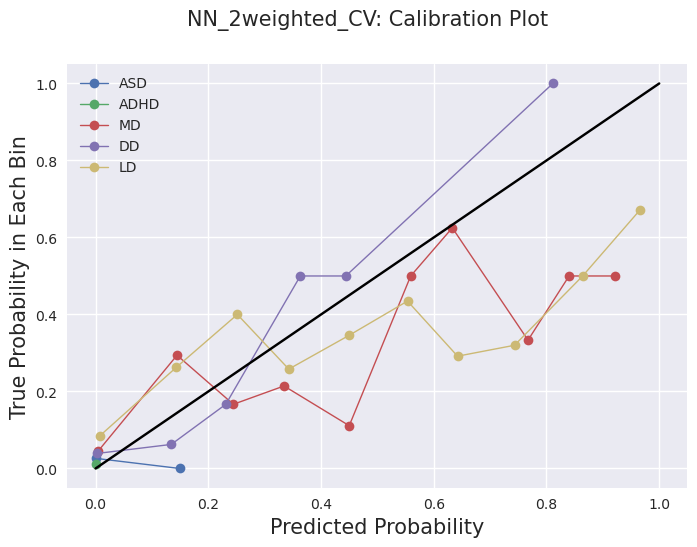

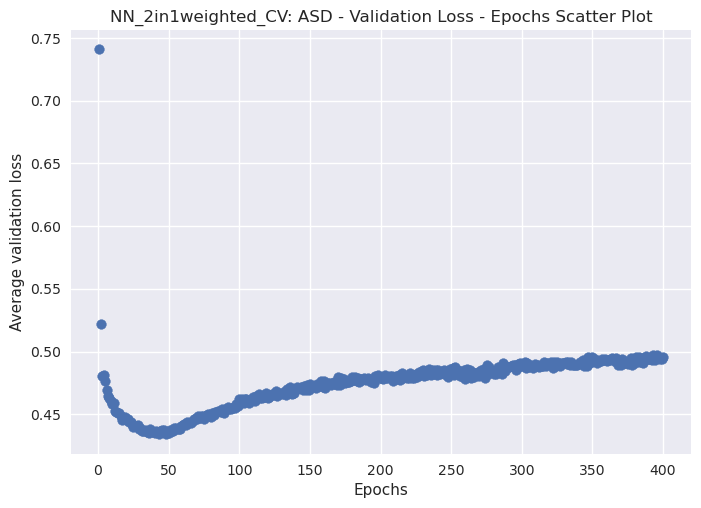

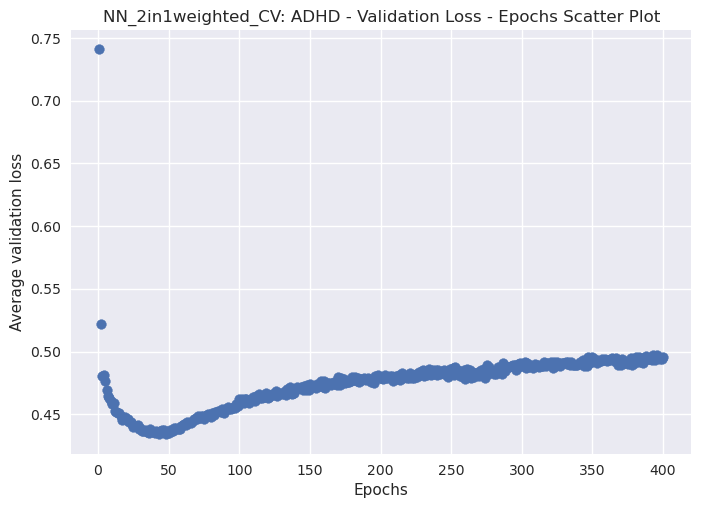

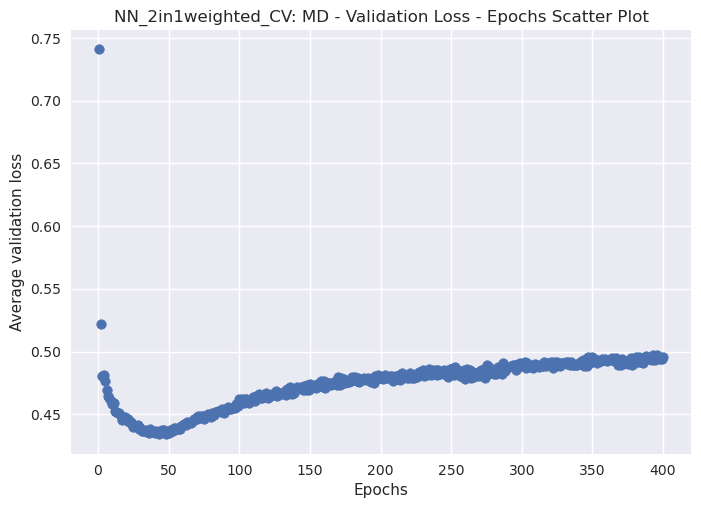

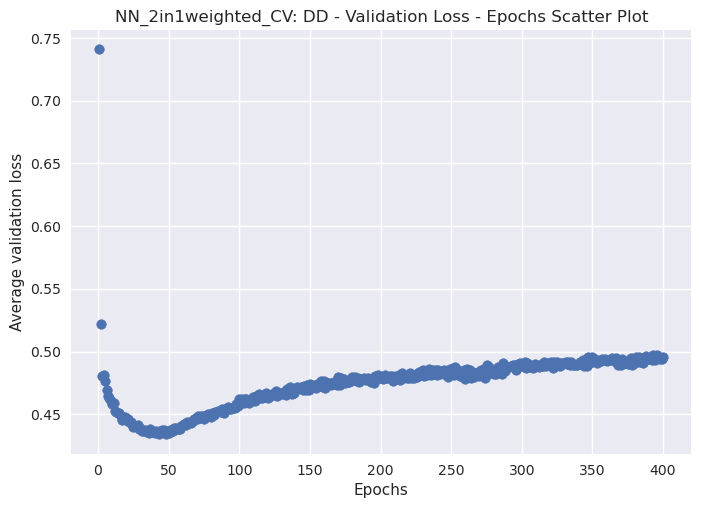

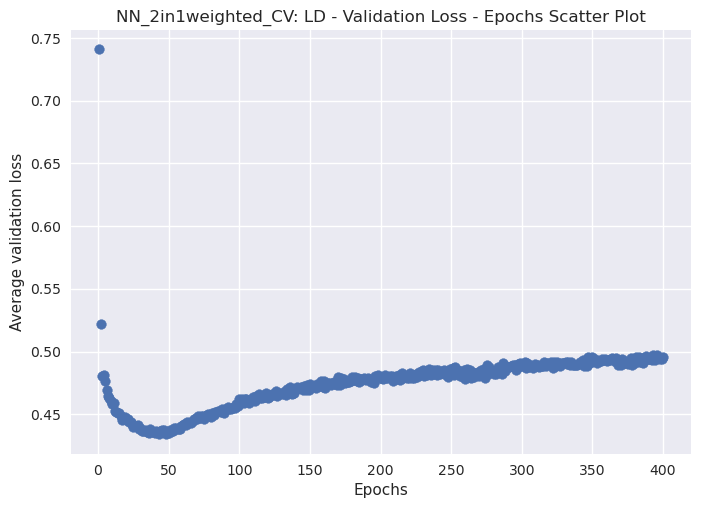

0.43385519087314606
['ASD', 'ADHD', 'MD', 'DD', 'LD']


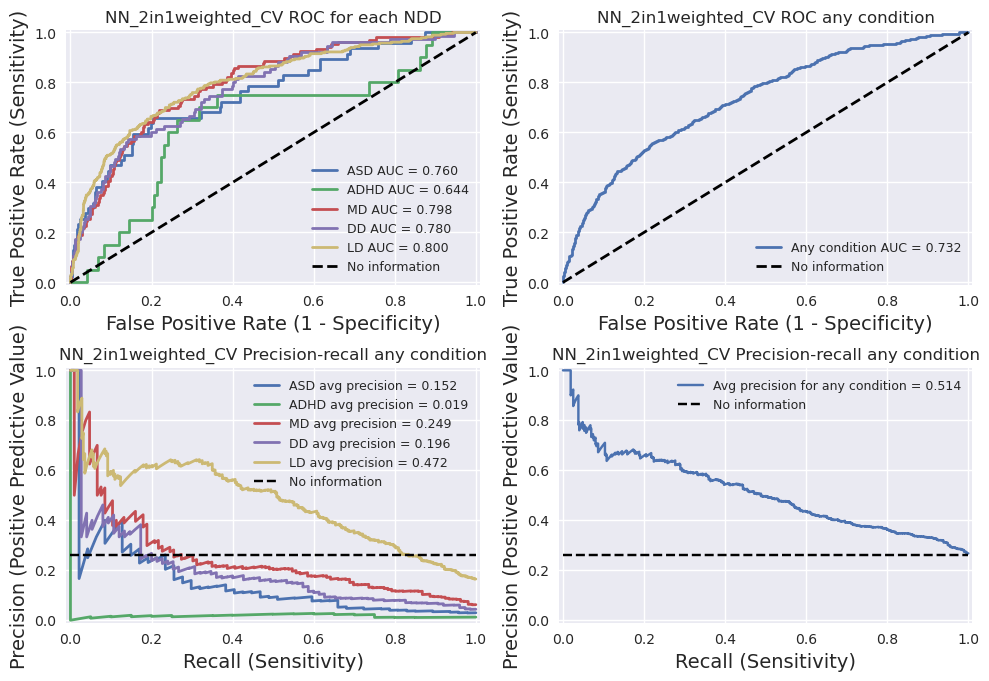

Dataset dimensions are (12960, 560) (12960, 1) (3240, 560) (3240, 1) (1800, 560) (1800, 1)


Training Epochs:   0%|          | 0/400 [00:00<?, ?it/s]

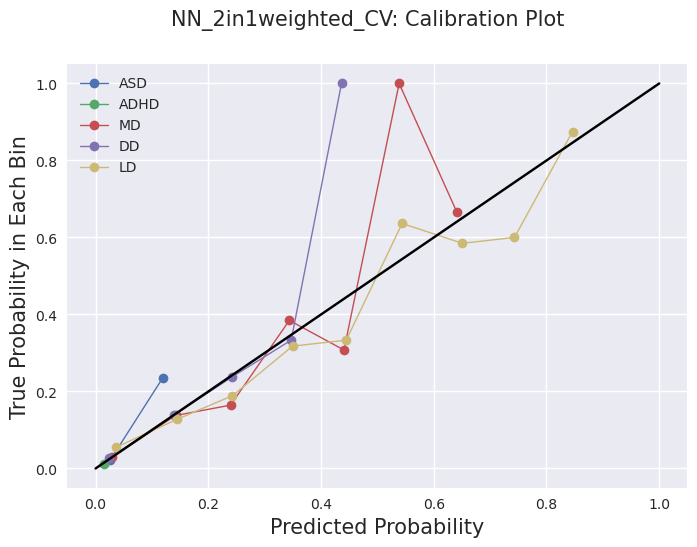

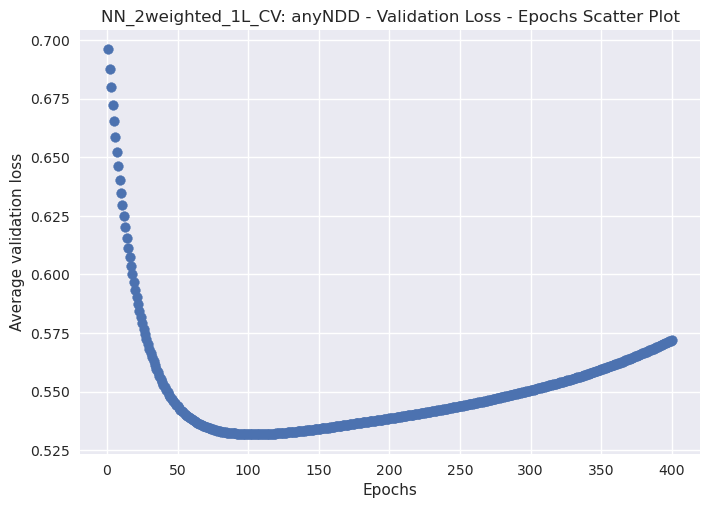

['anyNDD']


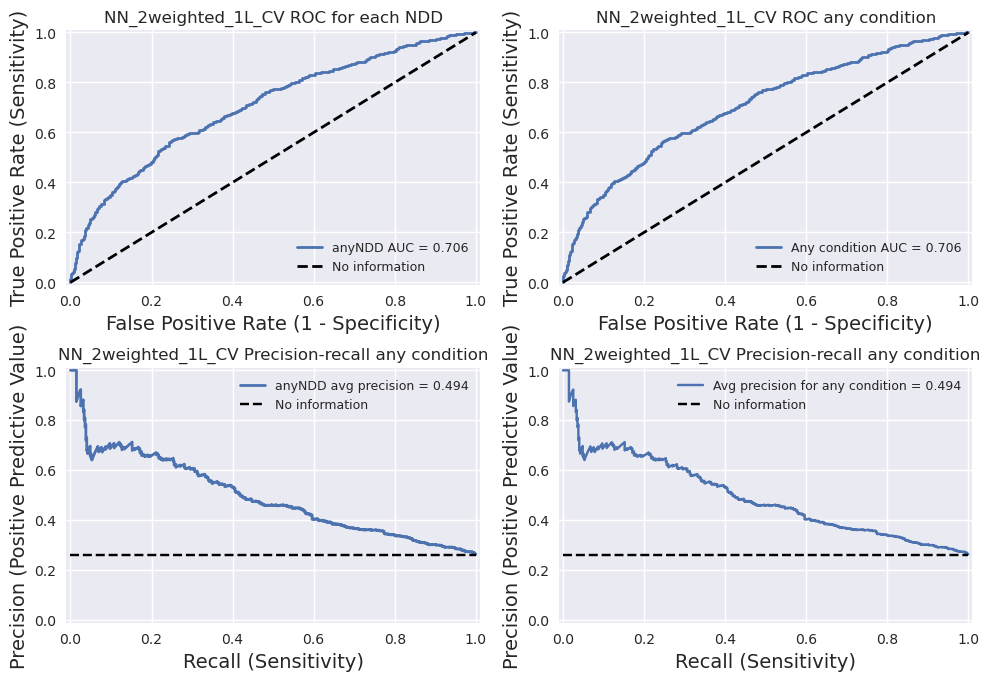

['anyNDD']


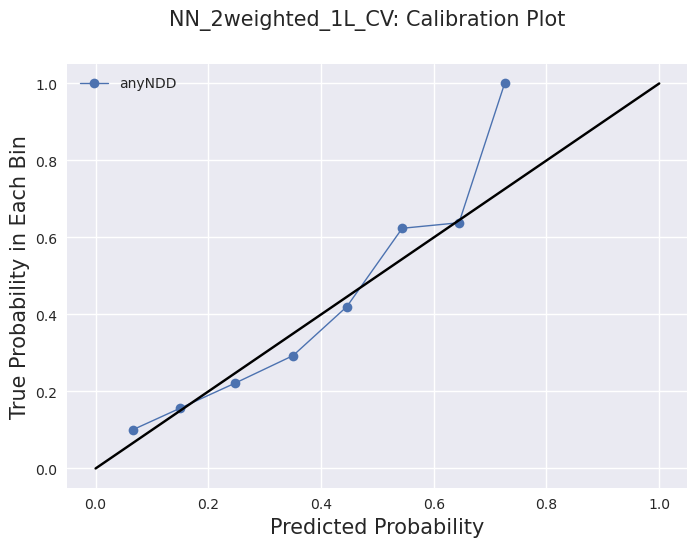

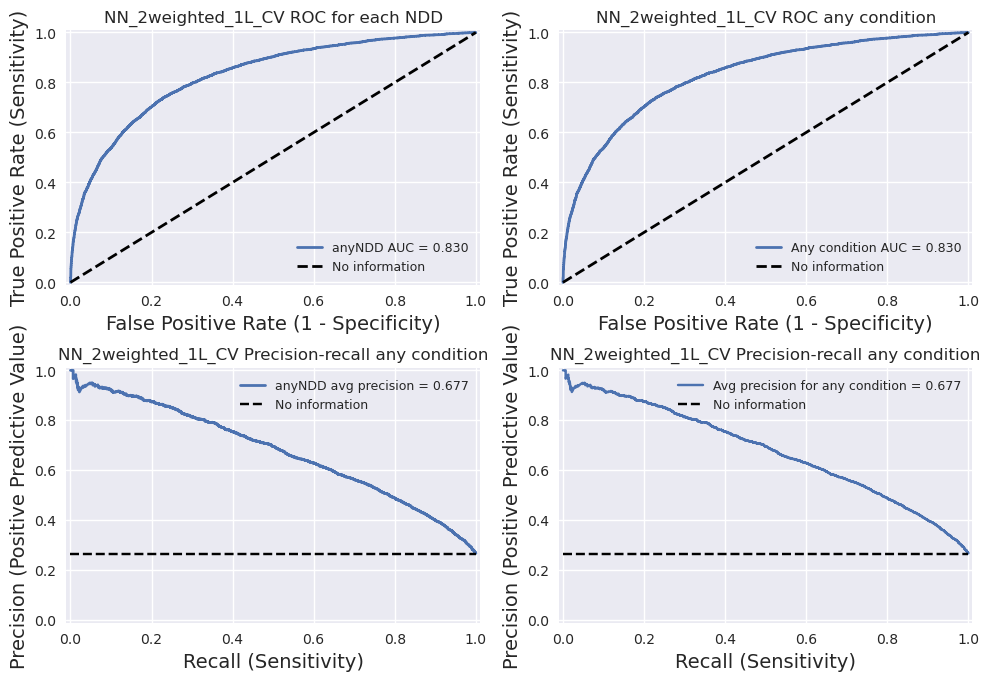

['anyNDD']


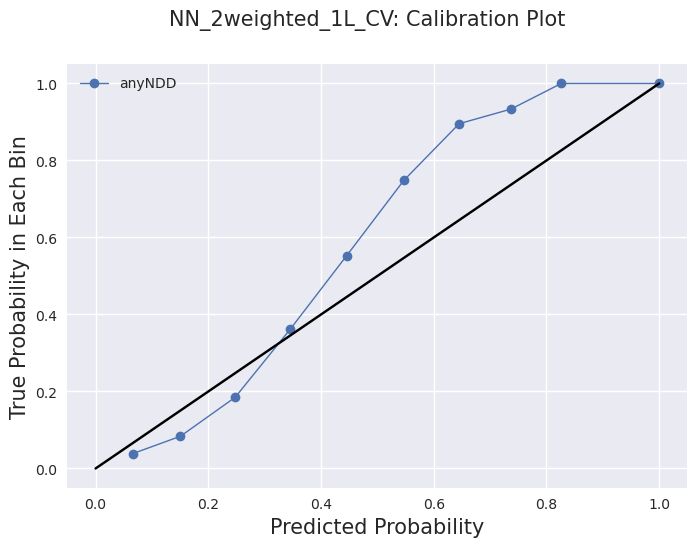

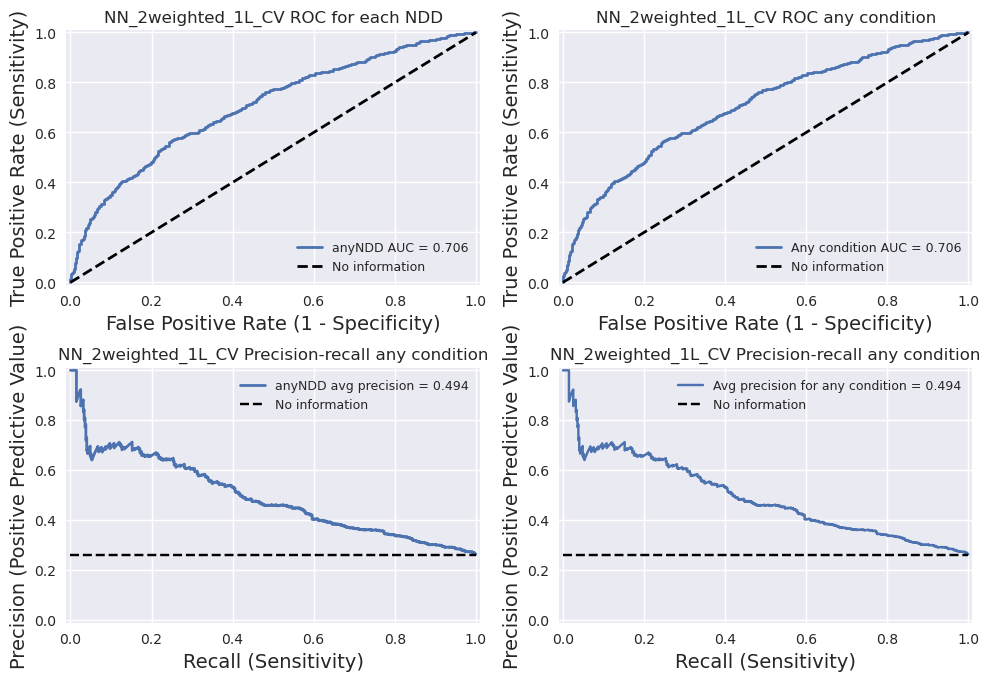

Dataset dimensions are (12960, 560) (12960, 1) (3240, 560) (3240, 1) (1800, 560) (1800, 1)


Training Epochs:   0%|          | 0/400 [00:00<?, ?it/s]

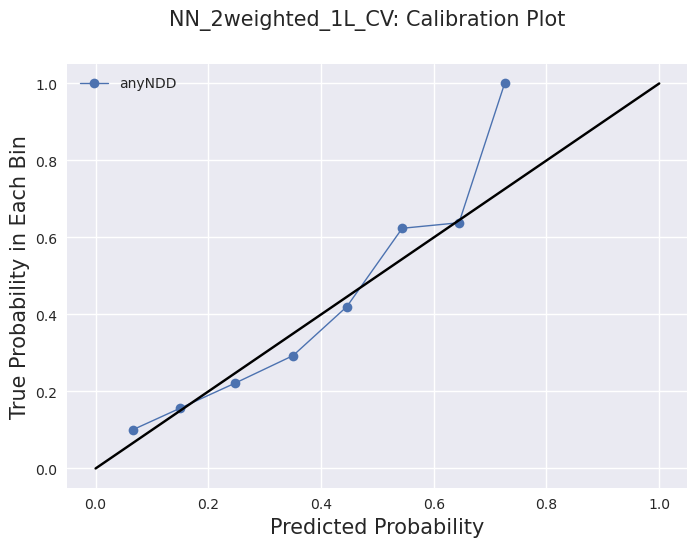

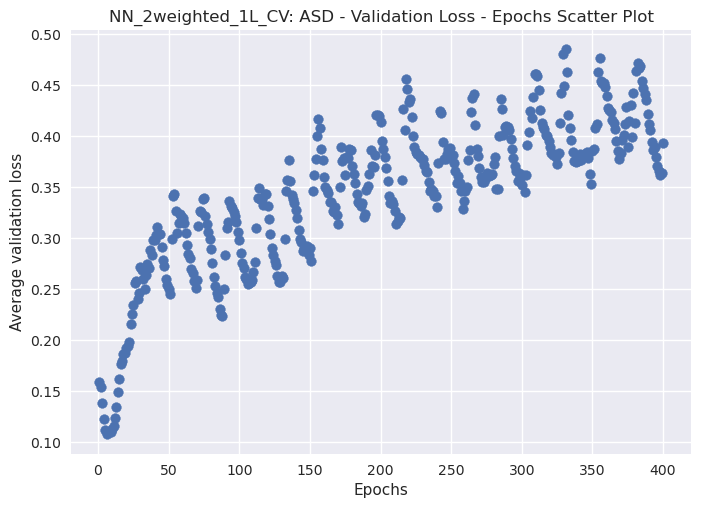

0.10765891894698143
['ASD']


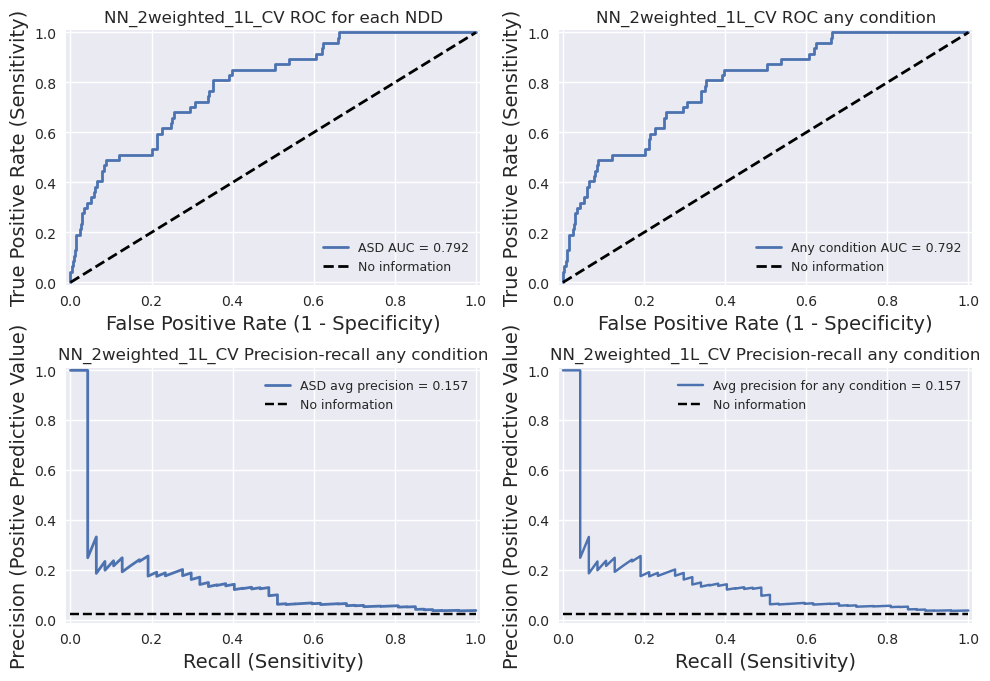

MTLnet(
  (flatten): Flatten(start_dim=1, end_dim=-1)
  (linear_sigmoid_stack): Sequential(
    (0): Linear(in_features=560, out_features=100, bias=True)
    (1): ReLU()
    (2): Linear(in_features=100, out_features=2, bias=True)
  )
)
Dataset dimensions are (12960, 560) (12960, 2) (3240, 560) (3240, 2) (1800, 560) (1800, 2)


Training Epochs:   0%|          | 0/400 [00:00<?, ?it/s]

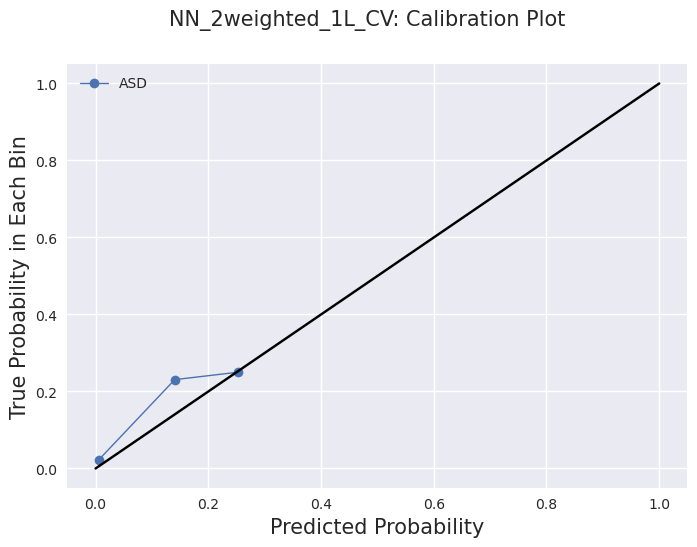

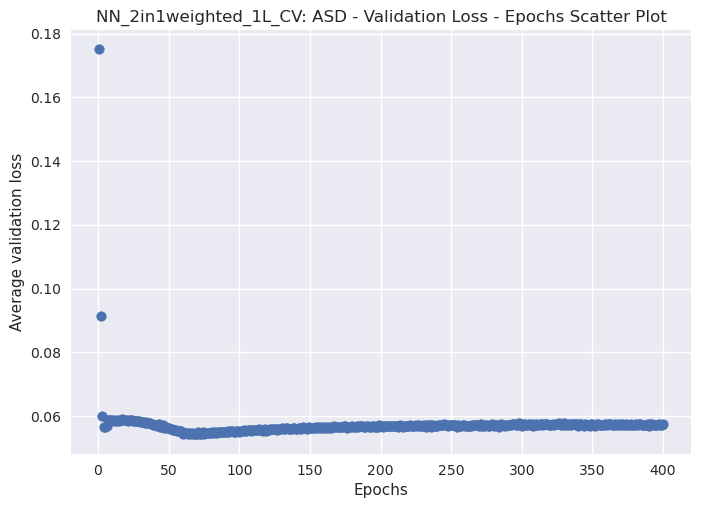

0.05424400605261326
['ASD']


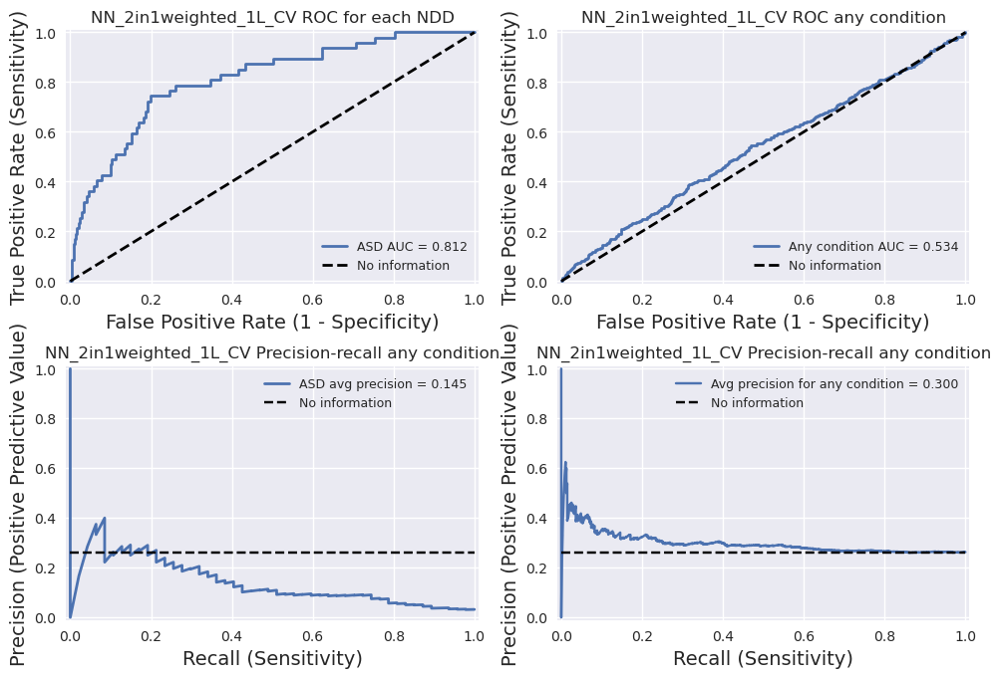

Fold 7/10
Dataset dimensions are (12960, 560) (12960, 1) (3240, 560) (3240, 1) (1800, 560) (1800, 1)



A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


Training Epochs:   0%|          | 0/200 [00:00<?, ?it/s]

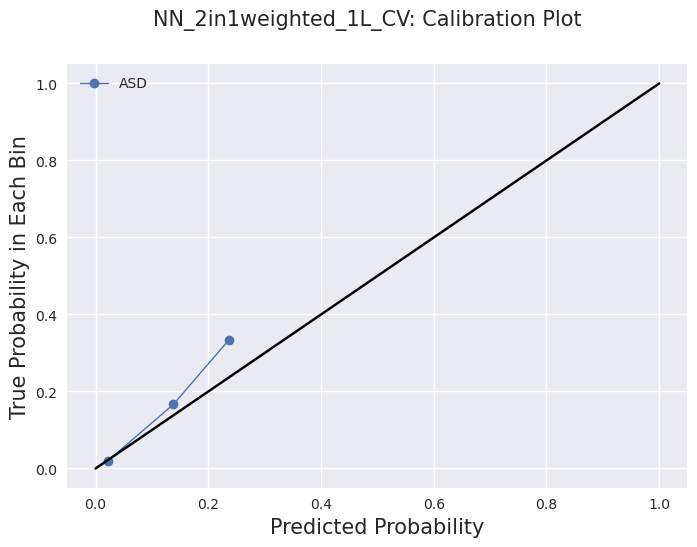

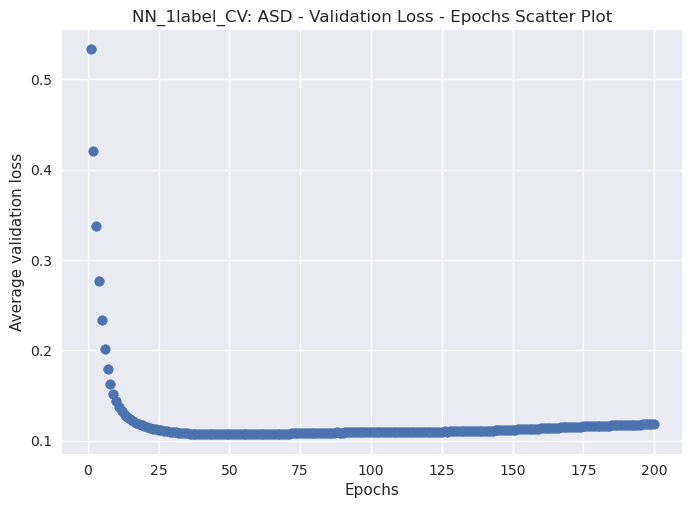

0.10681765154004097
['ASD']


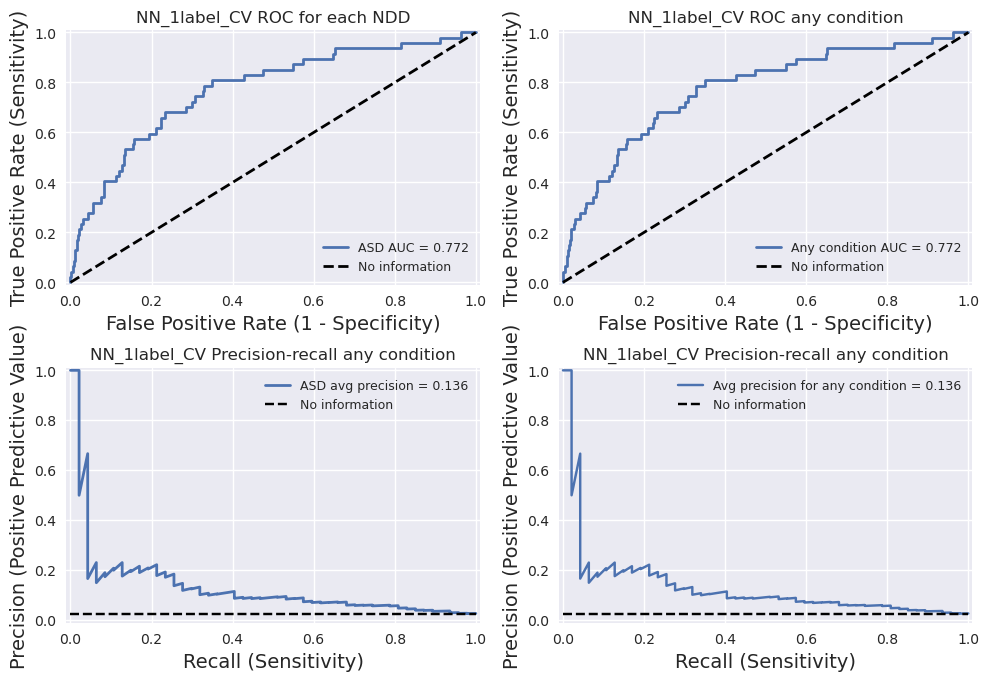

Dataset dimensions are (12960, 560) (12960, 5) (3240, 560) (3240, 5) (1800, 560) (1800, 5)


Training Epochs:   0%|          | 0/400 [00:00<?, ?it/s]

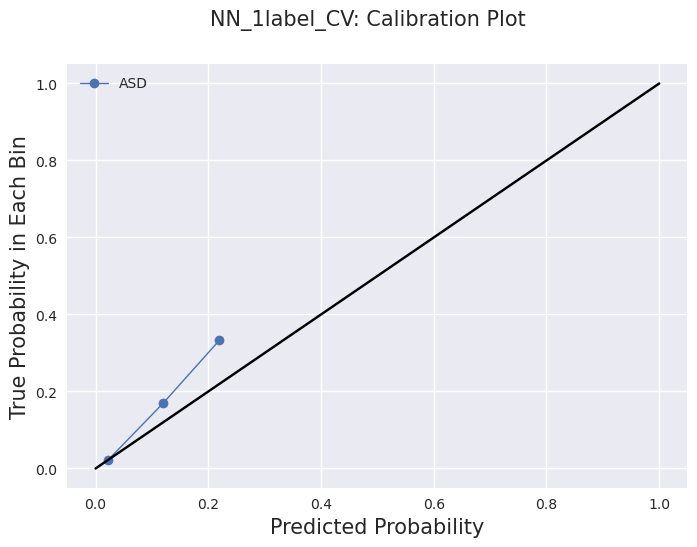

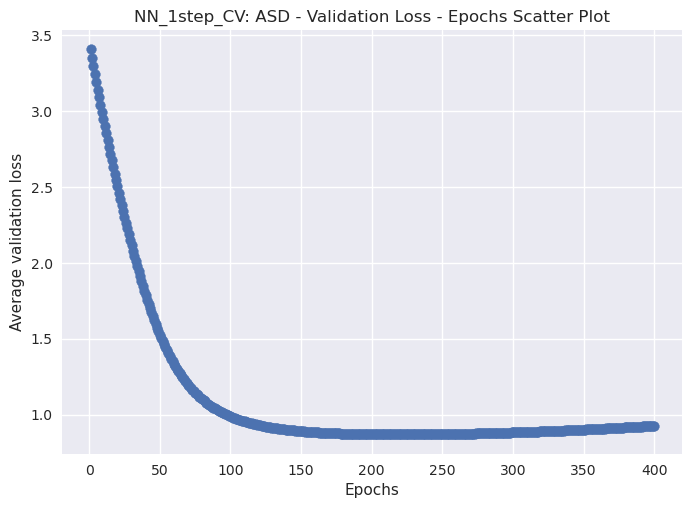

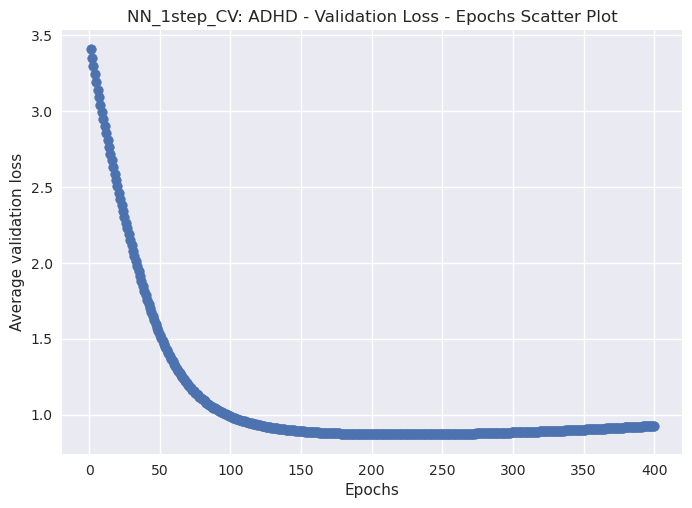

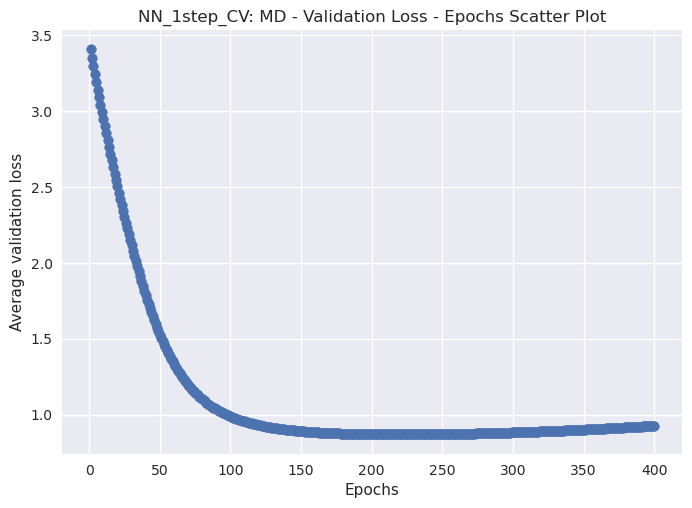

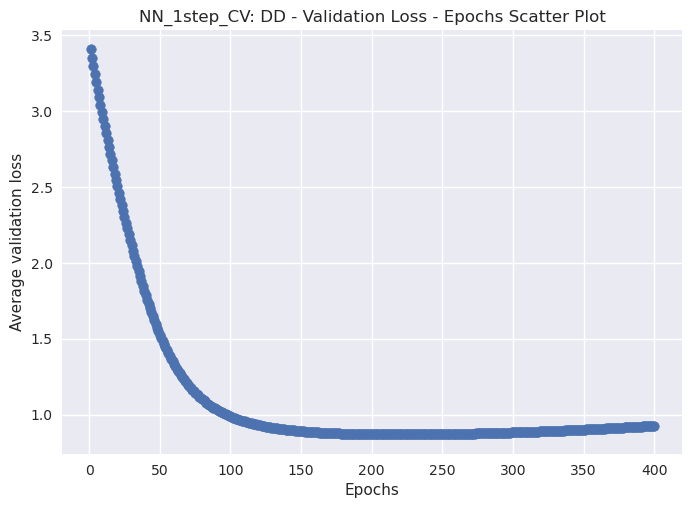

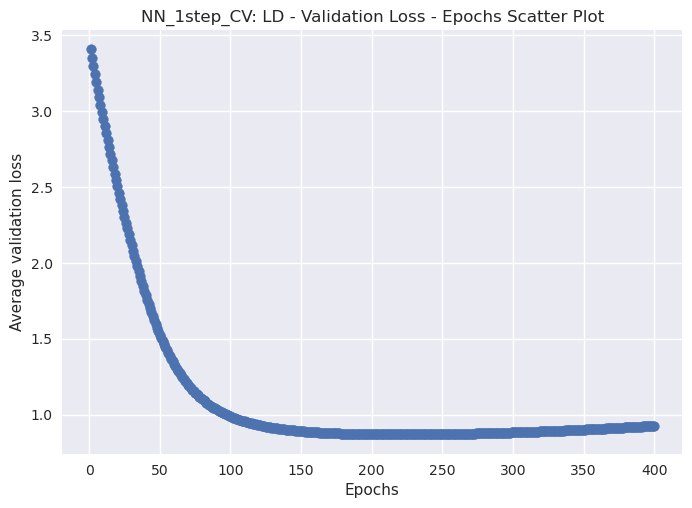

0.8704926371574402
['ASD', 'ADHD', 'MD', 'DD', 'LD']


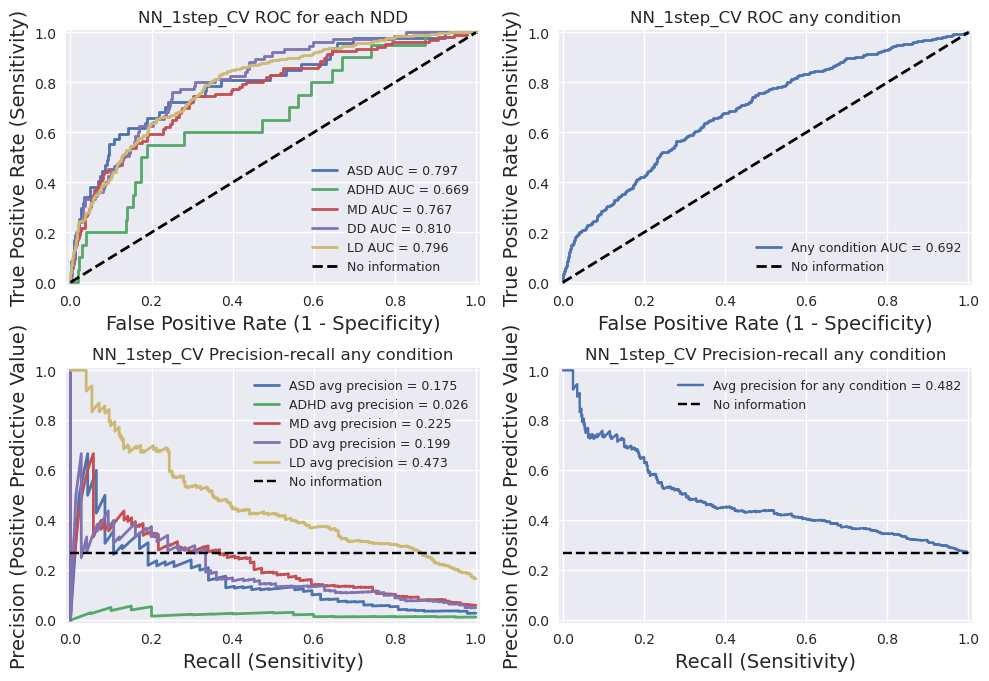

MTLnet(
  (flatten): Flatten(start_dim=1, end_dim=-1)
  (linear_sigmoid_stack): Sequential(
    (0): Linear(in_features=560, out_features=100, bias=True)
    (1): ReLU()
    (2): Linear(in_features=100, out_features=1, bias=True)
  )
)
MTLnet(
  (flatten): Flatten(start_dim=1, end_dim=-1)
  (linear_sigmoid_stack): Sequential(
    (0): Linear(in_features=560, out_features=100, bias=True)
    (1): ReLU()
    (2): Linear(in_features=100, out_features=5, bias=True)
  )
)
Dataset dimensions are (12960, 560) (12960, 1) (3240, 560) (3240, 1) (1800, 560) (1800, 1)


Training Epochs:   0%|          | 0/400 [00:00<?, ?it/s]

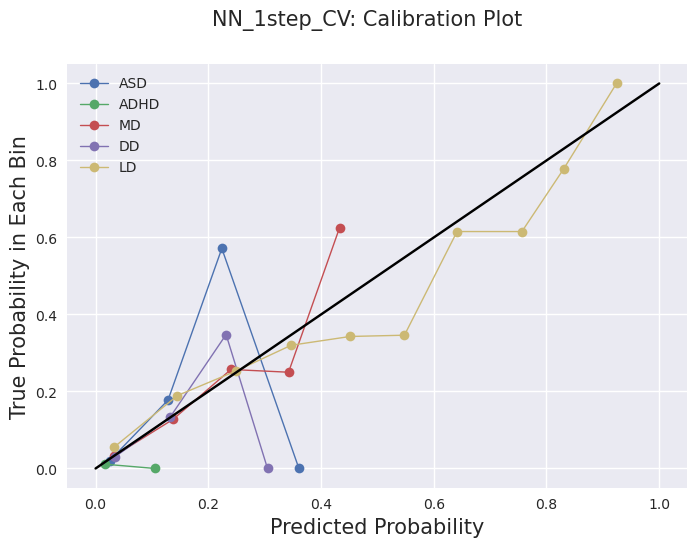

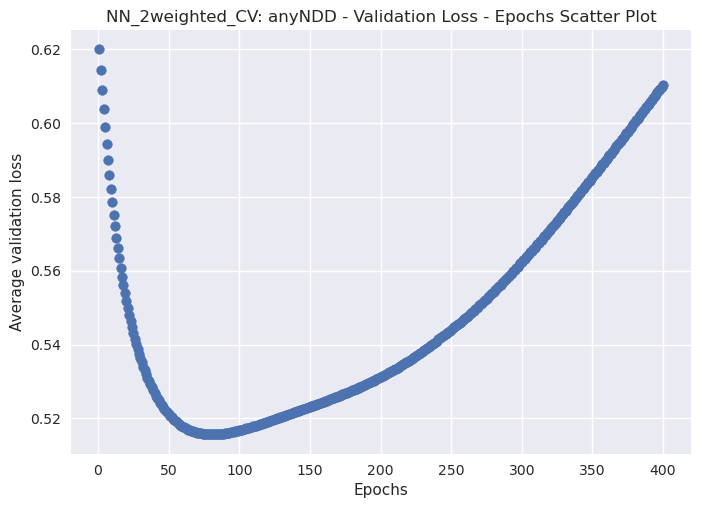

['anyNDD']


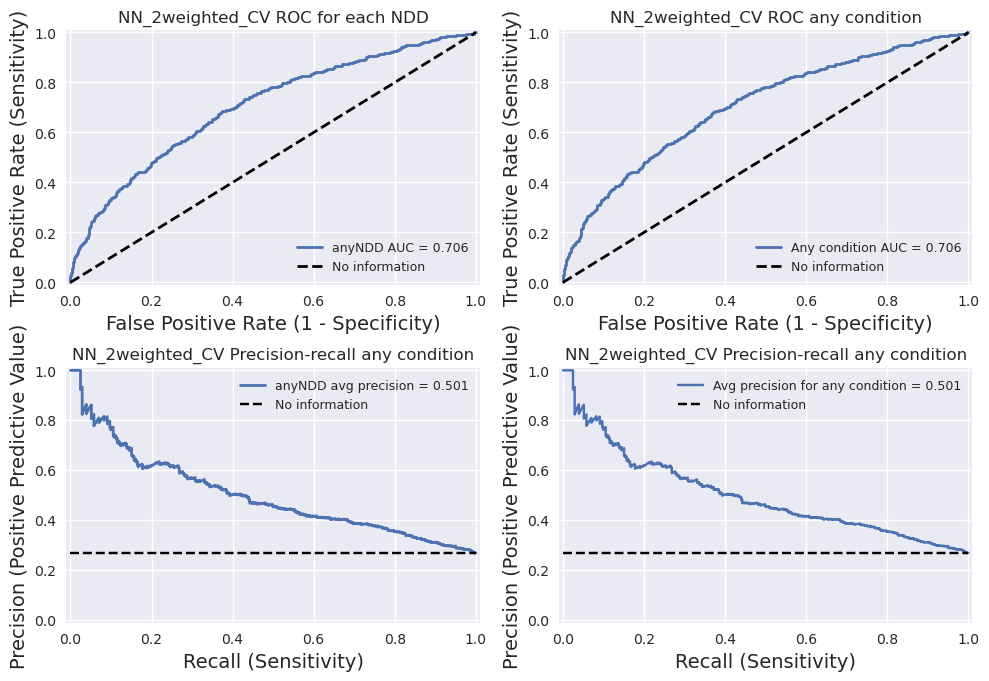

['anyNDD']


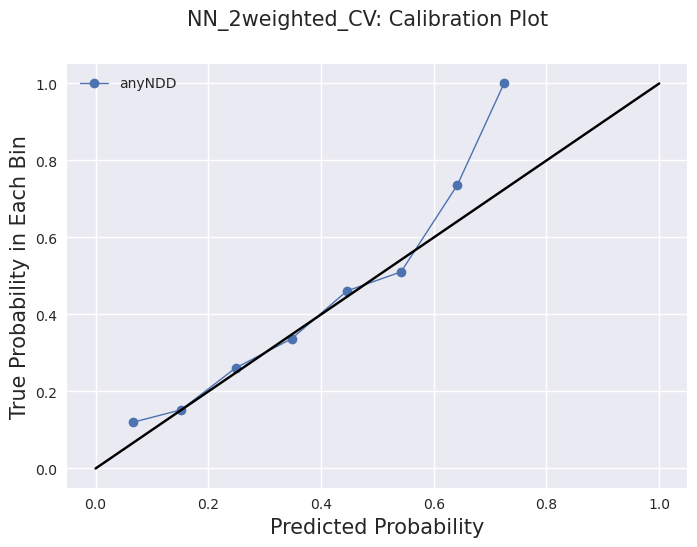

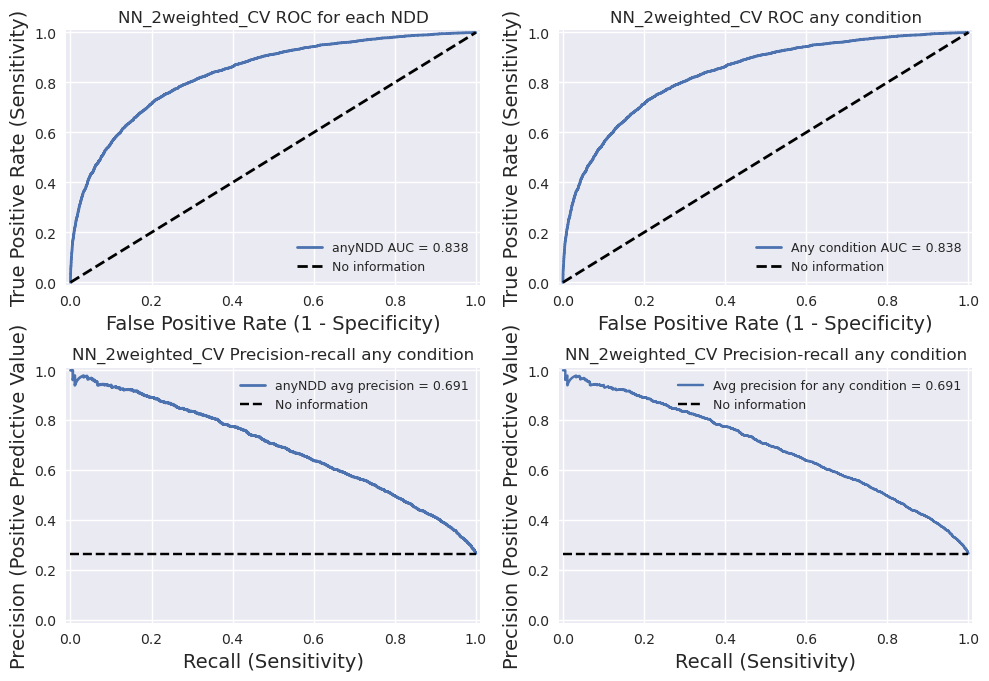

['anyNDD']


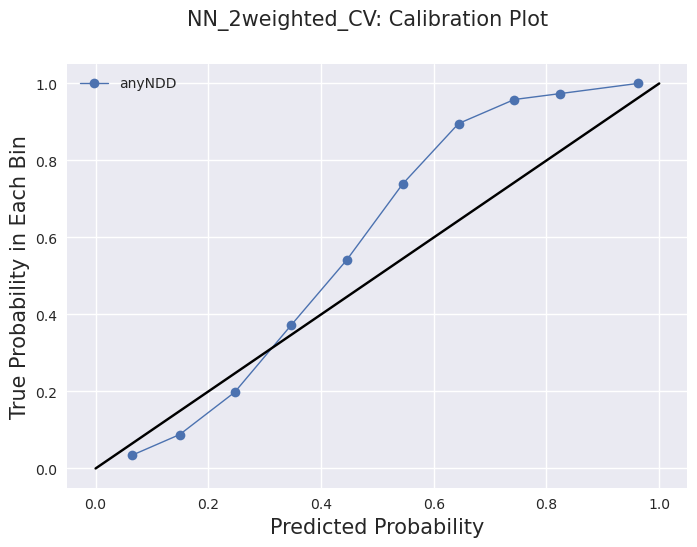

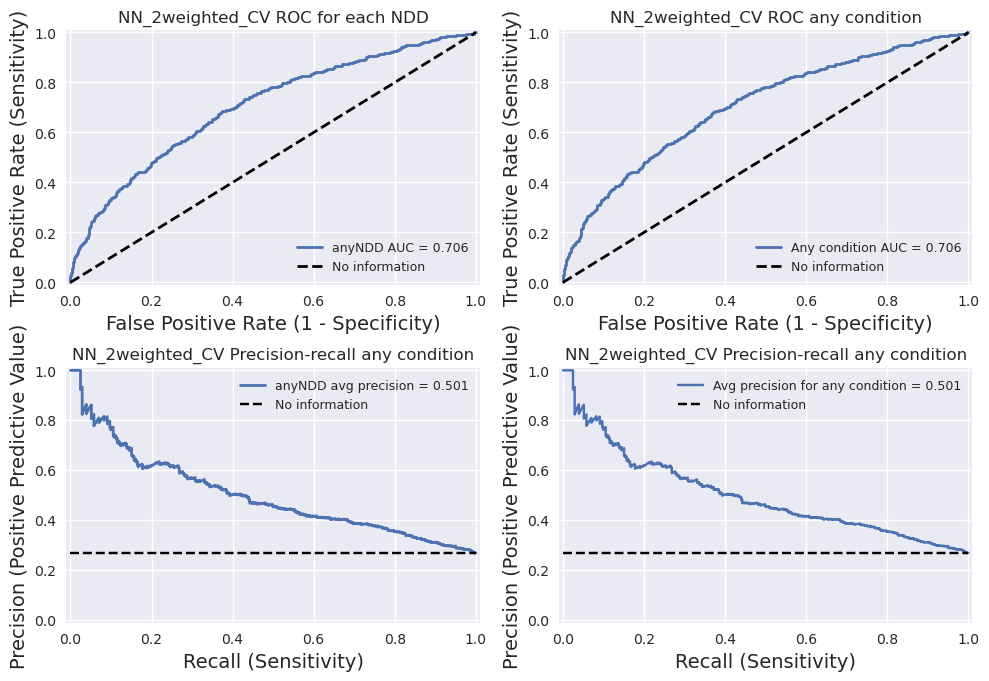

Dataset dimensions are (12960, 560) (12960, 5) (3240, 560) (3240, 5) (1800, 560) (1800, 5)


Training Epochs:   0%|          | 0/800 [00:00<?, ?it/s]

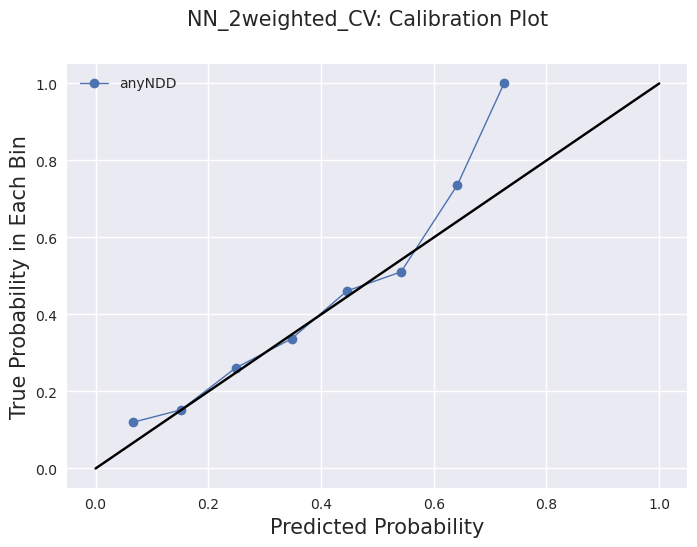

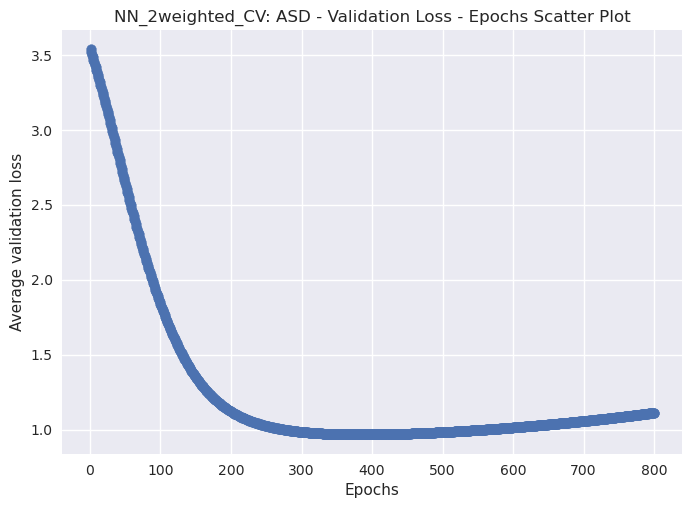

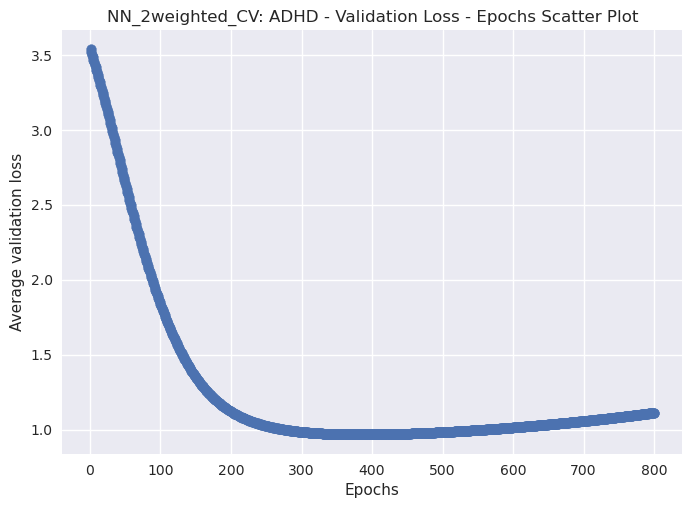

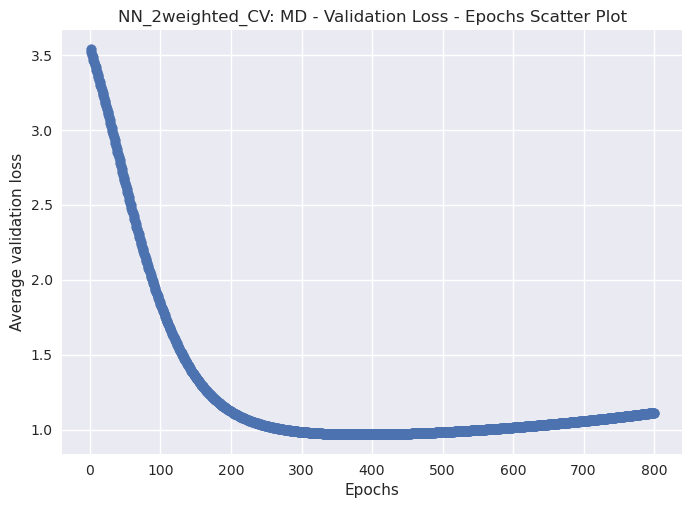

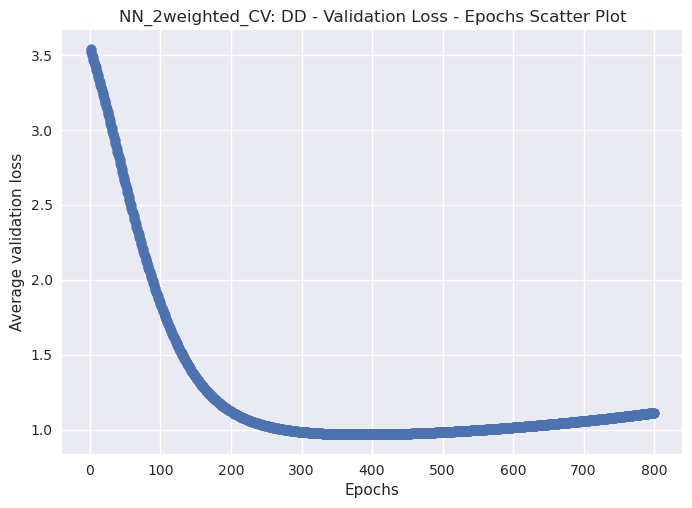

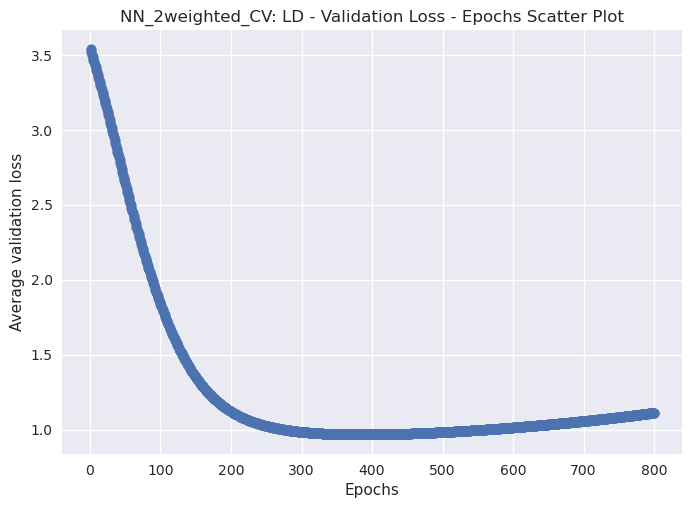

0.9671421349048615
['ASD', 'ADHD', 'MD', 'DD', 'LD']


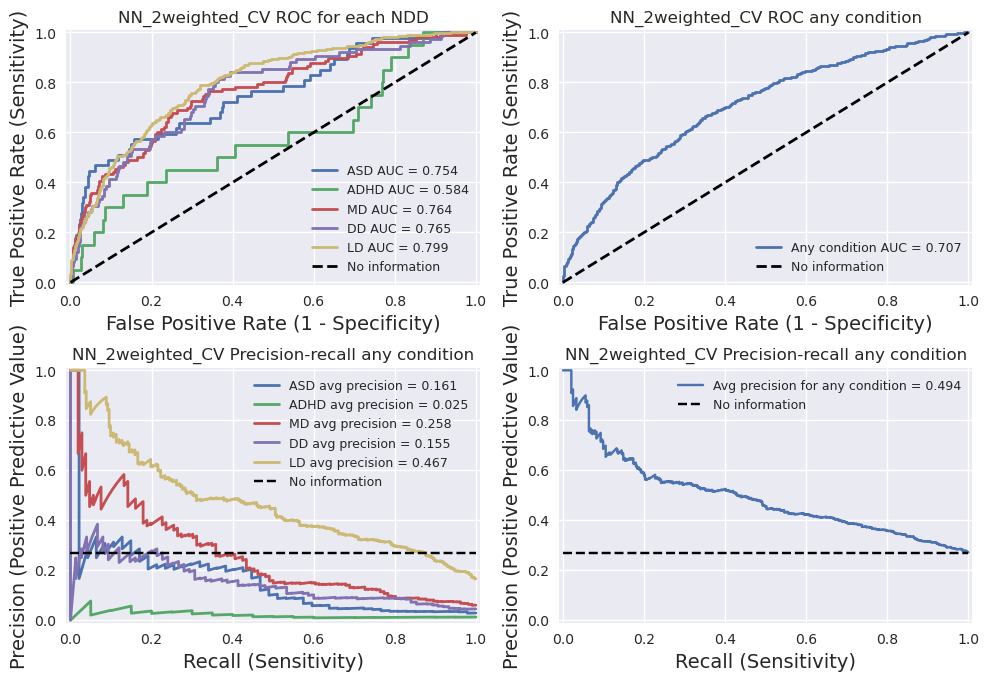

MTLnet(
  (flatten): Flatten(start_dim=1, end_dim=-1)
  (linear_sigmoid_stack): Sequential(
    (0): Linear(in_features=560, out_features=100, bias=True)
    (1): ReLU()
    (2): Linear(in_features=100, out_features=6, bias=True)
  )
)
Dataset dimensions are (12960, 560) (12960, 6) (3240, 560) (3240, 6) (1800, 560) (1800, 6)


Training Epochs:   0%|          | 0/400 [00:00<?, ?it/s]

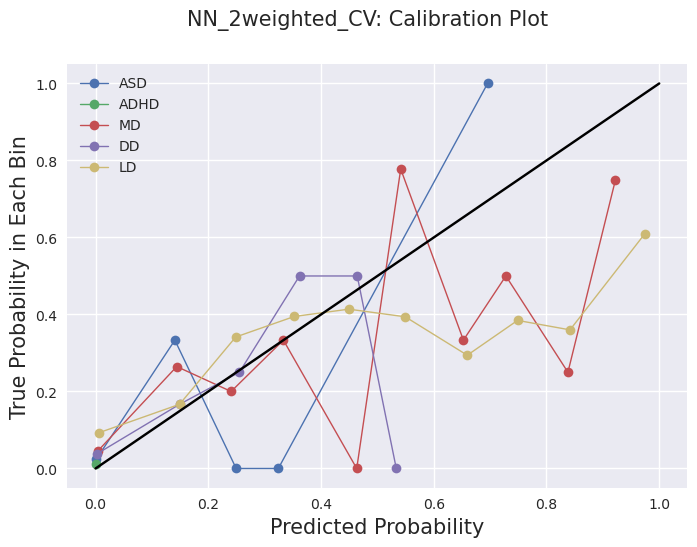

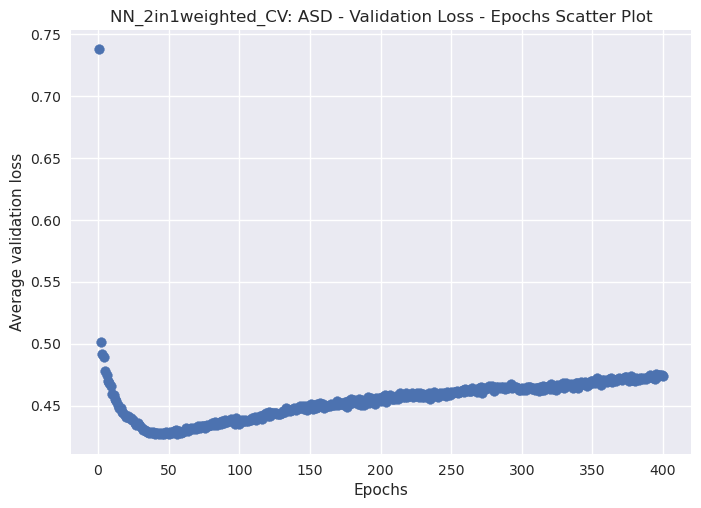

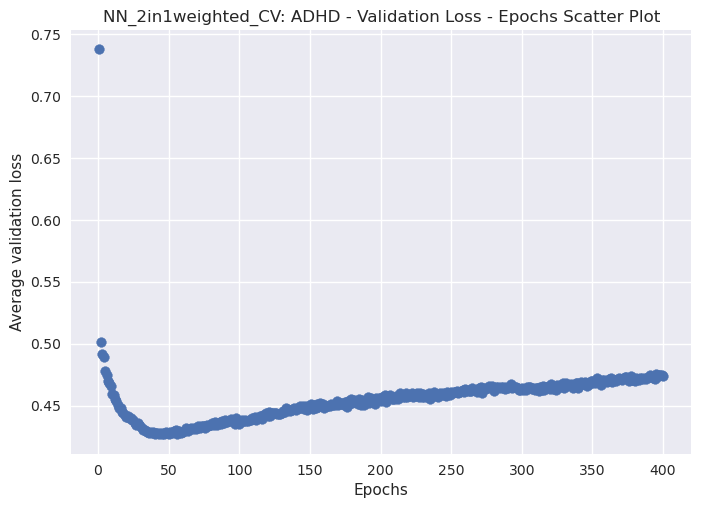

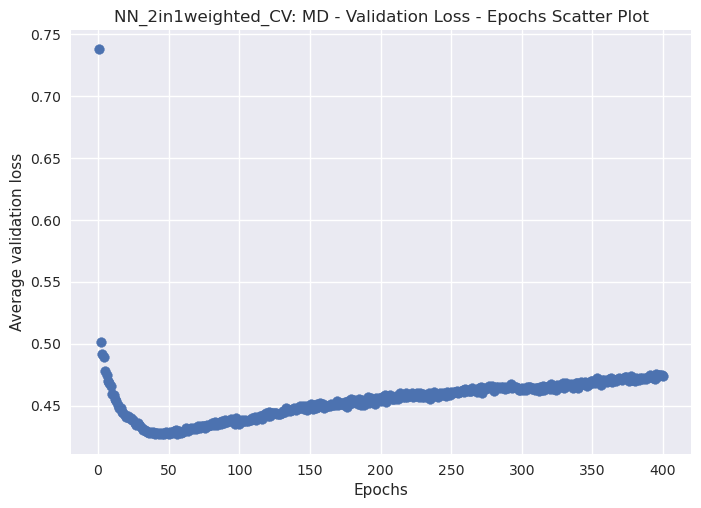

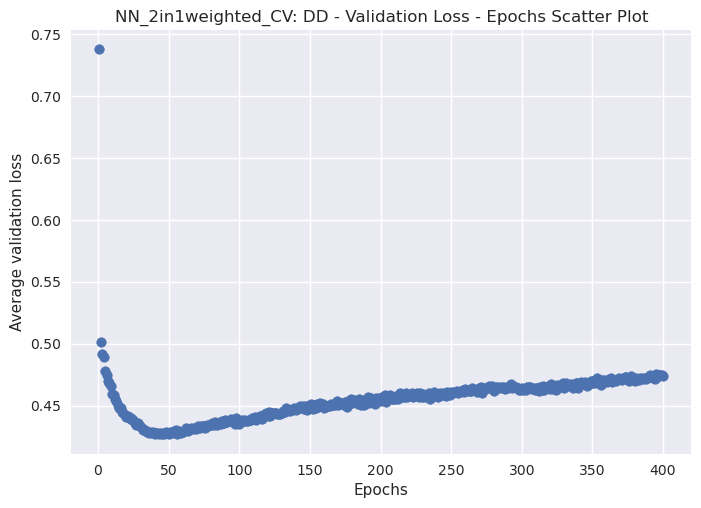

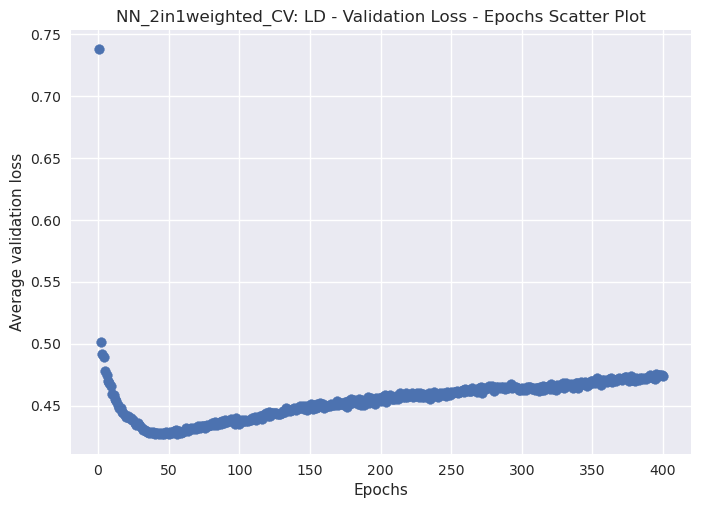

0.4266222417354584
['ASD', 'ADHD', 'MD', 'DD', 'LD']


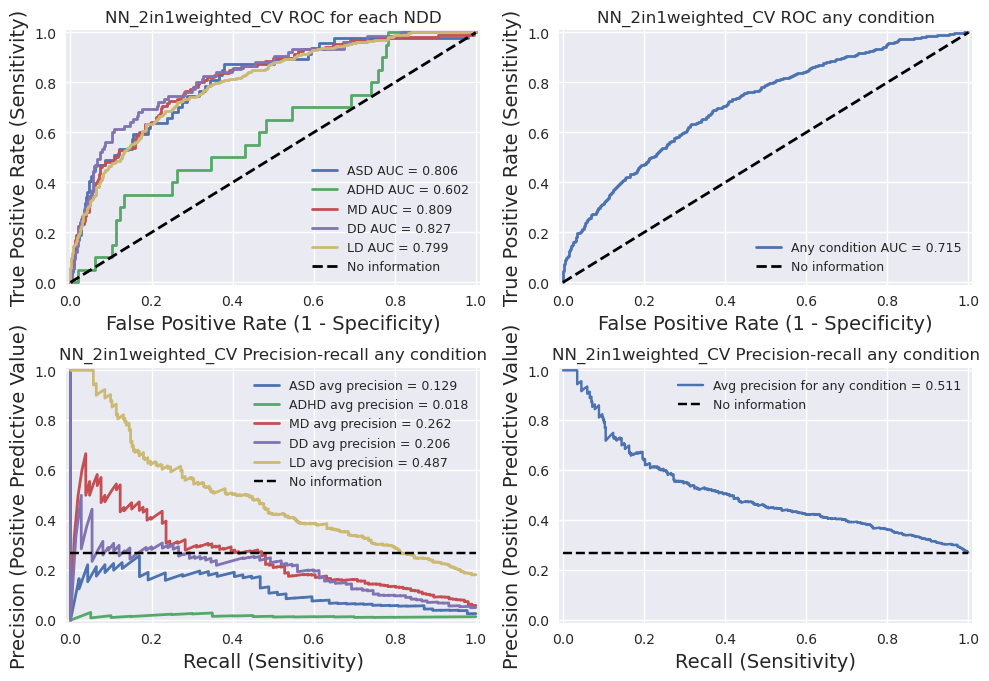

Dataset dimensions are (12960, 560) (12960, 1) (3240, 560) (3240, 1) (1800, 560) (1800, 1)


Training Epochs:   0%|          | 0/400 [00:00<?, ?it/s]

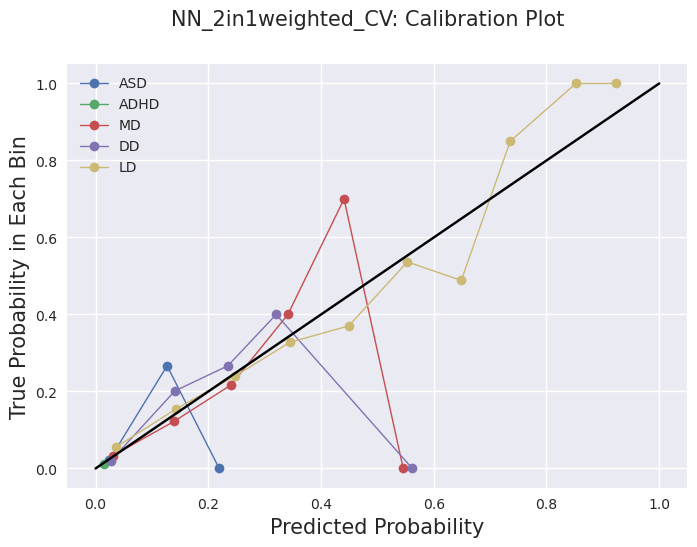

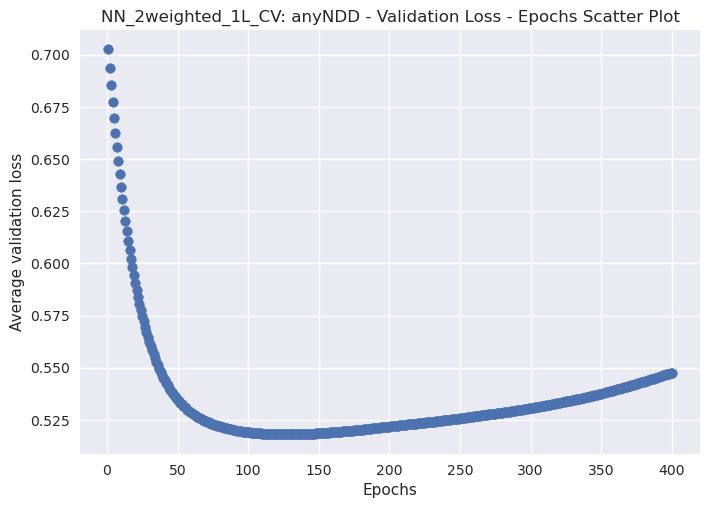

['anyNDD']


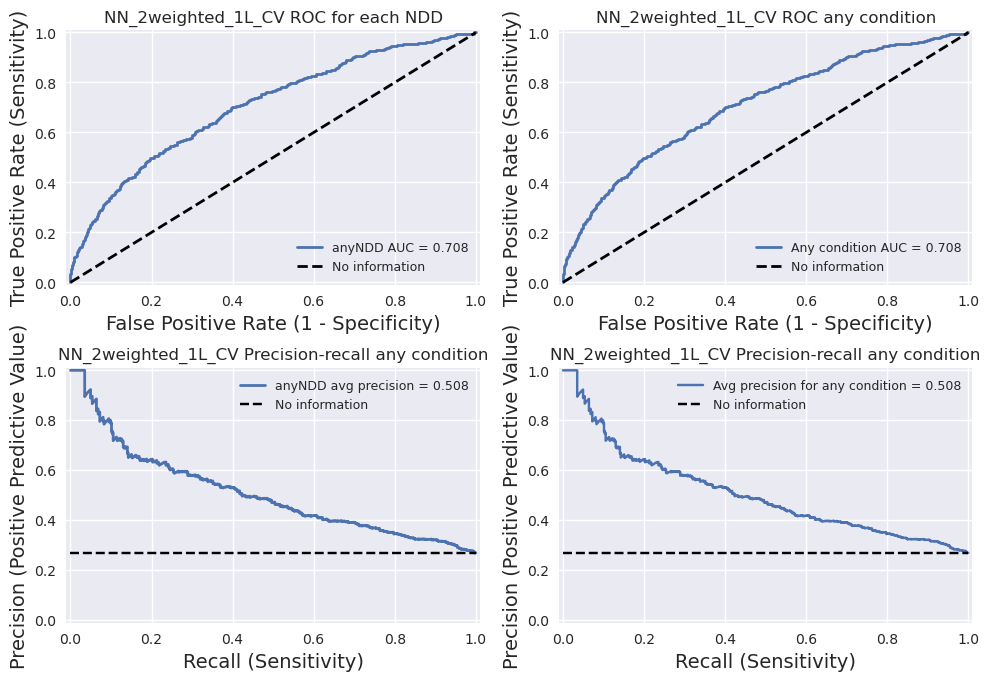

['anyNDD']


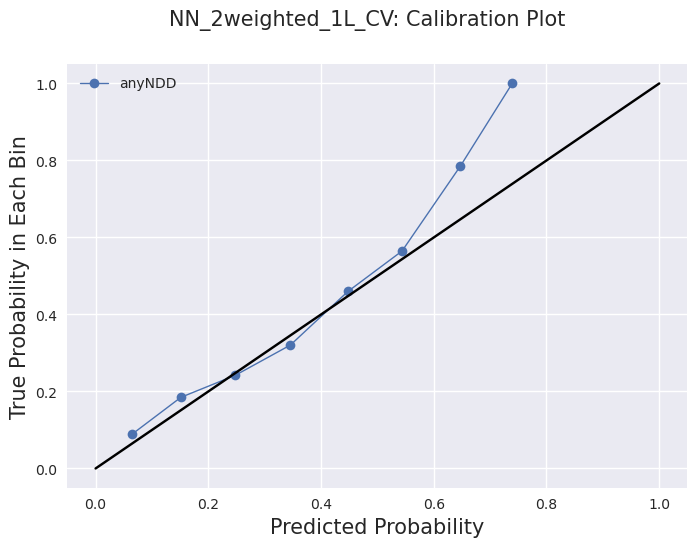

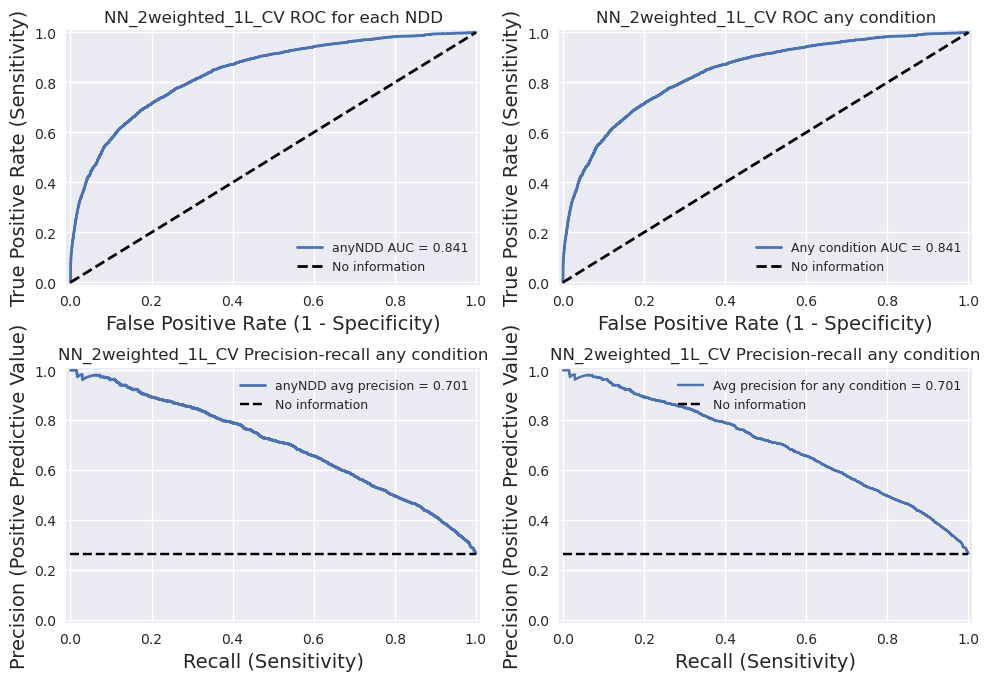

['anyNDD']


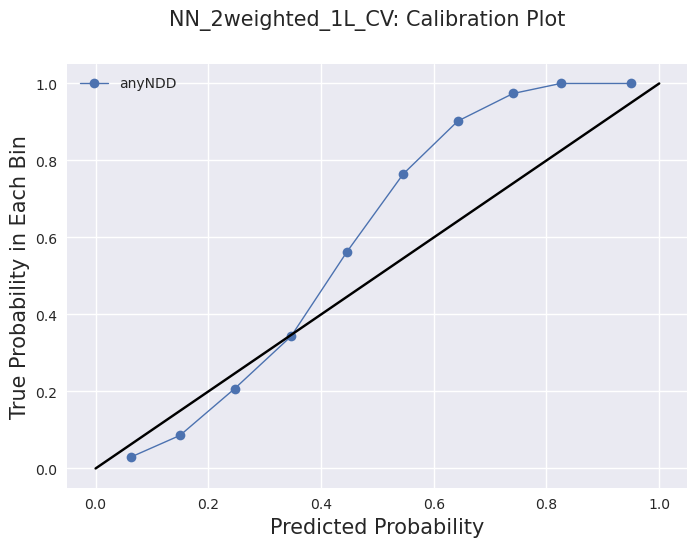

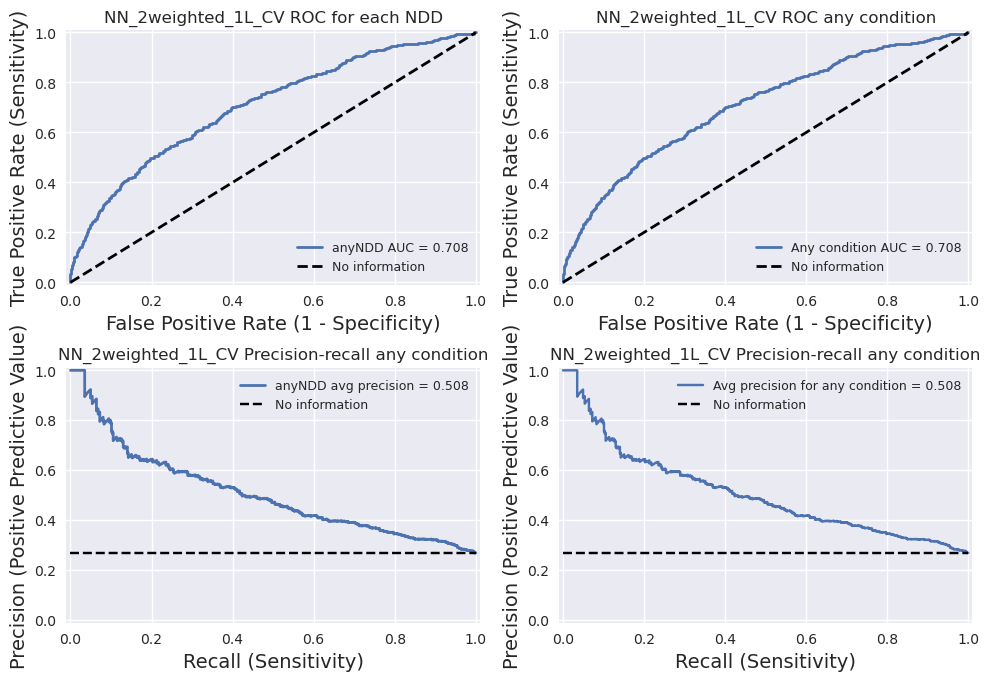

Dataset dimensions are (12960, 560) (12960, 1) (3240, 560) (3240, 1) (1800, 560) (1800, 1)


Training Epochs:   0%|          | 0/400 [00:00<?, ?it/s]

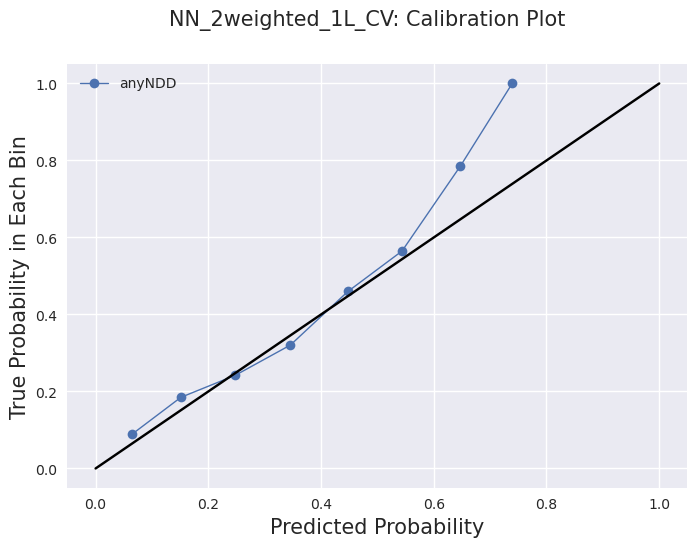

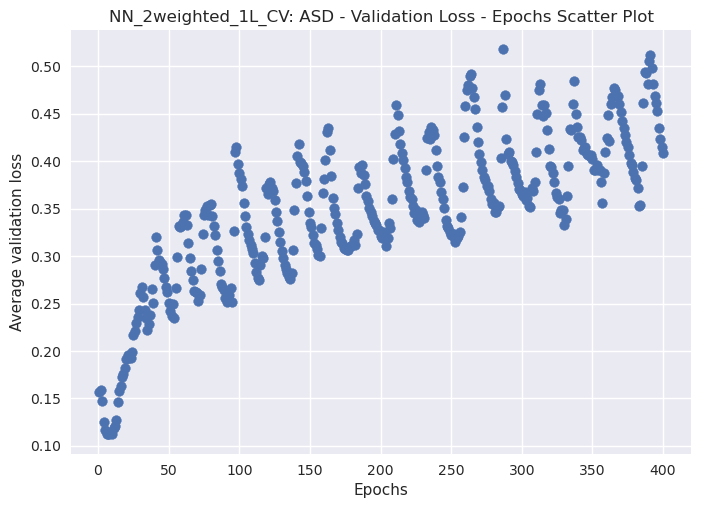

0.11194507777690887
['ASD']


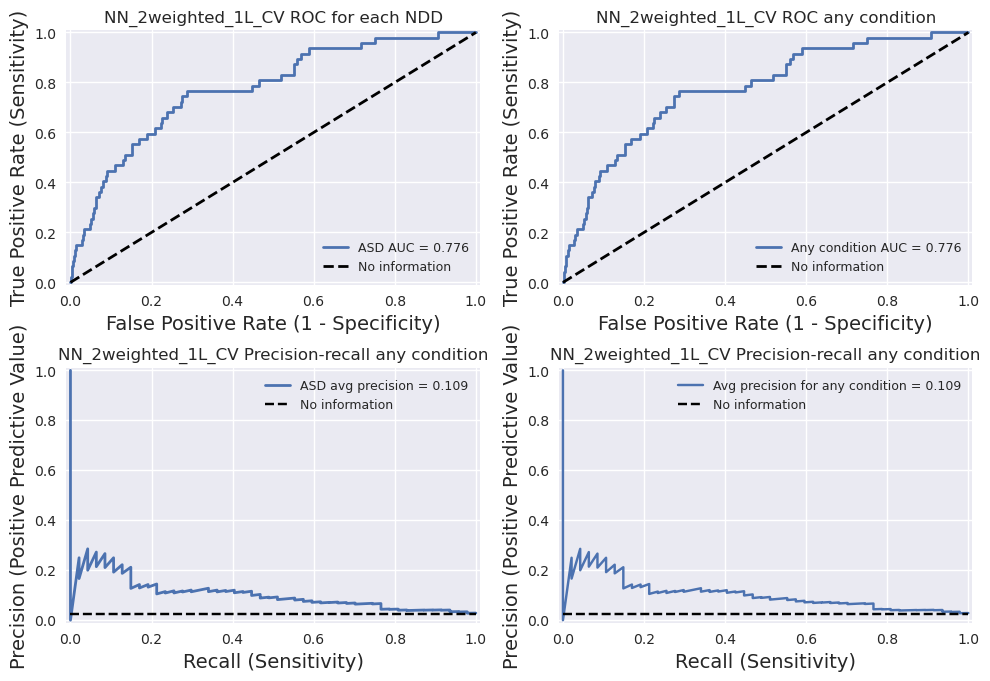

MTLnet(
  (flatten): Flatten(start_dim=1, end_dim=-1)
  (linear_sigmoid_stack): Sequential(
    (0): Linear(in_features=560, out_features=100, bias=True)
    (1): ReLU()
    (2): Linear(in_features=100, out_features=2, bias=True)
  )
)
Dataset dimensions are (12960, 560) (12960, 2) (3240, 560) (3240, 2) (1800, 560) (1800, 2)


Training Epochs:   0%|          | 0/400 [00:00<?, ?it/s]

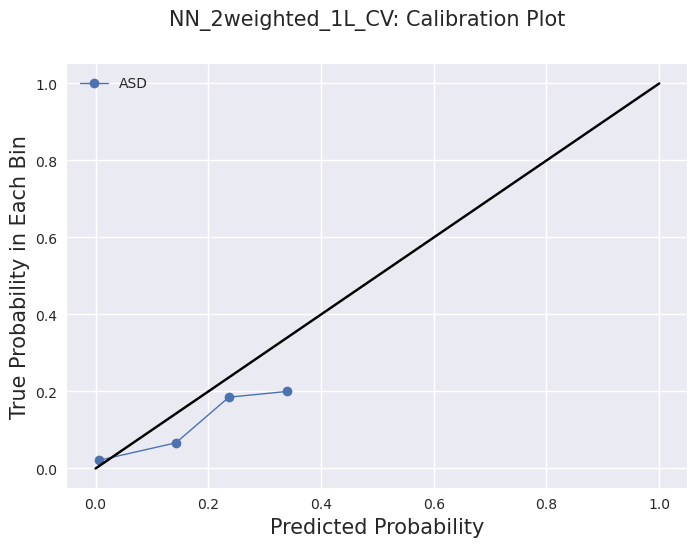

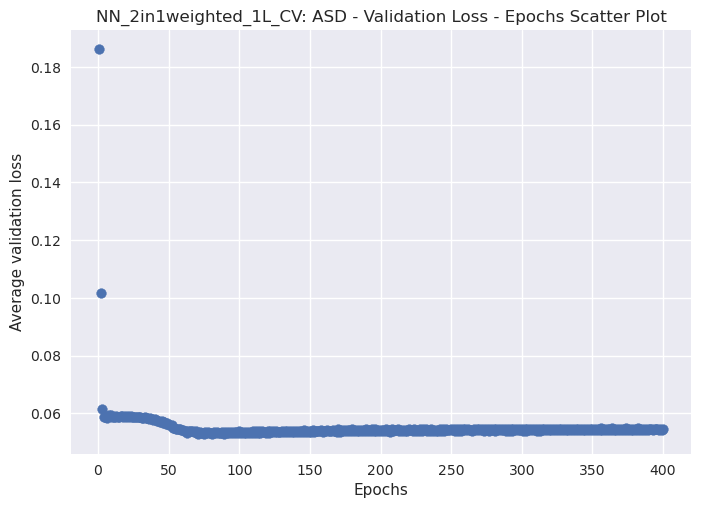

0.052710384130477905
['ASD']


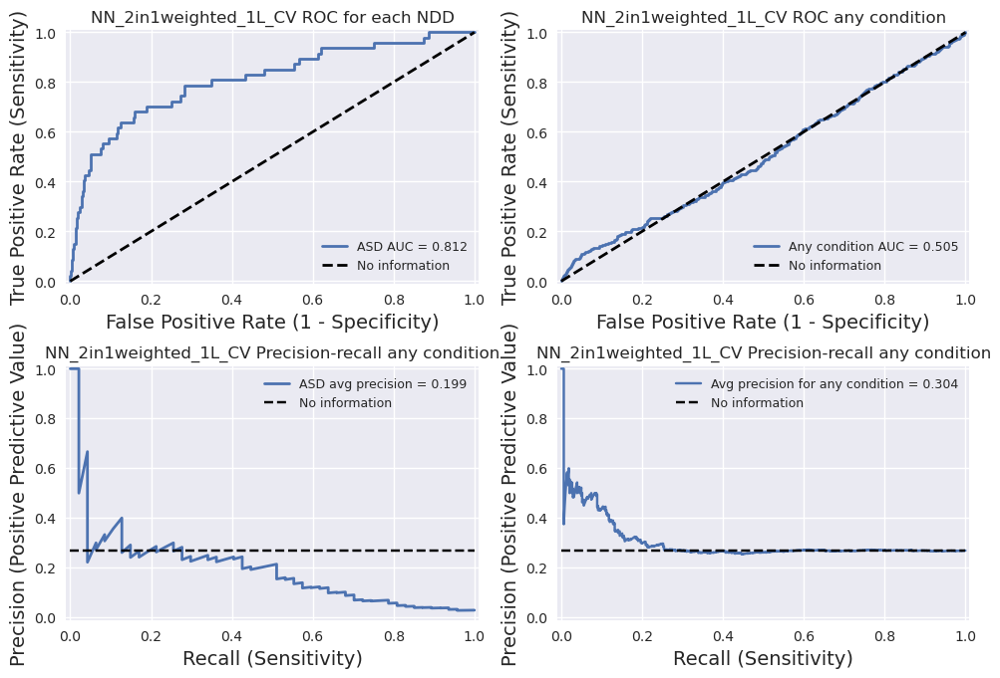

Fold 8/10
Dataset dimensions are (12960, 560) (12960, 1) (3240, 560) (3240, 1) (1800, 560) (1800, 1)



A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


Training Epochs:   0%|          | 0/200 [00:00<?, ?it/s]

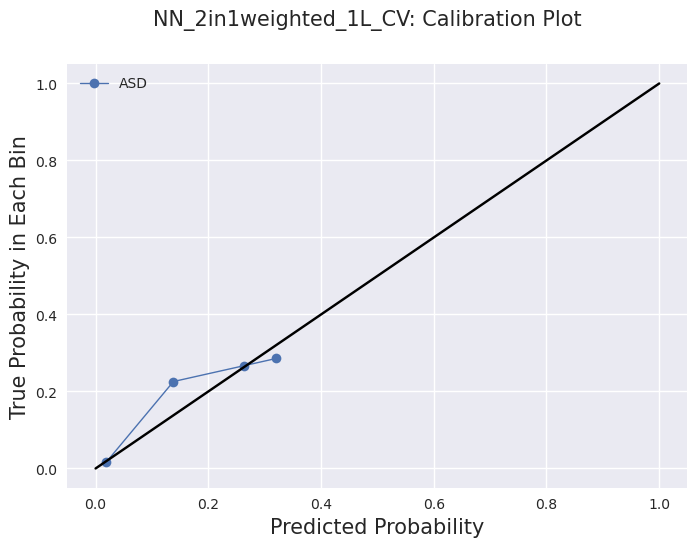

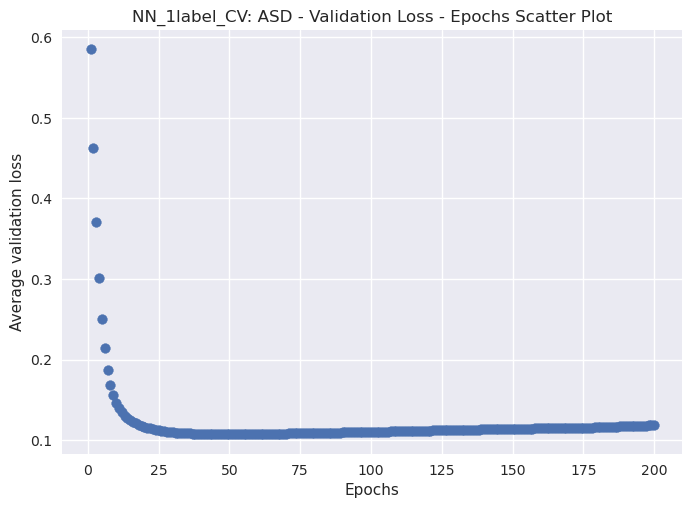

0.1070721186697483
['ASD']


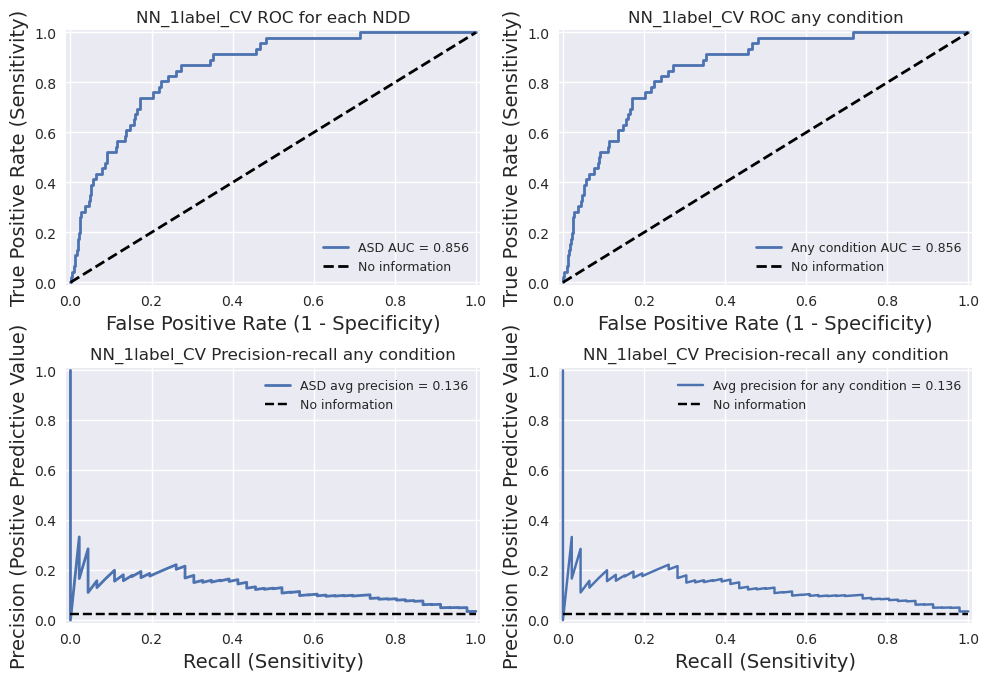

Dataset dimensions are (12960, 560) (12960, 5) (3240, 560) (3240, 5) (1800, 560) (1800, 5)


Training Epochs:   0%|          | 0/400 [00:00<?, ?it/s]

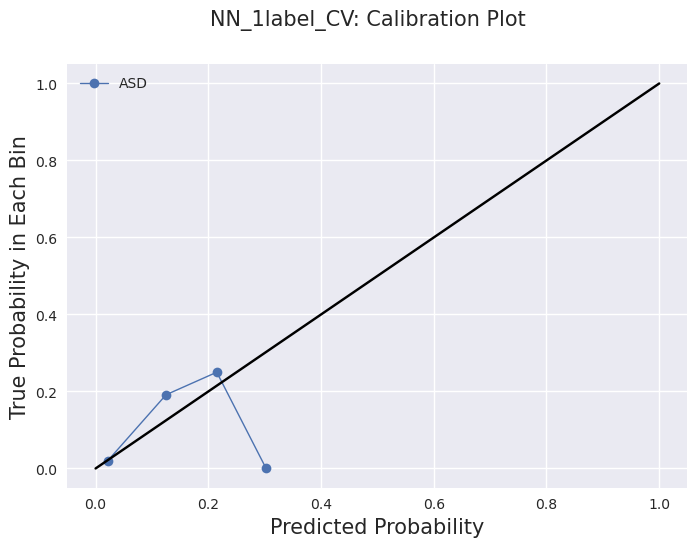

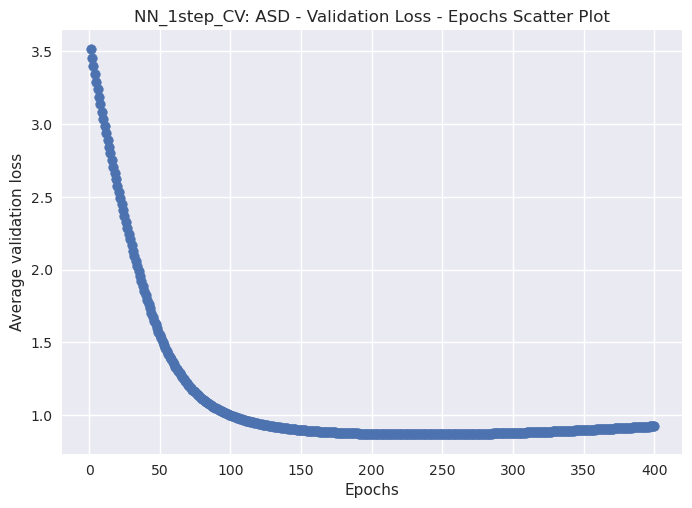

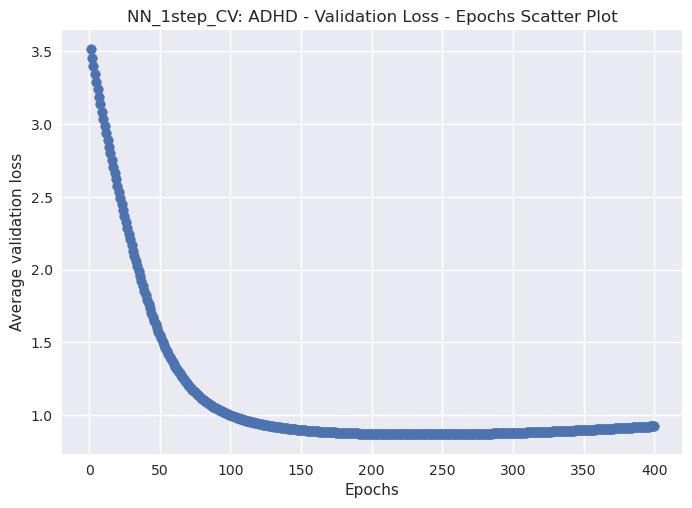

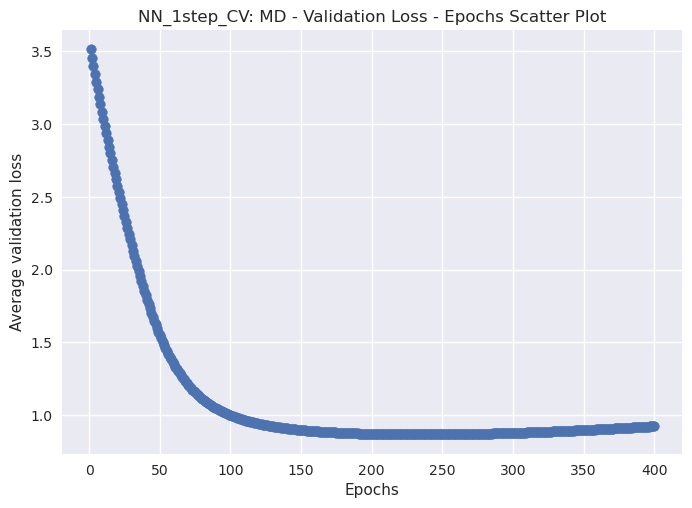

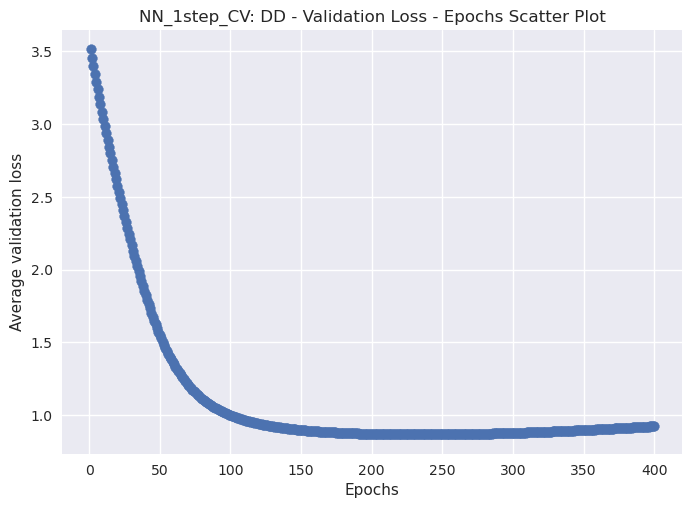

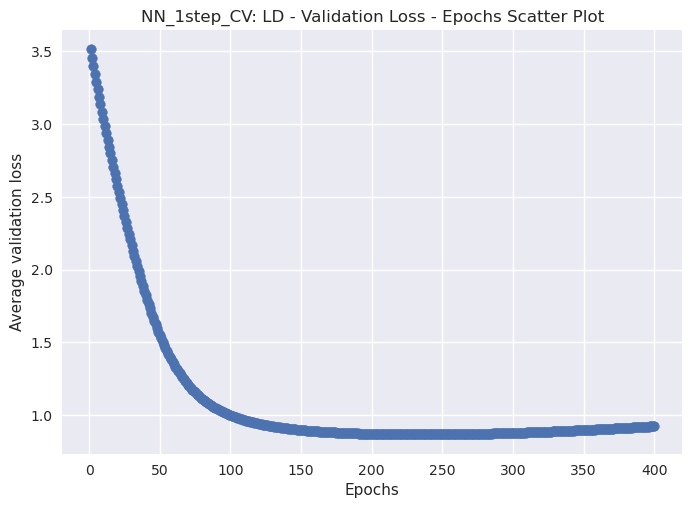

0.8667708039283752
['ASD', 'ADHD', 'MD', 'DD', 'LD']


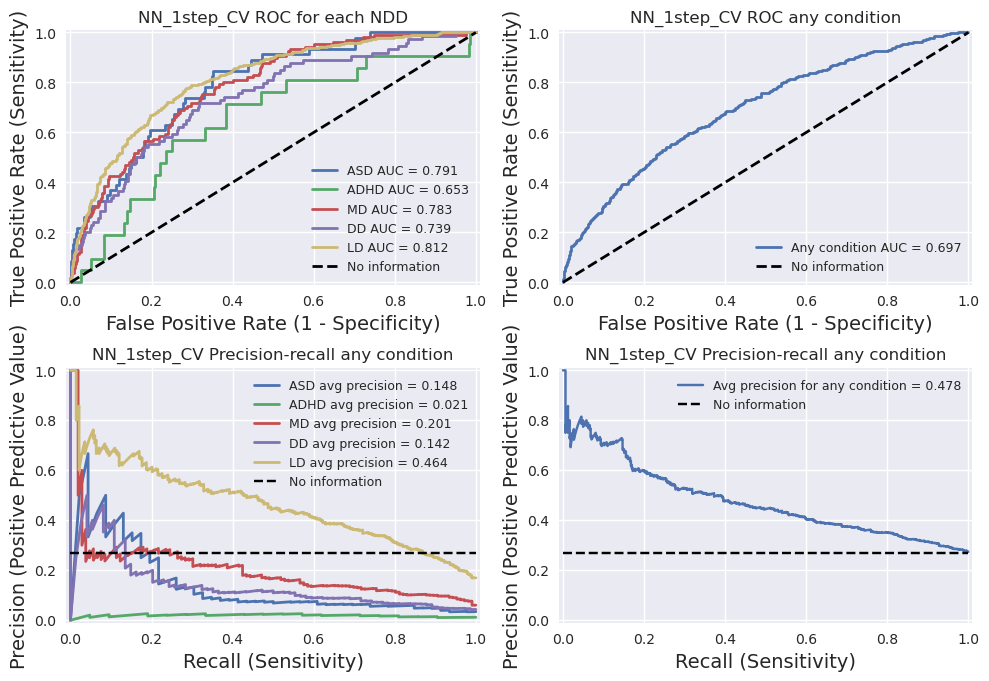

MTLnet(
  (flatten): Flatten(start_dim=1, end_dim=-1)
  (linear_sigmoid_stack): Sequential(
    (0): Linear(in_features=560, out_features=100, bias=True)
    (1): ReLU()
    (2): Linear(in_features=100, out_features=1, bias=True)
  )
)
MTLnet(
  (flatten): Flatten(start_dim=1, end_dim=-1)
  (linear_sigmoid_stack): Sequential(
    (0): Linear(in_features=560, out_features=100, bias=True)
    (1): ReLU()
    (2): Linear(in_features=100, out_features=5, bias=True)
  )
)
Dataset dimensions are (12960, 560) (12960, 1) (3240, 560) (3240, 1) (1800, 560) (1800, 1)


Training Epochs:   0%|          | 0/400 [00:00<?, ?it/s]

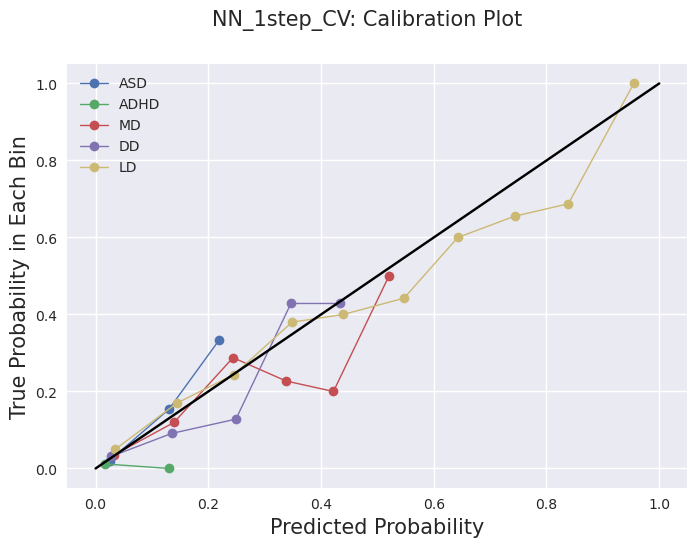

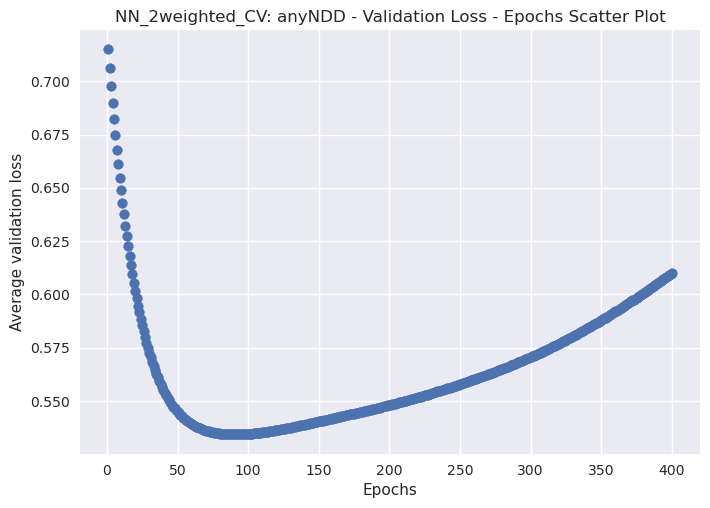

['anyNDD']


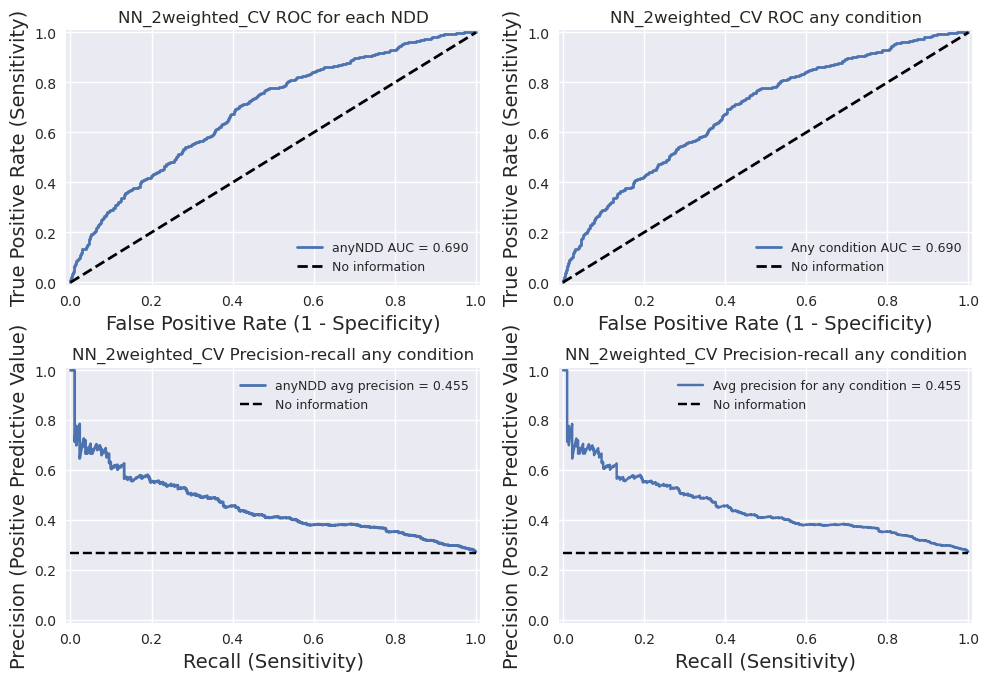

['anyNDD']


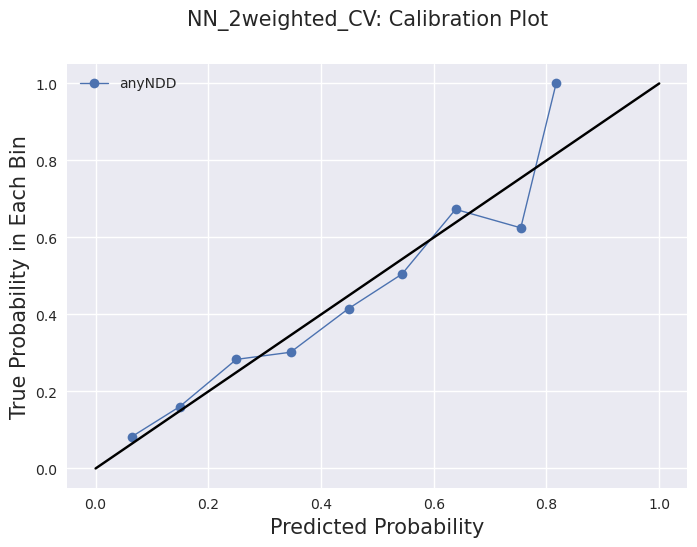

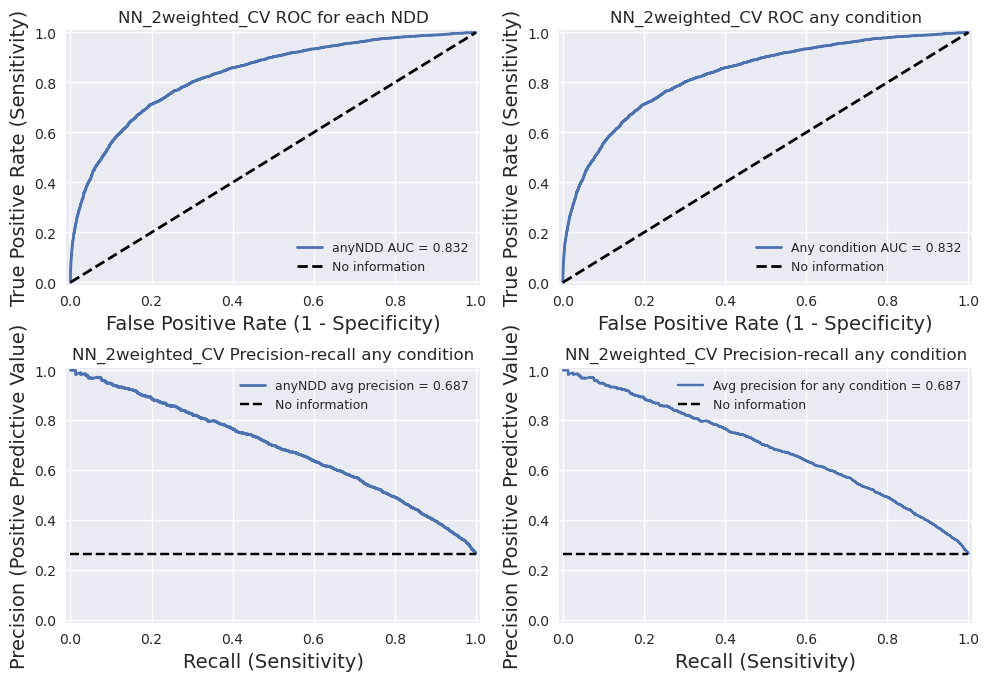

['anyNDD']


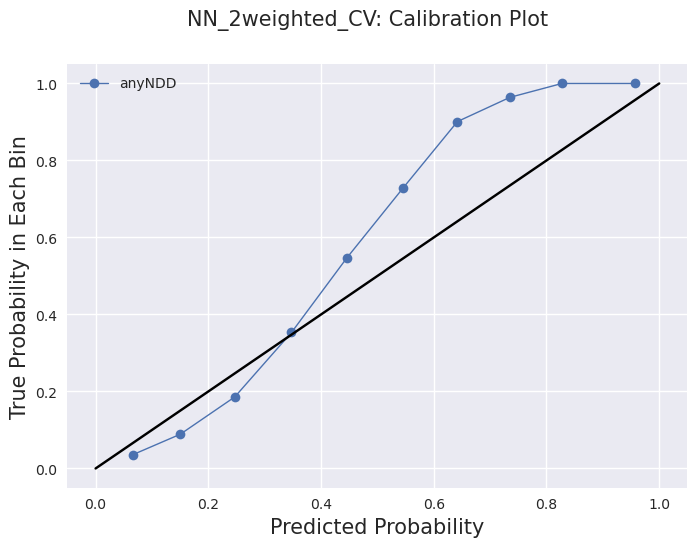

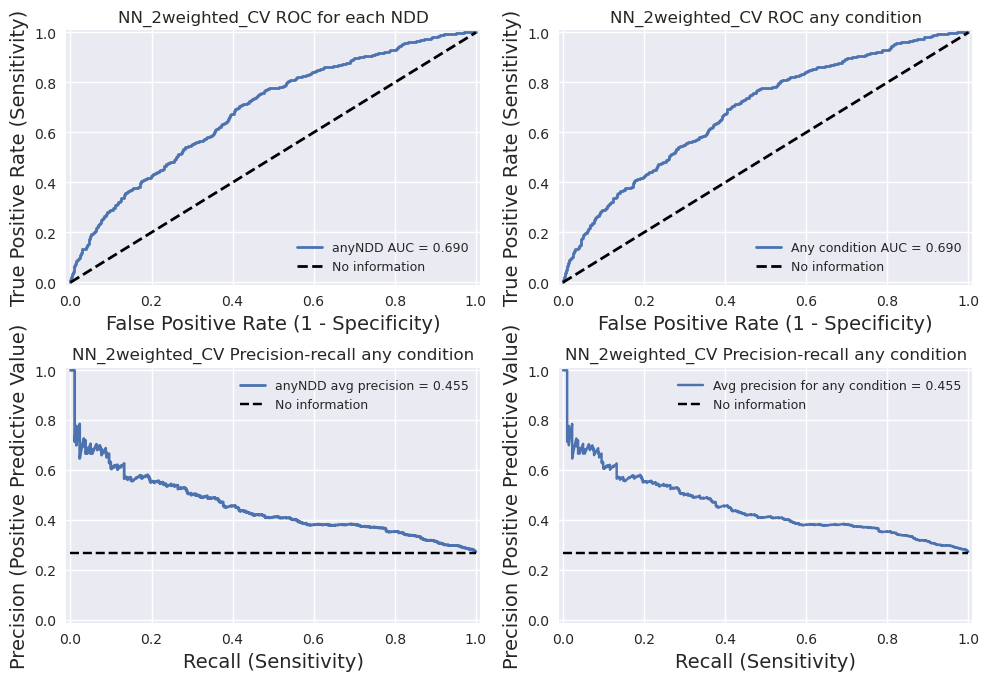

Dataset dimensions are (12960, 560) (12960, 5) (3240, 560) (3240, 5) (1800, 560) (1800, 5)


Training Epochs:   0%|          | 0/800 [00:00<?, ?it/s]

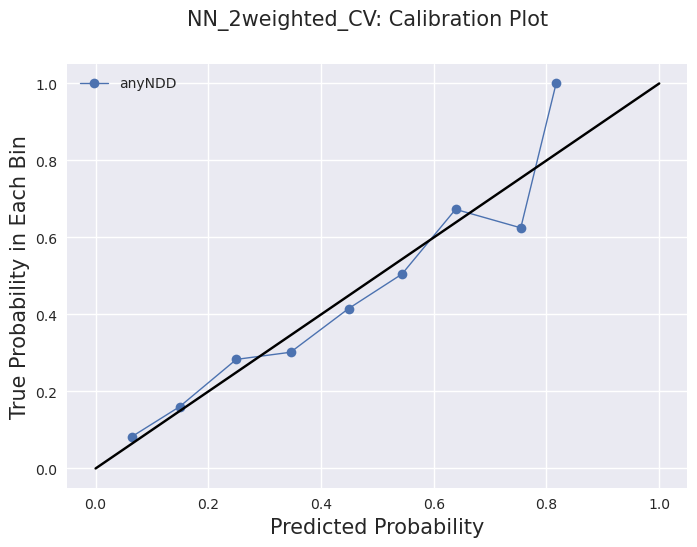

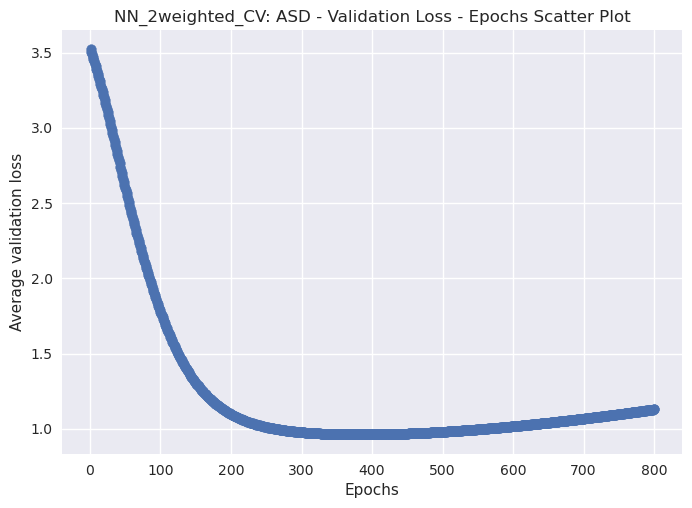

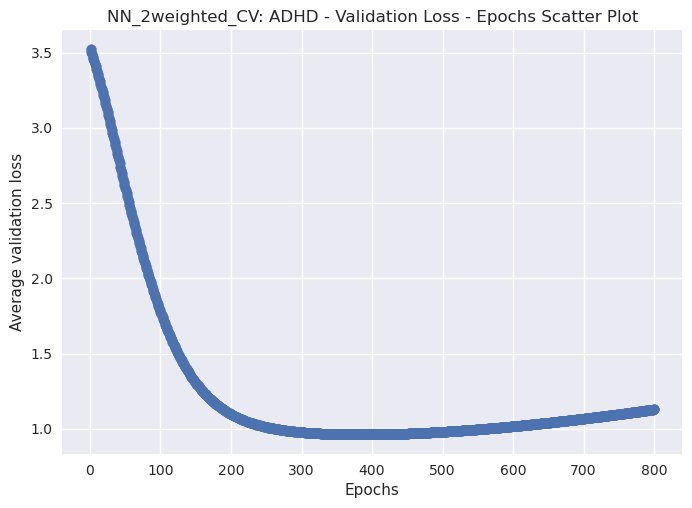

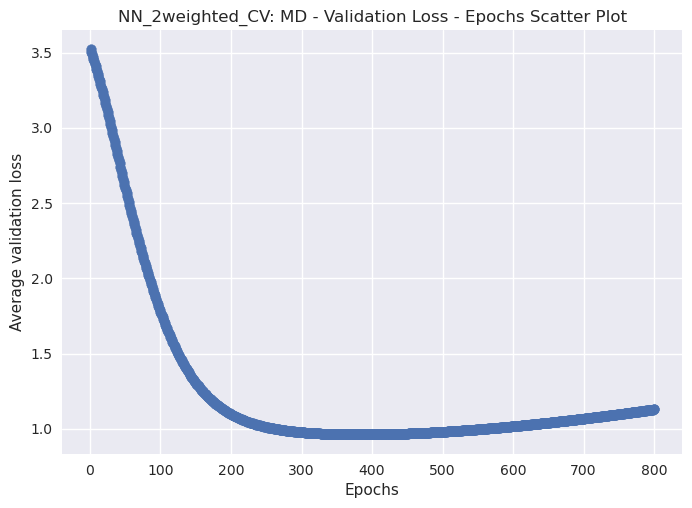

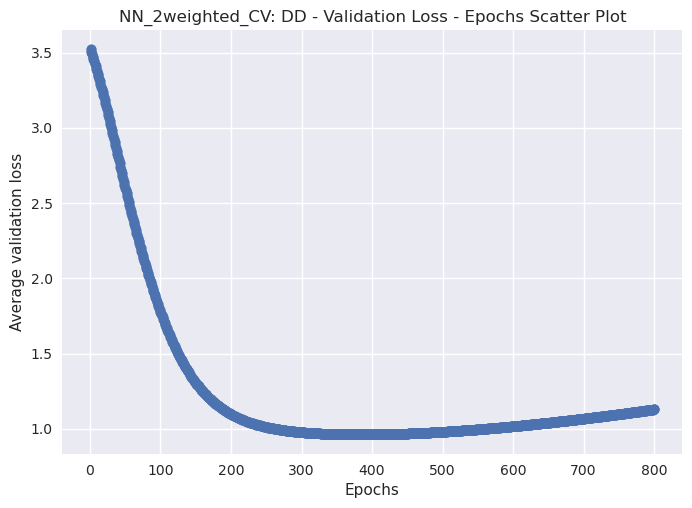

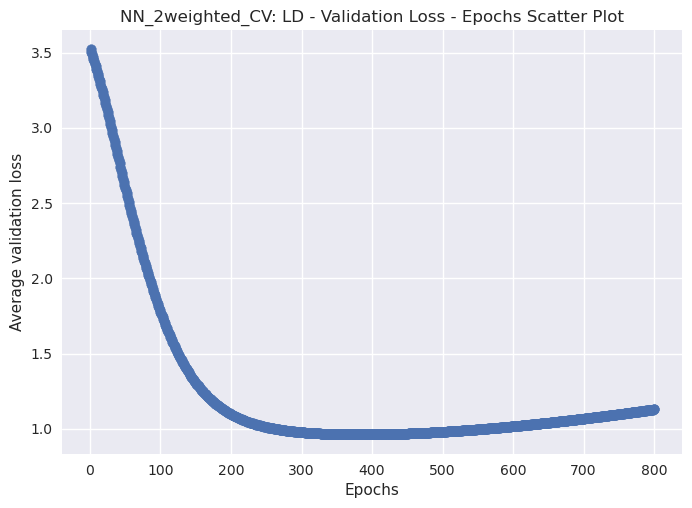

0.9624835252761841
['ASD', 'ADHD', 'MD', 'DD', 'LD']


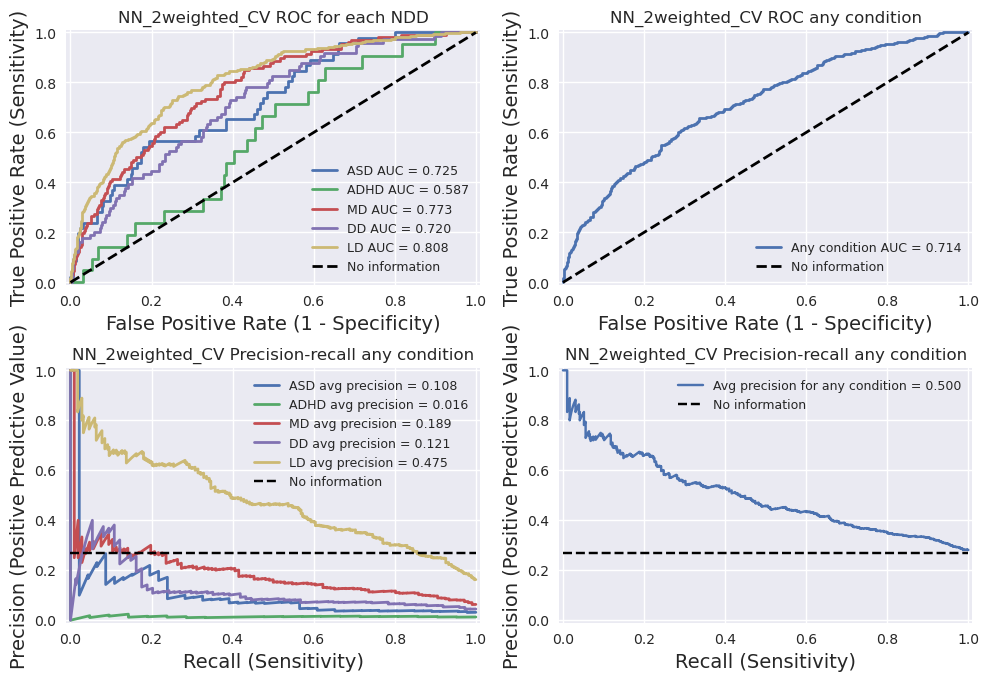

MTLnet(
  (flatten): Flatten(start_dim=1, end_dim=-1)
  (linear_sigmoid_stack): Sequential(
    (0): Linear(in_features=560, out_features=100, bias=True)
    (1): ReLU()
    (2): Linear(in_features=100, out_features=6, bias=True)
  )
)
Dataset dimensions are (12960, 560) (12960, 6) (3240, 560) (3240, 6) (1800, 560) (1800, 6)


Training Epochs:   0%|          | 0/400 [00:00<?, ?it/s]

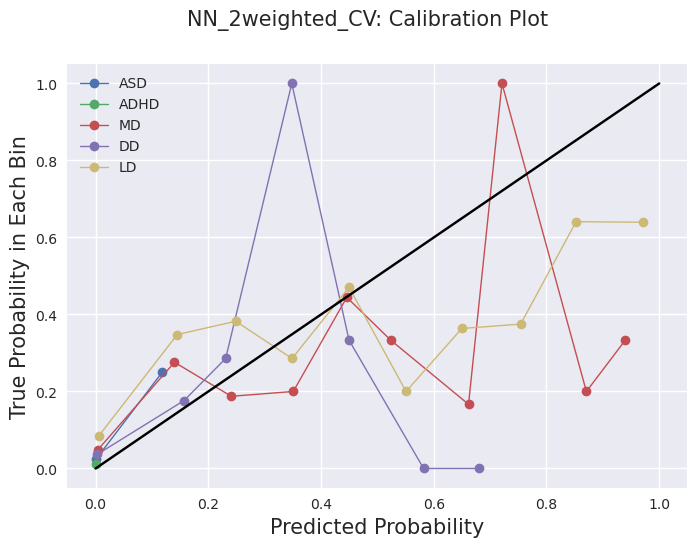

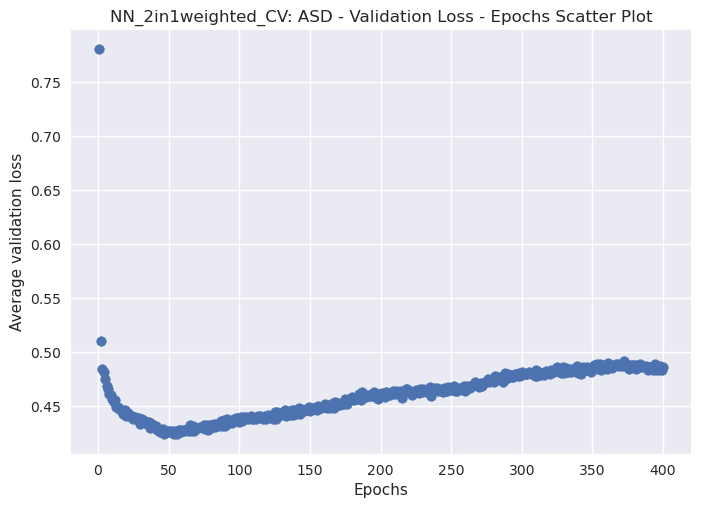

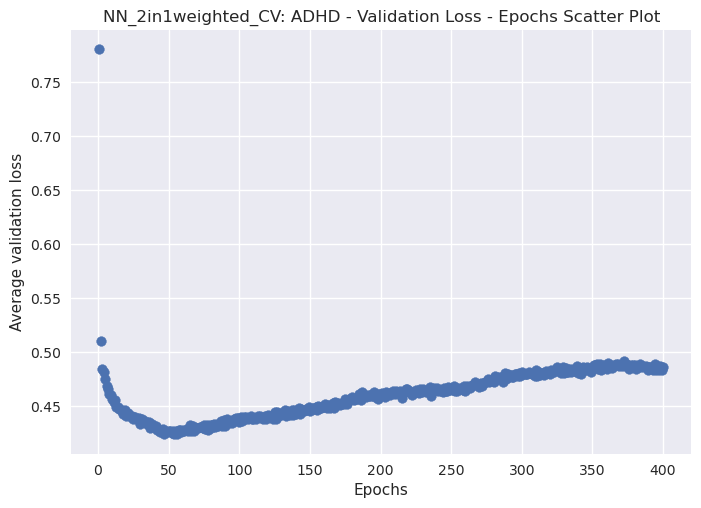

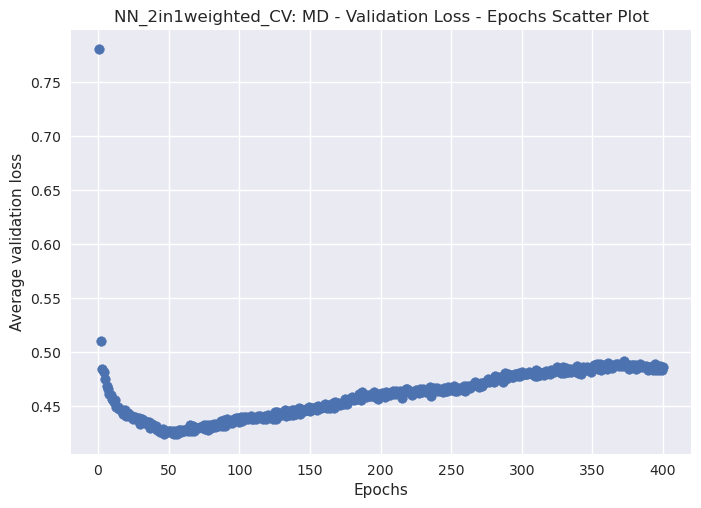

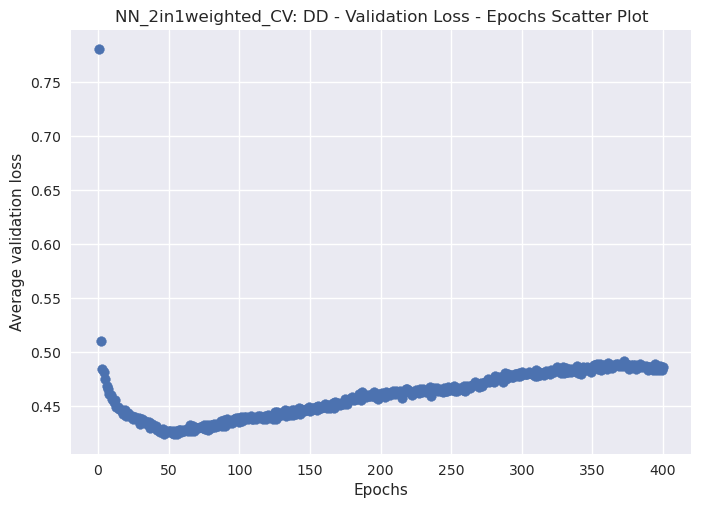

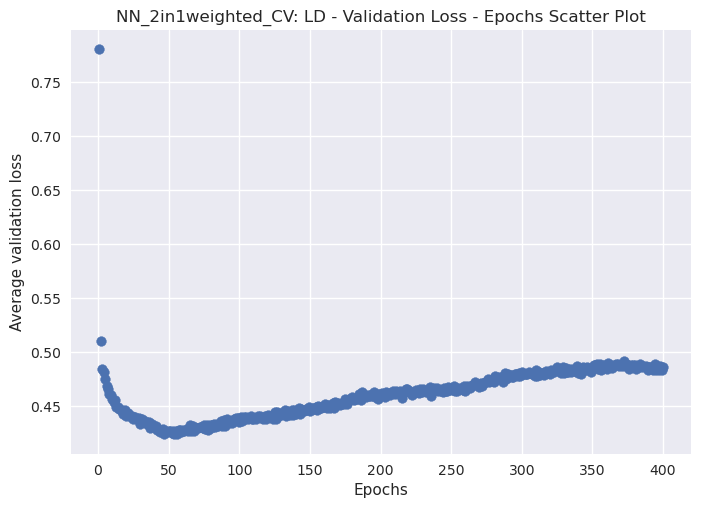

0.42408140003681183
['ASD', 'ADHD', 'MD', 'DD', 'LD']


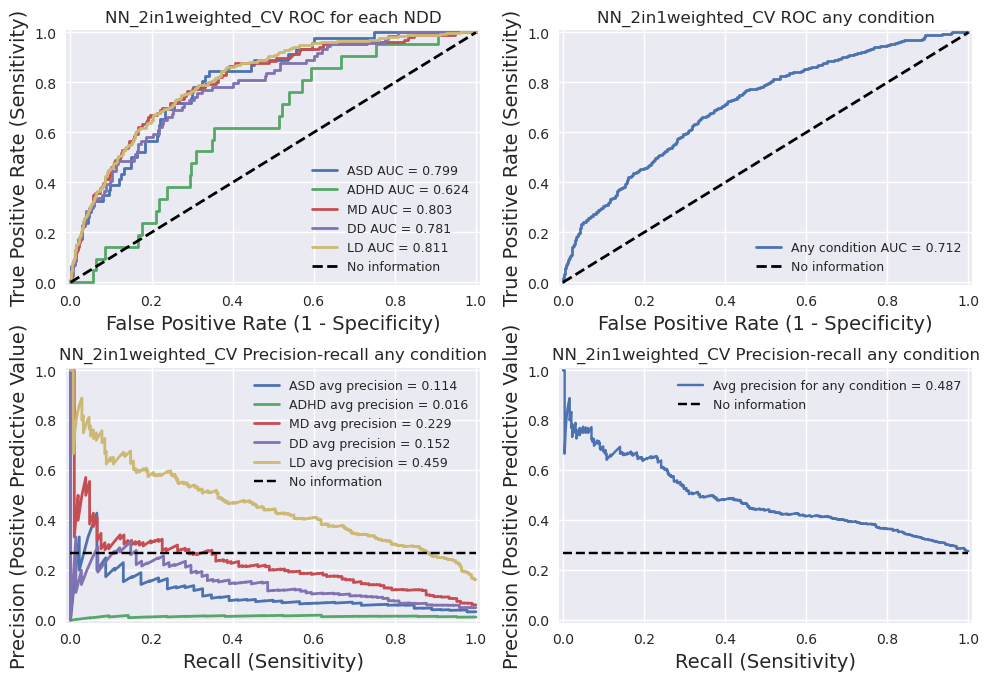

Dataset dimensions are (12960, 560) (12960, 1) (3240, 560) (3240, 1) (1800, 560) (1800, 1)


Training Epochs:   0%|          | 0/400 [00:00<?, ?it/s]

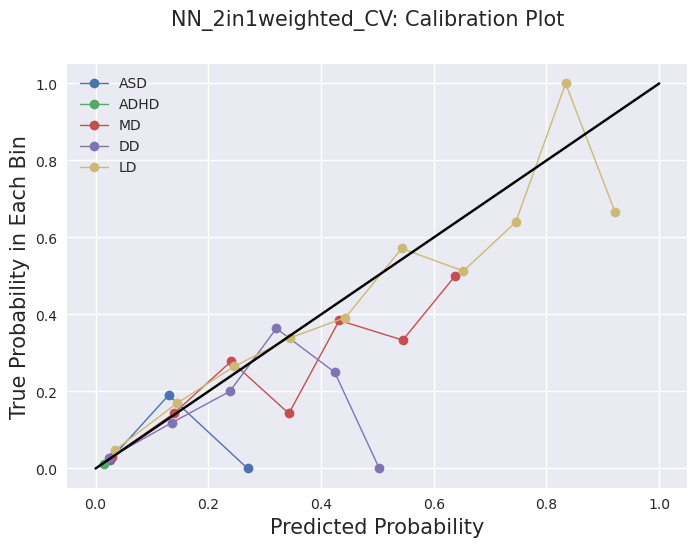

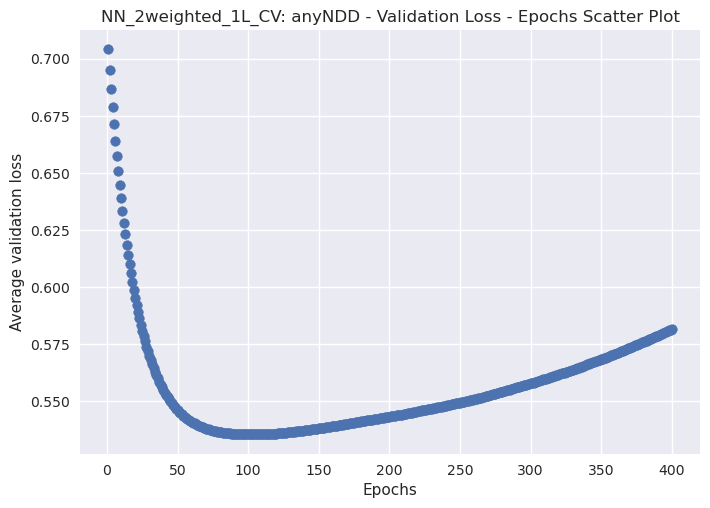

['anyNDD']


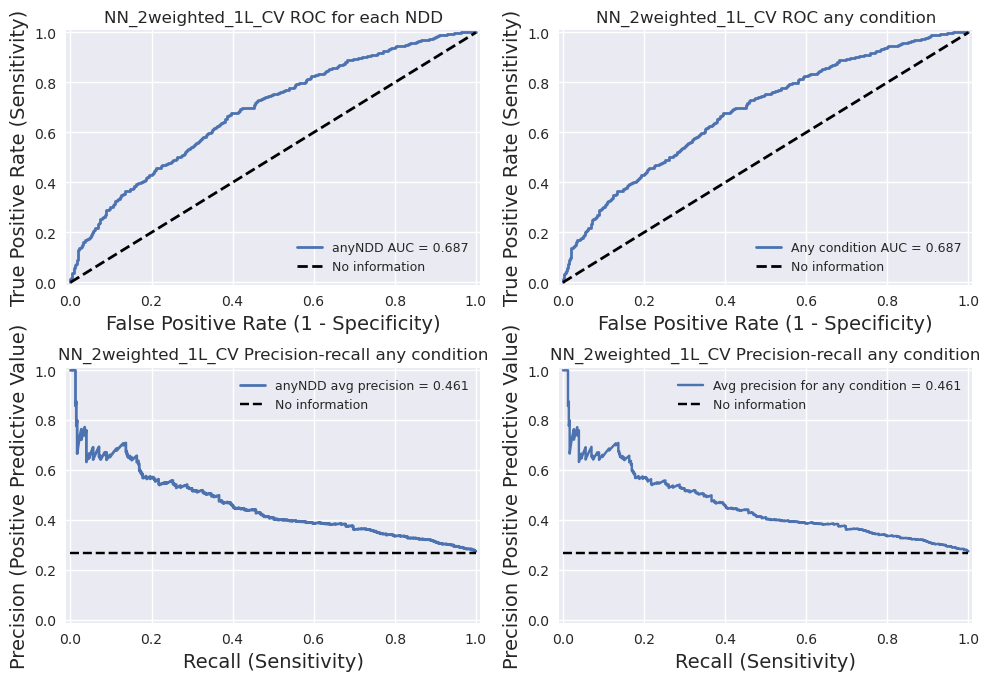

['anyNDD']


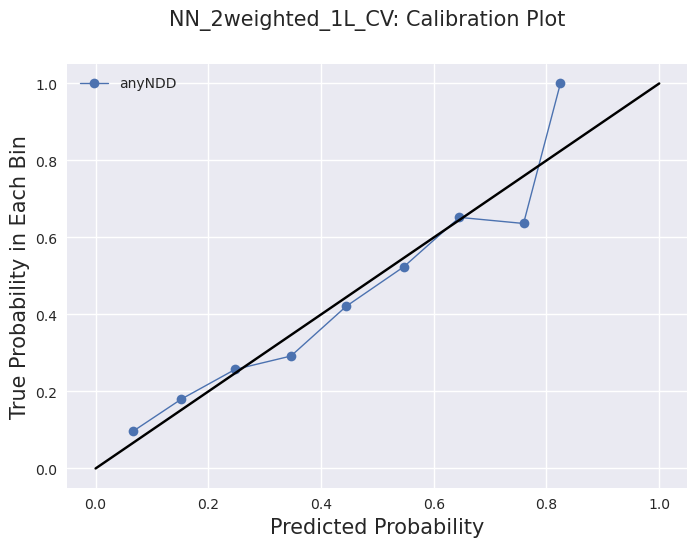

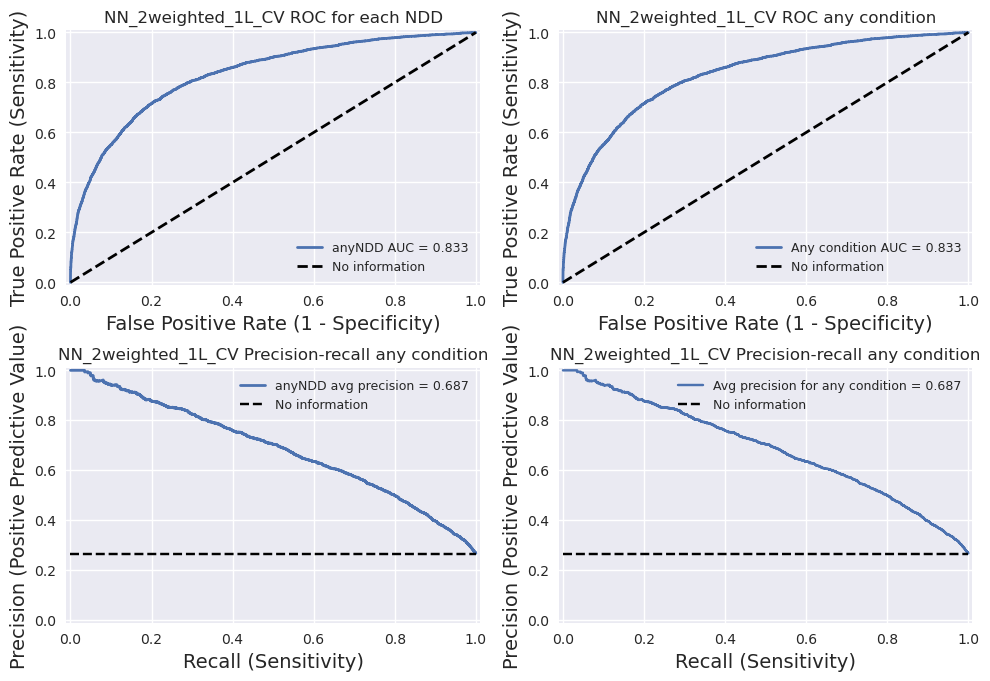

['anyNDD']


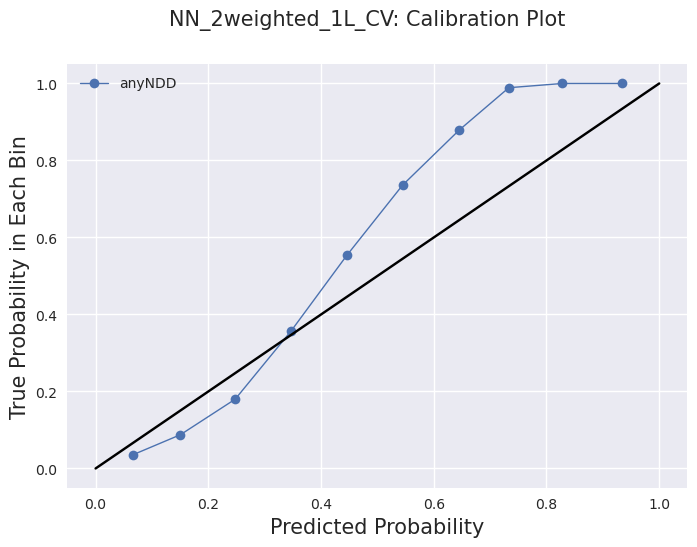

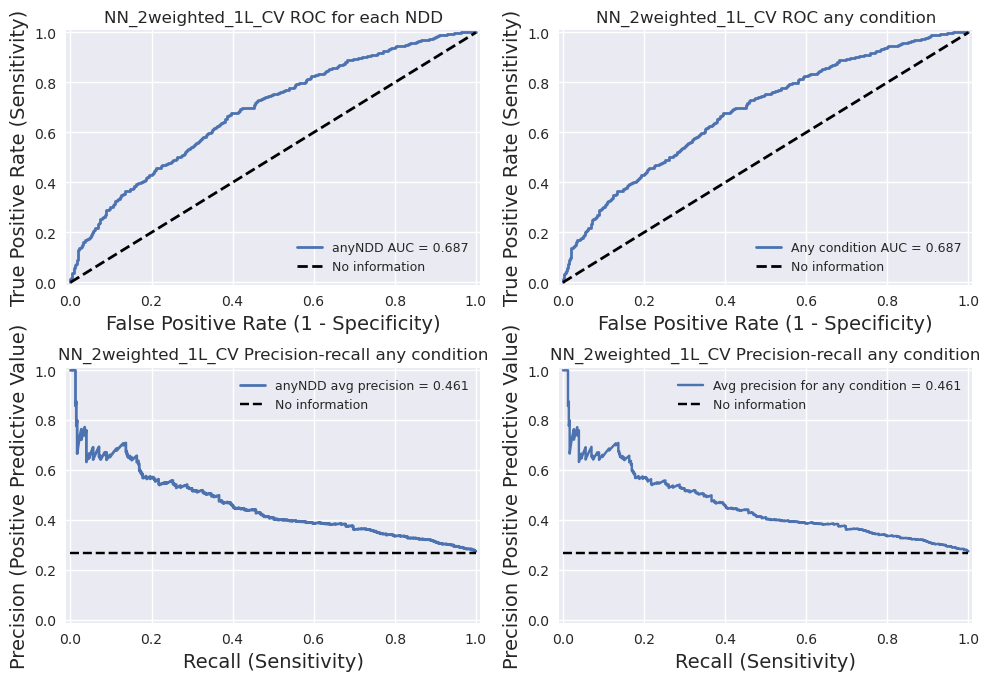

Dataset dimensions are (12960, 560) (12960, 1) (3240, 560) (3240, 1) (1800, 560) (1800, 1)


Training Epochs:   0%|          | 0/400 [00:00<?, ?it/s]

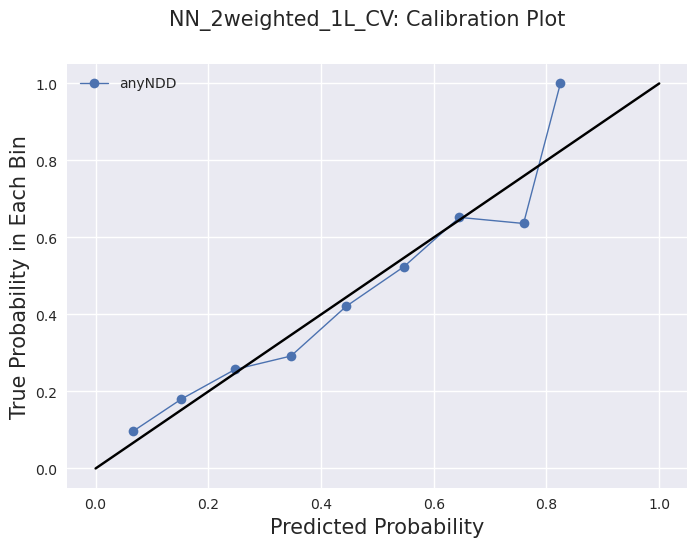

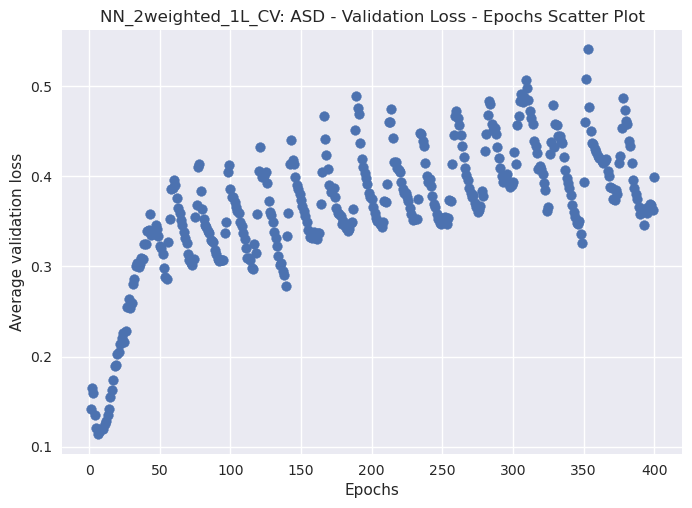

0.11358718574047089
['ASD']


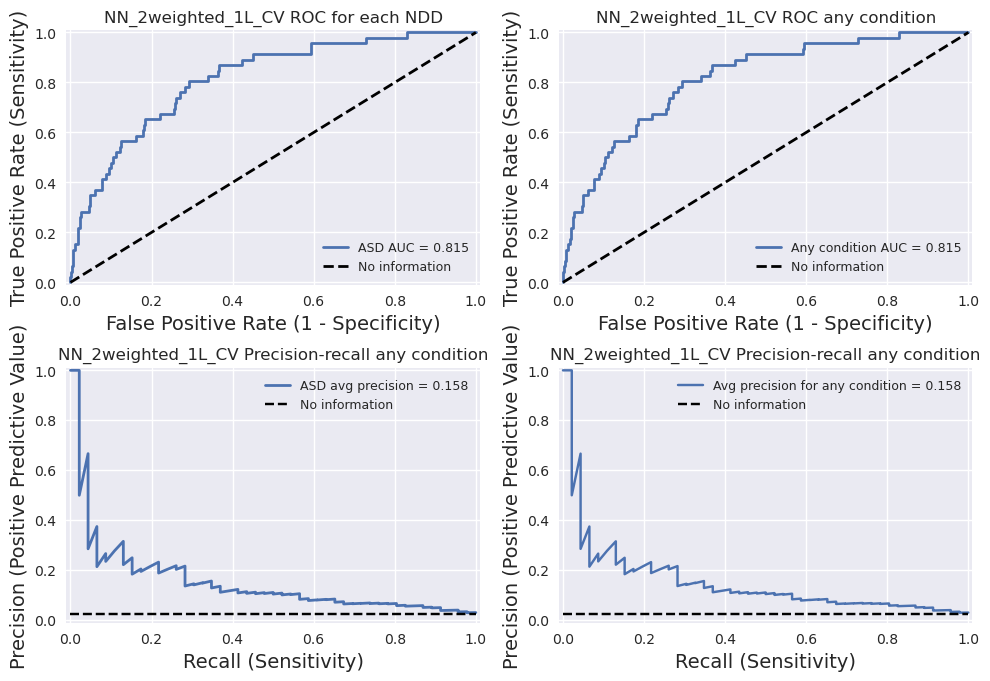

MTLnet(
  (flatten): Flatten(start_dim=1, end_dim=-1)
  (linear_sigmoid_stack): Sequential(
    (0): Linear(in_features=560, out_features=100, bias=True)
    (1): ReLU()
    (2): Linear(in_features=100, out_features=2, bias=True)
  )
)
Dataset dimensions are (12960, 560) (12960, 2) (3240, 560) (3240, 2) (1800, 560) (1800, 2)


Training Epochs:   0%|          | 0/400 [00:00<?, ?it/s]

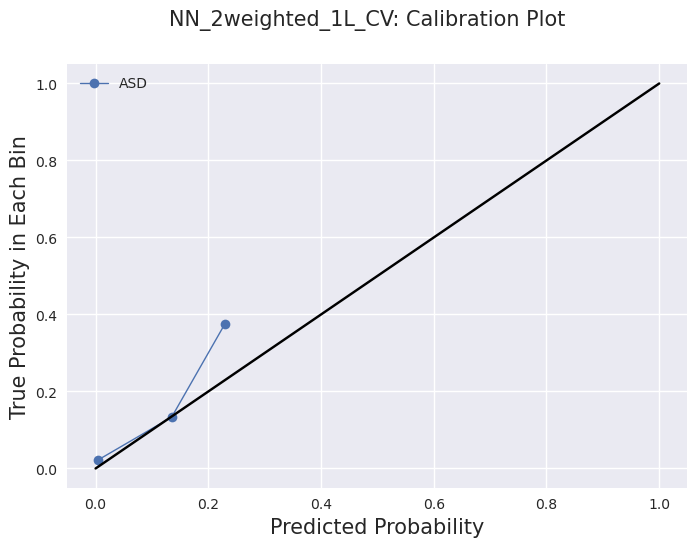

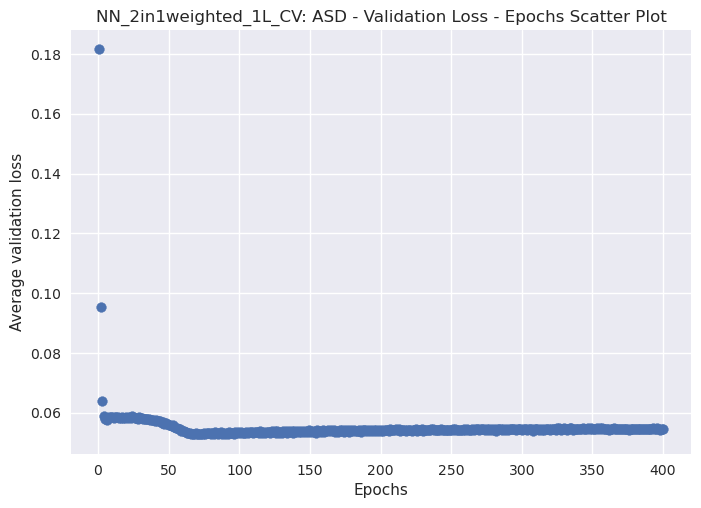

0.052735812962055206
['ASD']


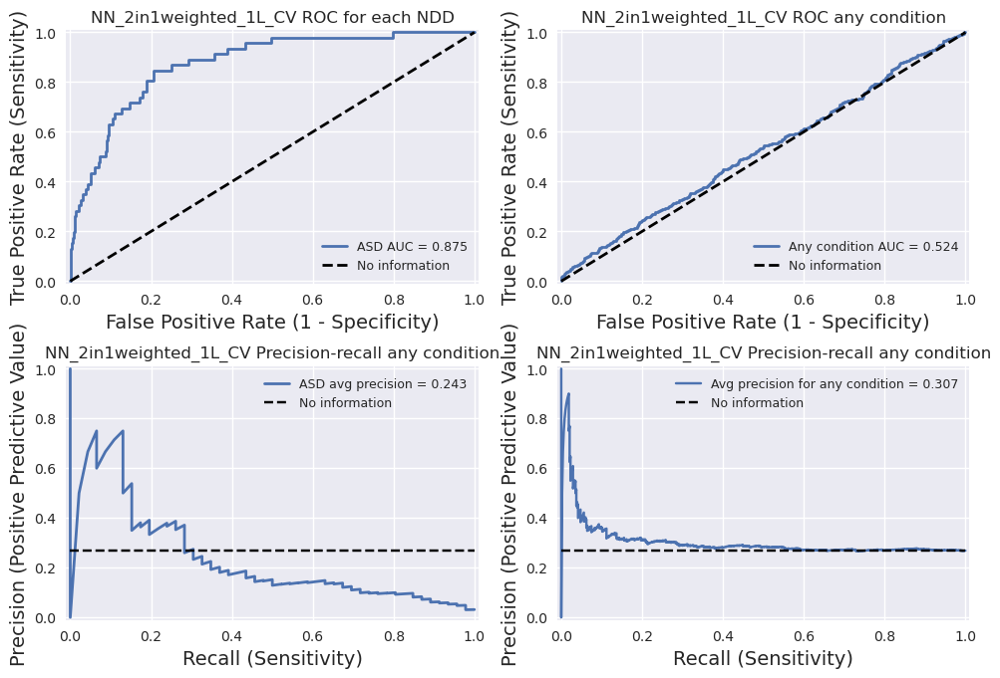

Fold 9/10
Dataset dimensions are (12960, 560) (12960, 1) (3240, 560) (3240, 1) (1800, 560) (1800, 1)



A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


Training Epochs:   0%|          | 0/200 [00:00<?, ?it/s]

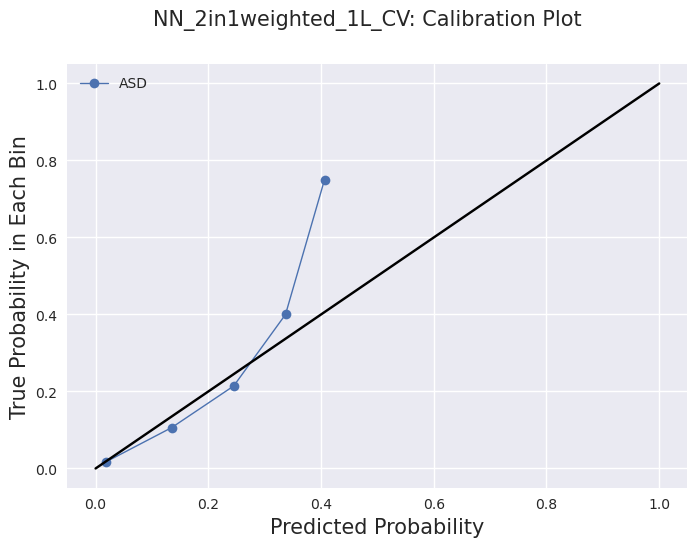

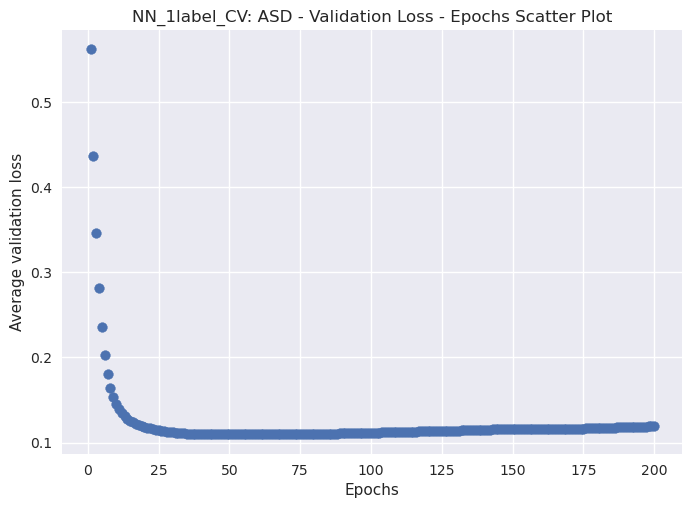

0.10949841886758804
['ASD']


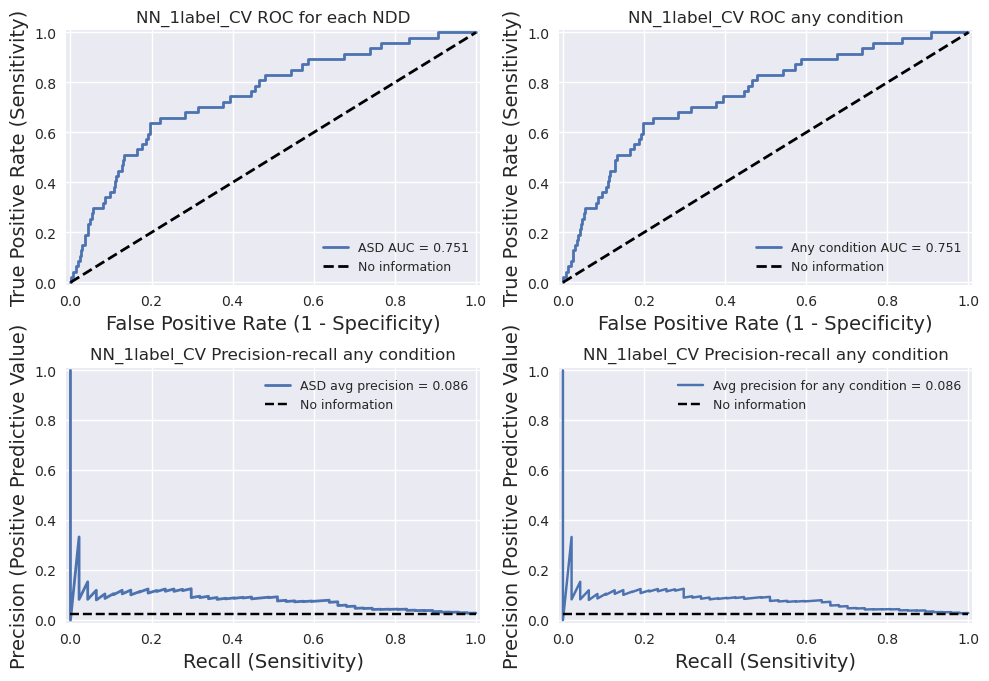

Dataset dimensions are (12960, 560) (12960, 5) (3240, 560) (3240, 5) (1800, 560) (1800, 5)


Training Epochs:   0%|          | 0/400 [00:00<?, ?it/s]

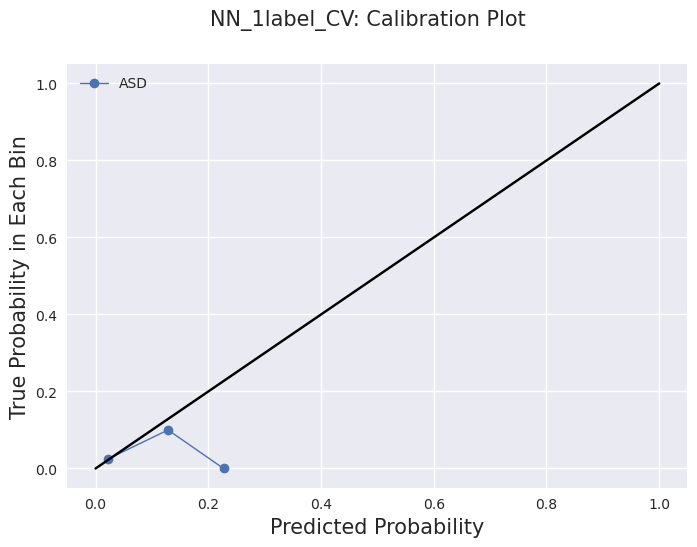

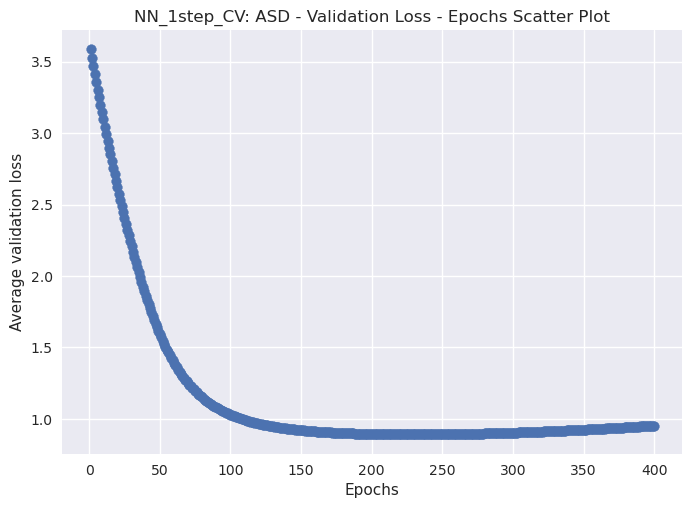

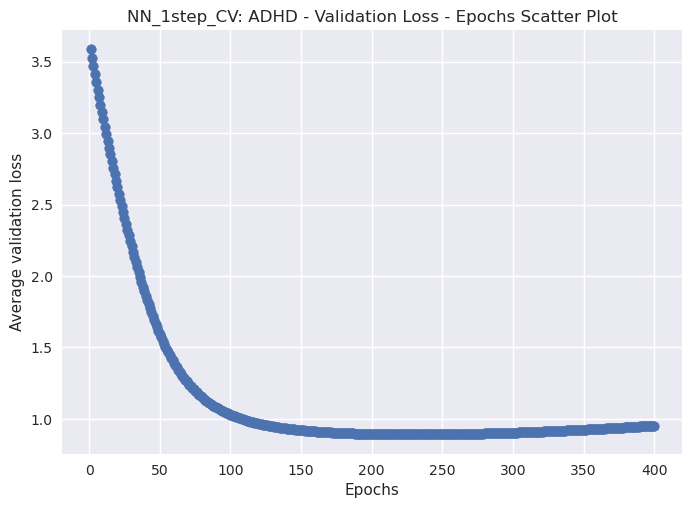

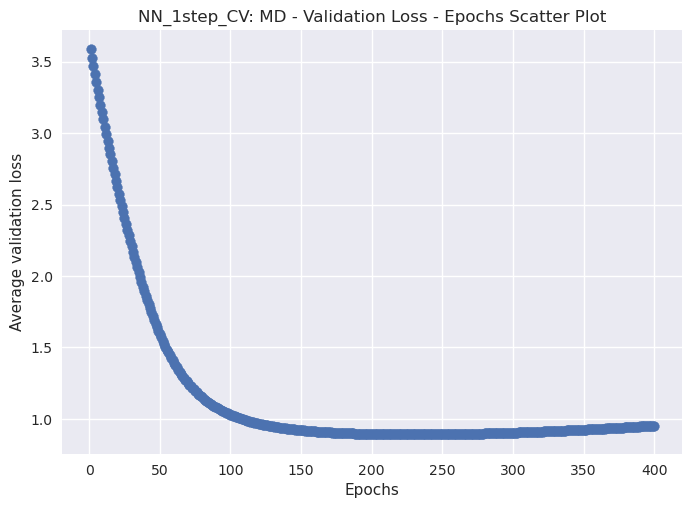

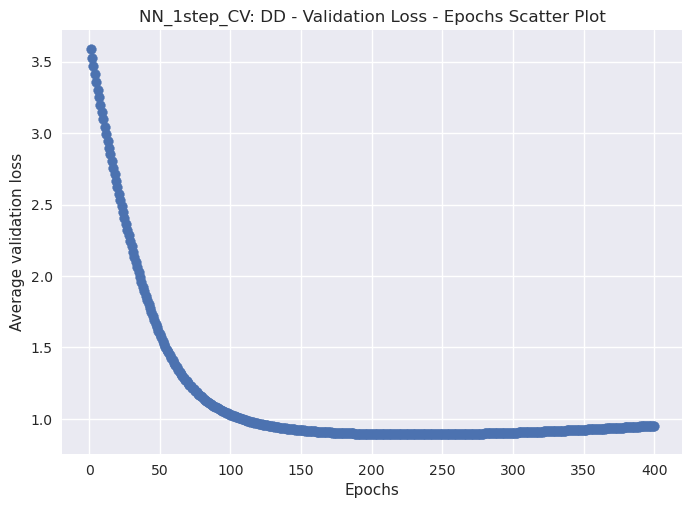

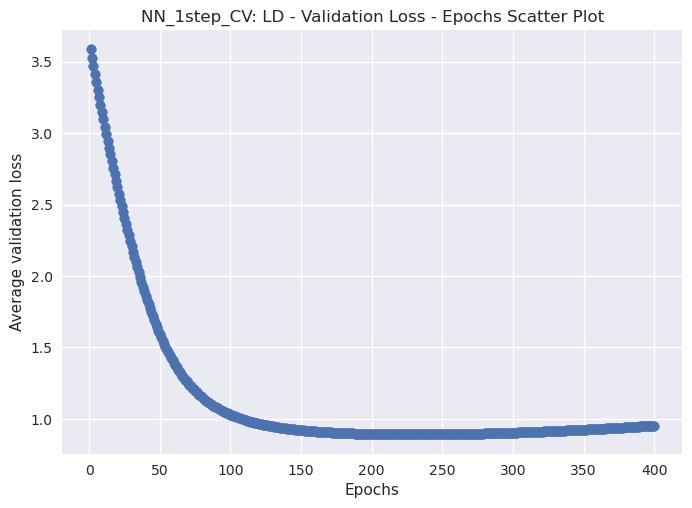

0.8909892439842224
['ASD', 'ADHD', 'MD', 'DD', 'LD']


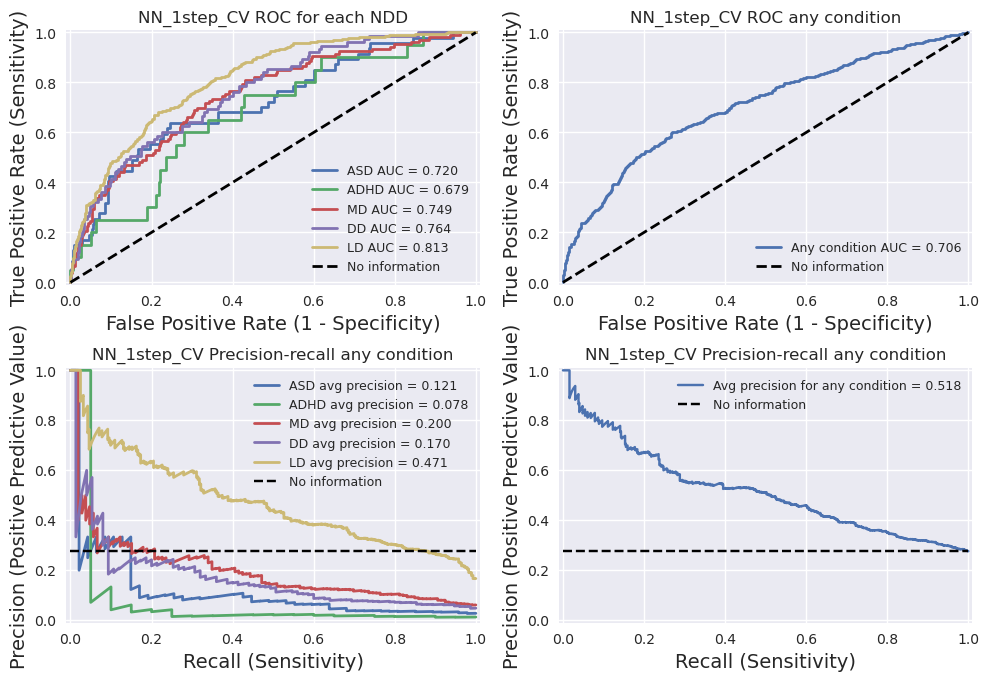

MTLnet(
  (flatten): Flatten(start_dim=1, end_dim=-1)
  (linear_sigmoid_stack): Sequential(
    (0): Linear(in_features=560, out_features=100, bias=True)
    (1): ReLU()
    (2): Linear(in_features=100, out_features=1, bias=True)
  )
)
MTLnet(
  (flatten): Flatten(start_dim=1, end_dim=-1)
  (linear_sigmoid_stack): Sequential(
    (0): Linear(in_features=560, out_features=100, bias=True)
    (1): ReLU()
    (2): Linear(in_features=100, out_features=5, bias=True)
  )
)
Dataset dimensions are (12960, 560) (12960, 1) (3240, 560) (3240, 1) (1800, 560) (1800, 1)


Training Epochs:   0%|          | 0/400 [00:00<?, ?it/s]

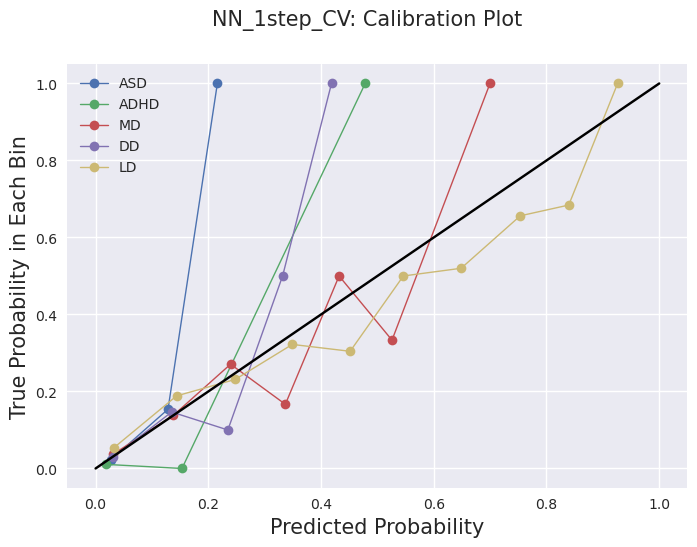

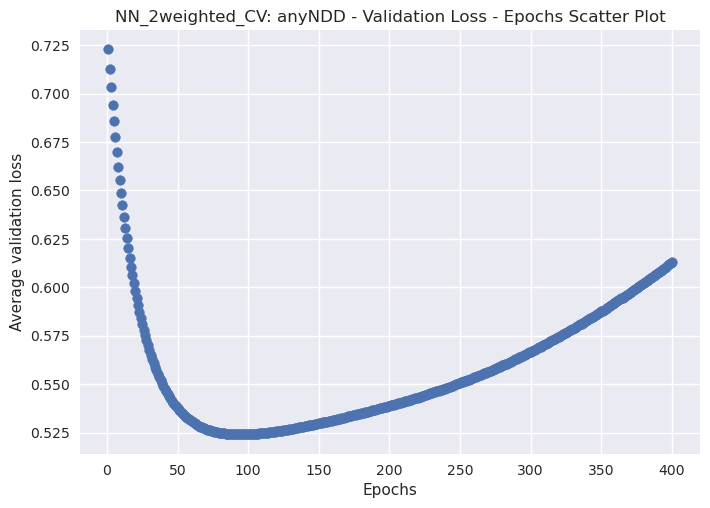

['anyNDD']


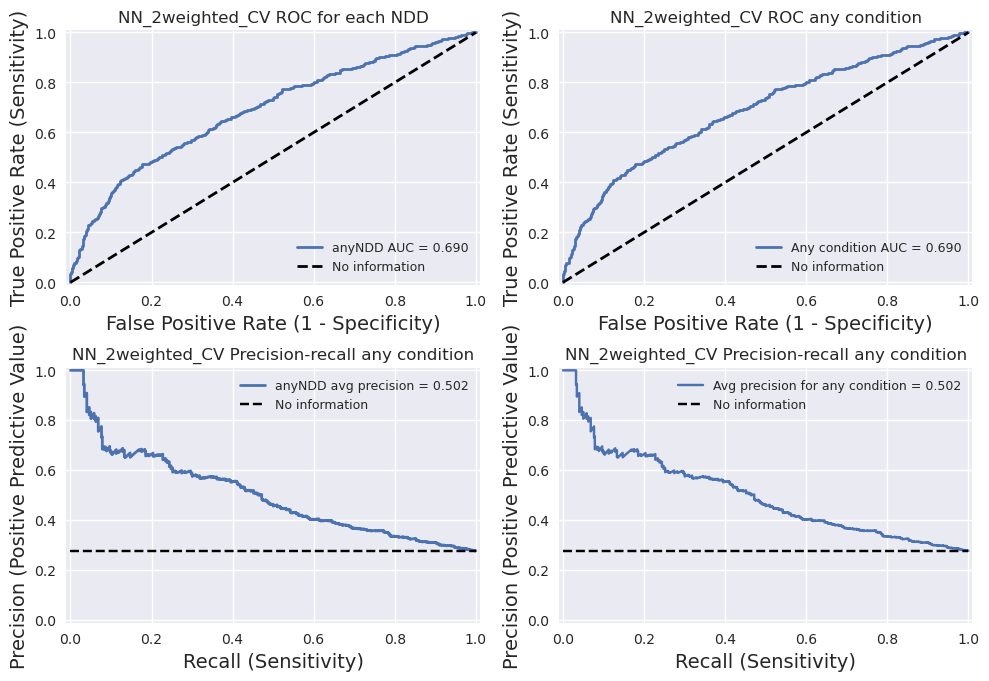

['anyNDD']


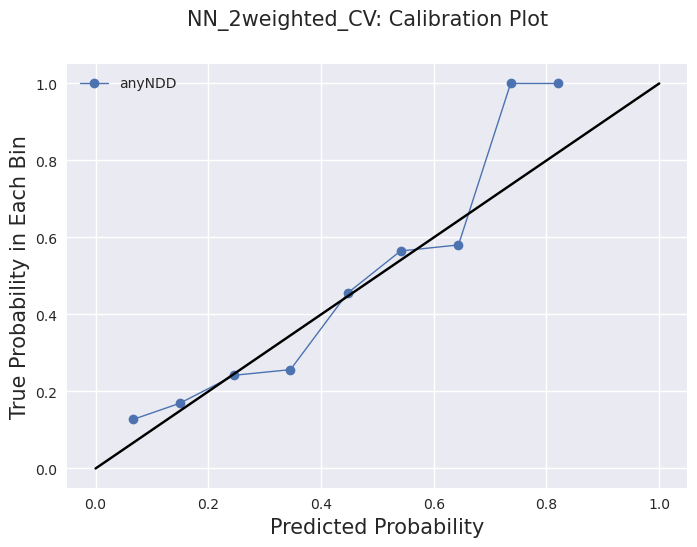

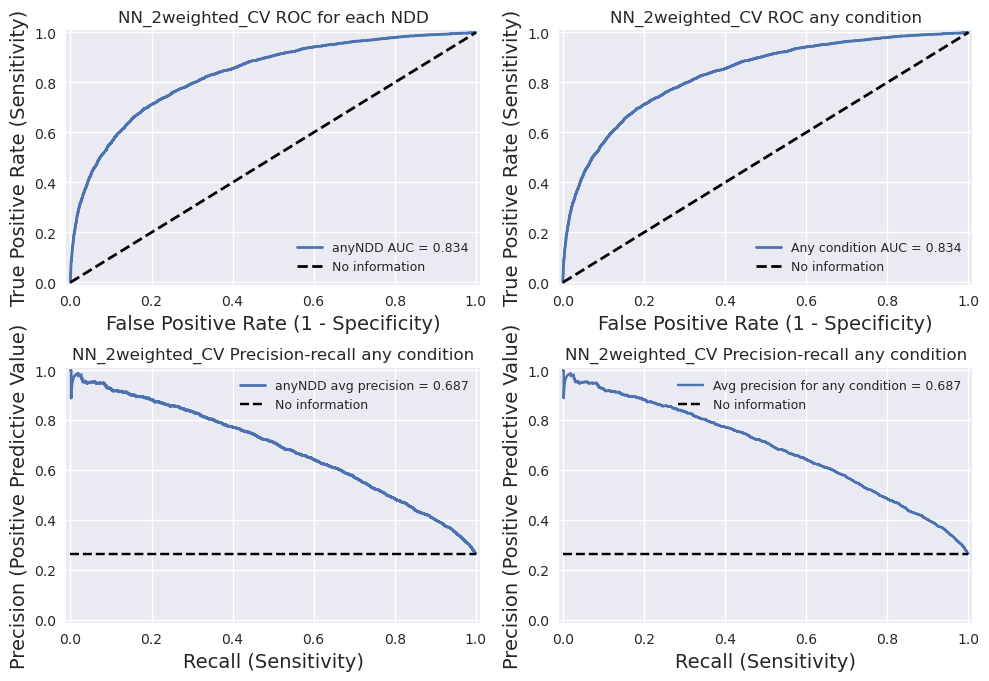

['anyNDD']


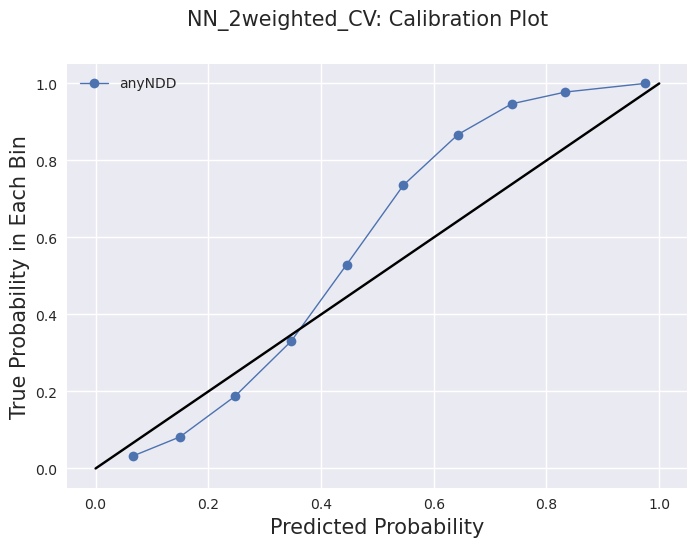

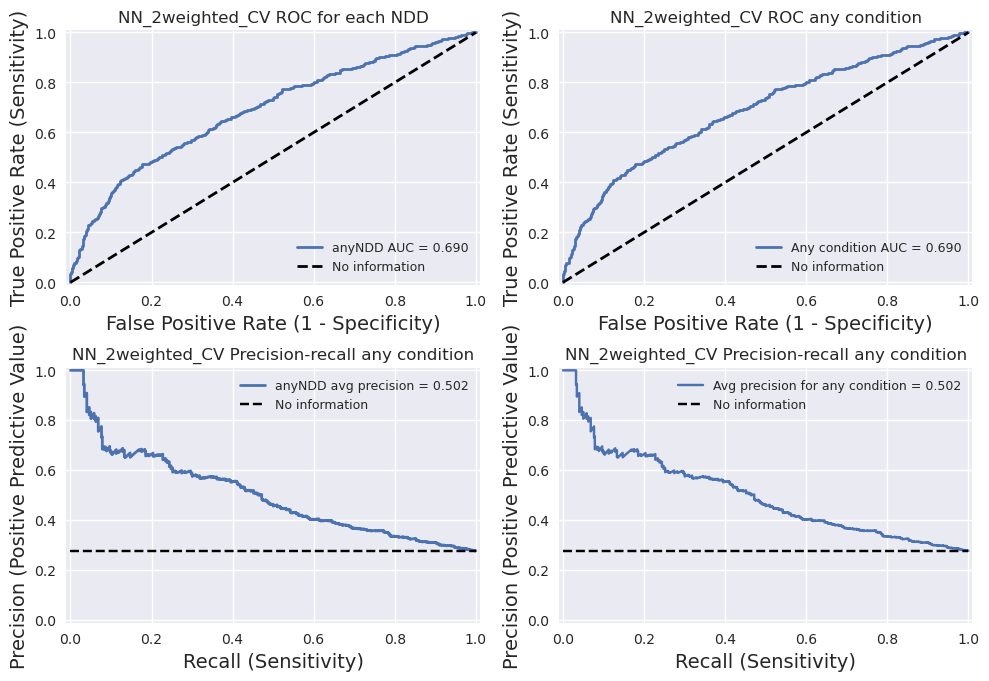

Dataset dimensions are (12960, 560) (12960, 5) (3240, 560) (3240, 5) (1800, 560) (1800, 5)


Training Epochs:   0%|          | 0/800 [00:00<?, ?it/s]

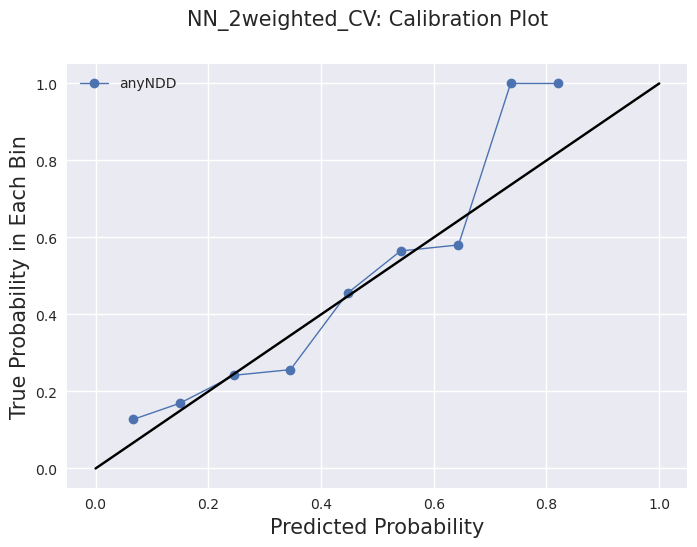

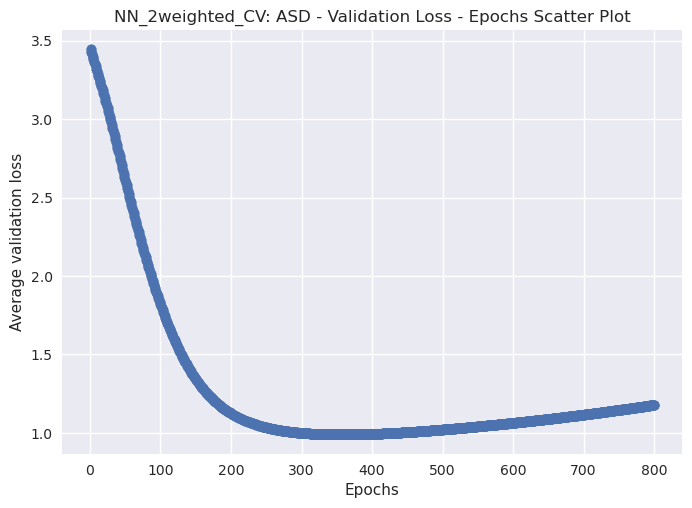

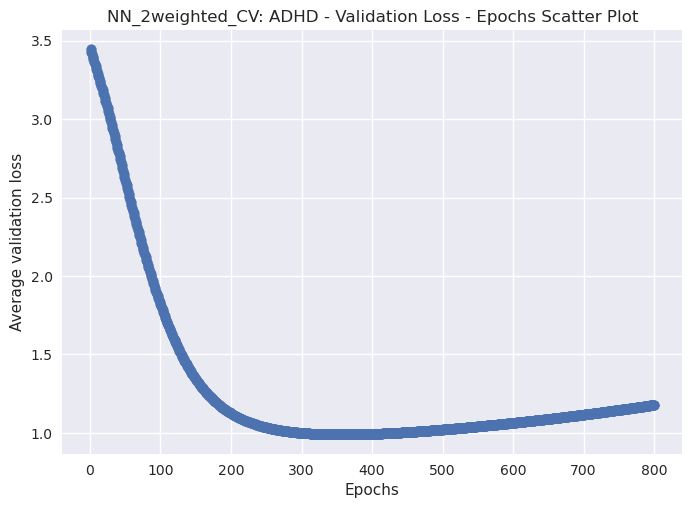

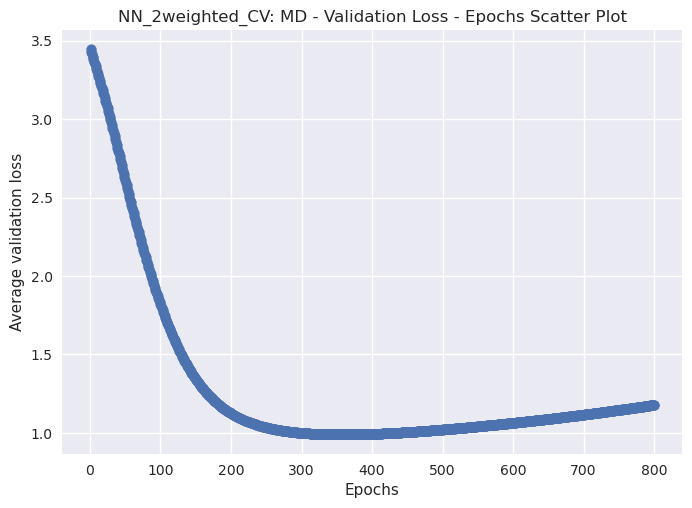

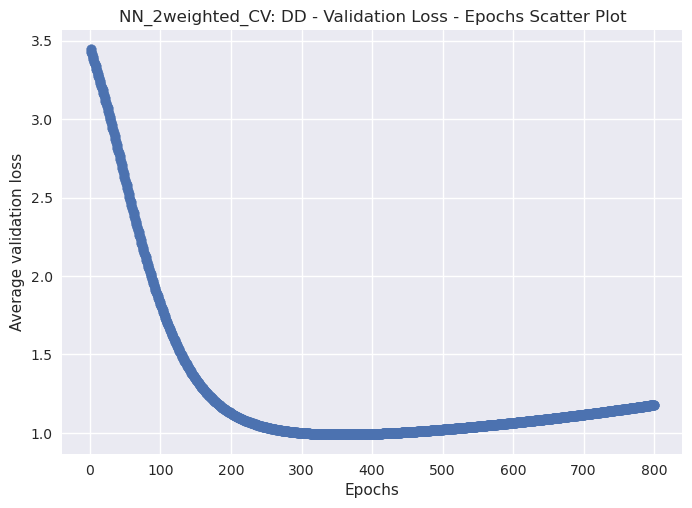

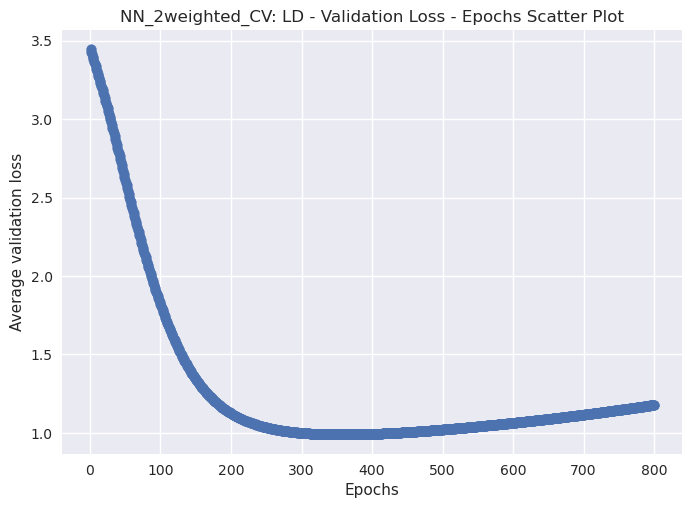

0.9899718463420868
['ASD', 'ADHD', 'MD', 'DD', 'LD']


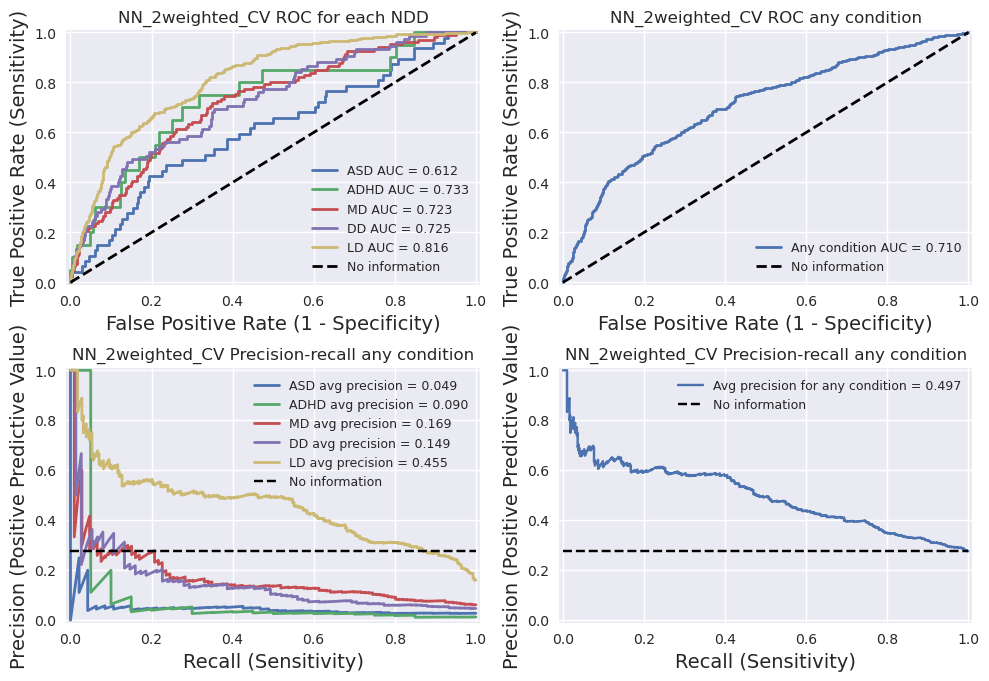

MTLnet(
  (flatten): Flatten(start_dim=1, end_dim=-1)
  (linear_sigmoid_stack): Sequential(
    (0): Linear(in_features=560, out_features=100, bias=True)
    (1): ReLU()
    (2): Linear(in_features=100, out_features=6, bias=True)
  )
)
Dataset dimensions are (12960, 560) (12960, 6) (3240, 560) (3240, 6) (1800, 560) (1800, 6)


Training Epochs:   0%|          | 0/400 [00:00<?, ?it/s]

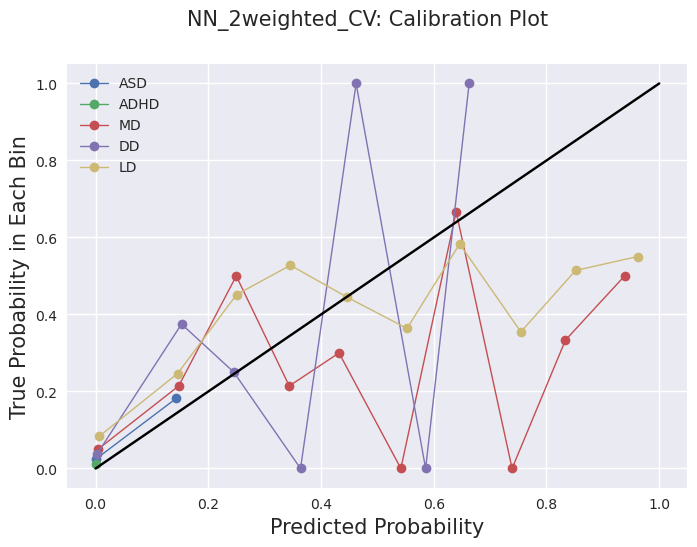

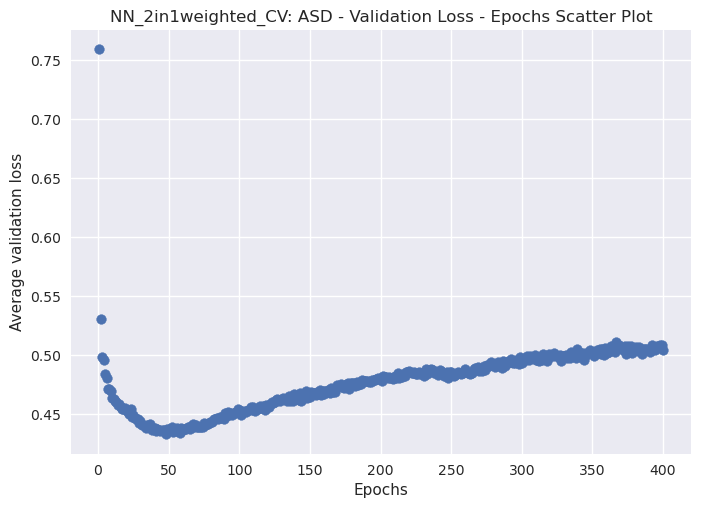

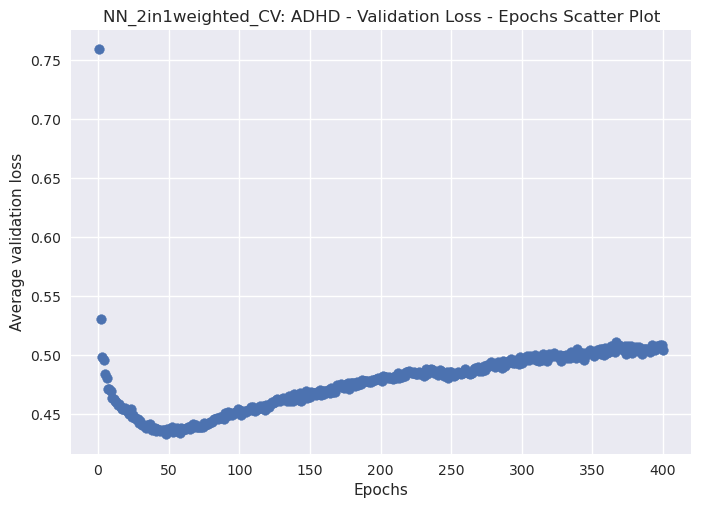

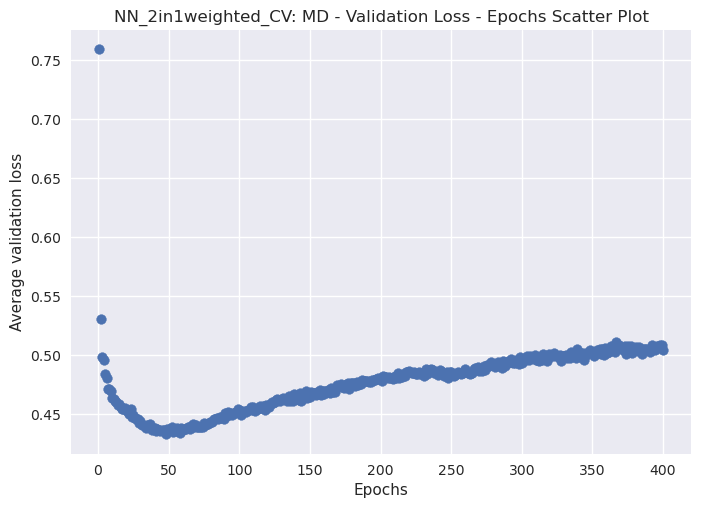

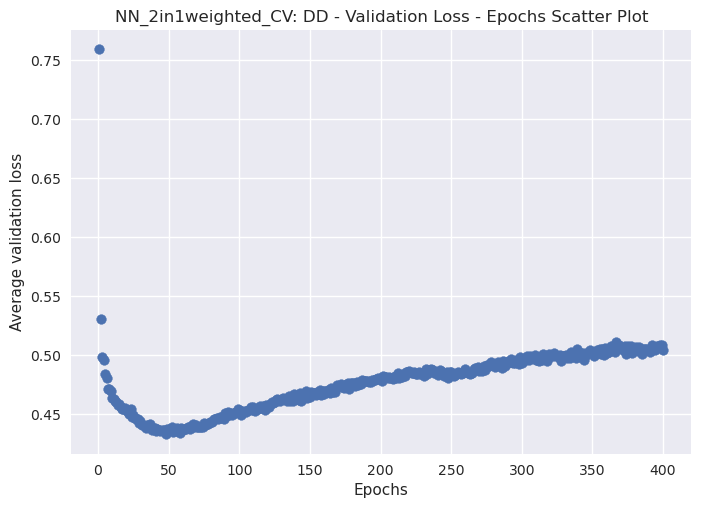

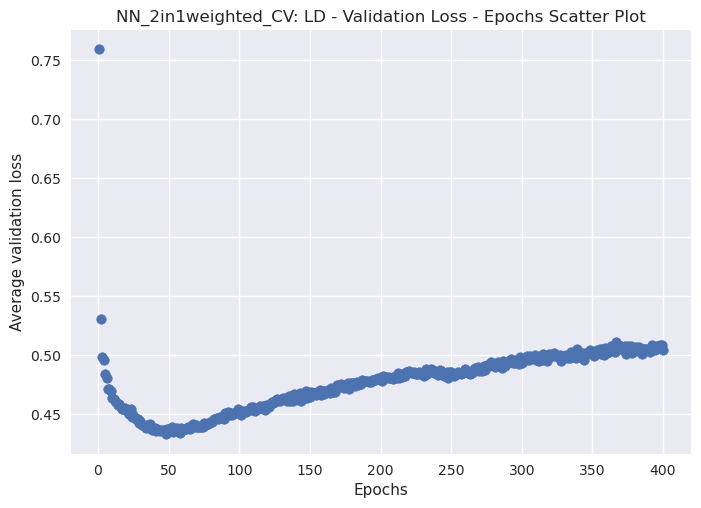

0.43296557664871216
['ASD', 'ADHD', 'MD', 'DD', 'LD']


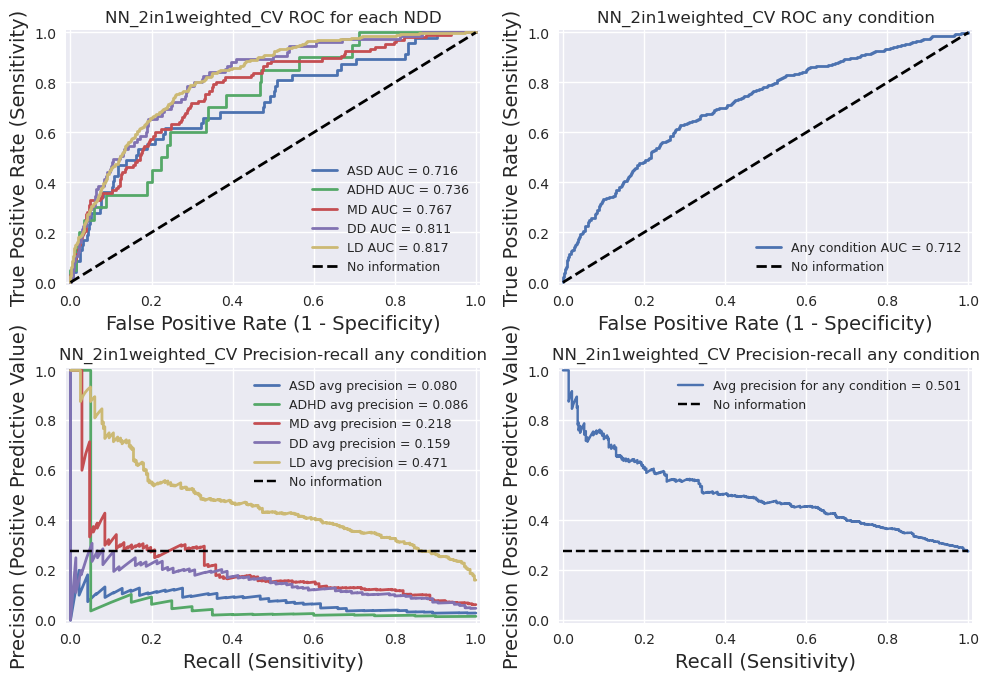

Dataset dimensions are (12960, 560) (12960, 1) (3240, 560) (3240, 1) (1800, 560) (1800, 1)


Training Epochs:   0%|          | 0/400 [00:00<?, ?it/s]

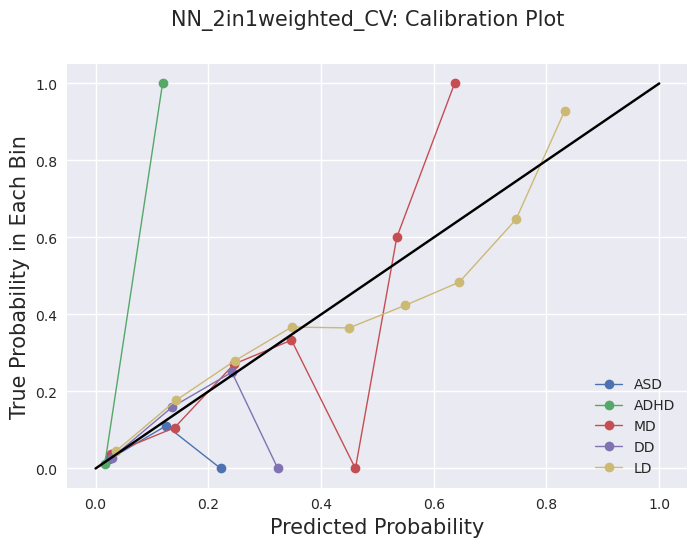

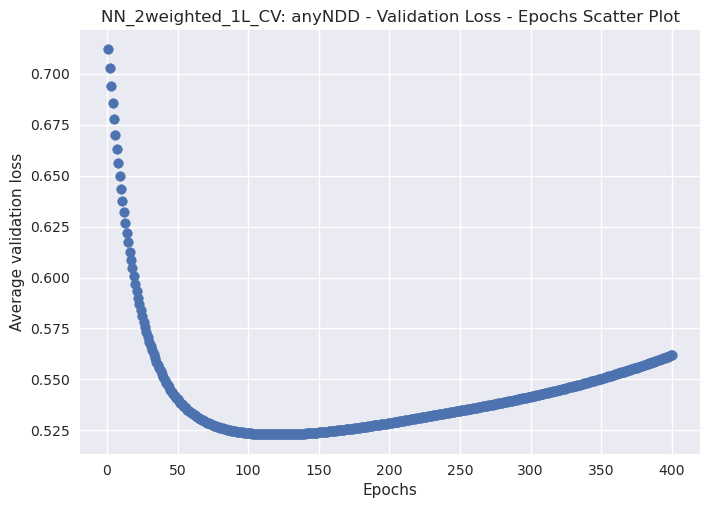

['anyNDD']


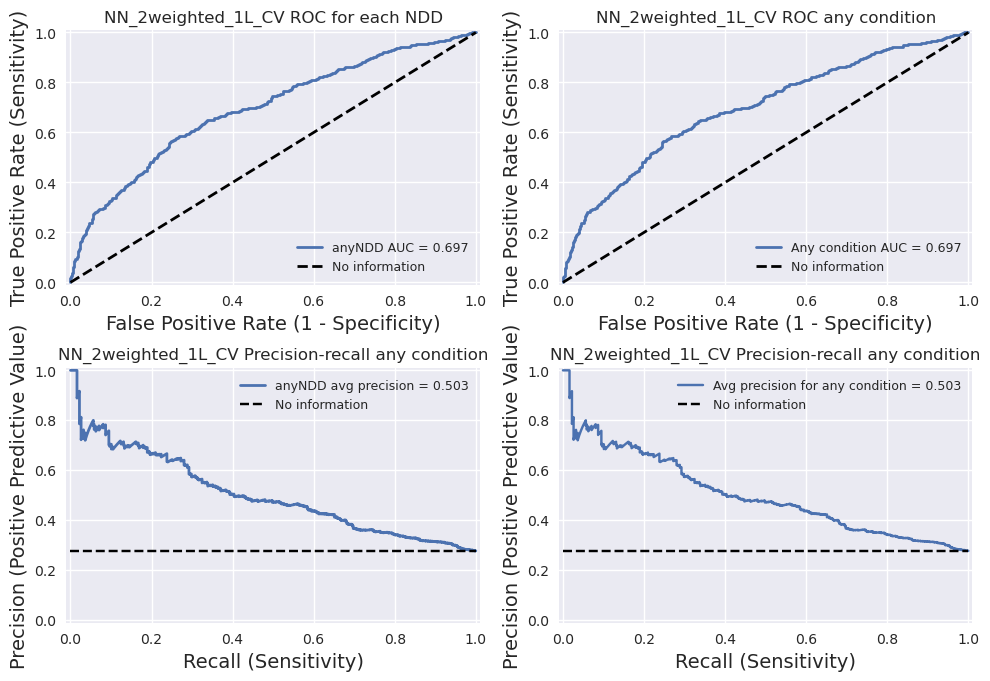

['anyNDD']


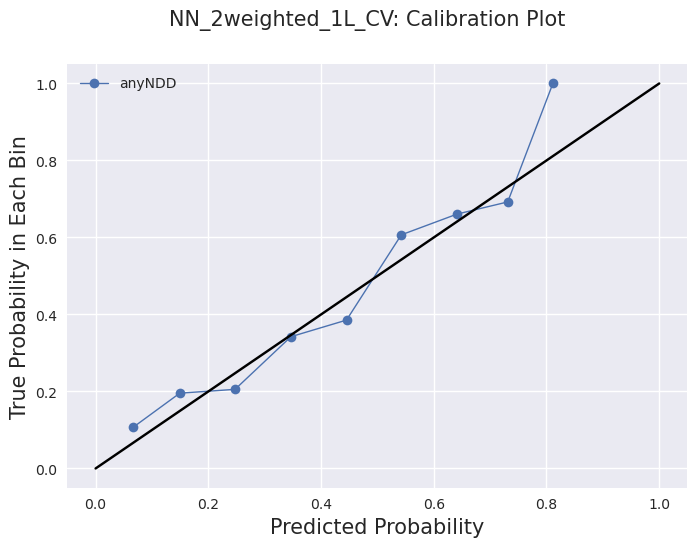

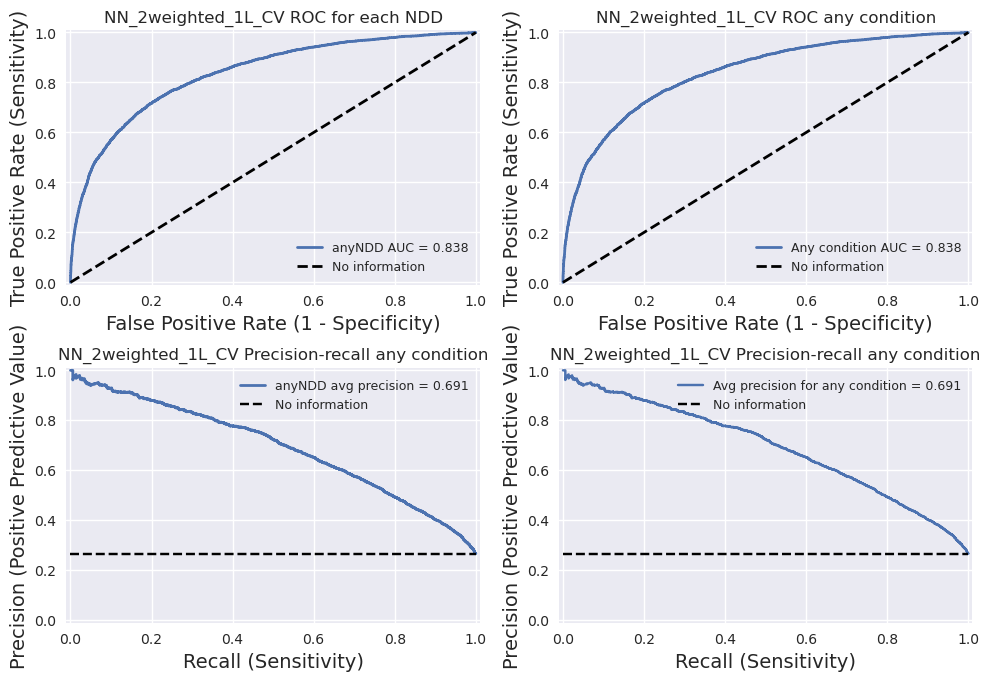

['anyNDD']


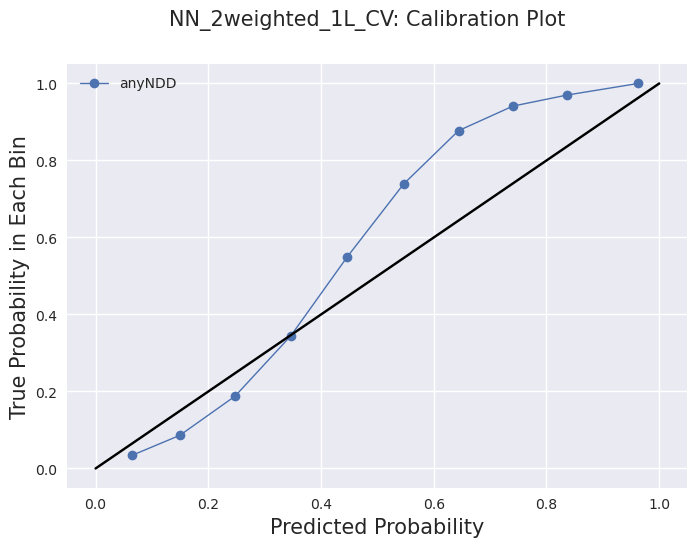

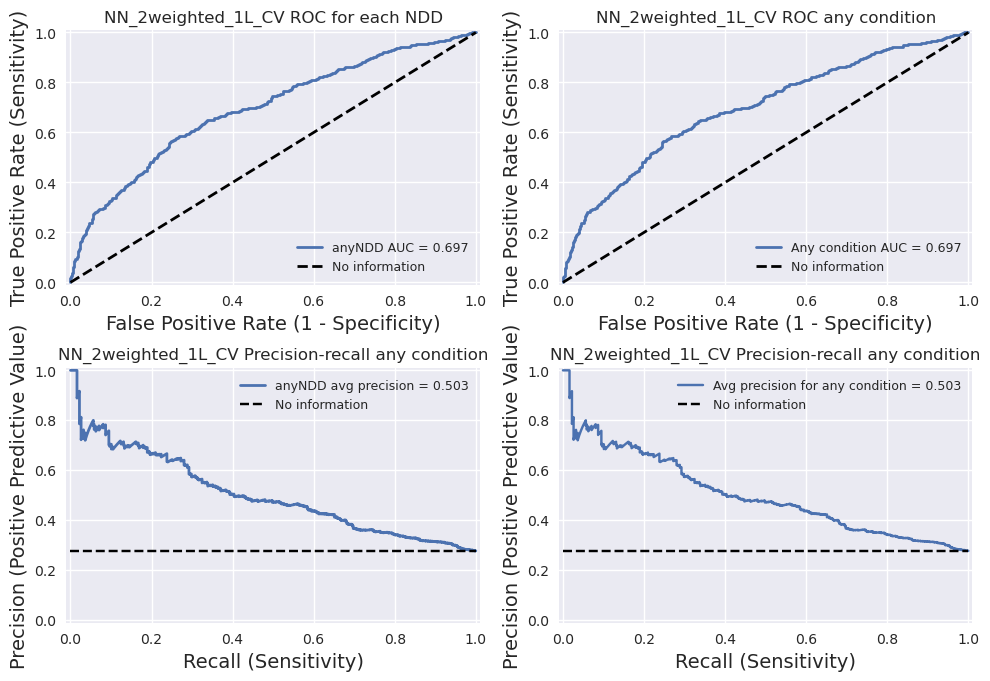

Dataset dimensions are (12960, 560) (12960, 1) (3240, 560) (3240, 1) (1800, 560) (1800, 1)


Training Epochs:   0%|          | 0/400 [00:00<?, ?it/s]

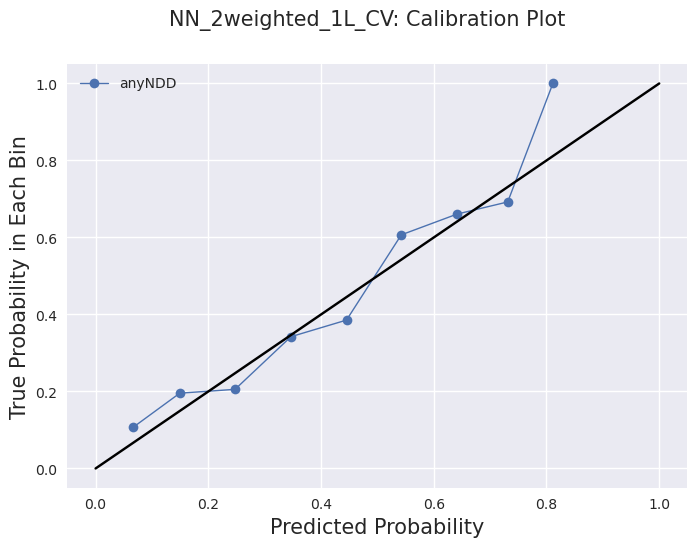

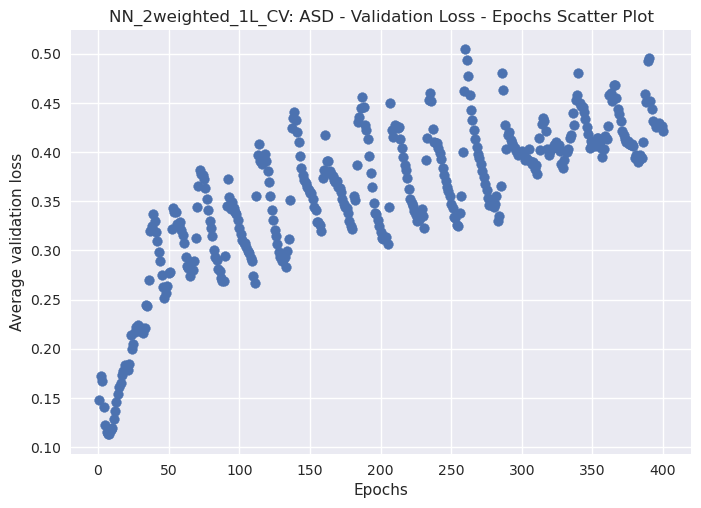

0.11291778460144997
['ASD']


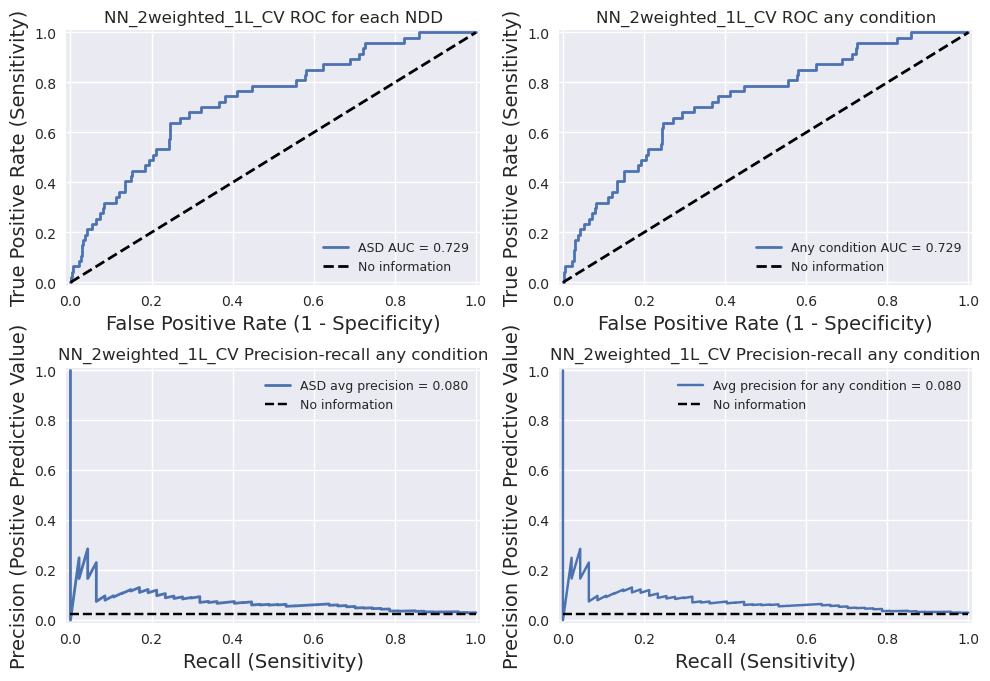

MTLnet(
  (flatten): Flatten(start_dim=1, end_dim=-1)
  (linear_sigmoid_stack): Sequential(
    (0): Linear(in_features=560, out_features=100, bias=True)
    (1): ReLU()
    (2): Linear(in_features=100, out_features=2, bias=True)
  )
)
Dataset dimensions are (12960, 560) (12960, 2) (3240, 560) (3240, 2) (1800, 560) (1800, 2)


Training Epochs:   0%|          | 0/400 [00:00<?, ?it/s]

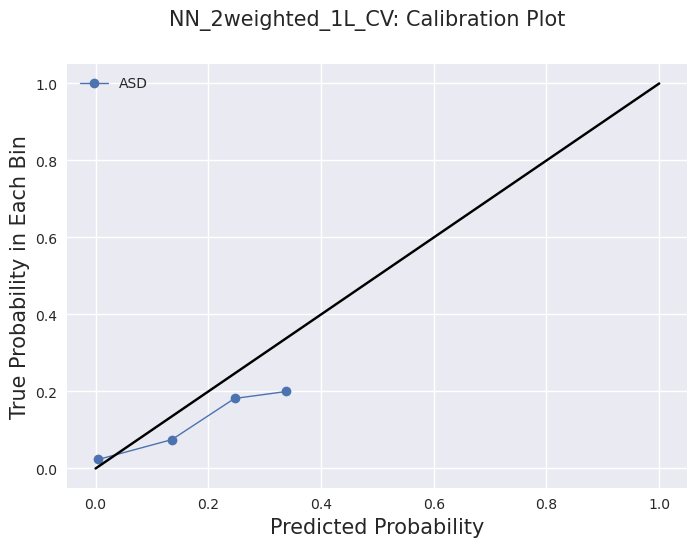

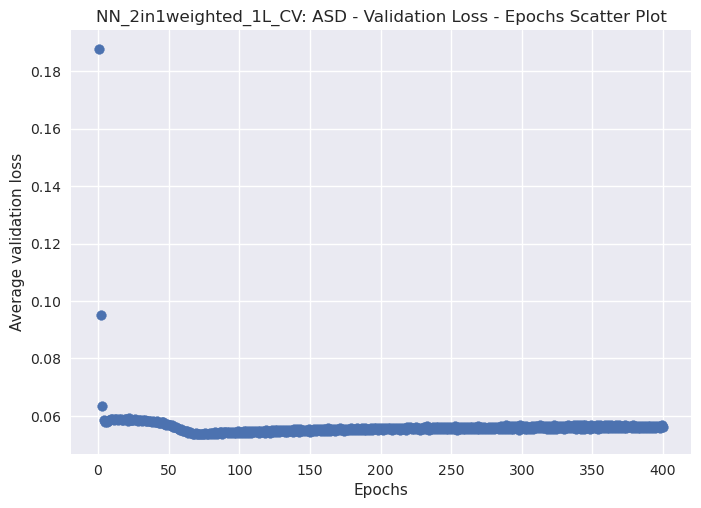

0.05355466529726982
['ASD']


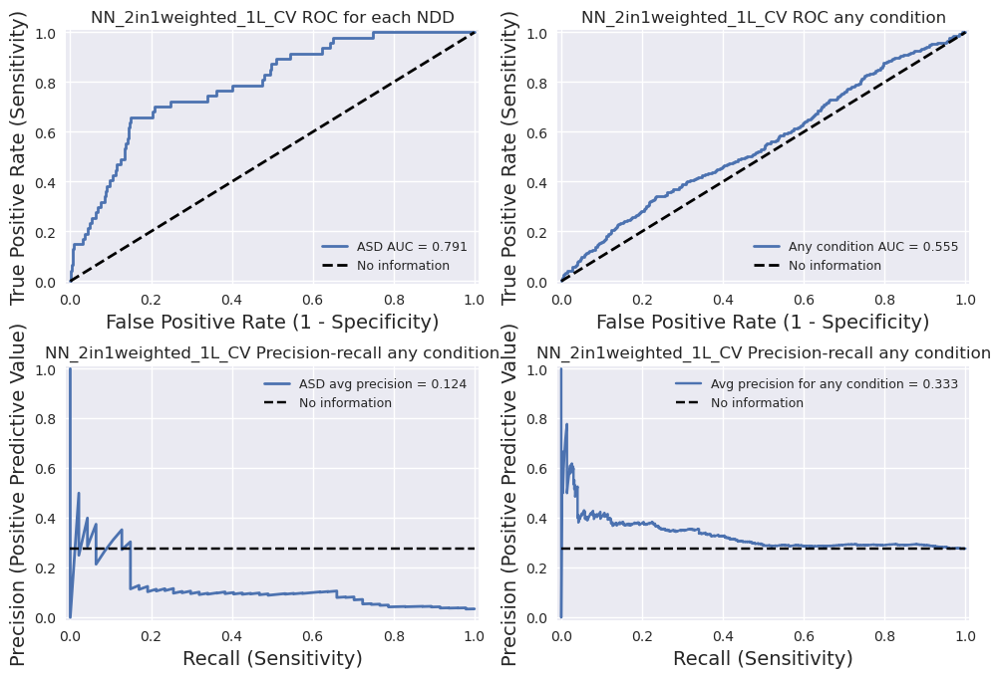

Fold 10/10
Dataset dimensions are (12960, 560) (12960, 1) (3240, 560) (3240, 1) (1800, 560) (1800, 1)



A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


Training Epochs:   0%|          | 0/200 [00:00<?, ?it/s]

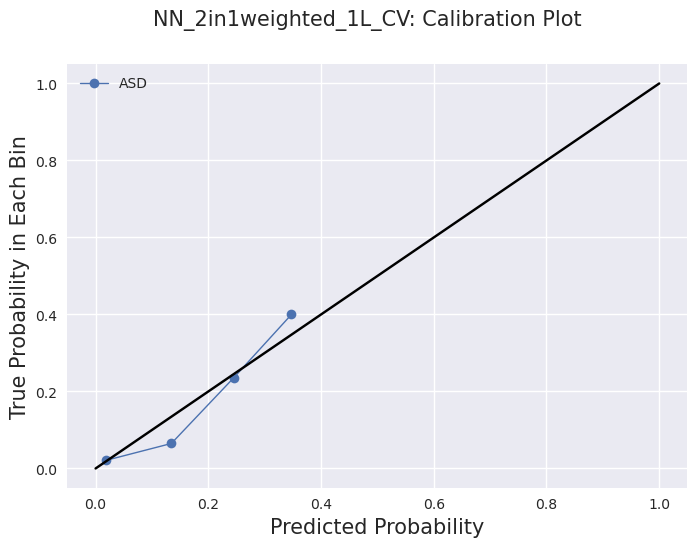

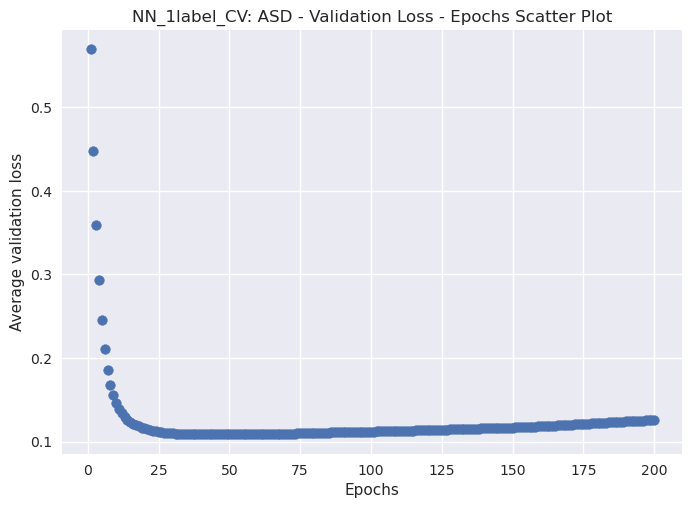

0.10852629691362381
['ASD']


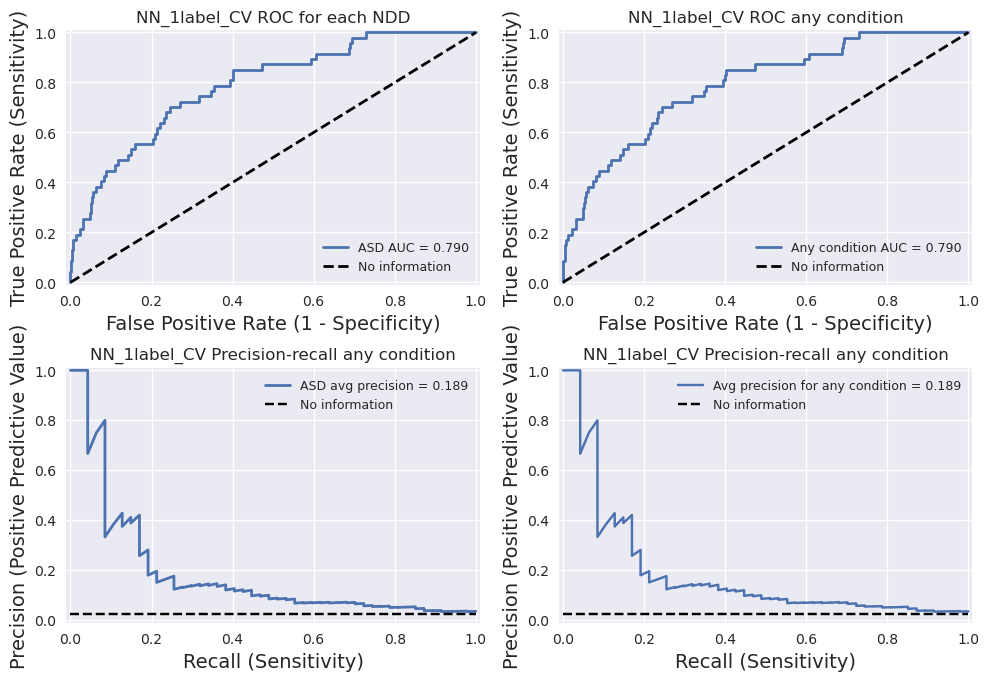

Dataset dimensions are (12960, 560) (12960, 5) (3240, 560) (3240, 5) (1800, 560) (1800, 5)


Training Epochs:   0%|          | 0/400 [00:00<?, ?it/s]

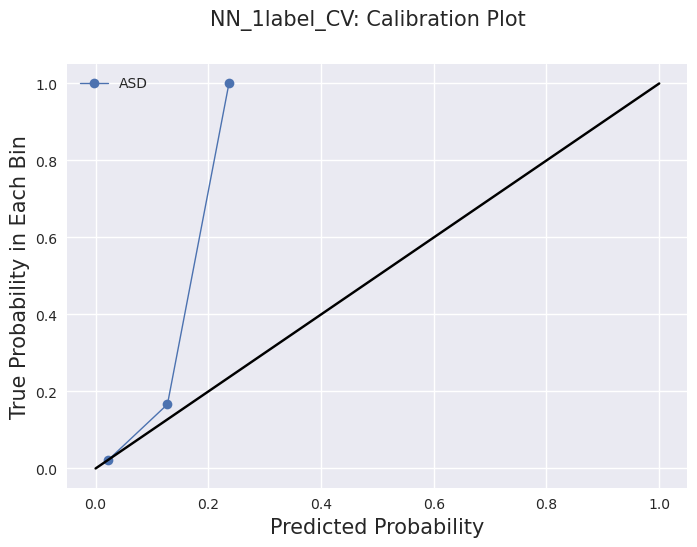

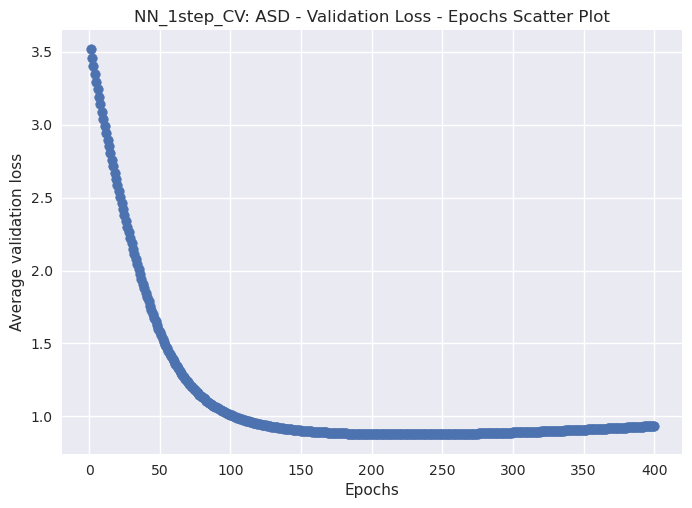

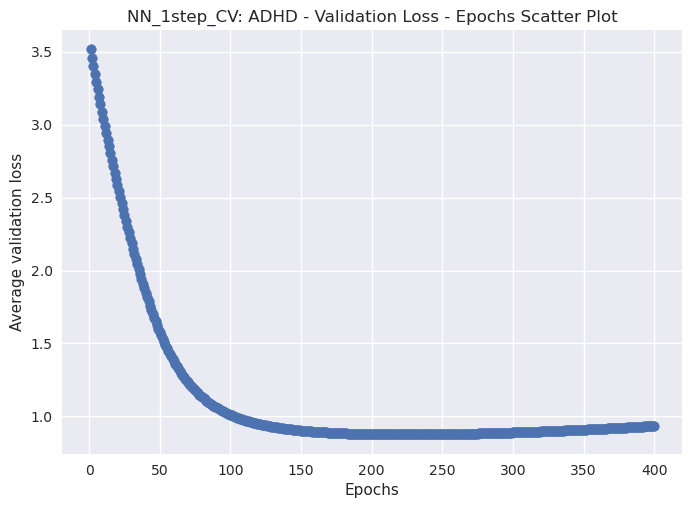

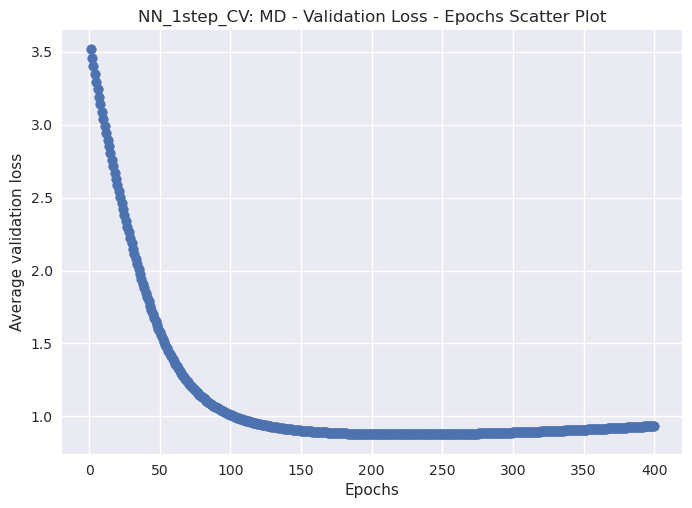

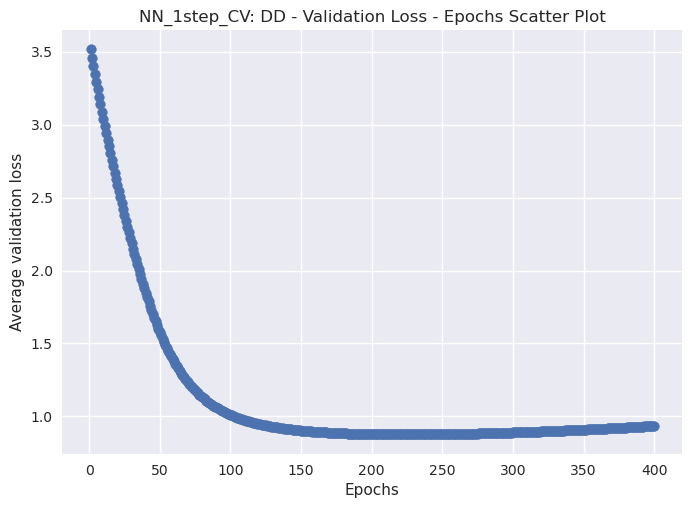

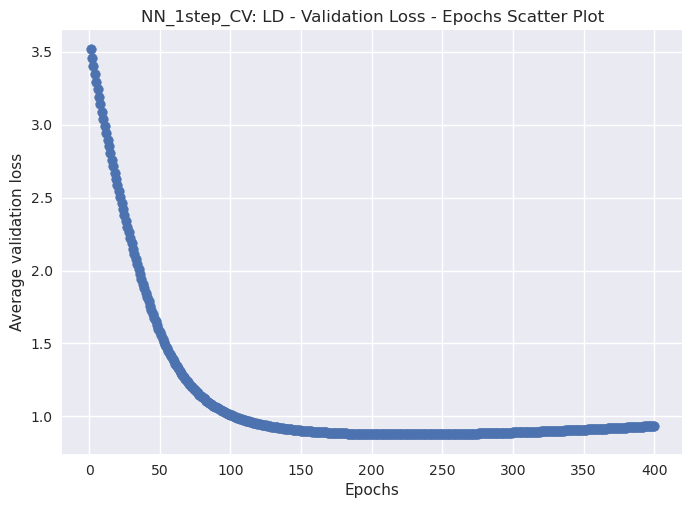

0.8762855529785156
['ASD', 'ADHD', 'MD', 'DD', 'LD']


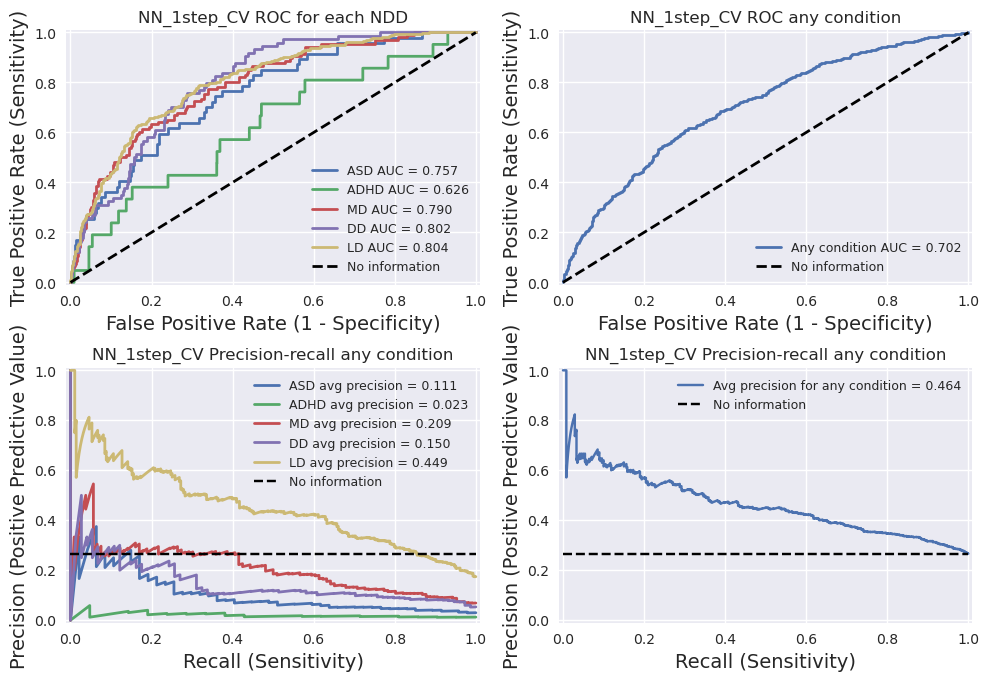

MTLnet(
  (flatten): Flatten(start_dim=1, end_dim=-1)
  (linear_sigmoid_stack): Sequential(
    (0): Linear(in_features=560, out_features=100, bias=True)
    (1): ReLU()
    (2): Linear(in_features=100, out_features=1, bias=True)
  )
)
MTLnet(
  (flatten): Flatten(start_dim=1, end_dim=-1)
  (linear_sigmoid_stack): Sequential(
    (0): Linear(in_features=560, out_features=100, bias=True)
    (1): ReLU()
    (2): Linear(in_features=100, out_features=5, bias=True)
  )
)
Dataset dimensions are (12960, 560) (12960, 1) (3240, 560) (3240, 1) (1800, 560) (1800, 1)


Training Epochs:   0%|          | 0/400 [00:00<?, ?it/s]

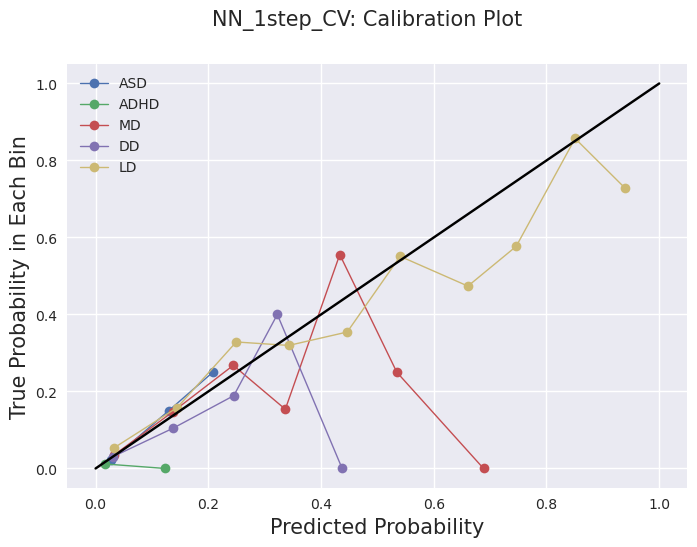

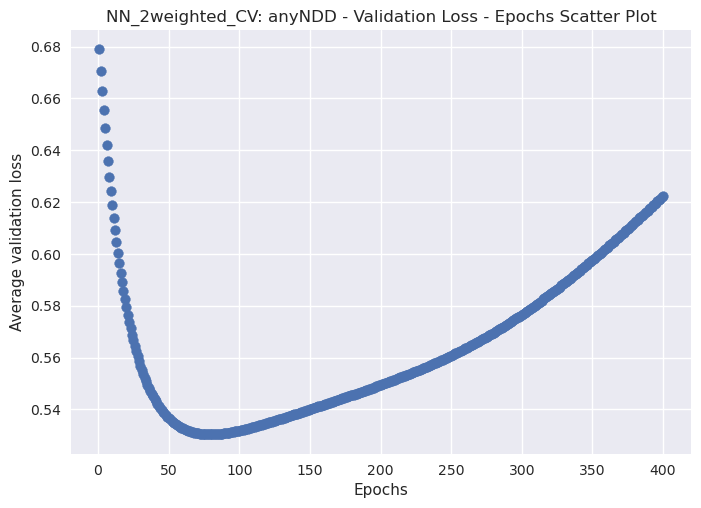

['anyNDD']


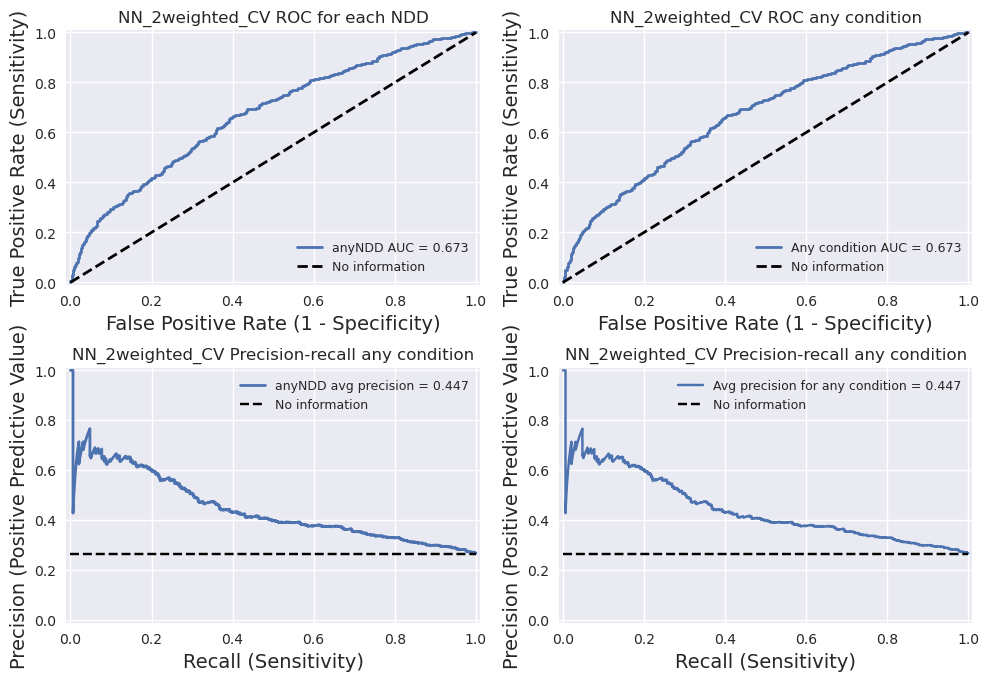

['anyNDD']


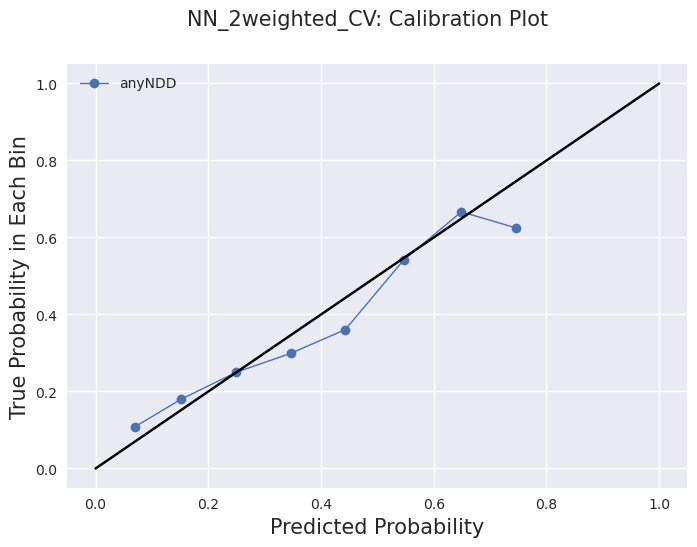

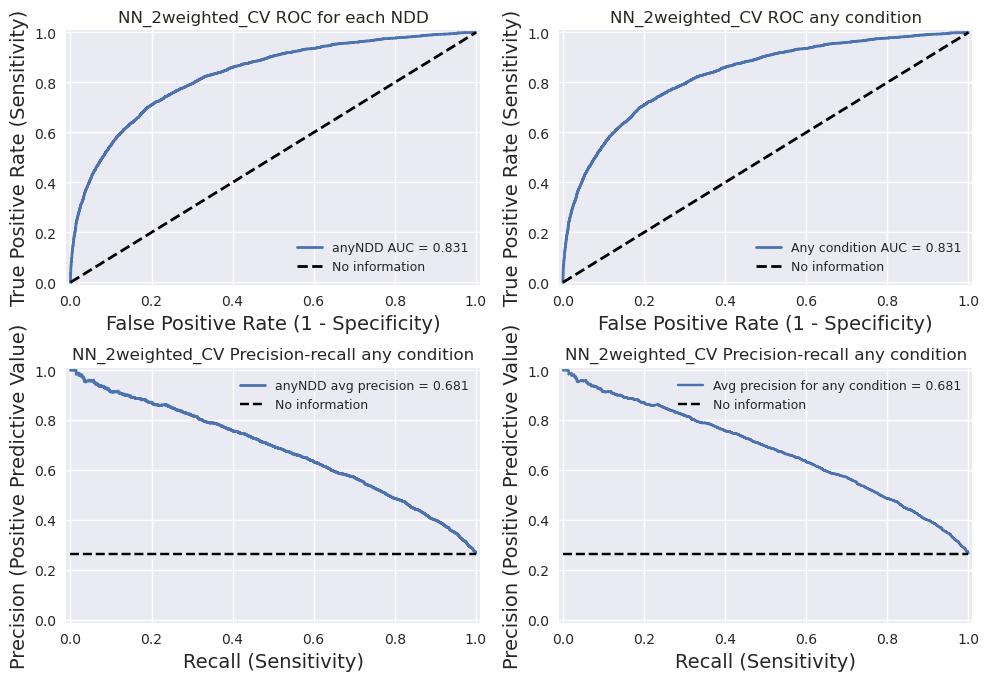

['anyNDD']


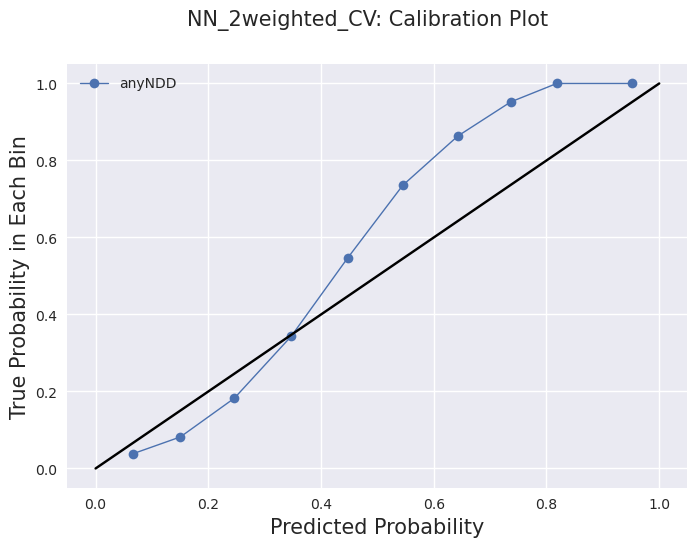

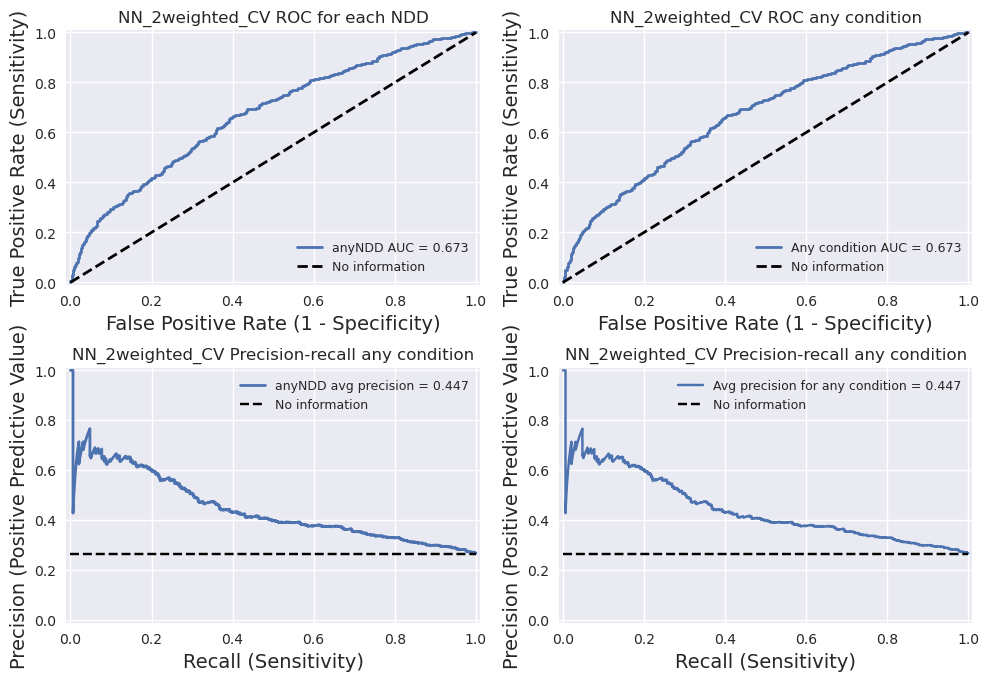

Dataset dimensions are (12960, 560) (12960, 5) (3240, 560) (3240, 5) (1800, 560) (1800, 5)


Training Epochs:   0%|          | 0/800 [00:00<?, ?it/s]

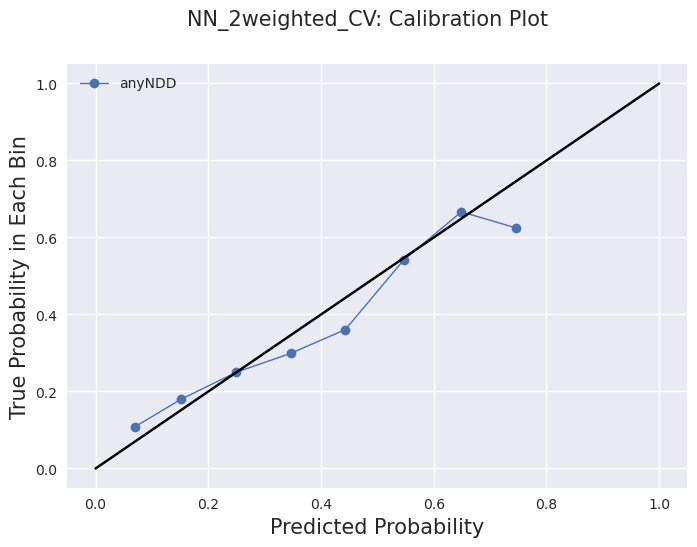

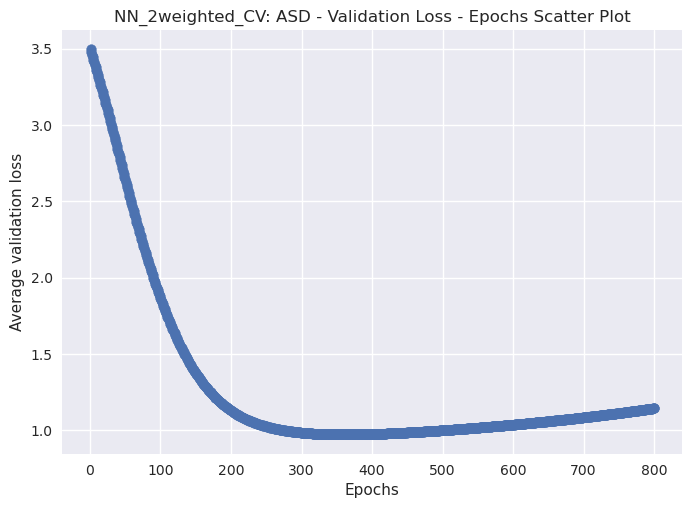

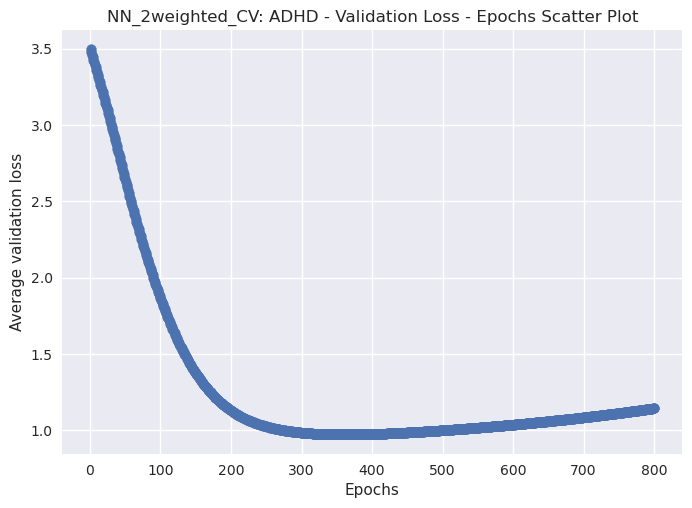

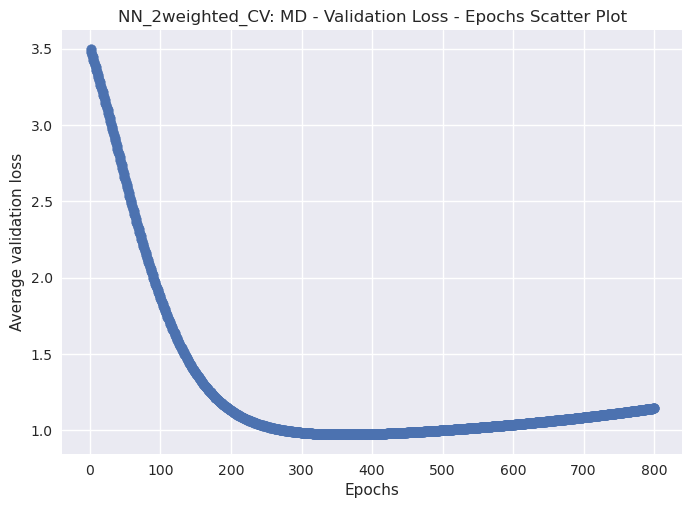

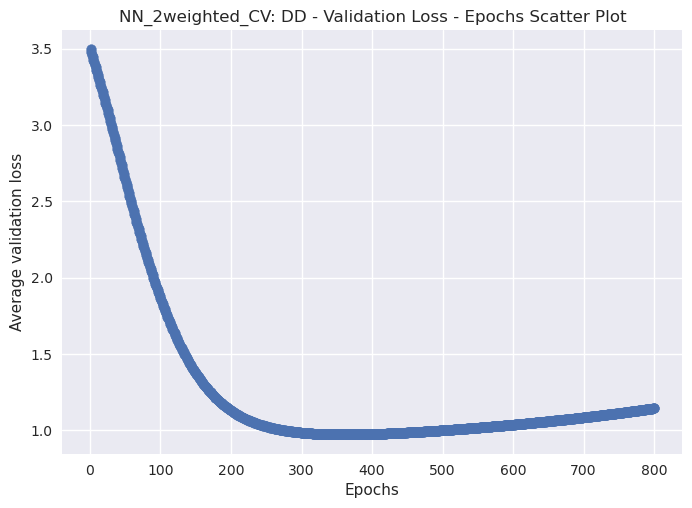

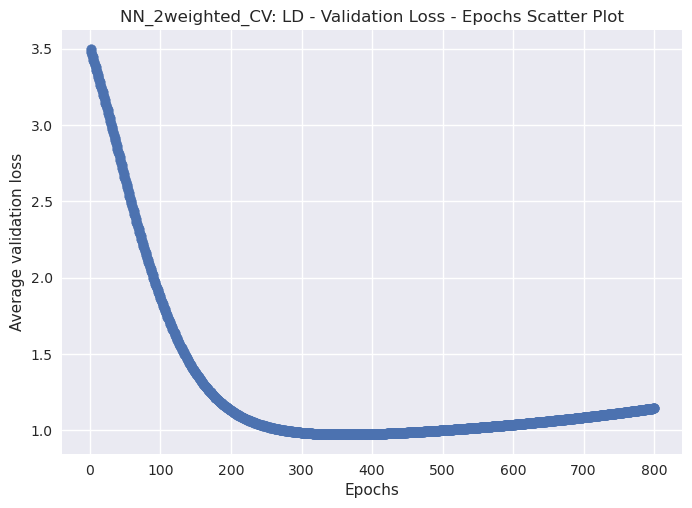

0.9719563126564026
['ASD', 'ADHD', 'MD', 'DD', 'LD']


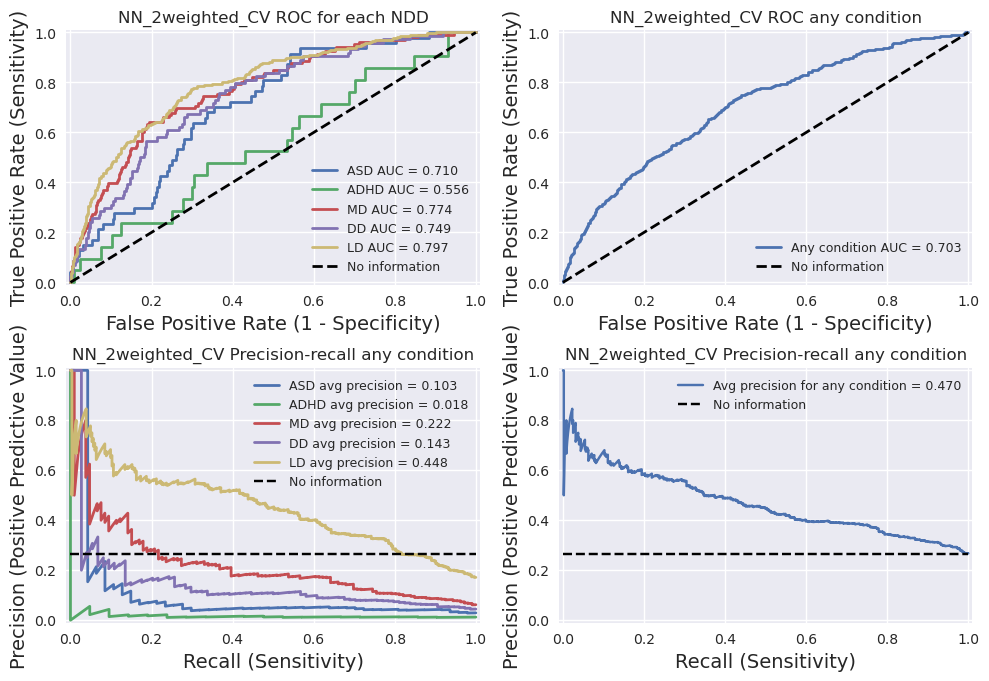

MTLnet(
  (flatten): Flatten(start_dim=1, end_dim=-1)
  (linear_sigmoid_stack): Sequential(
    (0): Linear(in_features=560, out_features=100, bias=True)
    (1): ReLU()
    (2): Linear(in_features=100, out_features=6, bias=True)
  )
)
Dataset dimensions are (12960, 560) (12960, 6) (3240, 560) (3240, 6) (1800, 560) (1800, 6)


Training Epochs:   0%|          | 0/400 [00:00<?, ?it/s]

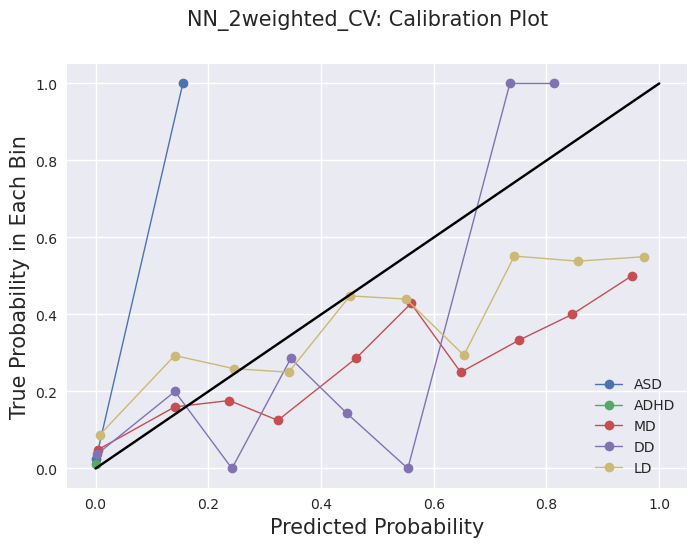

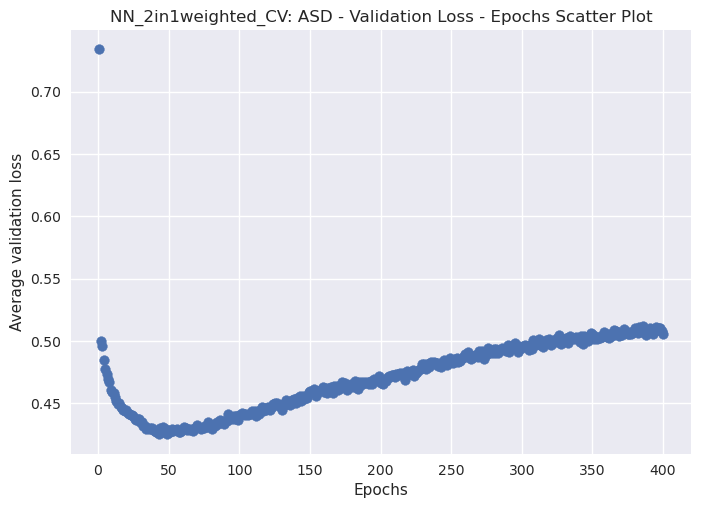

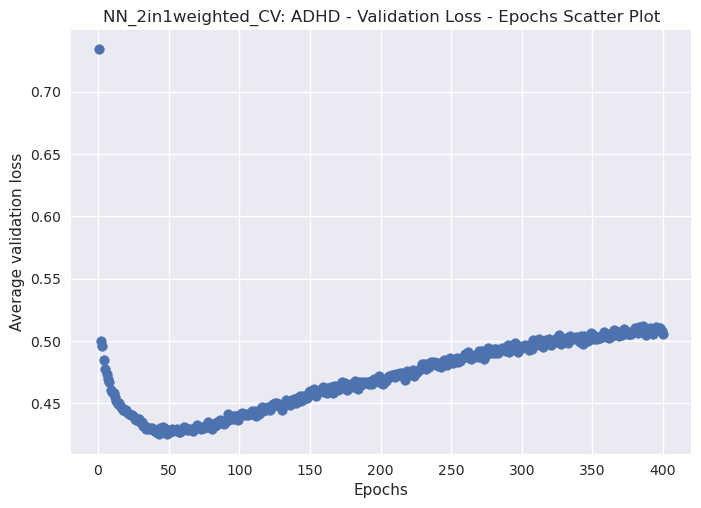

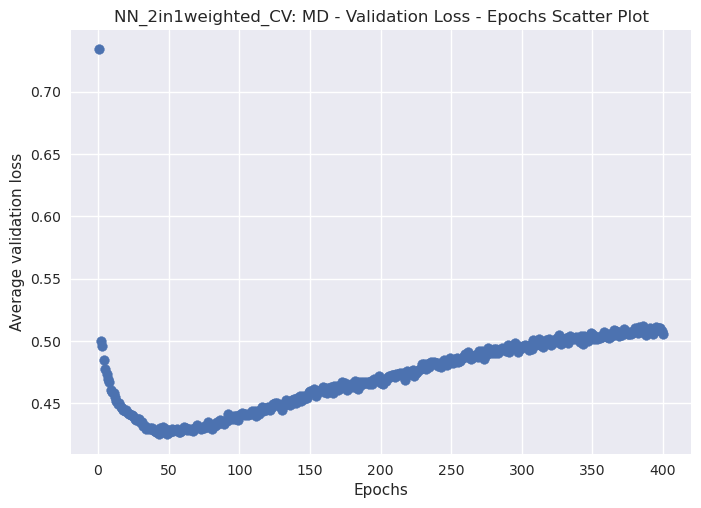

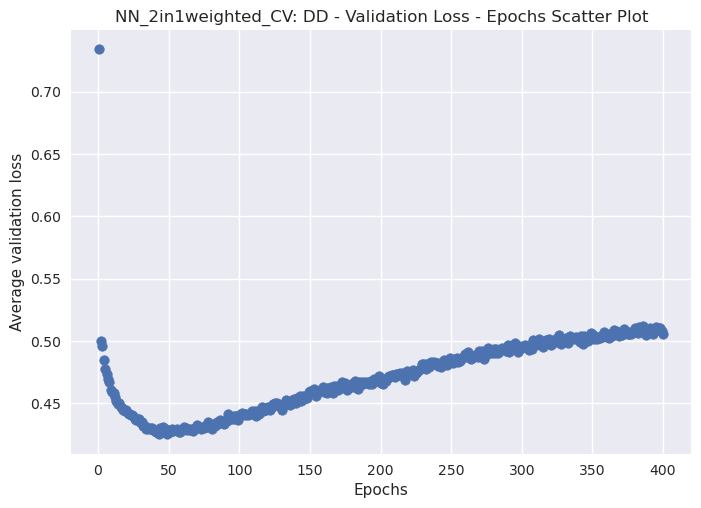

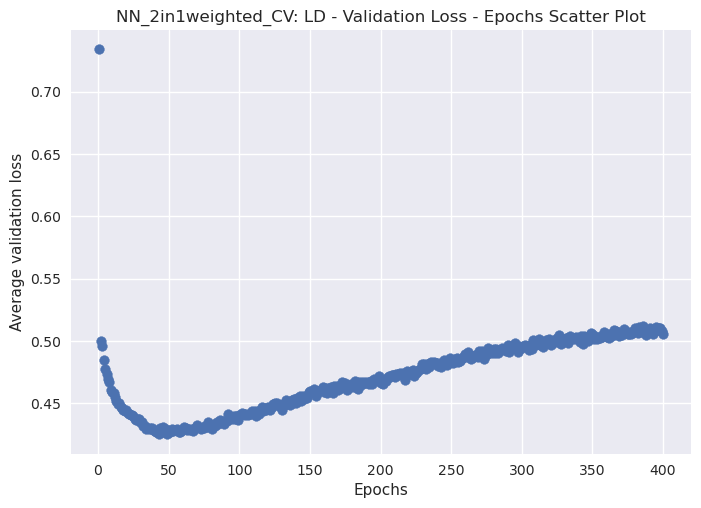

0.4249097406864166
['ASD', 'ADHD', 'MD', 'DD', 'LD']


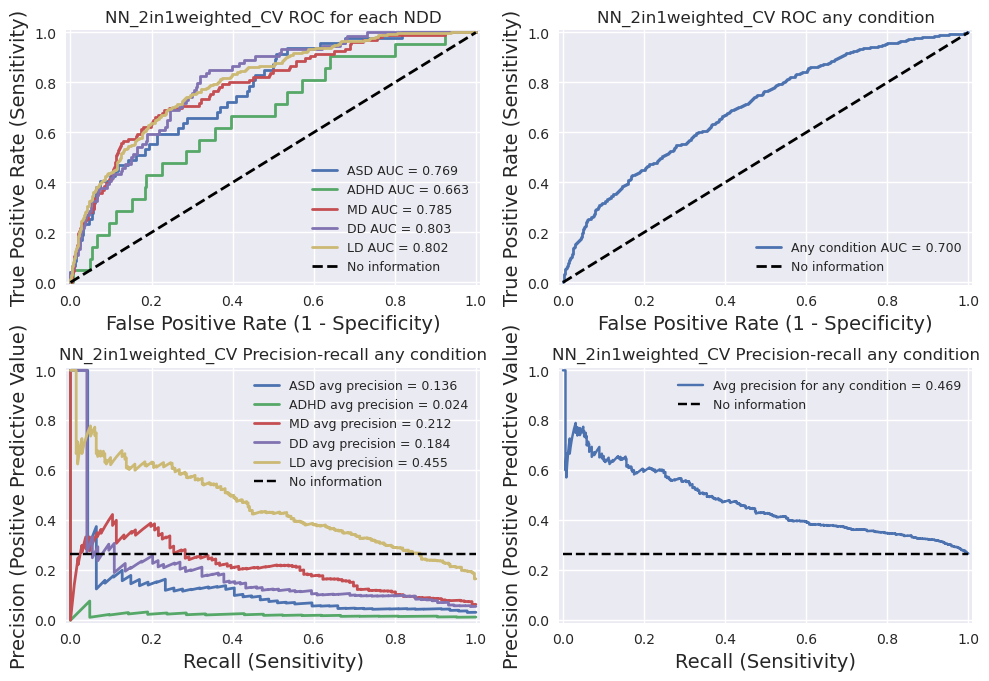

Dataset dimensions are (12960, 560) (12960, 1) (3240, 560) (3240, 1) (1800, 560) (1800, 1)


Training Epochs:   0%|          | 0/400 [00:00<?, ?it/s]

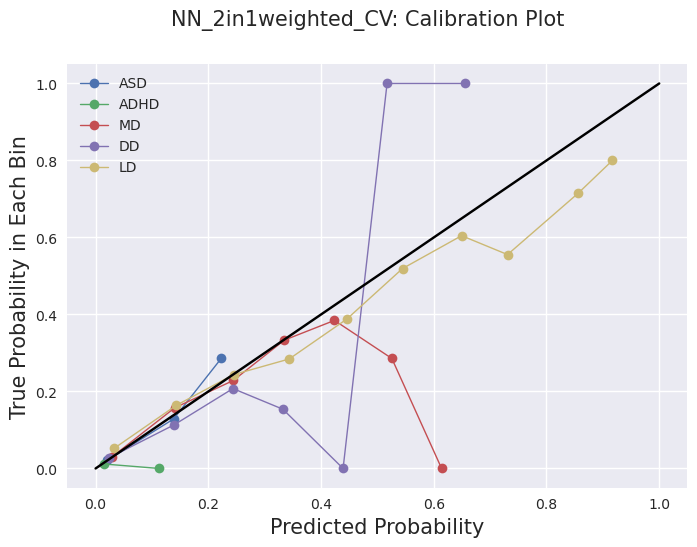

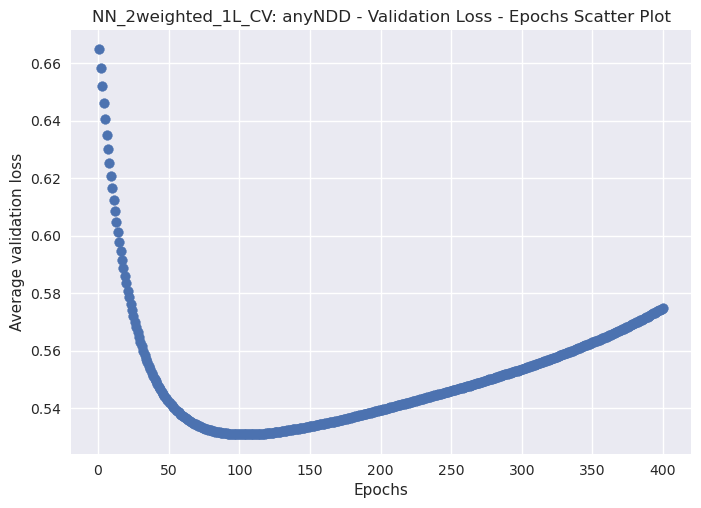

['anyNDD']


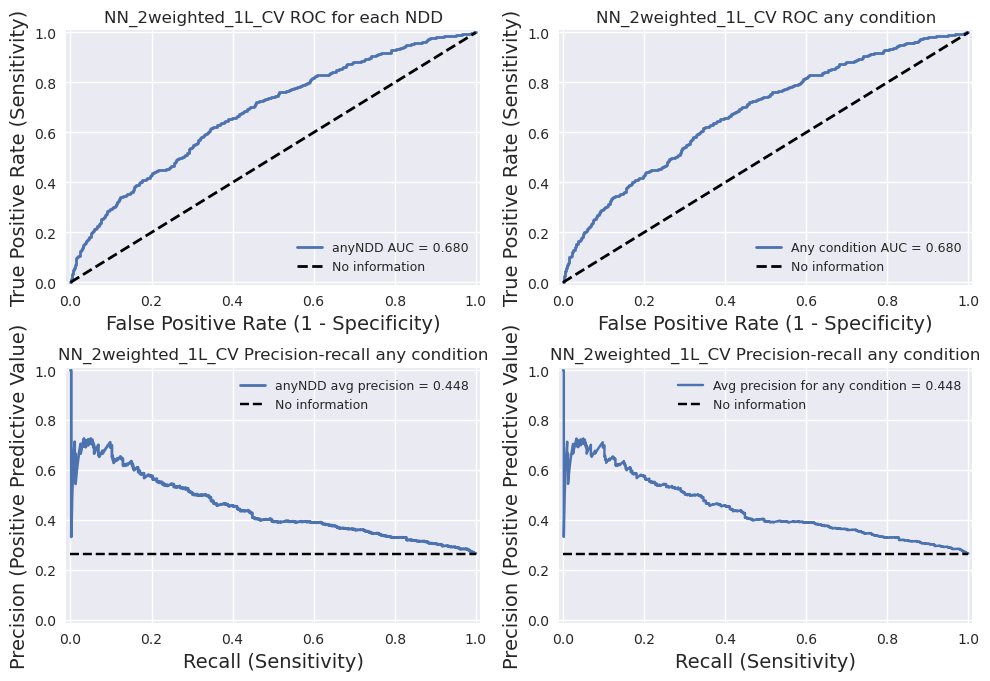

['anyNDD']


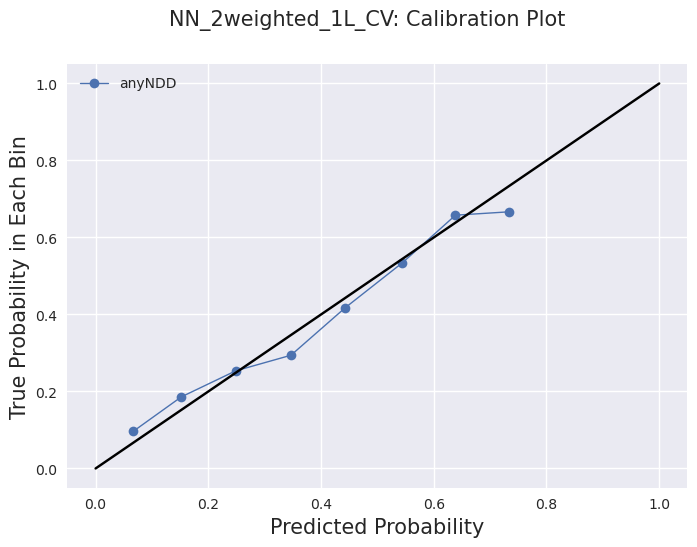

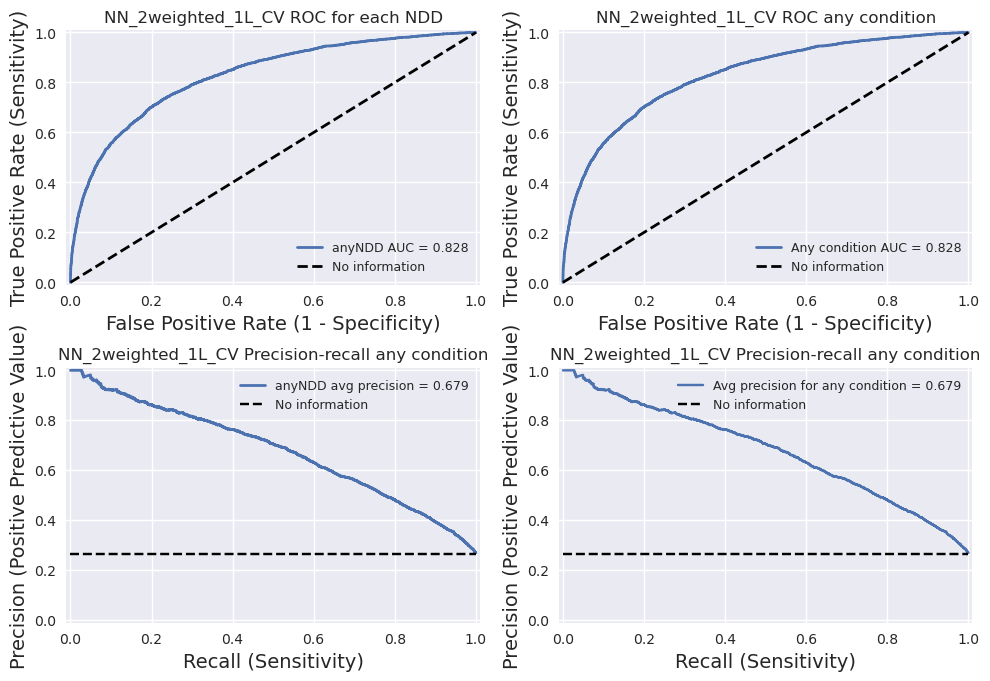

['anyNDD']


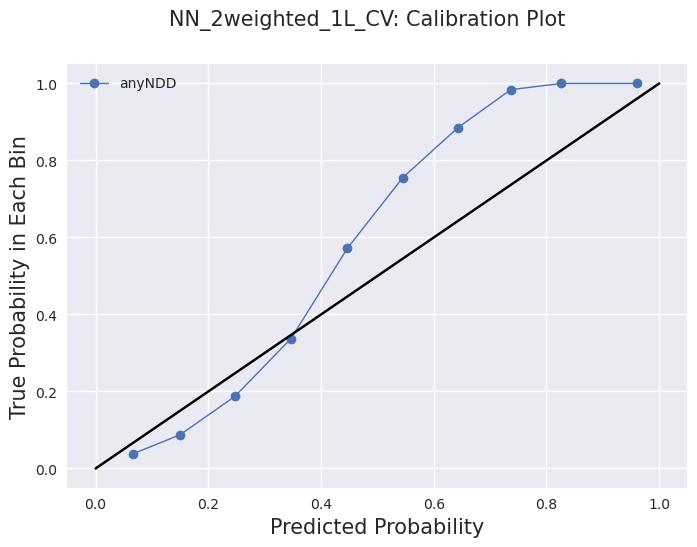

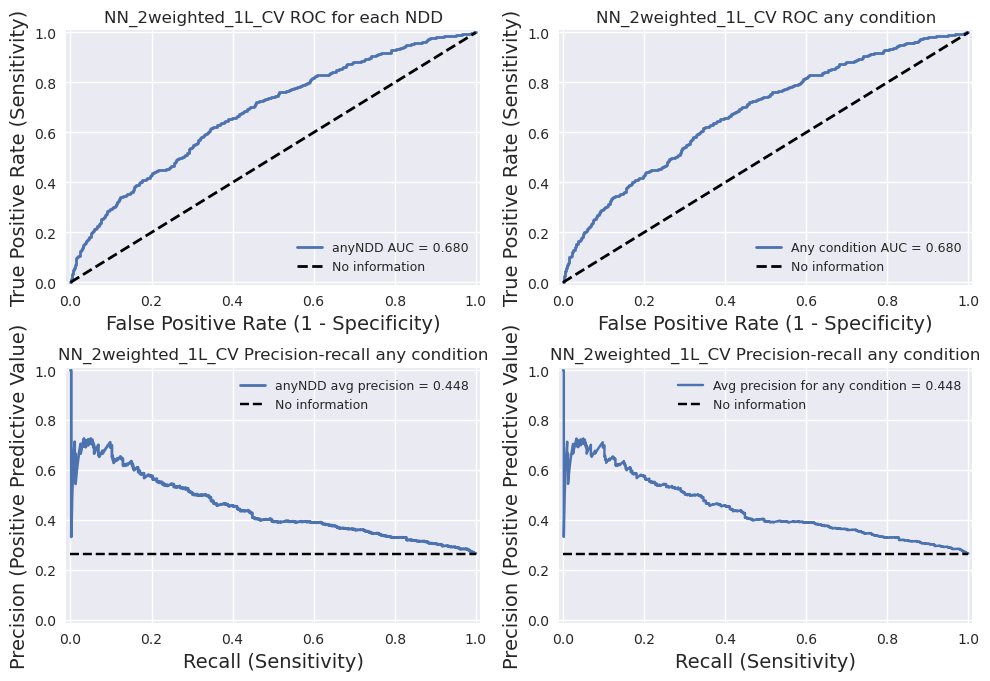

Dataset dimensions are (12960, 560) (12960, 1) (3240, 560) (3240, 1) (1800, 560) (1800, 1)


Training Epochs:   0%|          | 0/400 [00:00<?, ?it/s]

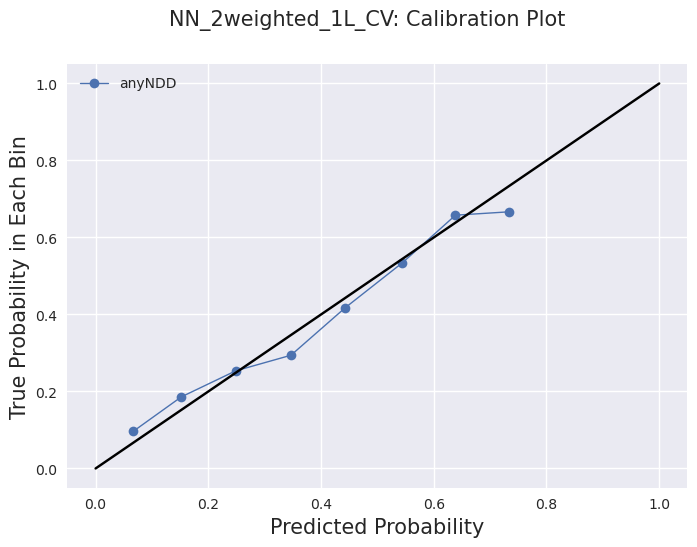

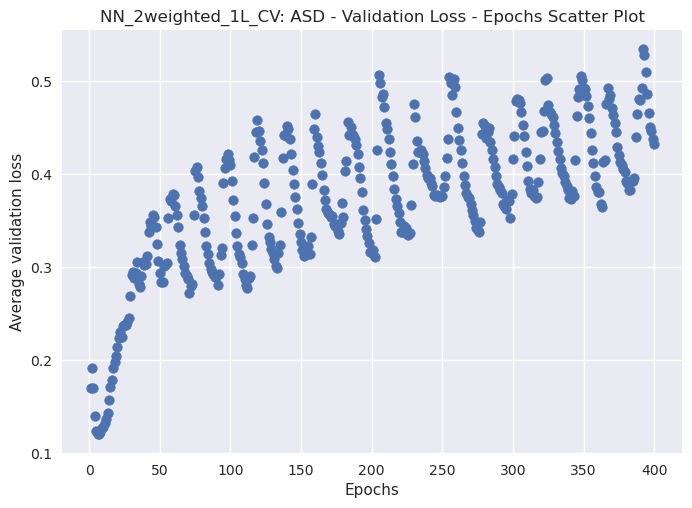

0.11986255273222923
['ASD']


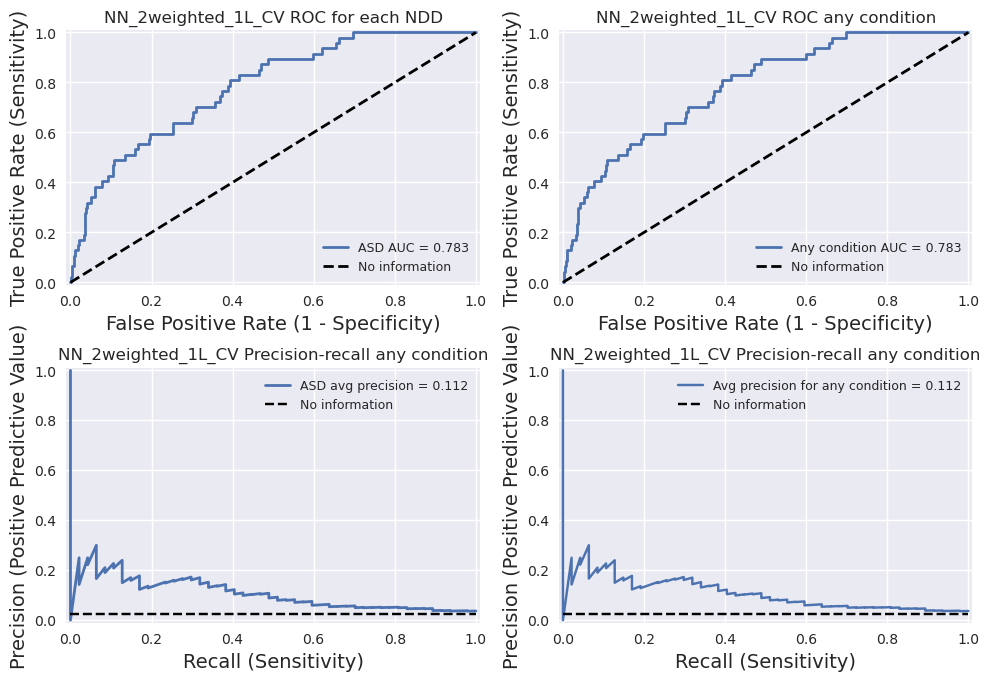

MTLnet(
  (flatten): Flatten(start_dim=1, end_dim=-1)
  (linear_sigmoid_stack): Sequential(
    (0): Linear(in_features=560, out_features=100, bias=True)
    (1): ReLU()
    (2): Linear(in_features=100, out_features=2, bias=True)
  )
)
Dataset dimensions are (12960, 560) (12960, 2) (3240, 560) (3240, 2) (1800, 560) (1800, 2)


Training Epochs:   0%|          | 0/400 [00:00<?, ?it/s]

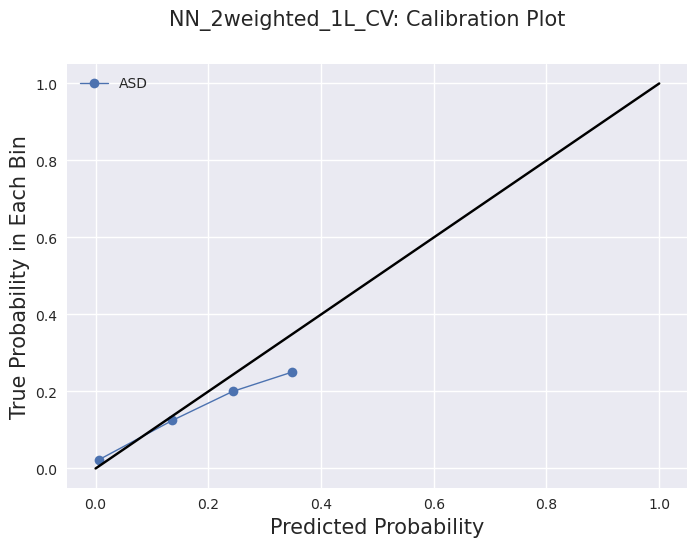

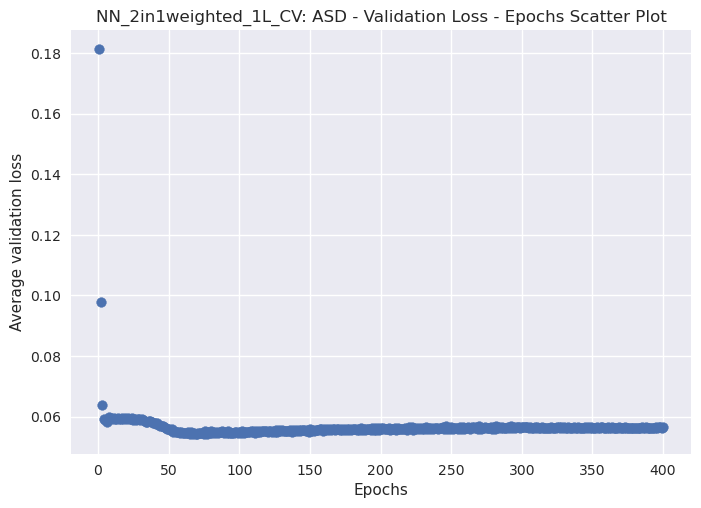

0.05411662347614765
['ASD']


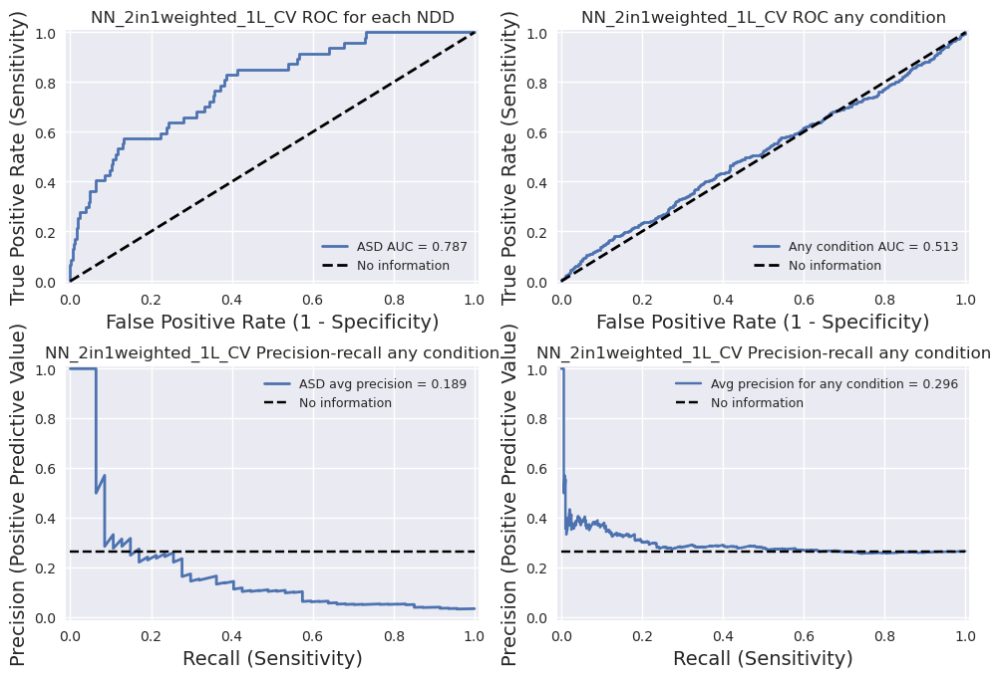

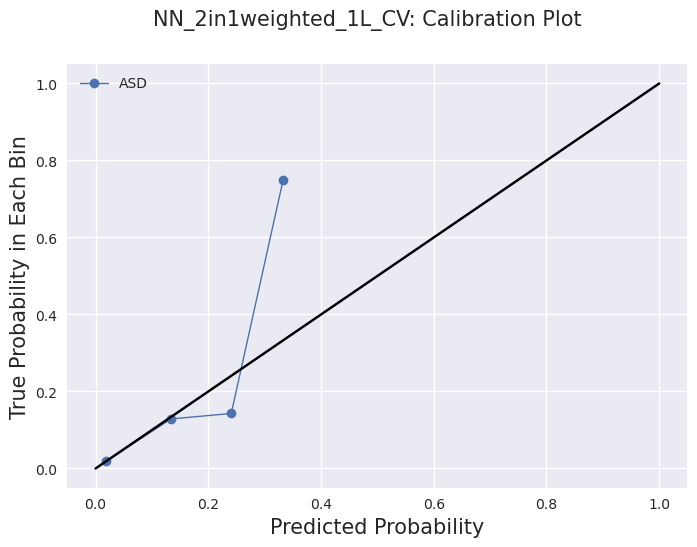

In [1408]:
for fold, (train_index, test_index) in enumerate(mskf.split(X_df, y_df)):
    print(f"Fold {fold+1}/{n_folds}")    
    
    # Save the indices for the current fold
    fold_indices.append((train_index, test_index))
    # train_index, val_index = fold_indices[1]
    
    y_df_each = y_df.drop(columns=['NDD_flag']) 
    y_df_any = y_df[['NDD_flag']] # for conditional model
    y_df_asd = y_df[['ASD_flag']]
    X_dum = X_df
       
    # Split the data into training and validation sets    
    Xtr, Xtest = X_df.iloc[train_index], X_df.iloc[test_index]
    ytr_each, ytest_each = y_df_each.iloc[train_index], y_df_each.iloc[test_index]
    ytr_any, ytest_any = y_df_any.iloc[train_index], y_df_any.iloc[test_index]
    ytr_asd, ytest_asd = y_df_asd.iloc[train_index], y_df_asd.iloc[test_index]
    
    # For testing 1-step CML
    ytr_each_any = pd.concat([ytr_each, ytr_any], axis=1) # 6 columns
    ytest_each_any = pd.concat([ytest_each, ytest_any], axis=1)
    
    # For testing 2step single label 1/11/2024
    ytr_asd_any = pd.concat([ytr_asd, ytr_any], axis=1)
    ytest_asd_any = pd.concat([ytest_asd, ytest_any], axis=1)
    
    # scale (but keep dataframe format)
    ss = StandardScaler()
    Xtr.loc[:,:] = ss.fit_transform(Xtr[:])
    Xtest.loc[:,:] = ss.transform(Xtest[:])
    
    # Save the target values for each fold
    all_y_target.append((ytest_each, ytest_any)) 
    
    
    # Model 0n
    model0n_name = 'NN_1label_CV'
    input_dim = len(X_dum.columns) # number of input features 
    output_dim = len(y_df_asd.columns) # only use asd column
    model0n = MTLnet(input_dim,output_dim)
    model0n.to(device)
    model0n_output_dir = RESULT_DIR + '/' + model0n_name
    model_flag = 0
    
    this_hyper = hyperparameters['model0n']['linear']
    learning_rate = this_hyper['learning_rate']
    lam = this_hyper['lam']
    epochs = this_hyper['epochs']
    
    optimizer = torch.optim.Adam(model0n.parameters(), lr=learning_rate)
    stratify = ytr_asd 
    # input needs to be dataframe
    train_dlr, valid_dlr, test_dlr = split_trainvaltest(Xtr, ytr_asd, stratify, Xtest, ytest_asd)
    numbatches = len(train_dlr)
    scheduler = []

    # initialize validation loss during training
    loss_list = []  # track the loss change when training
    iter = 0
    min_valid_loss = 10000 # initialize as a large number
    
    # Train model
    model0n, loss_list, min_valid_loss, iter, suffix, plt \
    = train_model(model0n, model0n_name, model_flag, model0n_output_dir,train_dlr, valid_dlr,  iter, epochs, loss_list, min_valid_loss, optimizer, scheduler, lam, [NDD_labels[0]])
    suffix = suffix + '_fold' + str(fold) # add fold to suffix to save all folds results
    
    # Test results
    print(min_valid_loss)
    y_target, y_pred, plt1, plt2 \
    = get_y_pred(model0n, model0n_name, model0n_output_dir, test_dlr, 'logit', suffix, [NDD_labels[0]])
    
    # Calculate AUC and AP for the current fold
    auc = roc_auc_score(y_target, y_pred)
    ap = average_precision_score(y_target, y_pred)
    all_auc_scores['model0n'].append(auc)
    all_ap_scores['model0n'].append(ap)
    all_y_pred['model0n'].append(y_pred)    
    
    
    # Model 1n
    model1n_name = 'NN_1step_CV'
    input_dim = len(X_dum.columns) # number of input features 
    output_dim = len(y_df_each.columns) # number of output labels 
    model1n = MTLnet(input_dim,output_dim)
    model1n.to(device)
    model1n_output_dir = RESULT_DIR + '/' + model1n_name
    model_flag = 'L21'
    
    this_hyper = hyperparameters['model1n']['linear']
    learning_rate = this_hyper['learning_rate']
    lam = this_hyper['lam']
    epochs = this_hyper['epochs']
    
    optimizer = torch.optim.Adam(model1n.parameters(), lr=learning_rate)
    stratify = ytr_each[['ASD_flag','DD_flag','LD_flag']]
    #stratify = ytr_each[:,[0,3,4]]
    train_dlr, valid_dlr, test_dlr = split_trainvaltest(Xtr, ytr_each, stratify, Xtest, ytest_each)
    numbatches = len(train_dlr)
    scheduler = []

    # initialize validation loss during training
    loss_list = []  # track the loss change when training
    iter = 0
    min_valid_loss = 10000 # initialize as a large number
    # Train model
    model1n, loss_list, min_valid_loss, iter, suffix, plt \
    = train_model(model1n, model1n_name, model_flag, model1n_output_dir,train_dlr, valid_dlr,  iter, epochs, loss_list, min_valid_loss, optimizer, scheduler, lam, NDD_labels)
    suffix = suffix + '_fold' + str(fold) # add fold to suffix to save all folds results
    # Test results
    print(min_valid_loss)
    y_target, y_pred, plt1, plt2 \
    = get_y_pred(model1n, model1n_name, model1n_output_dir, test_dlr, 'logit', suffix, NDD_labels)
    
    # Calculate AUC and AP for the current fold
    auc = roc_auc_score(y_target, y_pred)
    ap = average_precision_score(y_target, y_pred)
    all_auc_scores['model1n'].append(auc)
    all_ap_scores['model1n'].append(ap)
    all_y_pred['model1n'].append(y_pred)
    
    
    # Model 3n
    model3n_name = 'NN_2weighted_CV'
    input_dim = len(X_dum.columns) # number of input features 
    output_dim = len(y_df_any.columns) # 1/0
    model3na = MTLnet(input_dim,output_dim)
    model3na.to(device)
    print(model3na)
    model3na_output_dir = RESULT_DIR + '/' + model3n_name + '/a/'
    model3n_output_dir = RESULT_DIR + '/' + model3n_name
    model3nb = MTLnet(input_dim,len(y_train_each.columns))
    model3nb.to(device)
    print(model3nb)
    model3nb_output_dir = RESULT_DIR + '/' + model3n_name + '/b/'
    model_flag = 0
    
    # Use best hyperparameters for logistic regression
    this_hyper = hyperparameters['model3n']['linear']
    learning_rate = this_hyper['learning_rate']
    lam = this_hyper['lam']
    epochs = this_hyper['epochs']
    optimizer = torch.optim.Adam(model3na.parameters(), lr=learning_rate)
    # SGD 0.478, AUC 0.635
    # Adam 0.475, AUC 0.640

    stratify=ytr_any
    train_dlr, valid_dlr, test_dlr = split_trainvaltest(Xtr, ytr_any, stratify, Xtest, ytest_any)
    numbatches = len(train_dlr)
    scheduler = []

    # initialize validation loss during training
    loss_list = []  # track the loss change when training
    iter = 0
    min_valid_loss = 10000 # initialize as a large number

    # Train model
    model3na, loss_list, min_valid_loss, iter, suffix, plt \
    = train_model(model3na, model3n_name, model_flag, model3na_output_dir,train_dlr, valid_dlr,  iter, epochs, loss_list, min_valid_loss, optimizer, scheduler, lam, ['anyNDD'])
    
    # test result
    suffix1 = suffix + '_test_fold' + str(fold) # add fold to suffix to save all folds results    
    #keep_flag_bool = idtest == 1
    filtered_test_dlr = test_dlr
    #filtered_test_dlr = [item for item, flag in zip(test_dlr, keep_flag_bool) if flag]
    y_target1, y_pred1, plt1, plt2 \
    = get_y_pred(model3na, model3n_name, model3na_output_dir, filtered_test_dlr, 'logit', suffix1, ['anyNDD'])
    all_y_target1['model3n'].append(y_target1) 
    all_y_pred1['model3n'].append(y_pred1)
    
    # Step b: use prediction from step a as a criteria to go into step b (predict each)
    # Combined train and validation set to get prediction
    tmp_X_train = Xtr.to_numpy().astype(np.float32)
    tmp_y_train = ytr_any.to_numpy().astype(np.float32)
    tmp_set_train = TransData(xx=tmp_X_train, yy=tmp_y_train)
    tmp_train_dlr = DataLoader(tmp_set_train, batch_size=batch_size, shuffle=False)
    
    suffix2 = suffix + '_trainval_fold' + str(fold) # add fold to suffix to save all folds results
    suffix3 = suffix + '_step1_ytest_fold' + str(fold) # use as weights
    
    # output the prediction for training and validation set
    y_train_target, y_train_pred, plt1, plt2 \
    = get_y_pred(model3na, model3n_name, model3na_output_dir, tmp_train_dlr, 'logit', suffix2, ['anyNDD'])
    # make sure anyNDD is wrapped by list so that len()=1, otherwise len>1
    
    # For generating weight for step2, use all test data
    y_test_target, y_test_pred, plt1, plt2 \
    = get_y_pred(model3na, model3n_name, model3na_output_dir, test_dlr, 'logit', suffix3, ['anyNDD'])
    
    suffix = suffix + '_fold' + str(fold)
    # threshold prediction data to determine which samples goes into step b
    y_train_pred = np.array(y_train_pred)
    y_test_pred = np.array(y_test_pred)
    
    # start from step b (step a is the same as model3)
    W_train = y_train_pred
    W_test = y_test_pred
    
    if not os.path.exists(model3nb_output_dir):
        os.makedirs(model3nb_output_dir)
    pickle.dump(y_train_pred, open(model3nb_output_dir + 'step1_y_train_pred_fold' + str(fold) + '.p','wb'))
    pickle.dump(y_test_pred, open(model3nb_output_dir + 'step1_y_test_pred_fold' + str(fold) +'.p','wb'))
    
    # Use best hyperparameters for logistic regression
    this_hyper = hyperparameters['model3n']['linear']
    learning_rate = this_hyper['learning_rate2']
    lam = this_hyper['lam2']
    epochs = this_hyper['epochs2']
    optimizer = torch.optim.Adam(model3nb.parameters(), lr=learning_rate)

    stratify = ytr_each[['ASD_flag','DD_flag','LD_flag']]
    #stratify = ytr_each[:,[0,3,4]]
    #train_dlr, valid_dlr, test_dlr = split_trainvaltest(Xtr*W_train, ytr_each, stratify, Xtest*W_test, ytest_each)
    train_dlr, valid_dlr, test_dlr = split_trainvaltest(Xtr*W_train, ytr_each, stratify, Xtest, ytest_each)
    
    # initialize validation loss during training
    loss_list = []  # track the loss change when training
    iter = 0
    min_valid_loss = 10000 # initialize as a large number
    model_flag = 'L21'
    
    # Train model
    model3nb, loss_list, min_valid_loss, iter, suffix, plt \
    = train_model(model3nb, model3n_name, model_flag, model3nb_output_dir, train_dlr, valid_dlr, iter, epochs, loss_list, min_valid_loss, optimizer, scheduler, lam, NDD_labels)
    suffix = suffix + '_fold' + str(fold)
    # test results
    print(min_valid_loss)
    y_target, y_pred, plt1, plt2 \
    = get_y_pred(model3nb, model3n_name, model3nb_output_dir, test_dlr, 'logit', suffix, NDD_labels)
    
    # Calculate AUC and AP for the current fold
    auc = roc_auc_score(y_target, y_pred)
    ap = average_precision_score(y_target, y_pred)
    all_auc_scores['model3n'].append(auc)
    all_ap_scores['model3n'].append(ap)
    all_y_pred['model3n'].append(y_pred)    

    
    # Model 9n
    model9n_name = 'NN_2in1weighted_CV'
    input_dim = len(Xtr.columns) # number of input features 
    output_dim = len(ytr_each_any.columns) # number of output labels: each+NDD
    model9n = MTLnet(input_dim,output_dim)
    model9n.to(device)
    model_flag = '2in1weighted'
    model9n_output_dir = RESULT_DIR + '/' + model9n_name
    print(model9n)

    this_hyper = hyperparameters['model9n']['linear']
    learning_rate = this_hyper['learning_rate']
    lam = this_hyper['lam']
    epochs = this_hyper['epochs']
    optimizer = optim.Adam(model9n.parameters(), lr=learning_rate) # switch to Adam 2/21/2023
    stratify=ytr_each_any[['ASD_flag','DD_flag','LD_flag']]
    train_dlr, valid_dlr, test_dlr = split_trainvaltest(Xtr, ytr_each_any, stratify, Xtest, ytest_each_any)

    numbatches = len(train_dlr)
    scheduler = []

    # plot validation loss during training
    loss_list = []  # track the loss change when training
    iter = 0
    min_valid_loss = 10000 # initialize as a large number

    # Train model
    model9n, loss_list, min_valid_loss, iter, suffix, plt \
    = train_model(model9n, model9n_name, model_flag, model9n_output_dir, train_dlr, valid_dlr, iter, epochs, loss_list, min_valid_loss, optimizer, scheduler, lam, NDD_labels)
    suffix = suffix + '_fold' + str(fold)
    # Test results
    print(min_valid_loss)
    y_target, y_pred, plt1, plt2 \
    = get_y_pred(model9n, model9n_name, model9n_output_dir, test_dlr, 'logit', suffix, NDD_labels)

    # Calculate AUC and AP for the current fold
    auc = roc_auc_score(y_target, y_pred)
    ap = average_precision_score(y_target, y_pred)
    all_auc_scores['model9n'].append(auc)
    all_ap_scores['model9n'].append(ap)
    all_y_pred['model9n'].append(y_pred) 
    
    # Model 10n (2step 1L, relate to model 3n)
    model10n_name = 'NN_2weighted_1L_CV'
    input_dim = len(X_dum.columns) # number of input features 
    output_dim = len(y_df_any.columns) # 1/0
    model10na = MTLnet(input_dim,output_dim)
    model10na.to(device)
    #print(model10na)
    model10na_output_dir = RESULT_DIR + '/' + model10n_name + '/a/'
    model10n_output_dir = RESULT_DIR + '/' + model10n_name
    model10nb = MTLnet(input_dim,len(y_df_asd.columns))
    model10nb.to(device)
    #print(model10nb)
    model10nb_output_dir = RESULT_DIR + '/' + model10n_name + '/b/'
    model_flag = 0
    
    # Use best hyperparameters for logistic regression
    this_hyper = hyperparameters['model10n']['linear']
    learning_rate = this_hyper['learning_rate']
    lam = this_hyper['lam']
    epochs = this_hyper['epochs']
    optimizer = torch.optim.Adam(model10na.parameters(), lr=learning_rate)
    # SGD 0.478, AUC 0.635
    # Adam 0.475, AUC 0.640

    stratify=ytr_any
    train_dlr, valid_dlr, test_dlr = split_trainvaltest(Xtr, ytr_any, stratify, Xtest, ytest_any)
    numbatches = len(train_dlr)
    scheduler = []

    # initialize validation loss during training
    loss_list = []  # track the loss change when training
    iter = 0
    min_valid_loss = 10000 # initialize as a large number

    # Train model
    model10na, loss_list, min_valid_loss, iter, suffix, plt \
    = train_model(model10na, model10n_name, model_flag, model10na_output_dir,train_dlr, valid_dlr,  iter, epochs, loss_list, min_valid_loss, optimizer, scheduler, lam, ['anyNDD'])
    
    # test result
    suffix1 = suffix + '_test_fold' + str(fold) # add fold to suffix to save all folds results    
    #keep_flag_bool = idtest == 1
    filtered_test_dlr = test_dlr
    #filtered_test_dlr = [item for item, flag in zip(test_dlr, keep_flag_bool) if flag]
    y_target1, y_pred1, plt1, plt2 \
    = get_y_pred(model10na, model10n_name, model10na_output_dir, filtered_test_dlr, 'logit', suffix1, ['anyNDD'])
    all_y_target1['model10n'].append(y_target1) 
    all_y_pred1['model10n'].append(y_pred1)
    
    # Step b: use prediction from step a as a criteria to go into step b (predict each)
    # Combined train and validation set to get prediction
    tmp_X_train = Xtr.to_numpy().astype(np.float32)
    tmp_y_train = ytr_any.to_numpy().astype(np.float32)
    tmp_set_train = TransData(xx=tmp_X_train, yy=tmp_y_train)
    tmp_train_dlr = DataLoader(tmp_set_train, batch_size=batch_size, shuffle=False)
    
    suffix2 = suffix + '_trainval_fold' + str(fold) # add fold to suffix to save all folds results
    suffix3 = suffix + '_step1_ytest_fold' + str(fold) # use as weights
    
    # output the prediction for training and validation set
    y_train_target, y_train_pred, plt1, plt2 \
    = get_y_pred(model10na, model10n_name, model10na_output_dir, tmp_train_dlr, 'logit', suffix2, ['anyNDD'])
    # make sure anyNDD is wrapped by list so that len()=1, otherwise len>1
    
    # For generating weight for step2, use all test data
    y_test_target, y_test_pred, plt1, plt2 \
    = get_y_pred(model10na, model10n_name, model10na_output_dir, test_dlr, 'logit', suffix3, ['anyNDD'])
    
    suffix = suffix + '_fold' + str(fold)
    # threshold prediction data to determine which samples goes into step b
    y_train_pred = np.array(y_train_pred)
    y_test_pred = np.array(y_test_pred)
    
    # start from step b (step a is the same as model3)
    W_train = y_train_pred
    W_test = y_test_pred
    
    if not os.path.exists(model10nb_output_dir):
        os.makedirs(model10nb_output_dir)
    pickle.dump(y_train_pred, open(model10nb_output_dir + 'step1_y_train_pred_fold' + str(fold) + '.p','wb'))
    pickle.dump(y_test_pred, open(model10nb_output_dir + 'step1_y_test_pred_fold' + str(fold) +'.p','wb'))
    
    # Use best hyperparameters for logistic regression
    this_hyper = hyperparameters['model10n']['linear']
    learning_rate = this_hyper['learning_rate2']
    lam = this_hyper['lam2']
    epochs = this_hyper['epochs2']
    optimizer = torch.optim.Adam(model10nb.parameters(), lr=learning_rate)

    stratify = ytr_asd
    #stratify = ytr_each[:,[0,3,4]]
    #train_dlr, valid_dlr, test_dlr = split_trainvaltest(Xtr*W_train, ytr_each, stratify, Xtest*W_test, ytest_each)
    train_dlr, valid_dlr, test_dlr = split_trainvaltest(Xtr*W_train, ytr_asd, stratify, Xtest, ytest_asd)
    
    # initialize validation loss during training
    loss_list = []  # track the loss change when training
    iter = 0
    min_valid_loss = 10000 # initialize as a large number
    model_flag = 0 # only 1 asd label, don't use L21
    
    # Train model
    model10nb, loss_list, min_valid_loss, iter, suffix, plt \
    = train_model(model10nb, model10n_name, model_flag, model10nb_output_dir, train_dlr, valid_dlr, 
                  iter, epochs, loss_list, min_valid_loss, optimizer, scheduler, lam, [NDD_labels[0]])
    suffix = suffix + '_fold' + str(fold)
    # test results
    print(min_valid_loss)
    y_target, y_pred, plt1, plt2 \
    = get_y_pred(model10nb, model10n_name, model10nb_output_dir, test_dlr, 'logit', suffix, [NDD_labels[0]])
    
    # Calculate AUC and AP for the current fold
    auc = roc_auc_score(y_target, y_pred)
    ap = average_precision_score(y_target, y_pred)
    all_auc_scores['model10n'].append(auc)
    all_ap_scores['model10n'].append(ap)
    all_y_pred['model10n'].append(y_pred)  
    
    
    # Model 11n (2in1, 1L, relate to model 9n)
    model11n_name = 'NN_2in1weighted_1L_CV' # single-label: ASD+ANY
    input_dim = len(Xtr.columns) # number of input features 
    output_dim = len(ytr_asd_any.columns) # number of output labels: each+any
    model11n = MTLnet(input_dim,output_dim)
    model11n.to(device)
    model_flag = '2in1weighted'
    model11n_output_dir = RESULT_DIR + '/' + model11n_name
    print(model11n)

    this_hyper = hyperparameters['model11n']['linear']
    learning_rate = this_hyper['learning_rate']
    lam = this_hyper['lam']
    epochs = this_hyper['epochs']
    
    optimizer = optim.Adam(model11n.parameters(), lr=learning_rate) # switch to Adam 2/21/2023
    stratify=ytr_each[['ASD_flag','DD_flag','LD_flag']]
    train_dlr, valid_dlr, test_dlr = split_trainvaltest(Xtr, ytr_asd_any, stratify, Xtest, ytest_asd_any)

    numbatches = len(train_dlr)
    scheduler = []

    # plot validation loss during training
    loss_list = []  # track the loss change when training
    iter = 0
    min_valid_loss = 10000 # initialize as a large number

    # Train model
    model11n, loss_list, min_valid_loss, iter, suffix, plt \
    = train_model(model11n, model11n_name, model_flag, model11n_output_dir, train_dlr, valid_dlr,
                  iter, epochs, loss_list, min_valid_loss, optimizer, scheduler, lam, [NDD_labels[0]])
    suffix = suffix + '_fold' + str(fold)
    # Test results
    print(min_valid_loss)
    y_target, y_pred, plt1, plt2 \
    = get_y_pred(model11n, model11n_name, model11n_output_dir, test_dlr, 'logit', suffix, [NDD_labels[0]])

    # Calculate AUC and AP for the current fold
    auc = roc_auc_score(y_target, y_pred)
    ap = average_precision_score(y_target, y_pred)
    all_auc_scores['model11n'].append(auc)
    all_ap_scores['model11n'].append(ap)
    all_y_pred['model11n'].append(y_pred)

pickle.dump(all_auc_scores, open(cv_output_dir + 'all_auc_scores_nn.p','wb'))
pickle.dump(all_ap_scores, open(cv_output_dir + 'all_ap_scores_nn.p','wb'))
pickle.dump(all_y_target, open(cv_output_dir + 'all_y_target_nn.p','wb'))
pickle.dump(all_y_pred, open(cv_output_dir + 'all_y_pred_nn.p','wb'))
pickle.dump(all_y_target1, open(cv_output_dir + 'all_y_target1_nn.p','wb'))
pickle.dump(all_y_pred1, open(cv_output_dir + 'all_y_pred1_nn.p','wb'))
pickle.dump(fold_indices, open(cv_output_dir + 'fold_indices.p','wb'))

## 4.1 Figure: AUC and AP barplot for autism using 10-fold CV

In [1409]:
# Combine 10-fold data and use bootstrap to generate CI
models = ['model0n','model1n', 'model10n','model11n','model3n', 'model9n']
model_names = ['1L NN', 'ML NN', 'C1L NN', '1-step C1L NN', 'CML NN', '1-step CML NN']

ci = {}
orig_metrics = {}
table_df = {}
table_csv = pd.DataFrame(columns=['AUC Any [95% CI]', 'AUC ASD [95% CI]', 'Precision Any [95% CI]', 'Precision ASD [95% CI]']) 
#cv_output_dir =RESULT_DIR + '/model_comparison_CV/'

for model in models:
    # Concatenate all folds of y_pred
    y_pred = all_y_pred[model]
    this_y_pred_each = np.concatenate(y_pred, axis=0) # 0th dim is fold
    
    # Concatenate all folds of y_target 
    all_y_target_each = [tuple_[0] for tuple_ in all_y_target]
    print(model)
    
    if model in {'model0', 'model0n', 'model10n', 'model11n'}: # only has ASD flag
        this_y_target = np.concatenate(all_y_target_each, axis=0)[:,0] # only select ASD column
        this_y_pred = this_y_pred_each[:,0]
        ci[model], orig_metrics[model] = bootstrap_samples(this_y_target, this_y_pred, flag='single_label')
    else:
        this_y_target = np.concatenate(all_y_target_each, axis=0) # all NDD columns
        this_y_pred = this_y_pred_each[:,:5] # for model 9n, only pick first 5 columns, exclude "any"
        ci[model], orig_metrics[model] = bootstrap_samples(this_y_target, this_y_pred, flag='')
        
    # print metrics with confidence intervals
    for key in orig_metrics[model].keys():
        print('{}: {:.3f} [{:.3f}, {:.3f}]'.format(key, orig_metrics[model][key], ci[model][key][0], ci[model][key][1]))

    # create table
    table_data = []
    for metric_name in ['auc_any','auc_label0','precision_any', 'precision_label0']:
        metric_value = "{:.3f} [{:.3f}, {:.3f}]".format(orig_metrics[model][metric_name], ci[model][metric_name][0], ci[model][metric_name][1])
        table_data.append(metric_value)
    table_headers = ['AUC Any [95% CI]', 'AUC ASD [95% CI]', 'Precision Any [95% CI]', 'Precision ASD [95% CI]']

    table_str = tabulate([table_data], tablefmt='orgtbl')
    print(table_str)

    # save table to file
    table_csv.loc[model] = table_data
    table_df[model] = pd.DataFrame([table_data], columns=table_headers)
    #table_df.to_csv(os.path.join(model_output_dir, 'CV_CItable_' + suffix + '.csv'), index=False)

pickle.dump(ci, open(cv_output_dir + 'CVbootstrap_ci_nn.p','wb'))
pickle.dump(orig_metrics, open(cv_output_dir + 'CVbootstrap_orig_metrics_nn.p','wb'))
pickle.dump(table_df, open(cv_output_dir + 'CVbootstrap_table_df_nn.p','wb'))
table_csv.to_csv(cv_output_dir + 'CVbootstrap_table_df_nn.csv',index=True)

model0n
auc_label0: 0.761 [0.741, 0.782]
precision_label0: 0.107 [0.087, 0.132]
auc_any: 0.761 [0.741, 0.782]
precision_any: 0.107 [0.087, 0.132]
| 0.761 [0.741, 0.782] | 0.761 [0.741, 0.782] | 0.107 [0.087, 0.132] | 0.107 [0.087, 0.132] |
model1n
auc_any: 0.708 [0.699, 0.717]
precision_any: 0.491 [0.477, 0.506]
auc_label0: 0.741 [0.717, 0.763]
precision_label0: 0.099 [0.081, 0.124]
auc_label1: 0.650 [0.611, 0.689]
precision_label1: 0.026 [0.017, 0.040]
auc_label2: 0.777 [0.762, 0.792]
precision_label2: 0.210 [0.189, 0.234]
auc_label3: 0.781 [0.764, 0.797]
precision_label3: 0.153 [0.134, 0.178]
auc_label4: 0.807 [0.799, 0.815]
precision_label4: 0.465 [0.448, 0.484]
| 0.708 [0.699, 0.717] | 0.741 [0.717, 0.763] | 0.491 [0.477, 0.506] | 0.099 [0.081, 0.124] |
model10n
auc_label0: 0.766 [0.744, 0.786]
precision_label0: 0.094 [0.078, 0.116]
auc_any: 0.766 [0.744, 0.786]
precision_any: 0.094 [0.078, 0.116]
| 0.766 [0.744, 0.786] | 0.766 [0.744, 0.786] | 0.094 [0.078, 0.116] | 0.094 [0.078, 

In [1009]:
# if load data directly
cv_output_dir = RESULT_DIR + '/model_comparison_CV/'
ci = pickle.load(open(cv_output_dir + 'CVbootstrap_ci_nn.p','rb'))
orig_metrics = pickle.load(open(cv_output_dir + 'CVbootstrap_orig_metrics_nn.p','rb'))
table_df = pickle.load(open(cv_output_dir + 'CVbootstrap_table_df_nn.p','rb'))

[[0.02018614 0.02366649 0.02187978 0.02124505 0.02576922 0.02105477]
 [0.02053215 0.0220889  0.02018608 0.02051327 0.02582503 0.02243217]]
[0.761264571963232, 0.7406196321861279, 0.7658083353776357, 0.7901735202180383, 0.689865068749978, 0.7511807594198957]


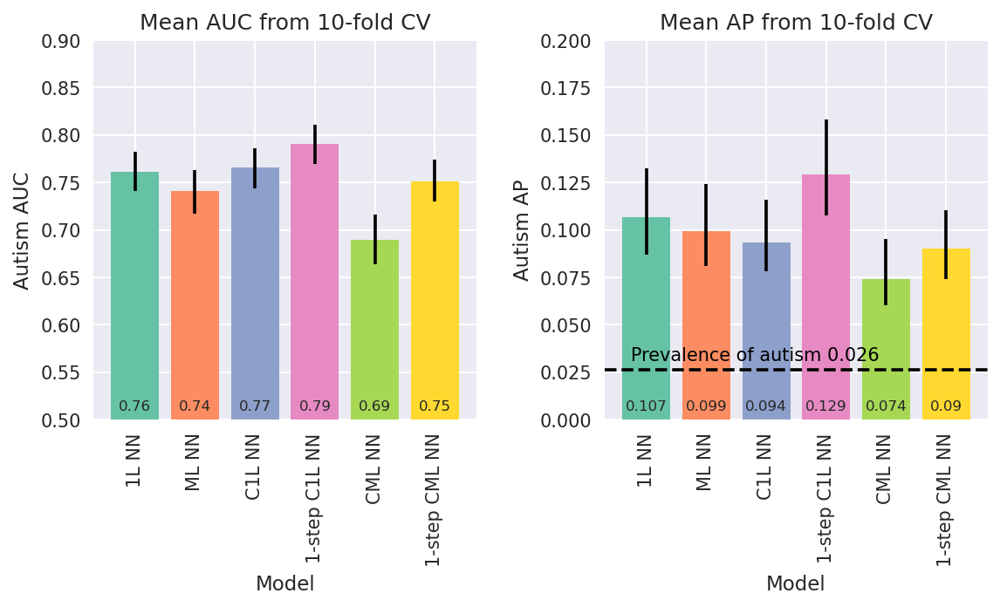

In [1410]:
# Plot for paper
# Define the models and their corresponding colors
models = ['model0n','model1n', 'model10n','model11n','model3n', 'model9n']
model_names = ['1L NN', 'ML NN', 'C1L NN', '1-step C1L NN', 'CML NN', '1-step CML NN']

colors = sns.color_palette("Set2")[:len(models)]
bar_width = 0.3
opacity = 0.8
error_config = {'ecolor': '0.3'}

# Create subplots
fig, axs = plt.subplots(1, 2, figsize=(8, 5), dpi=150)

# Plot grouped barplot for AUC
plt.subplot(1, 2, 1)  # First subplot for AUC
yerr = [(orig_metrics[model]['auc_label0'] - ci[model]['auc_label0'][0], ci[model]['auc_label0'][1]-orig_metrics[model]['auc_label0']) for model in models]
# Transpose yerr to shape (2, N) to put in plt.bar
yerr = np.array(yerr).T
means = [orig_metrics[model]['auc_label0'] for model in models]

print(yerr)
print(means)
plt.bar(models, means, yerr=yerr, color=colors)
plt.xlabel('Model')
plt.ylabel('Autism AUC')
plt.title('Mean AUC from 10-fold CV')
plt.ylim([0.5, 0.9])  # Set the y-axis limits for AUC   
#plt.legend(model_names)
#plt.axhline(y=0.5, color='black', linestyle='--')
#plt.text(x=-0.25, y=0.52, s='0.5 indicates no information', fontsize=10, color='black')
plt.xticks(models,model_names, rotation=90)
# Add mean value to the bottom of each bar
for i, mean in enumerate(means):
    plt.text(i, 0.51, str(round(mean,2)), ha='center', fontsize = 8) 


# Plot grouped barplot for AP
prev = np.mean(y_test_each['ASD_flag']) # 0.022
plt.subplot(1, 2, 2)  # Second subplot for AP
yerr = [(orig_metrics[model]['precision_label0'] - ci[model]['precision_label0'][0], ci[model]['precision_label0'][1] - orig_metrics[model]['precision_label0']) for model in models]
# Transpose yerr to shape (2, N) to put in plt.bar
yerr = np.array(yerr).T
means = [orig_metrics[model]['precision_label0'] for model in models]
plt.bar(models, means, yerr=yerr, color=colors)
plt.xlabel('Model')
plt.ylabel('Autism AP')
plt.title('Mean AP from 10-fold CV')
plt.ylim([0, 0.2])  # Set the y-axis limits for AP
plt.axhline(y=prev, color='black', linestyle='--')
plt.text(x=-0.25, y=prev+0.005, s='Prevalence of autism ' + str(round(prev,3)), fontsize=10, color='black')
plt.xticks(models,model_names, rotation=90)
# Add mean value to the bottom of each bar
for i, mean in enumerate(means):
    plt.text(i, 0.005, str(round(mean,3)), ha='center', fontsize = 8) 

# Adjust the layout and display the plot
plt.tight_layout(pad=2)
plt.style.use('seaborn')
plt.savefig(RESULT_DIR + '/model_comparison_CV/CVbootstrap_auc_ap_grouped4bars_nn.png', bbox_inches='tight')
plt.show()

## 4.2 Sensitivity and specificity

In [1411]:
# Calculate sensitivity and specificity
def calculate_metrics(y_target, y_pred, threshold):
    # Convert probabilities to binary predictions based on threshold
    y_pred_binary = (y_pred >= threshold).astype(int)
    
    # Calculate confusion matrix
    TP = np.sum((y_pred_binary == 1) & (y_target == 1))
    TN = np.sum((y_pred_binary == 0) & (y_target == 0))
    FP = np.sum((y_pred_binary == 1) & (y_target == 0))
    FN = np.sum((y_pred_binary == 0) & (y_target == 1))
    
    # Calculate specificity, sensitivity, and PPV
    specificity = TN / (TN + FP)
    sensitivity = TP / (TP + FN)
    PPV = TP / (TP + FP)
    
    return specificity, sensitivity, PPV

def find_threshold_for_specificity(y_target, y_pred, target_specificity):
    # Define initial threshold range
    threshold_range = np.linspace(0.01, 0.99, 1000)
    
    # Search for threshold that achieves target specificity
    for threshold in threshold_range:
        specificity, _, _ = calculate_metrics(y_target, y_pred, threshold)
        if specificity >= target_specificity:
            return threshold
    
    return None  # If threshold not found

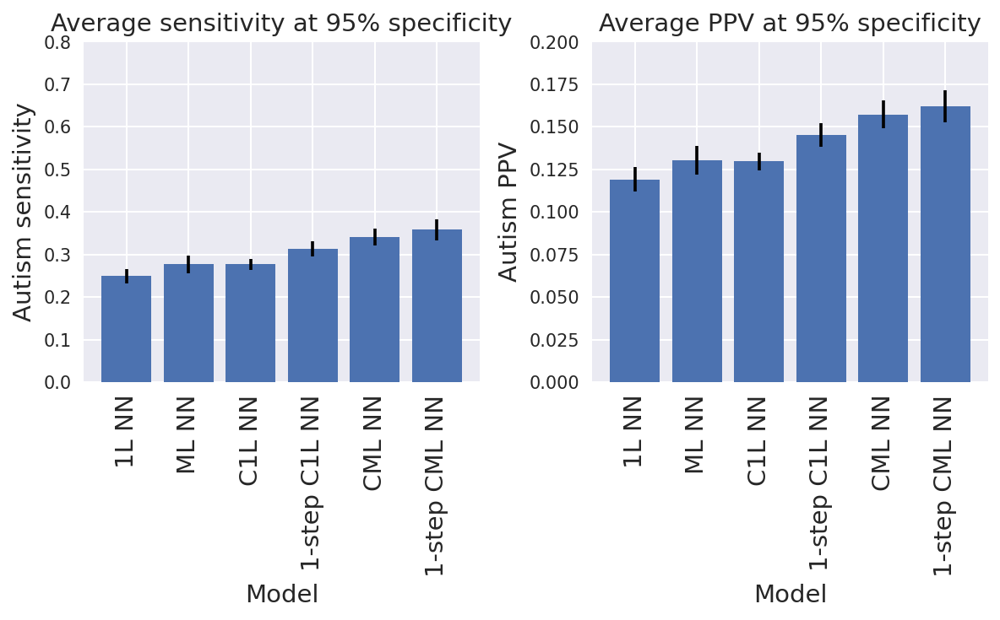

In [1391]:
models = ['model0n','model1n', 'model10n','model11n','model3n', 'model9n']
model_names = ['1L NN', 'ML NN', 'C1L NN', '1-step C1L NN', 'CML NN', '1-step CML NN']
num_folds = 10
specificity = 0.95
spec_str = str(round(100*specificity))
font_size = 14

# Initialize lists to store sensitivity and PPV for each fold and each model
sensitivity_per_fold = np.zeros((len(models), num_folds))
PPV_per_fold = np.zeros((len(models), num_folds))

# Calculate sensitivity and PPV at eg.90% specificity for each model and fold
for i, model in enumerate(models):
    y_pred = all_y_pred[model]    
    for fold in range(num_folds):
        
        # get data for this fold
        y_pred_fold = y_pred[fold]
        # To get all samples for the first label (index 0)
        y_pred_fold_asd = [y_pred_fold[i][0] for i in range(len(y_pred_fold))]
        y_target_fold_asd = all_y_target[fold][0]['ASD_flag']
            
        threshold = find_threshold_for_specificity(y_target_fold_asd, y_pred_fold_asd, specificity)
        if threshold is not None:
            _, sensitivity, PPV = calculate_metrics(y_target_fold_asd, y_pred_fold_asd, threshold)
            sensitivity_per_fold[i, fold] = sensitivity
            PPV_per_fold[i, fold] = PPV

# Save sensitivity_per_fold and PPV_per_fold
if not os.path.exists(cv_output_dir + '/PPV'):
        os.makedirs(cv_output_dir + '/PPV')
np.save(os.path.join(cv_output_dir, "PPV/sensitivity_per_fold" + spec_str + ".npy"), sensitivity_per_fold)
np.save(os.path.join(cv_output_dir, "PPV/PPV_per_fold" + spec_str + ".npy"), PPV_per_fold)
            
# Plot bar plots
fig, ax = plt.subplots(1, 2, figsize=(8, 5), dpi=150)
plt.style.use('seaborn')

ax[0].bar(models, np.mean(sensitivity_per_fold, axis=1), yerr=np.std(sensitivity_per_fold, axis=1) / np.sqrt(num_folds), capsize=5)
ax[0].set_title('Average sensitivity at ' + spec_str + '% specificity', fontsize = font_size)
ax[0].set_xlabel('Model', fontsize = font_size)
ax[0].set_ylabel('Autism sensitivity', fontsize = font_size)
ax[0].set_ylim(0, 0.8)
ax[0].set_xticks(models,model_names, rotation=90, fontsize = font_size)

ax[1].bar(models, np.mean(PPV_per_fold, axis=1), yerr=np.std(PPV_per_fold, axis=1) / np.sqrt(num_folds), capsize=5)
ax[1].set_title('Average PPV at ' + spec_str + '% specificity', fontsize = font_size)
ax[1].set_xlabel('Model', fontsize = font_size)
ax[1].set_ylabel('Autism PPV', fontsize = font_size)
ax[1].set_ylim(0, 0.2)
ax[1].set_xticks(models,model_names, rotation=90, fontsize = font_size)

plt.tight_layout()

# Save the figure
fig.savefig(os.path.join(cv_output_dir, 'PPV/specificity_' + spec_str + '_plot.png'))

plt.show()